In [3]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.ticker as ticker
from mpl_toolkits.basemap import Basemap
import cartopy.crs as ccrs
from datetime import datetime, timedelta
from matplotlib.dates import *
from mpl_toolkits.axes_grid1 import ImageGrid, make_axes_locatable
import pytz as pytz
import sys
import os
nb_dir = os.path.split(os.getcwd())[0]
if nb_dir not in sys.path:
    sys.path.append(nb_dir)
import modules.thermolib as thermo
import modules.DSDlib as dsd
import modules.disdrometer_module as dis
import modules.radarmodule as radar
import modules.simulator as sim
import modules.plotmodule as pm
from modules.datahandler import getDataHandler
#import obanmodule as oban
import pandas as pd
import glob
import pyart as pyart
from metpy.calc import get_wind_components
from metpy.cbook import get_test_data
from metpy.plots import StationPlot
from metpy.plots.wx_symbols import current_weather, sky_cover
from metpy.units import units
from metpy.plots import ctables
%matplotlib notebook
%load_ext autoreload
%autoreload 2


## You are using the Python ARM Radar Toolkit (Py-ART), an open source
## library for working with weather radar data. Py-ART is partly
## supported by the U.S. Department of Energy as part of the Atmospheric
## Radiation Measurement (ARM) Climate Research Facility, an Office of
## Science user facility.
##
## If you use this software to prepare a publication, please cite:
##
##     JJ Helmus and SM Collis, JORS 2016, doi: 10.5334/jors.119



In [4]:
# Define dictionaries, keyed by case date (i.e. '060509', '060709', '060909'), to store parameters related
# to NEXRAD radar data, disdrometer data, and model output, respectively

# Case we are looking at right now. Should only have to change this up here and then execute all the cells below
# to generate the appropriate analysis

# Could be one of '060509', '060709', or '060909', currently
casedate = 'Irma2017_D2'

# List of field names to read
fieldnames = ['dBZ']
# Requested elevation angle
el_req = 0.5

# Note: the feature_* parameters in the dictionary are manually derived locations (radar relative) of some feature
# in the radar data that are used to compute the storm motion. In the 060509 case, I'm using the location of the
# inflow notch (similar to French et al. 2012). Other features may be more appropriate for the other cases.

init_radar_dict = {'Irma2017_D1': {
                         'radardir': '/Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial',
                         'fieldnames': fieldnames,
                         'el_req': el_req,
                         'radstarttime': '20170909120000',
                         'radstoptime': '20170909230000',
                         'fieldnames': ['dBZ'],
                         'el_req': 0.5},
                   'Irma2017_D2': {
                         'radardir': '/Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial',
                         'fieldnames': fieldnames,
                         'el_req': el_req,
                         'radstarttime': '20170909200000',
                         'radstoptime': '20170910230000',
                         'fieldnames': ['dBZ'],
                         'el_req': 0.5}}

init_dis_dict = {'Irma2017_D1': {'dis_dir': '/Users/ddawson/Dropbox/Projects/Irma2017/obsdata/PIPS/',
                       'dis_types': ['PIPS', 'PIPS', 'PIPS', 'PIPS'],
                       'dis_names': ['1A', '1B', '2A', '2B'],
                       'disfilenames': ['PIPS1A_Irma_D1.txt', 
                                        'PIPS1B_Irma_D1.txt', 
                                        'PIPS2A_Irma_D1.txt', 
                                        'PIPS2B_Irma_D1.txt'],
                       'starttimes': ['20170909120000', '20170909120000', '20170909120000', '20170909120000'],
                       'stoptimes': ['20170909230000', '20170909230000', '20170909230000', '20170909230000']},
                 'Irma2017_D2': {'dis_dir': '/Users/ddawson/Dropbox/Projects/Irma2017/obsdata/PIPS/',
                       'dis_types': ['PIPS', 'PIPS', 'PIPS', 'PIPS'],
                       'dis_names': ['1A', '1B', '2A', '2B'],
                       'disfilenames': ['PIPS1A_Irma_D1.txt', 
                                        'PIPS1B_Irma_D1.txt', 
                                        'PIPS2A_Irma_D2.txt', 
                                        'PIPS2B_Irma_D2.txt'],
                       'starttimes': ['20170909200000', '20170909200000', '20170909200000', '20170909200000'],
                       'stoptimes': ['20170910230000', '20170910230000', '20170910230000', '20170910230000']}}

In [5]:
# Now go ahead and read in the sweeps for the desired case
radar_dict = sim.read_sweeps(casedate, init_radar_dict)

/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_ST

/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_ST

/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_ST

/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_ST

/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_ST

/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_ST

/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_ST

Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_200218.624_to_20170909_200741.437_KAMX_v513_SUR.nc
Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-09 20:02:18 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_201047.481_to_20170909_201610.323_KAMX_v514_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-09 20:10:47 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_201722.455_to_20170909_202309.638_KAMX_v515_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-09 20:17:22 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_202422.165_to_20170909_203009.471_KAMX_v516_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-09 20:24:22 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_203121.677_to_20170909_203708.984_KAMX_v517_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-09 20:31:21 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_203817.443_to_20170909_204348.145_KAMX_v518_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-09 20:38:17 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_204458.296_to_20170909_205036.461_KAMX_v519_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-09 20:44:58 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_205147.185_to_20170909_205725.947_KAMX_v520_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-09 20:51:47 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_205838.635_to_20170909_210425.342_KAMX_v521_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-09 20:58:38 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_210535.977_to_20170909_211114.105_KAMX_v522_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-09 21:05:35 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_211226.550_to_20170909_211813.875_KAMX_v523_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-09 21:12:26 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_211922.314_to_20170909_212453.151_KAMX_v524_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-09 21:19:22 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_212603.658_to_20170909_213142.818_KAMX_v525_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-09 21:26:03 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_213255.305_to_20170909_213842.921_KAMX_v526_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-09 21:32:55 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_213955.474_to_20170909_214542.871_KAMX_v527_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-09 21:39:55 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_214649.752_to_20170909_215211.999_KAMX_v528_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9008789
Time of sweep =  2017-09-09 21:46:49 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_215323.406_to_20170909_215901.875_KAMX_v529_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-09 21:53:23 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_220014.995_to_20170909_220602.073_KAMX_v530_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-09 22:00:14 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_220714.680_to_20170909_221302.327_KAMX_v531_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-09 22:07:14 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_221411.452_to_20170909_221941.699_KAMX_v532_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-09 22:14:11 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_222049.282_to_20170909_222611.999_KAMX_v533_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-09 22:20:49 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_222719.981_to_20170909_223243.112_KAMX_v534_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-09 22:27:19 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_223350.294_to_20170909_223913.263_KAMX_v535_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-09 22:33:50 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_224022.445_to_20170909_224553.212_KAMX_v536_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-09 22:40:22 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_224703.444_to_20170909_225241.383_KAMX_v537_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-09 22:47:03 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_225352.524_to_20170909_225930.192_KAMX_v538_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-09 22:53:52 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_230036.921_to_20170909_230559.410_KAMX_v539_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-09 23:00:36 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_230712.265_to_20170909_231259.513_KAMX_v540_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-09 23:07:12 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_231408.640_to_20170909_231938.906_KAMX_v541_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-09 23:14:08 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_232048.281_to_20170909_232617.911_KAMX_v542_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-09 23:20:48 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_232730.553_to_20170909_233317.771_KAMX_v543_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-09 23:27:30 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_233431.123_to_20170909_234017.736_KAMX_v544_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-09 23:34:31 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_234126.790_to_20170909_234657.775_KAMX_v545_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-09 23:41:26 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_234806.149_to_20170909_235336.710_KAMX_v546_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-09 23:48:06 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170909_235445.736_to_20170910_000015.378_KAMX_v547_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-09 23:54:45 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_000122.802_to_20170910_000645.878_KAMX_v548_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 00:01:22 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_000756.455_to_20170910_001334.270_KAMX_v549_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 00:07:56 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_001443.211_to_20170910_002013.467_KAMX_v550_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 00:14:43 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_002124.603_to_20170910_002703.025_KAMX_v551_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 00:21:24 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_002811.102_to_20170910_003334.016_KAMX_v552_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 00:28:11 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_003441.042_to_20170910_004004.652_KAMX_v553_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 00:34:41 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_004112.059_to_20170910_004634.775_KAMX_v554_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 00:41:12 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_004742.075_to_20170910_005305.545_KAMX_v555_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 00:47:42 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_005412.800_to_20170910_005935.767_KAMX_v556_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 00:54:12 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_010044.511_to_20170910_010615.365_KAMX_v557_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 01:00:44 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_010724.217_to_20170910_011255.272_KAMX_v558_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 01:07:24 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_011402.872_to_20170910_011925.587_KAMX_v559_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 01:14:02 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_012033.993_to_20170910_012603.518_KAMX_v560_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 01:20:33 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_012714.384_to_20170910_013245.110_KAMX_v561_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 01:27:14 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_013353.969_to_20170910_013924.258_KAMX_v562_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 01:33:53 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_014034.635_to_20170910_014604.688_KAMX_v563_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 01:40:34 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_014717.687_to_20170910_015304.923_KAMX_v564_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 01:47:17 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_015416.307_to_20170910_015954.958_KAMX_v565_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 01:54:16 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_020105.699_to_20170910_020644.356_KAMX_v566_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 02:01:05 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_020752.029_to_20170910_021314.361_KAMX_v567_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 02:07:52 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_021421.764_to_20170910_021944.053_KAMX_v568_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 02:14:21 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_022051.217_to_20170910_022613.401_KAMX_v569_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 02:20:51 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_022723.024_to_20170910_023253.789_KAMX_v570_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 02:27:23 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_023400.831_to_20170910_023923.398_KAMX_v571_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 02:34:00 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_024030.726_to_20170910_024553.735_KAMX_v572_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 02:40:30 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_024700.739_to_20170910_025223.003_KAMX_v573_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 02:47:00 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_025330.681_to_20170910_025853.493_KAMX_v574_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 02:53:30 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_030002.077_to_20170910_030525.265_KAMX_v575_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 03:00:02 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_030632.312_to_20170910_031154.182_KAMX_v576_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 03:06:32 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_031301.352_to_20170910_031823.464_KAMX_v577_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 03:13:01 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_031930.742_to_20170910_032453.943_KAMX_v578_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 03:19:30 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_032601.289_to_20170910_033124.395_KAMX_v579_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 03:26:01 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_033232.388_to_20170910_033755.510_KAMX_v580_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 03:32:32 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_033902.815_to_20170910_034426.167_KAMX_v581_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9146118
Time of sweep =  2017-09-10 03:39:02 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_034533.897_to_20170910_035056.927_KAMX_v582_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 03:45:33 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_035204.107_to_20170910_035726.661_KAMX_v583_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 03:52:04 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_035834.611_to_20170910_040357.733_KAMX_v584_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 03:58:34 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_040505.061_to_20170910_041028.330_KAMX_v585_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 04:05:05 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_041333.787_to_20170910_041856.872_KAMX_v586_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 04:13:33 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_042004.011_to_20170910_042527.165_KAMX_v587_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 04:20:04 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_042636.109_to_20170910_043205.677_KAMX_v588_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 04:26:36 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_043316.649_to_20170910_043847.069_KAMX_v589_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 04:33:16 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_043954.659_to_20170910_044517.082_KAMX_v590_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 04:39:54 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_044624.138_to_20170910_045147.233_KAMX_v591_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 04:46:24 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_045259.905_to_20170910_045846.962_KAMX_v592_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 04:52:59 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_045955.894_to_20170910_050518.705_KAMX_v593_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 04:59:55 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_050631.732_to_20170910_051218.540_KAMX_v594_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 05:06:31 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_051326.385_to_20170910_051849.261_KAMX_v595_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 05:13:26 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_051956.571_to_20170910_052519.581_KAMX_v596_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 05:19:56 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_052632.075_to_20170910_053219.398_KAMX_v597_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 05:26:32 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_053326.265_to_20170910_053849.342_KAMX_v598_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 05:33:26 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_053956.656_to_20170910_054518.946_KAMX_v599_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 05:39:56 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_054631.938_to_20170910_055219.367_KAMX_v600_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 05:46:31 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_055331.829_to_20170910_055919.063_KAMX_v601_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 05:53:31 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_060026.535_to_20170910_060549.783_KAMX_v602_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 06:00:26 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_060657.128_to_20170910_061219.530_KAMX_v603_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 06:06:57 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_061327.466_to_20170910_061850.113_KAMX_v604_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.8432007
Time of sweep =  2017-09-10 06:13:27 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_062004.141_to_20170910_062551.304_KAMX_v605_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 06:20:04 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_062703.872_to_20170910_063250.896_KAMX_v606_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 06:27:03 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_063358.059_to_20170910_063921.038_KAMX_v607_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.8843994
Time of sweep =  2017-09-10 06:33:58 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_064031.421_to_20170910_064610.106_KAMX_v608_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 06:40:31 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_064717.790_to_20170910_065239.968_KAMX_v609_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.8377075
Time of sweep =  2017-09-10 06:47:17 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_065347.523_to_20170910_065910.542_KAMX_v610_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 06:53:47 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_070017.911_to_20170910_070540.216_KAMX_v611_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9283447
Time of sweep =  2017-09-10 07:00:17 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_070647.373_to_20170910_071210.726_KAMX_v612_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 07:06:47 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_071317.819_to_20170910_071840.531_KAMX_v613_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 07:13:17 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_071949.241_to_20170910_072512.481_KAMX_v614_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 07:19:49 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_072619.616_to_20170910_073141.889_KAMX_v615_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 07:26:19 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_073249.122_to_20170910_073811.563_KAMX_v616_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 07:32:49 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_073918.462_to_20170910_074441.391_KAMX_v617_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 07:39:18 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_074548.992_to_20170910_075111.137_KAMX_v618_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 07:45:48 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_075218.436_to_20170910_075741.889_KAMX_v619_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 07:52:18 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_075849.008_to_20170910_080411.933_KAMX_v620_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.8843994
Time of sweep =  2017-09-10 07:58:49 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_080522.685_to_20170910_081101.288_KAMX_v621_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 08:05:22 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_081209.250_to_20170910_081732.706_KAMX_v622_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 08:12:09 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_081840.187_to_20170910_082403.405_KAMX_v623_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 08:18:40 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_082510.907_to_20170910_083034.620_KAMX_v624_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 08:25:10 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_083142.604_to_20170910_083551.860_KAMX_v625_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 08:31:42 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  600
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_083649.466_to_20170910_084212.261_KAMX_v626_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 08:36:49 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_084319.211_to_20170910_084842.653_KAMX_v627_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 08:43:19 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_084949.814_to_20170910_085512.037_KAMX_v628_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 08:49:49 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_085619.170_to_20170910_090141.856_KAMX_v629_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 08:56:19 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_090248.600_to_20170910_090811.715_KAMX_v630_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 09:02:48 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_090921.784_to_20170910_091451.852_KAMX_v631_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.8843994
Time of sweep =  2017-09-10 09:09:21 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_091559.727_to_20170910_092122.415_KAMX_v632_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.8377075
Time of sweep =  2017-09-10 09:15:59 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_092230.491_to_20170910_092752.592_KAMX_v633_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 09:22:30 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_092859.360_to_20170910_093422.396_KAMX_v634_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 09:28:59 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_093530.094_to_20170910_094052.601_KAMX_v635_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 09:35:30 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_094159.595_to_20170910_094723.270_KAMX_v636_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 09:41:59 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_094831.007_to_20170910_095354.038_KAMX_v637_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 09:48:31 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_095501.550_to_20170910_095639.450_KAMX_v638_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 09:55:01 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  580
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_095803.559_to_20170910_100325.855_KAMX_v639_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 09:58:03 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_100434.050_to_20170910_100957.468_KAMX_v640_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9750366
Time of sweep =  2017-09-10 10:04:34 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_101109.819_to_20170910_101657.336_KAMX_v641_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 10:11:09 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_101809.524_to_20170910_102356.914_KAMX_v642_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 10:18:09 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_102504.444_to_20170910_103027.477_KAMX_v643_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 10:25:04 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_103141.445_to_20170910_103728.290_KAMX_v644_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 10:31:41 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_103835.777_to_20170910_104359.147_KAMX_v645_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 10:38:35 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_104506.076_to_20170910_105028.459_KAMX_v646_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 10:45:06 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_105140.852_to_20170910_105728.205_KAMX_v647_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 10:51:40 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_105835.115_to_20170910_110358.170_KAMX_v648_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.8843994
Time of sweep =  2017-09-10 10:58:35 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_110505.868_to_20170910_111028.833_KAMX_v649_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 11:05:05 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_111136.297_to_20170910_111658.135_KAMX_v650_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 11:11:36 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_111805.446_to_20170910_112328.446_KAMX_v651_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.8267212
Time of sweep =  2017-09-10 11:18:05 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_112435.923_to_20170910_112959.162_KAMX_v652_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 11:24:35 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_113106.691_to_20170910_113629.064_KAMX_v653_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 11:31:06 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_113735.942_to_20170910_114258.754_KAMX_v654_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9283447
Time of sweep =  2017-09-10 11:37:35 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_114406.522_to_20170910_114929.182_KAMX_v655_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 11:44:06 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_115037.188_to_20170910_115600.383_KAMX_v656_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 11:50:37 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_115707.413_to_20170910_120230.448_KAMX_v657_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.854187
Time of sweep =  2017-09-10 11:57:07 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_120339.397_to_20170910_120817.926_KAMX_v658_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 12:03:39 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_120918.621_to_20170910_121448.683_KAMX_v659_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 12:09:18 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_121756.042_to_20170910_122326.605_KAMX_v660_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 12:17:56 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_122433.390_to_20170910_122956.508_KAMX_v661_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 12:24:33 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_123103.879_to_20170910_123541.046_KAMX_v662_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 12:31:03 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_123641.301_to_20170910_124204.095_KAMX_v663_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 12:36:41 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_124311.945_to_20170910_124833.894_KAMX_v664_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 12:43:11 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_124946.597_to_20170910_125534.122_KAMX_v665_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 12:49:46 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_125642.162_to_20170910_130205.581_KAMX_v666_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 12:56:42 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_130314.021_to_20170910_130837.007_KAMX_v667_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 13:03:14 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_130950.131_to_20170910_131537.505_KAMX_v668_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 13:09:50 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_131645.378_to_20170910_132208.193_KAMX_v669_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 13:16:45 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_132315.662_to_20170910_132838.949_KAMX_v670_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 13:23:15 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_132947.201_to_20170910_133510.297_KAMX_v671_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 13:29:47 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_133623.367_to_20170910_134210.681_KAMX_v672_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 13:36:23 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_134318.237_to_20170910_134841.202_KAMX_v673_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 13:43:18 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_134948.579_to_20170910_135337.533_KAMX_v674_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 13:49:48 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_135729.513_to_20170910_140252.583_KAMX_v675_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 13:57:29 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_140359.742_to_20170910_140850.968_KAMX_v676_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 14:03:59 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  196
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_141224.464_to_20170910_141747.226_KAMX_v677_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 14:12:24 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_141854.579_to_20170910_142417.764_KAMX_v678_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.7635498
Time of sweep =  2017-09-10 14:18:54 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_142525.471_to_20170910_142739.269_KAMX_v679_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 14:25:25 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  411
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_142928.251_to_20170910_143448.481_KAMX_v680_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 14:29:28 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_143555.959_to_20170910_144118.246_KAMX_v681_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 14:35:55 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_144225.479_to_20170910_144749.647_KAMX_v682_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 14:42:25 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_144921.824_to_20170910_145017.036_KAMX_v683_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.5548096
Time of sweep =  2017-09-10 14:49:21 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_145135.035_to_20170910_145644.275_KAMX_v684_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 14:51:35 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_145854.700_to_20170910_150417.574_KAMX_v686_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 14:58:54 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_150525.096_to_20170910_151048.519_KAMX_v687_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 15:05:25 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_151155.678_to_20170910_151719.185_KAMX_v688_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.821228
Time of sweep =  2017-09-10 15:11:55 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_151827.528_to_20170910_152349.458_KAMX_v689_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 15:18:27 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_152456.666_to_20170910_153019.630_KAMX_v690_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 15:24:56 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_153050.100_to_20170910_153124.059_KAMX_v691_SUR.nc
Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.5548096


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Time of sweep =  2017-09-10 15:30:50 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  564
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_153322.592_to_20170910_153839.524_KAMX_v692_SUR.nc
Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 15:33:22 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_153946.549_to_20170910_154509.442_KAMX_v693_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.83496094
Time of sweep =  2017-09-10 15:39:46 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_154617.276_to_20170910_155140.419_KAMX_v694_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 15:46:17 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_155247.781_to_20170910_155535.269_KAMX_v695_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 15:52:47 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  104
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_155727.793_to_20170910_160224.462_KAMX_v696_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 15:57:27 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  49
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_160353.819_to_20170910_160912.109_KAMX_v697_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 16:03:53 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_161019.824_to_20170910_161543.074_KAMX_v698_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 16:10:19 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_161650.290_to_20170910_162213.464_KAMX_v699_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 16:16:50 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_162322.445_to_20170910_162852.431_KAMX_v700_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 16:23:22 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_163244.339_to_20170910_163312.541_KAMX_v701_SUR.nc
Requested elevation angle  0.5


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Actual elevation angle at start of sweep:  0.5548096
Time of sweep =  2017-09-10 16:32:44 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  470
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_163515.950_to_20170910_164038.330_KAMX_v702_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 16:35:15 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_165006.406_to_20170910_165535.811_KAMX_v704_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 16:50:06 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_165648.532_to_20170910_170236.181_KAMX_v705_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.8843994
Time of sweep =  2017-09-10 16:56:48 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_170345.480_to_20170910_170915.179_KAMX_v706_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 17:03:45 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_171025.559_to_20170910_171603.341_KAMX_v707_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9146118
Time of sweep =  2017-09-10 17:10:25 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_171714.098_to_20170910_172252.519_KAMX_v708_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 17:17:14 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_172403.675_to_20170910_172941.788_KAMX_v709_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 17:24:03 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_173050.352_to_20170910_173621.359_KAMX_v710_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 17:30:50 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_173734.575_to_20170910_174321.807_KAMX_v711_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 17:37:34 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_174432.045_to_20170910_175009.787_KAMX_v712_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 17:44:32 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_175120.934_to_20170910_175659.329_KAMX_v713_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 17:51:20 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_175810.011_to_20170910_180349.123_KAMX_v714_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 17:58:10 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_180459.536_to_20170910_181038.137_KAMX_v715_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.8267212
Time of sweep =  2017-09-10 18:04:59 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_181149.188_to_20170910_181727.954_KAMX_v716_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 18:11:49 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_181840.498_to_20170910_182428.138_KAMX_v717_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 18:18:40 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_182539.074_to_20170910_183117.790_KAMX_v718_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 18:25:39 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_183228.468_to_20170910_183805.981_KAMX_v719_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 18:32:28 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_183915.322_to_20170910_184445.921_KAMX_v720_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 18:39:15 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_184556.753_to_20170910_185135.426_KAMX_v721_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 18:45:56 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_185242.634_to_20170910_185805.428_KAMX_v722_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 18:52:42 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_185913.420_to_20170910_190436.238_KAMX_v723_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 18:59:13 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_190547.043_to_20170910_191125.080_KAMX_v724_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.9063721
Time of sweep =  2017-09-10 19:05:47 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_191237.562_to_20170910_191824.611_KAMX_v725_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 19:12:37 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_191937.096_to_20170910_192524.385_KAMX_v726_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 19:19:37 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_192636.555_to_20170910_193224.276_KAMX_v727_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 19:26:36 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_193338.136_to_20170910_193925.322_KAMX_v728_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 19:33:38 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_194037.684_to_20170910_194625.202_KAMX_v729_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 19:40:37 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_194738.006_to_20170910_195326.895_KAMX_v730_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 19:47:38 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_195439.613_to_20170910_200027.082_KAMX_v731_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 19:54:39 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_200140.175_to_20170910_200728.173_KAMX_v732_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 20:01:40 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_200835.470_to_20170910_201358.832_KAMX_v733_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 20:08:35 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_201505.979_to_20170910_202029.095_KAMX_v734_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 20:15:05 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_202336.130_to_20170910_202923.516_KAMX_v735_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 20:23:36 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_203036.367_to_20170910_203623.907_KAMX_v736_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 20:30:36 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_203736.739_to_20170910_204323.940_KAMX_v737_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.8843994
Time of sweep =  2017-09-10 20:37:36 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_204436.755_to_20170910_205024.121_KAMX_v738_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 20:44:36 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_205137.015_to_20170910_205724.223_KAMX_v739_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 20:51:37 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_205837.363_to_20170910_210424.989_KAMX_v740_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 20:58:37 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_210537.842_to_20170910_211125.116_KAMX_v741_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 21:05:37 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_211238.282_to_20170910_211825.608_KAMX_v742_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 21:12:38 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_211937.868_to_20170910_212525.247_KAMX_v743_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 21:19:37 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_212639.506_to_20170910_213227.169_KAMX_v744_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 21:26:39 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_213340.013_to_20170910_213927.214_KAMX_v745_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 21:33:40 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_214038.180_to_20170910_214616.739_KAMX_v746_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 21:40:38 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_214729.771_to_20170910_215316.730_KAMX_v747_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 21:47:29 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_215429.508_to_20170910_220016.593_KAMX_v748_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 21:54:29 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_220123.675_to_20170910_220645.659_KAMX_v749_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 22:01:23 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_220755.370_to_20170910_221324.842_KAMX_v750_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 22:07:55 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_221432.883_to_20170910_221955.979_KAMX_v751_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 22:14:32 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_222102.883_to_20170910_222626.135_KAMX_v752_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 22:21:02 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_222736.654_to_20170910_223315.005_KAMX_v753_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 22:27:36 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_223428.173_to_20170910_224015.264_KAMX_v754_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 22:34:28 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_224127.708_to_20170910_224714.828_KAMX_v755_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 22:41:27 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_224828.288_to_20170910_225415.410_KAMX_v756_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 22:48:28 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720
Opening file:  /Users/ddawson/Dropbox/Projects/Irma2017/obsdata/nexrad/KAMX/CFRadial/cfrad.20170910_225525.714_to_20170910_230104.389_KAMX_v757_SUR.nc


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()


Requested elevation angle  0.5
Actual elevation angle at start of sweep:  0.86242676
Time of sweep =  2017-09-10 22:55:25 
Number of gates:  1832
Radar lat,lon,alt [25.611083984375] [-80.41266632080078] [33.0]
Gatewidth  250.0
Radar beam width (degrees): 0.93
Number of azimuths in sweep  720


/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_STRING instead.
  ret  = self._obj.get_value()
/Users/dawson29/anaconda2/lib/python2.7/site-packages/PyNIO/Nio.py:366: DeprecationWarning: The NPY_CHAR type_num is deprecated. Please port your code to use NPY_ST

In [6]:
# Go ahead and read in the conventional data at the sweeptimes and plot them:
# Read time series
dis_dict_at_radar = sim.read_convdata_at_sweeptimes(casedate, init_dis_dict, radar_dict)

# Find disdrometer lat/lons and convert them to cartesian coordinates relative to radar lat/lon

dis_dict = sim.get_dis_locs_relative_to_radar(casedate, init_dis_dict, radar_dict)

dxlist = [i[0] for i in dis_dict[casedate]['dradloclist']]
dylist = [i[1] for i in dis_dict[casedate]['dradloclist']]

080917 235450
2017-09-08 23:54:50
2017 9 8 23 54 50
2017-09-08 23:54:50 2017-09-08 23:54:50
GPS Offset 0:00:00
Requested DSD interval: 60.0. Actual DSD interval: 60.0
090917 011433
2017-09-09 01:14:32
2017 9 9 1 14 32
2017-09-09 01:14:33 2017-09-09 01:14:32
GPS Offset 0:00:01
Requested DSD interval: 60.0. Actual DSD interval: 60.0
100917 025302
2017-09-10 02:53:02
2017 9 10 2 53 2
2017-09-10 02:53:02 2017-09-10 02:53:02
GPS Offset 0:00:00
Requested DSD interval: 60.0. Actual DSD interval: 60.0
090917 203620
2017-09-09 20:36:20
2017 9 9 20 36 20
2017-09-09 20:36:20 2017-09-09 20:36:20
GPS Offset 0:00:00
Requested DSD interval: 60.0. Actual DSD interval: 52.0
-26136.90725859382 17029.25778611067
-21643.69209006213 59645.99733638815
-93057.43153427835 60606.49634842491
-66450.05909453389 62001.57125125135


<IPython.core.display.Javascript object>


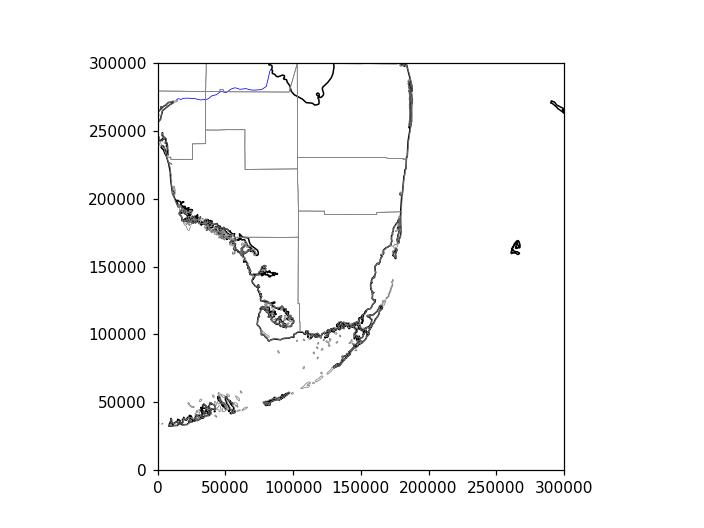

reading counties from shapefile
i, sweeptime =  2017-09-09 20:02:18


<IPython.core.display.Javascript object>


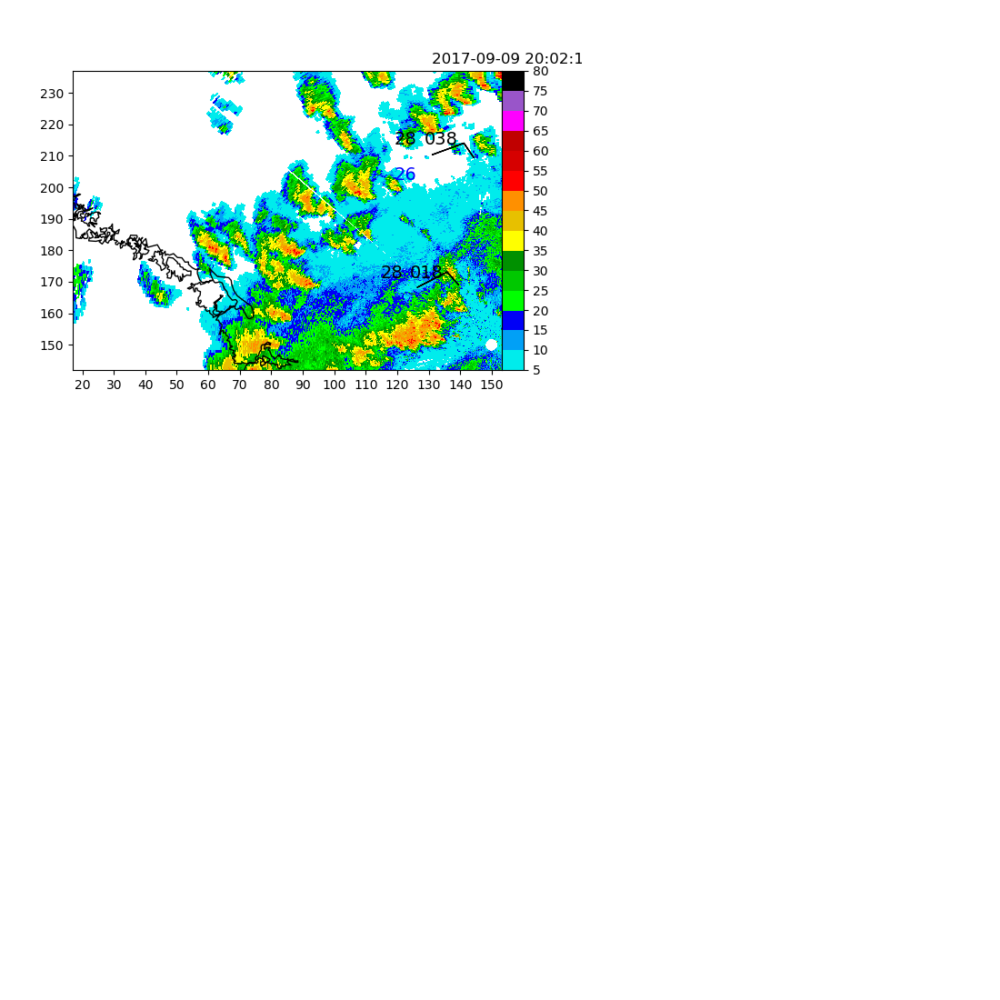

i, sweeptime =  2017-09-09 20:10:47


<IPython.core.display.Javascript object>


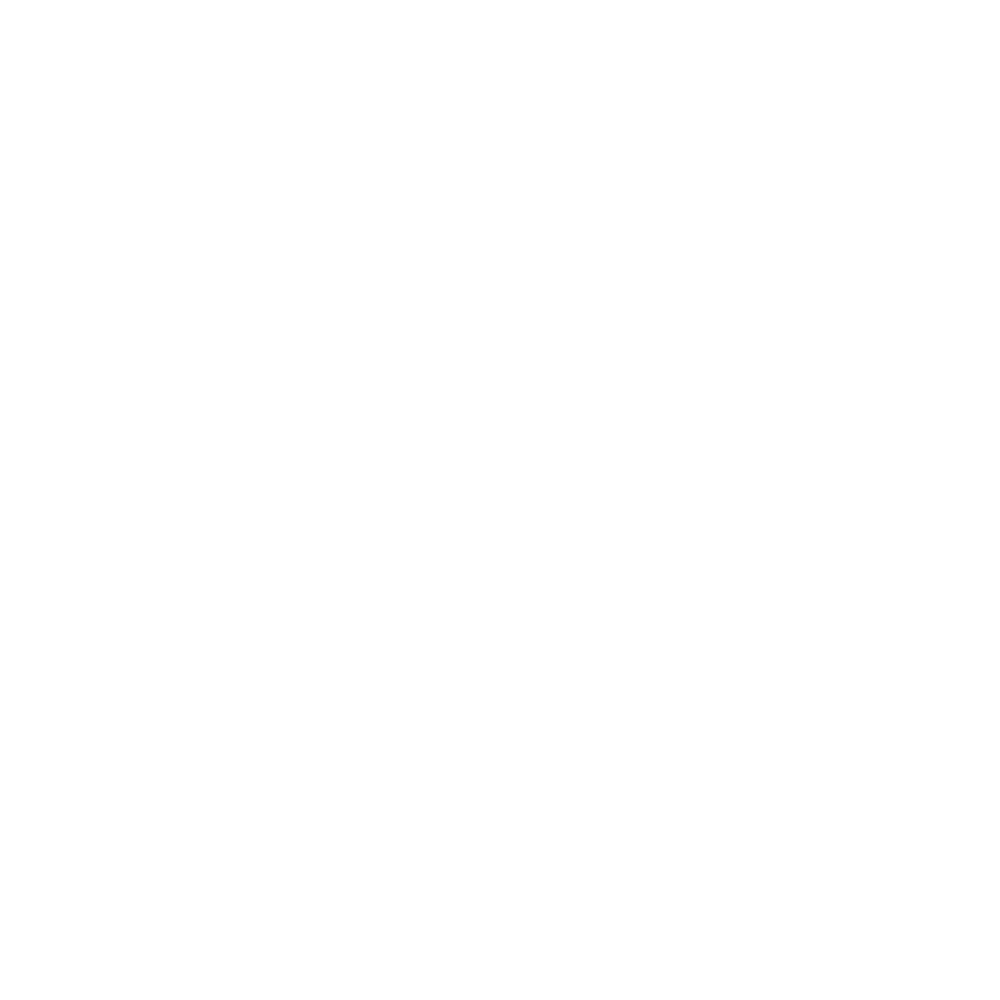

i, sweeptime =  2017-09-09 20:17:22


<IPython.core.display.Javascript object>


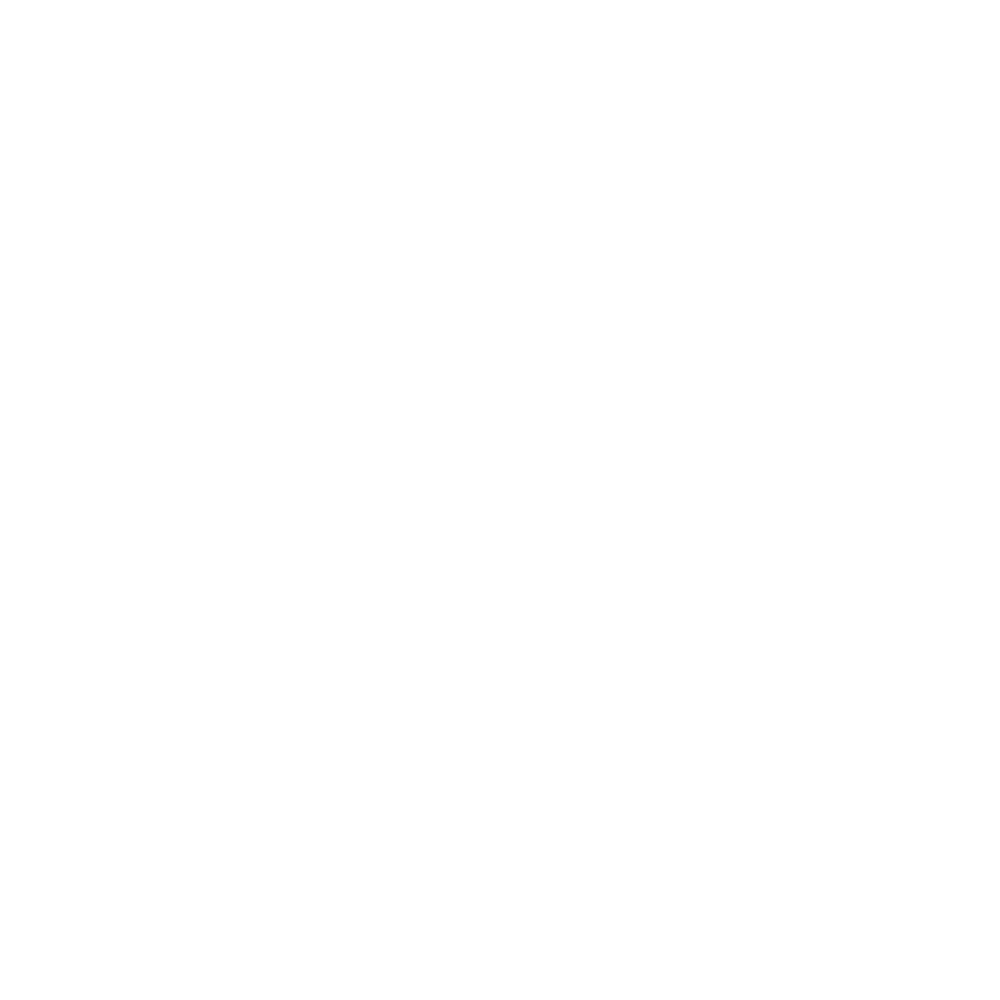

i, sweeptime =  2017-09-09 20:24:22


<IPython.core.display.Javascript object>


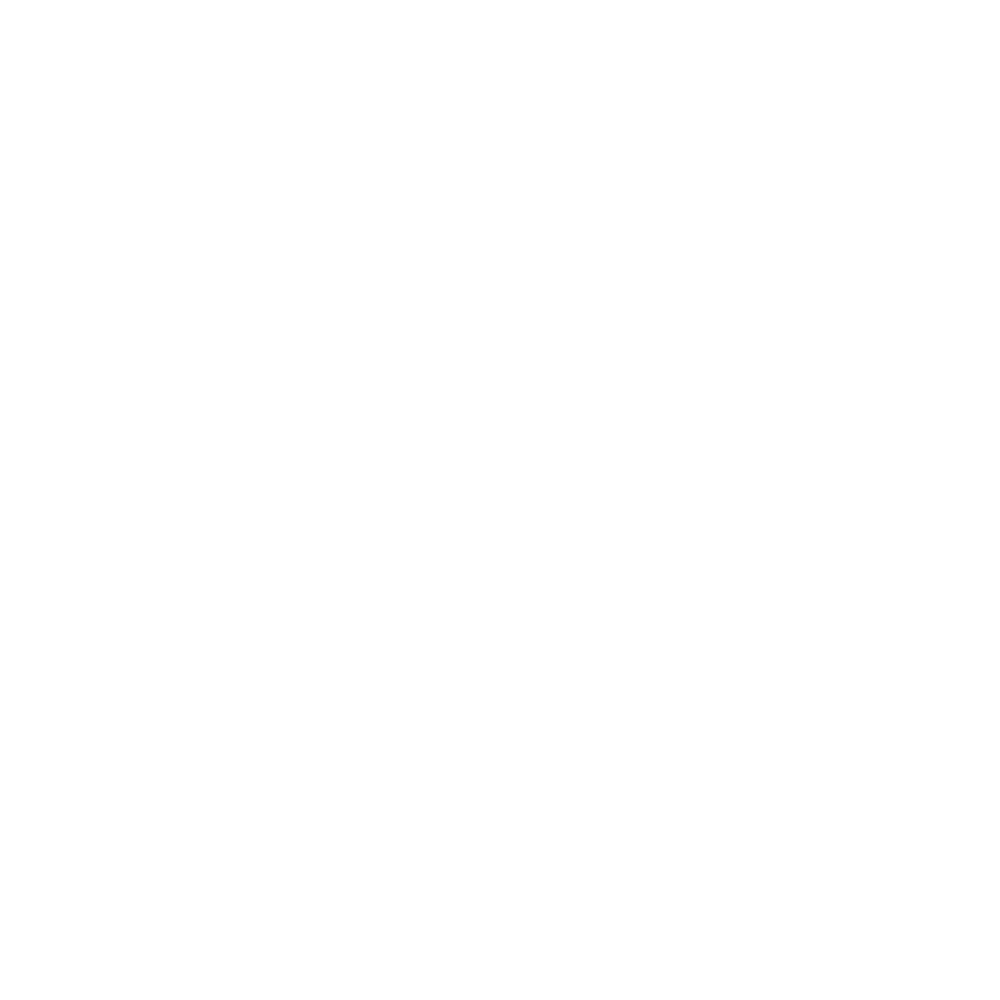

i, sweeptime =  2017-09-09 20:31:21


<IPython.core.display.Javascript object>


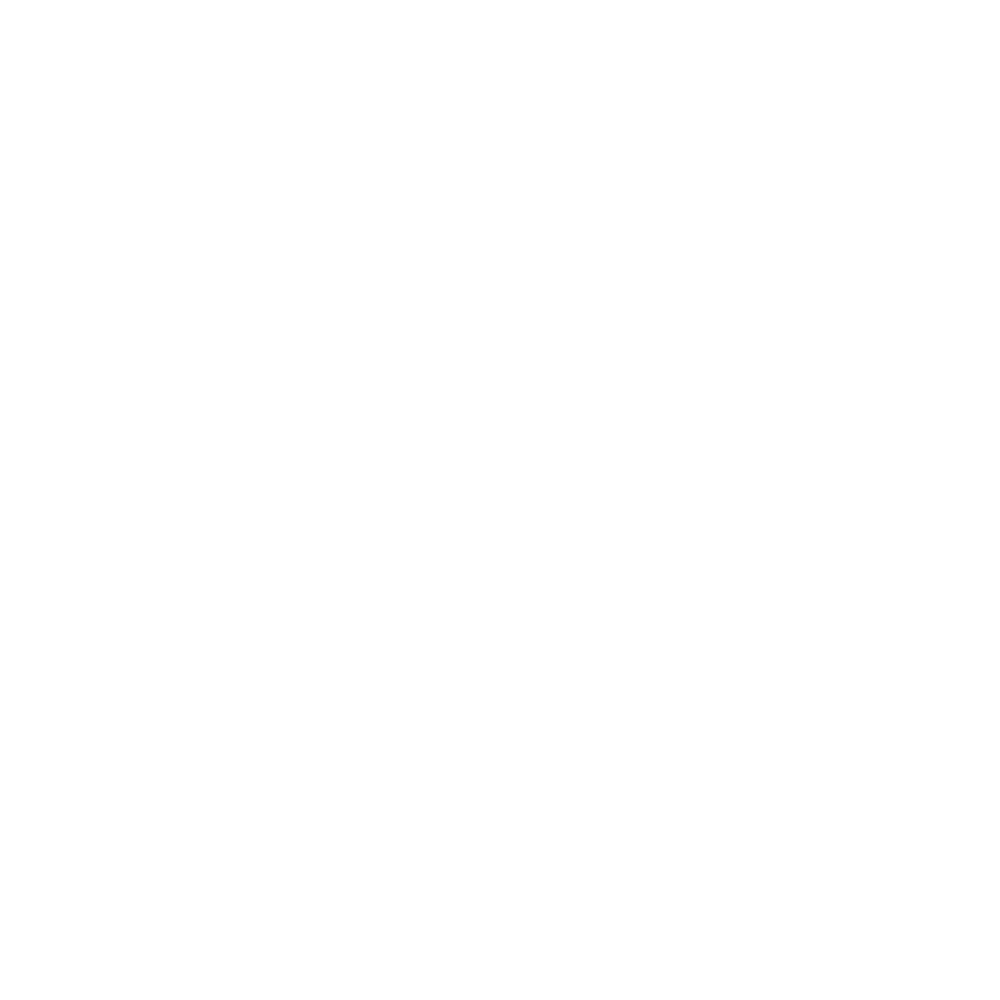

i, sweeptime =  2017-09-09 20:38:17


<IPython.core.display.Javascript object>


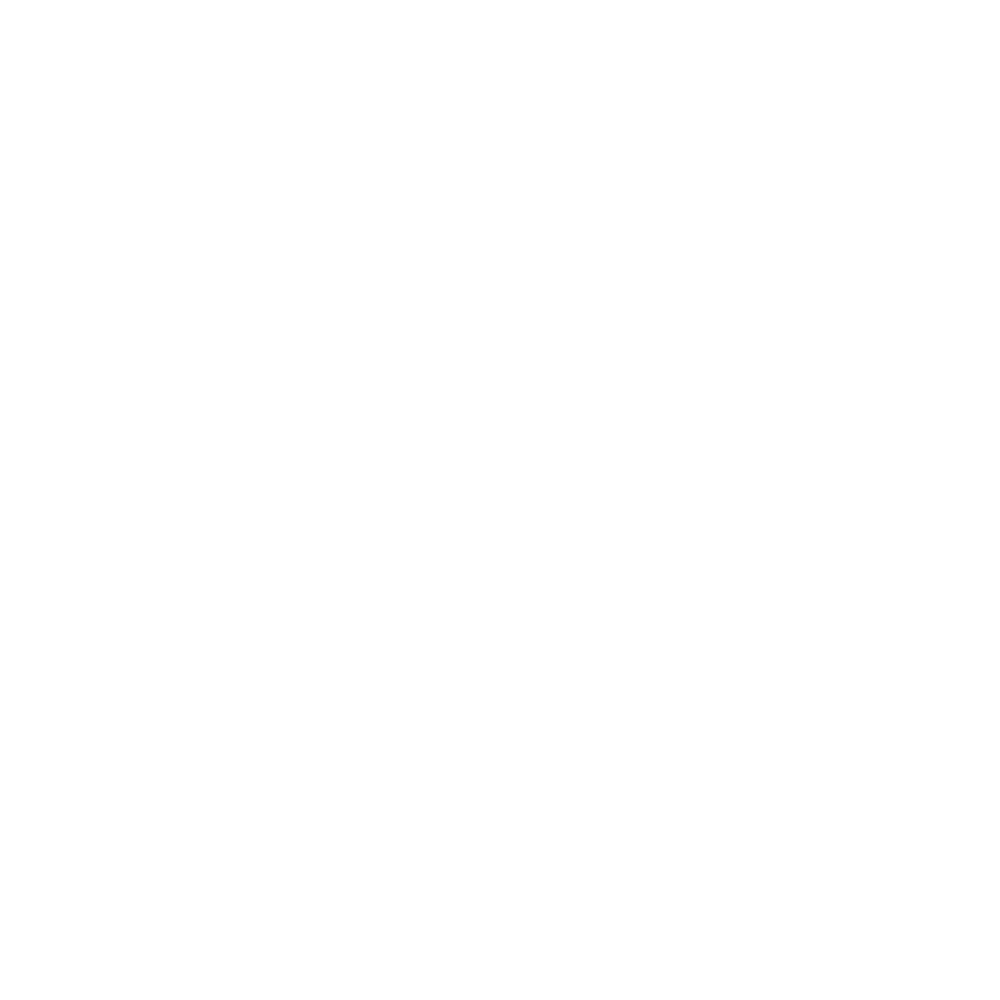

i, sweeptime =  2017-09-09 20:44:58


<IPython.core.display.Javascript object>


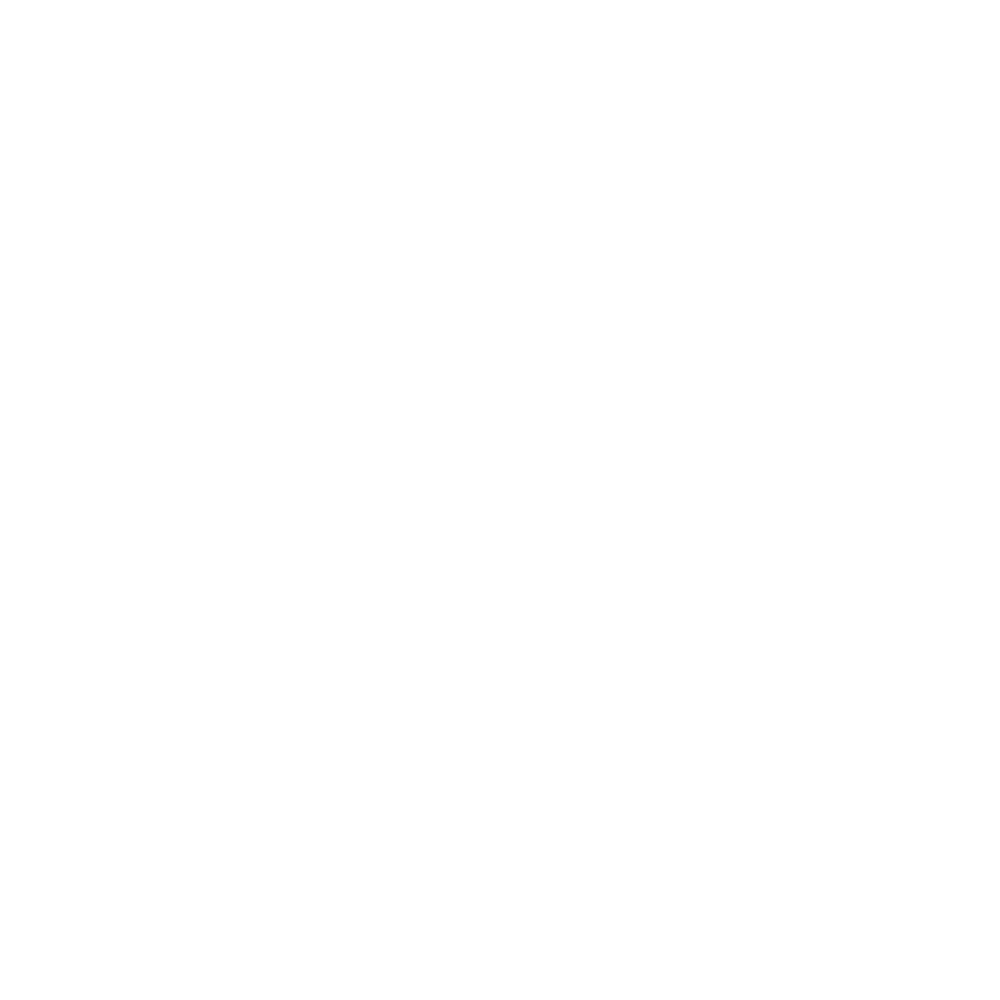

i, sweeptime =  2017-09-09 20:51:47


<IPython.core.display.Javascript object>


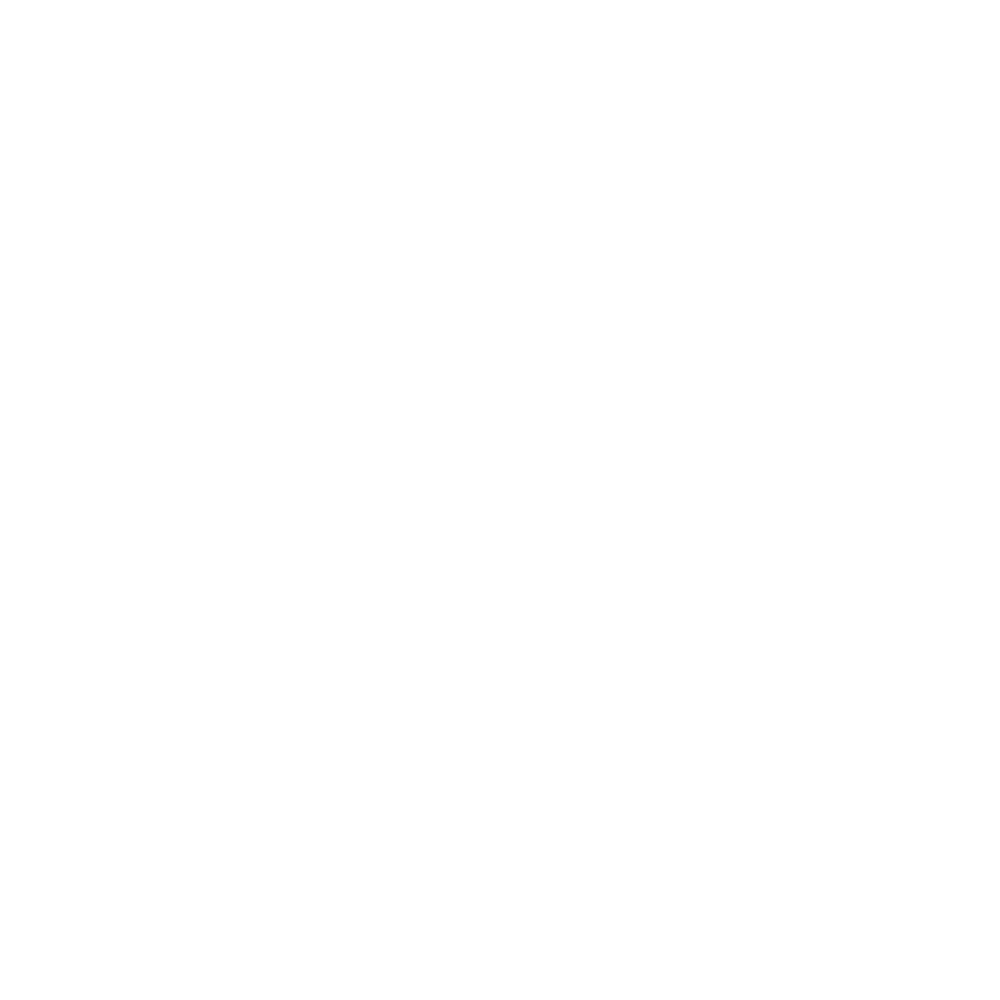

i, sweeptime =  2017-09-09 20:58:38


<IPython.core.display.Javascript object>


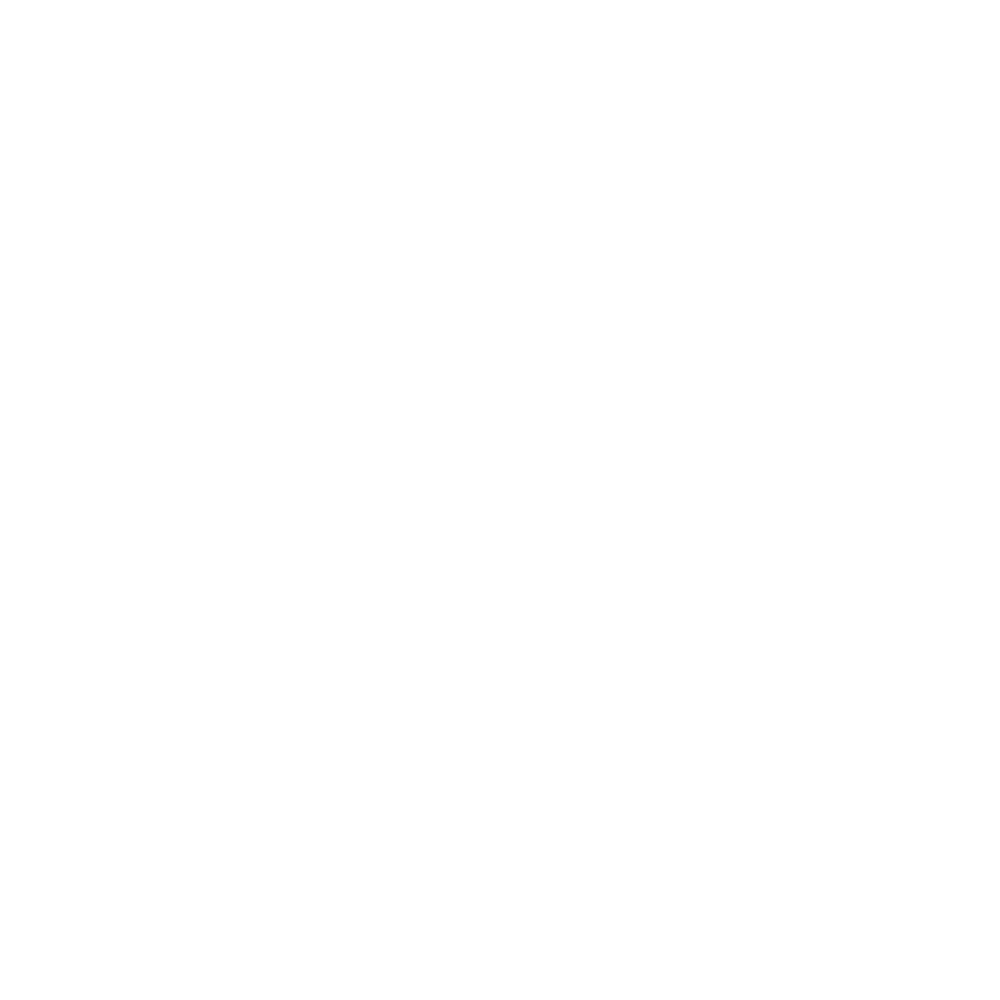

i, sweeptime =  2017-09-09 21:05:35


<IPython.core.display.Javascript object>


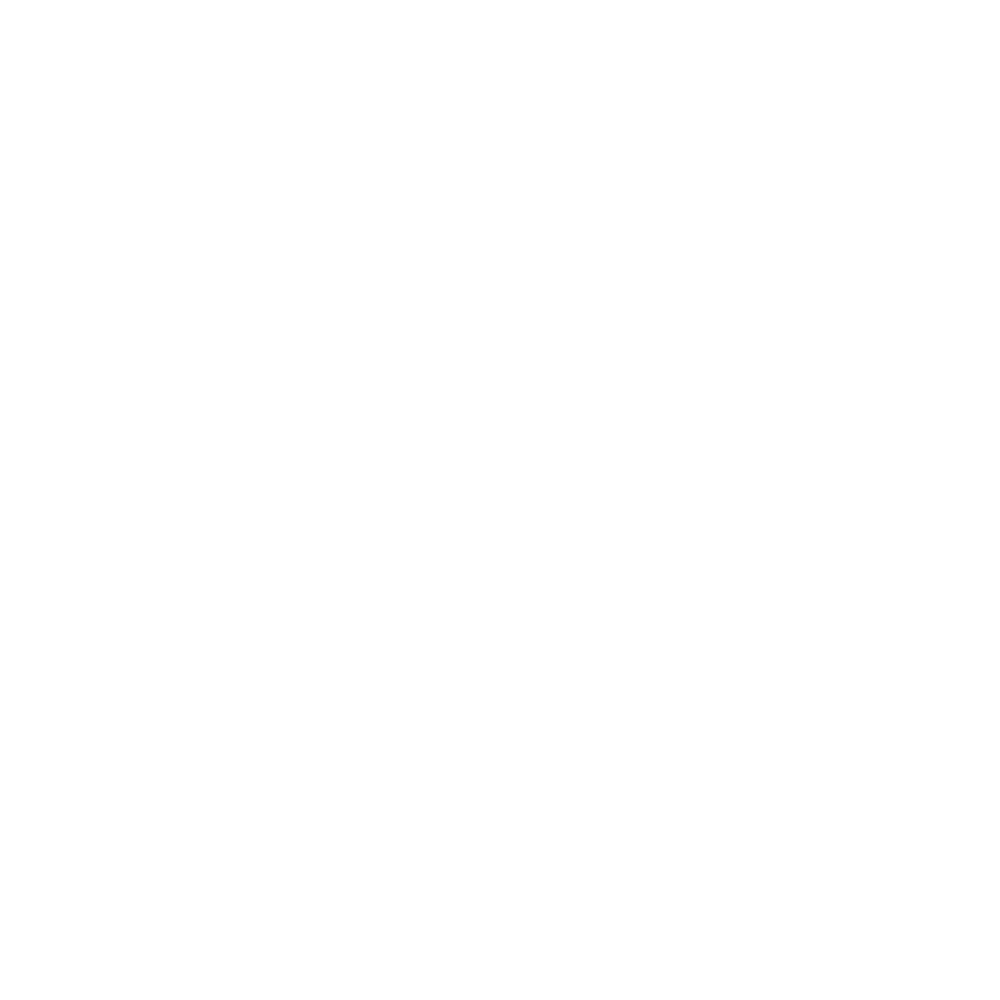

i, sweeptime =  2017-09-09 21:12:26


<IPython.core.display.Javascript object>


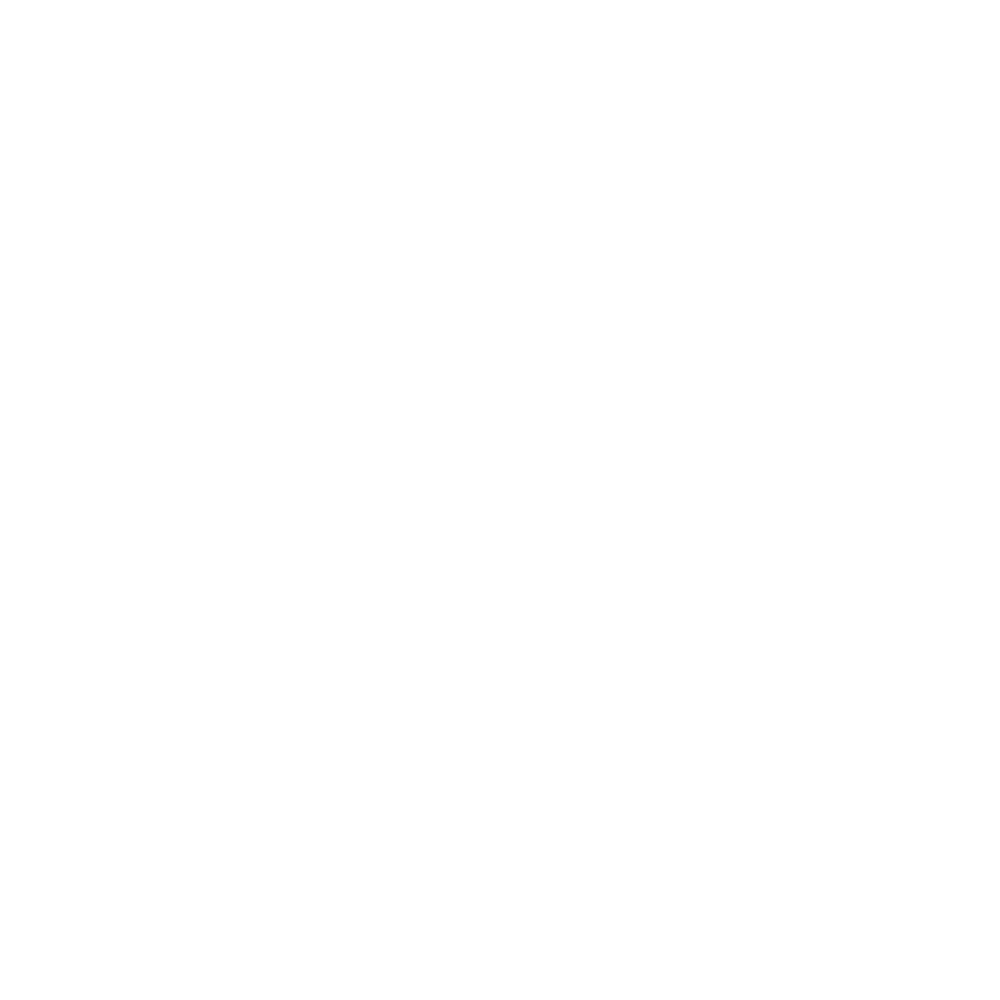

i, sweeptime =  2017-09-09 21:19:22


<IPython.core.display.Javascript object>


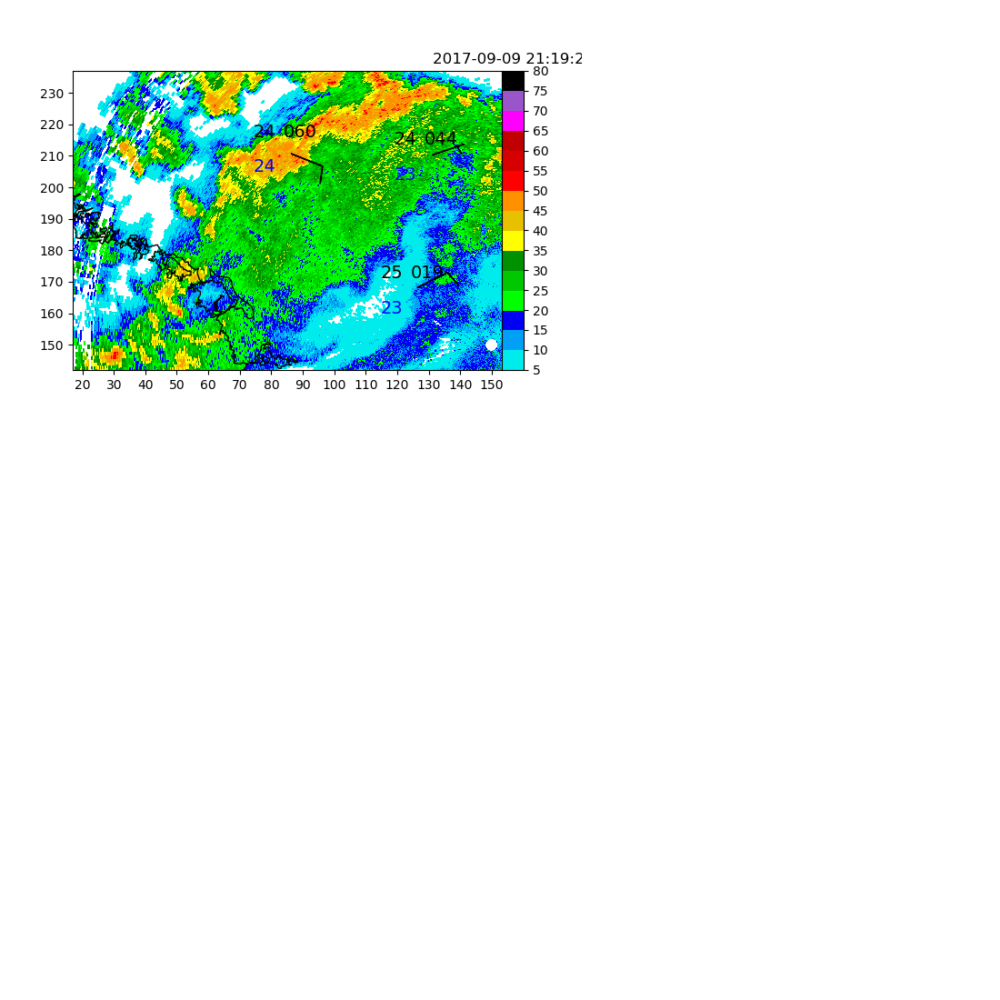

i, sweeptime =  2017-09-09 21:26:03


<IPython.core.display.Javascript object>


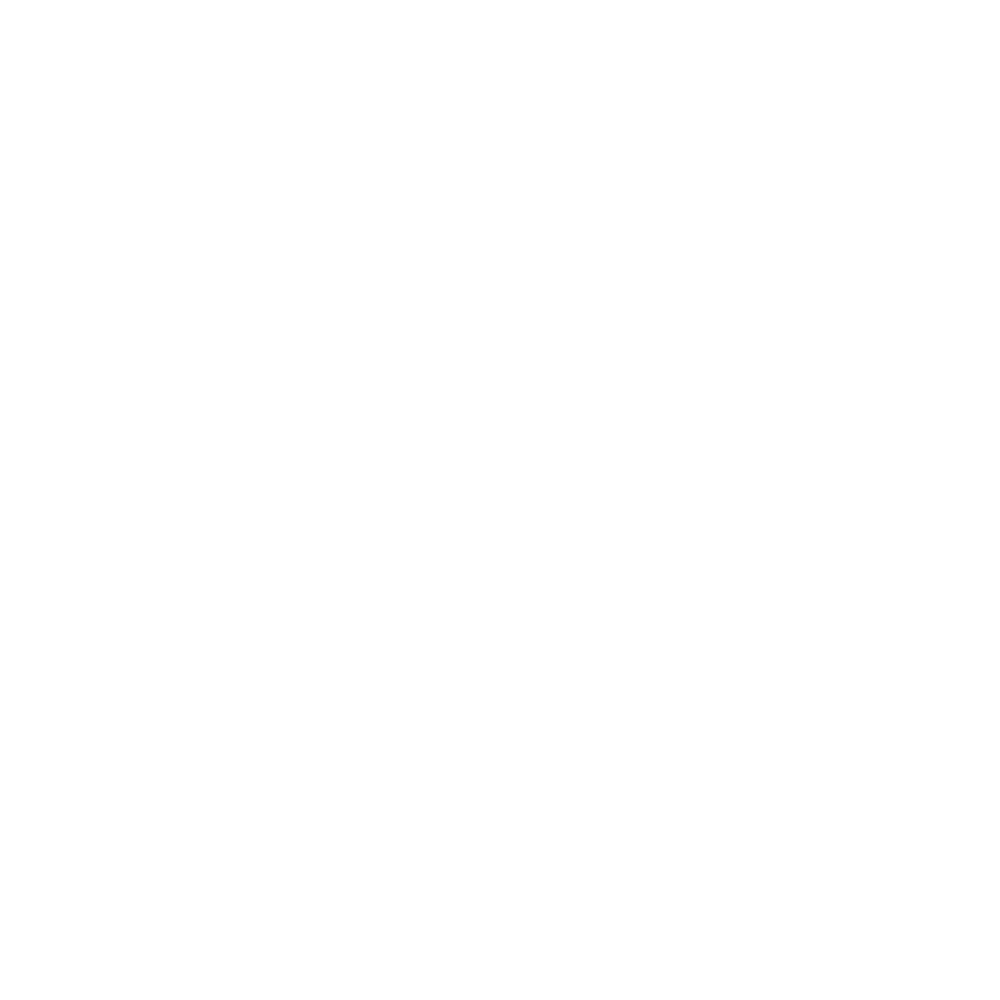

i, sweeptime =  2017-09-09 21:32:55


<IPython.core.display.Javascript object>


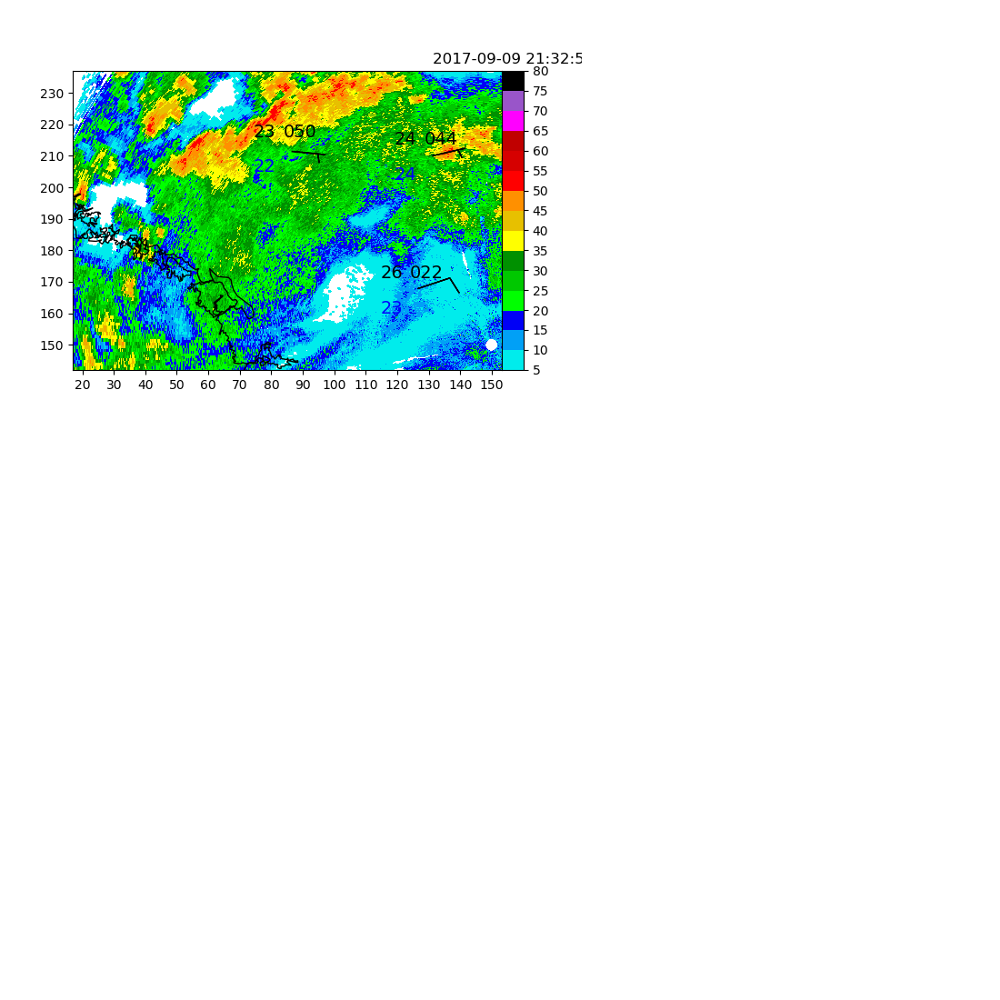

i, sweeptime =  2017-09-09 21:39:55


<IPython.core.display.Javascript object>


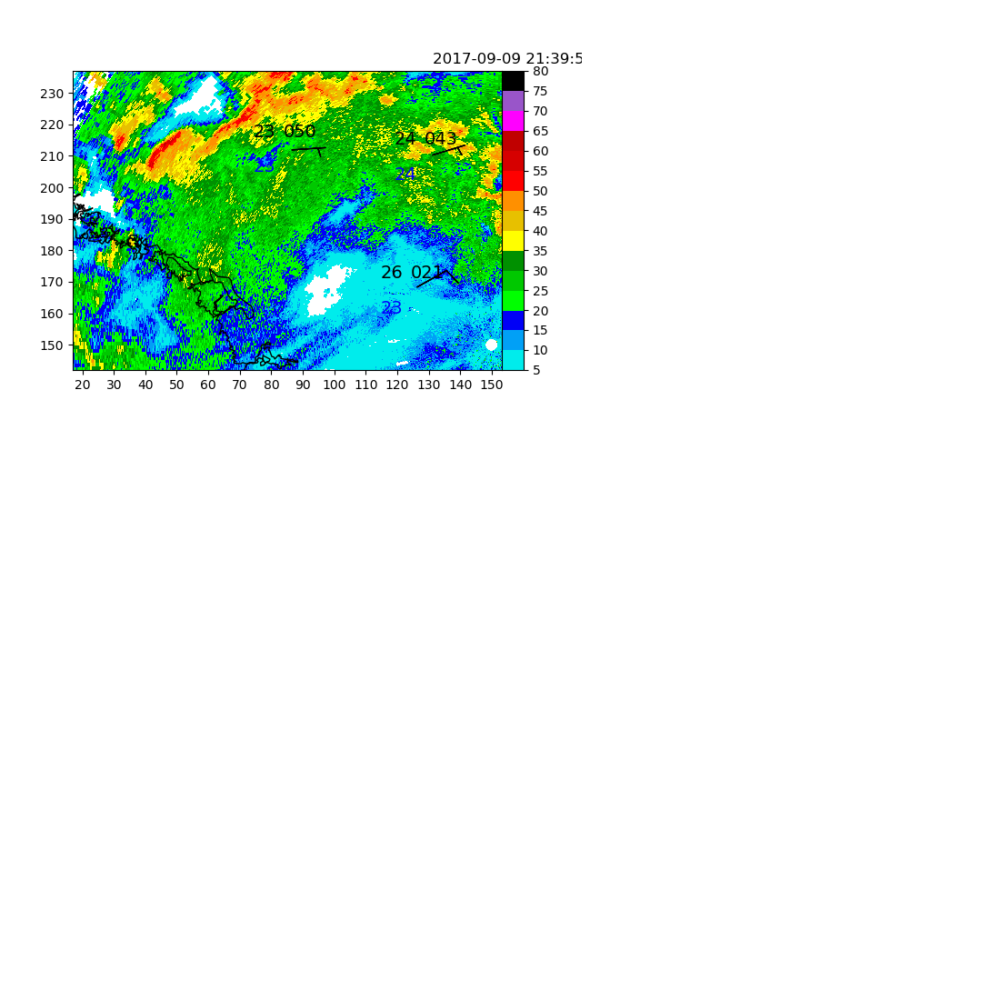

i, sweeptime =  2017-09-09 21:46:49


<IPython.core.display.Javascript object>


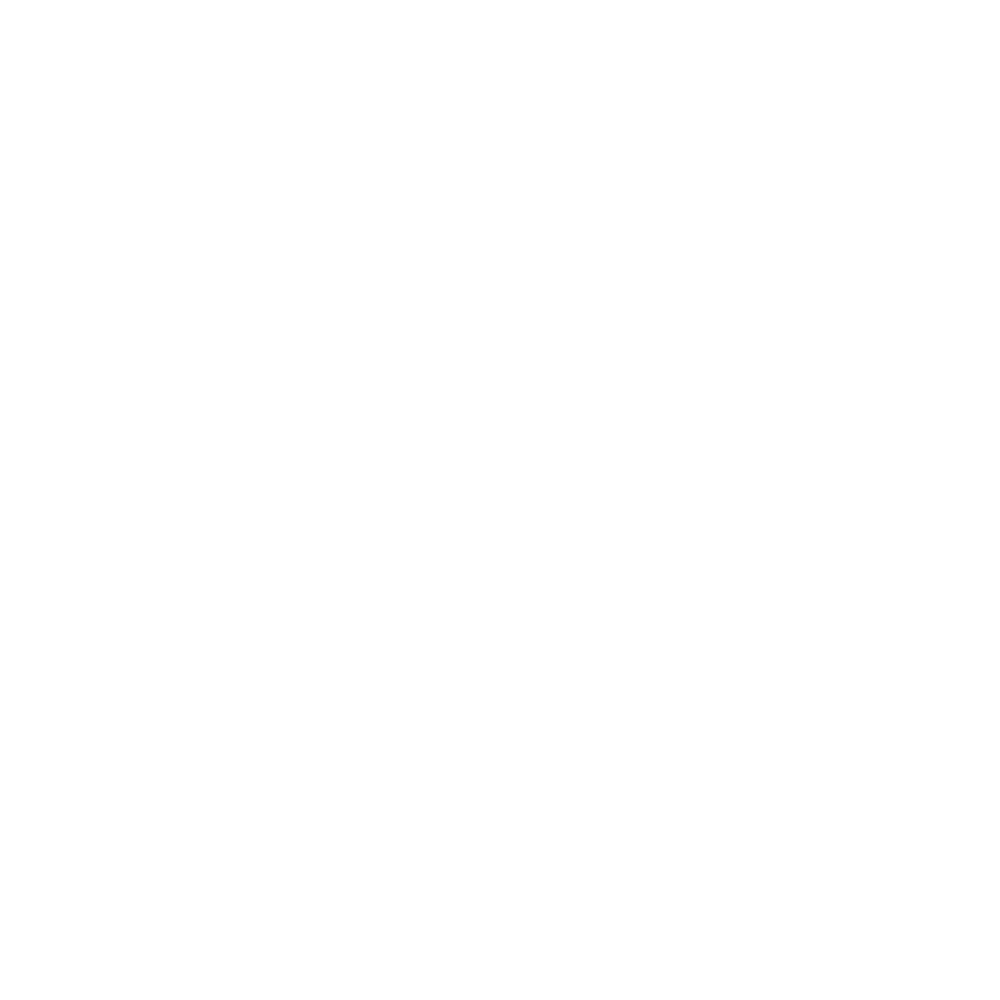

i, sweeptime =  2017-09-09 21:53:23


<IPython.core.display.Javascript object>


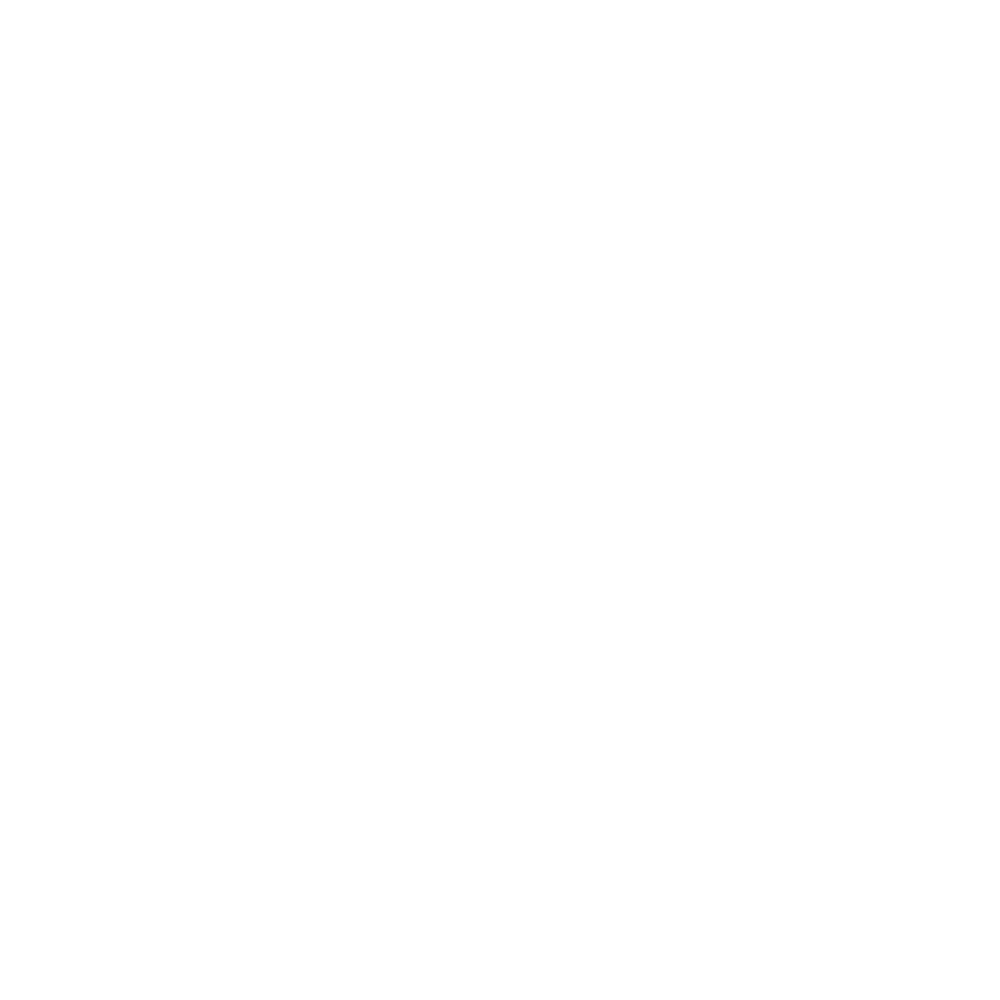

i, sweeptime =  2017-09-09 22:00:14


<IPython.core.display.Javascript object>


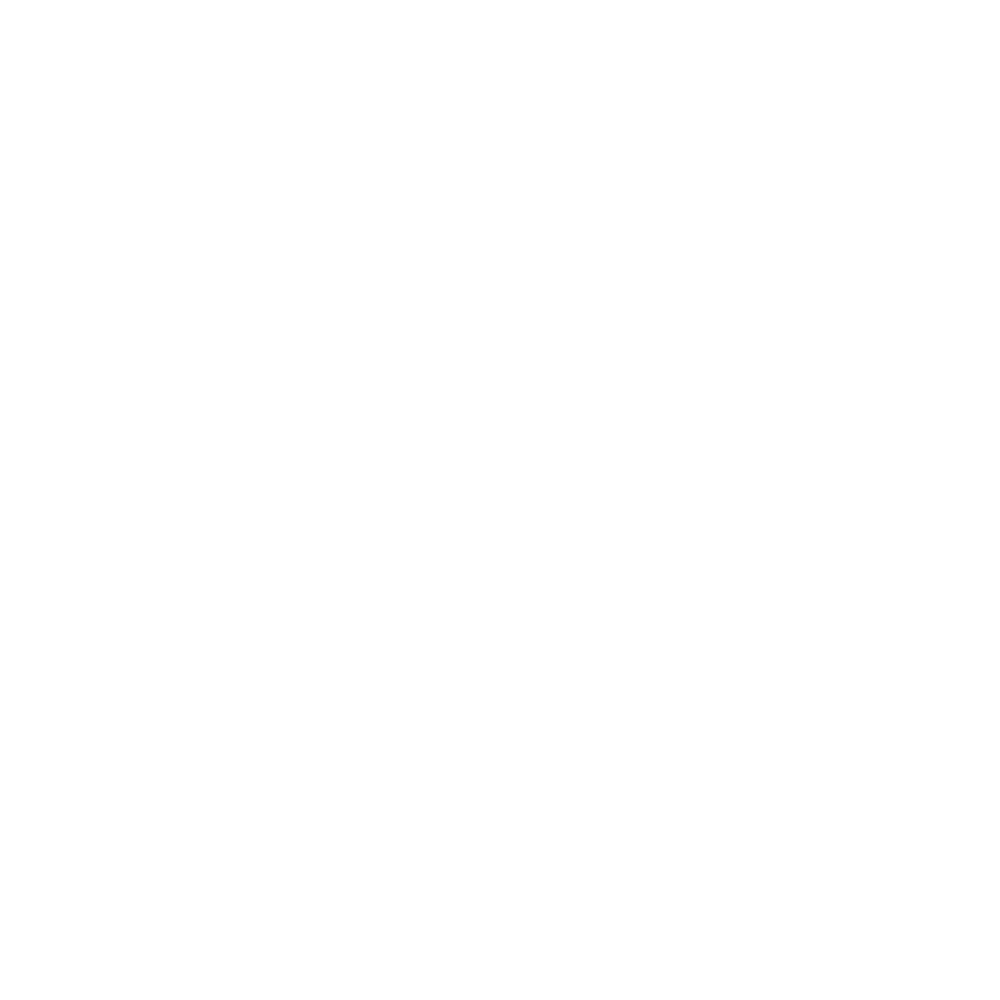

i, sweeptime =  2017-09-09 22:07:14


<IPython.core.display.Javascript object>


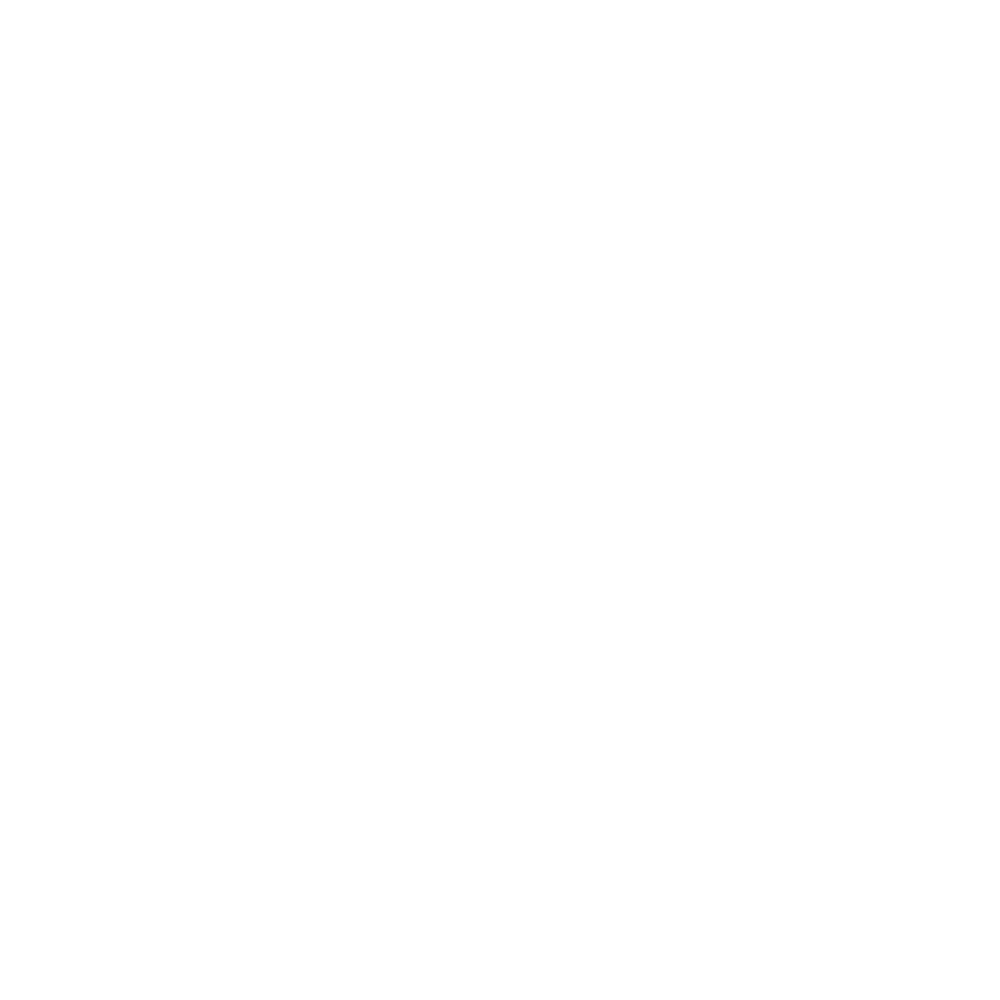

i, sweeptime =  2017-09-09 22:14:11


<IPython.core.display.Javascript object>


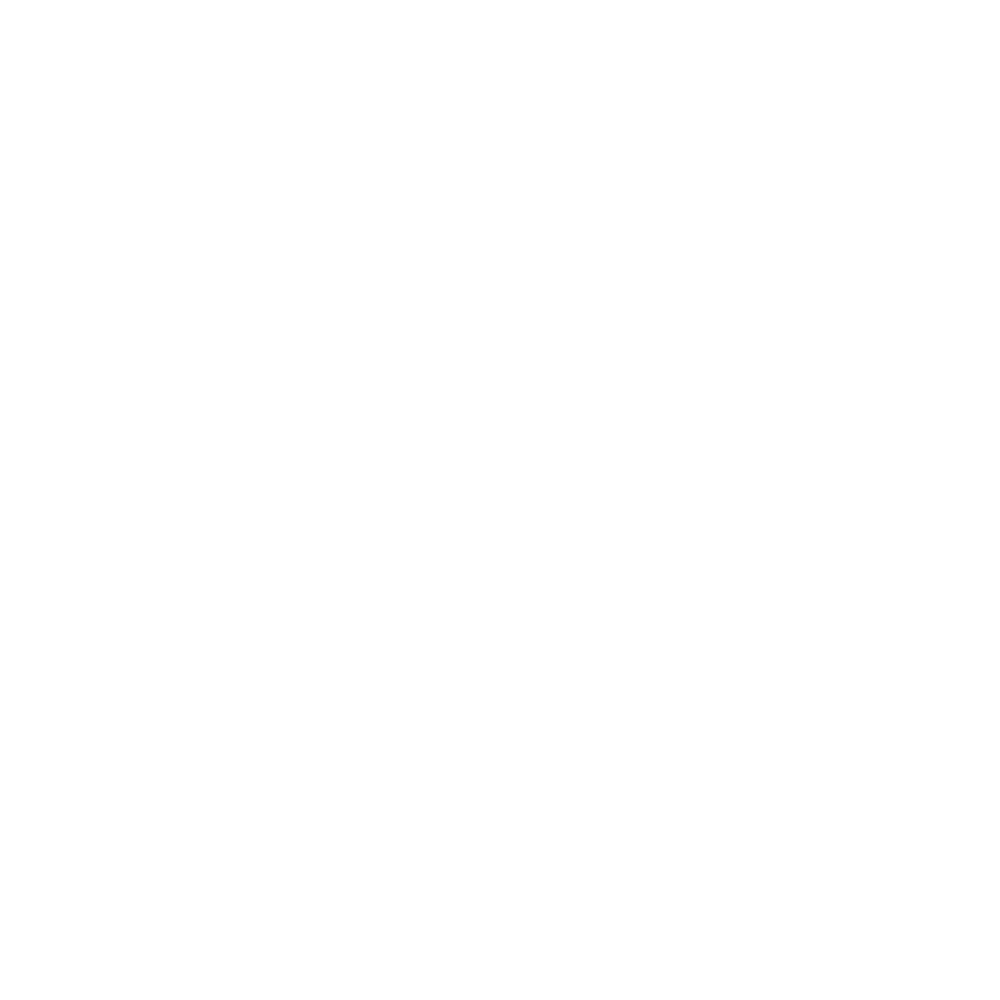

i, sweeptime =  2017-09-09 22:20:49


<IPython.core.display.Javascript object>


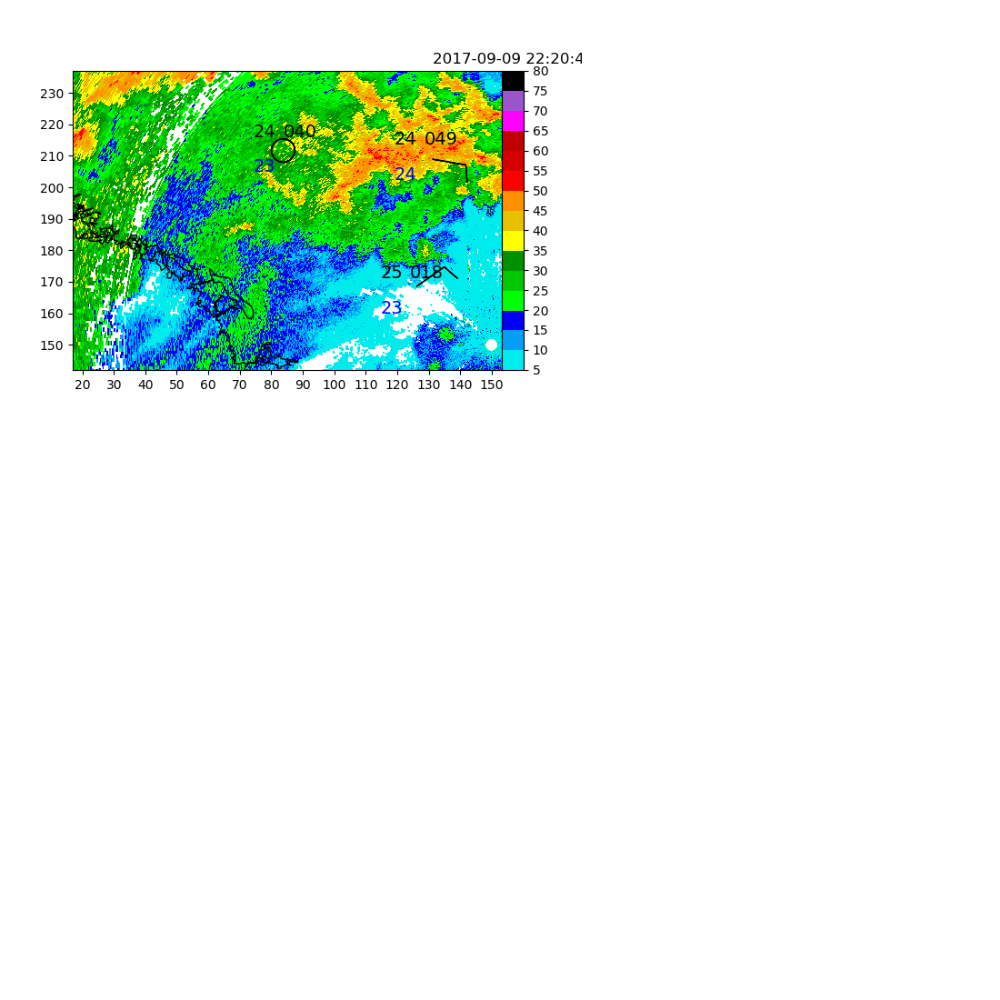

i, sweeptime =  2017-09-09 22:27:19


<IPython.core.display.Javascript object>


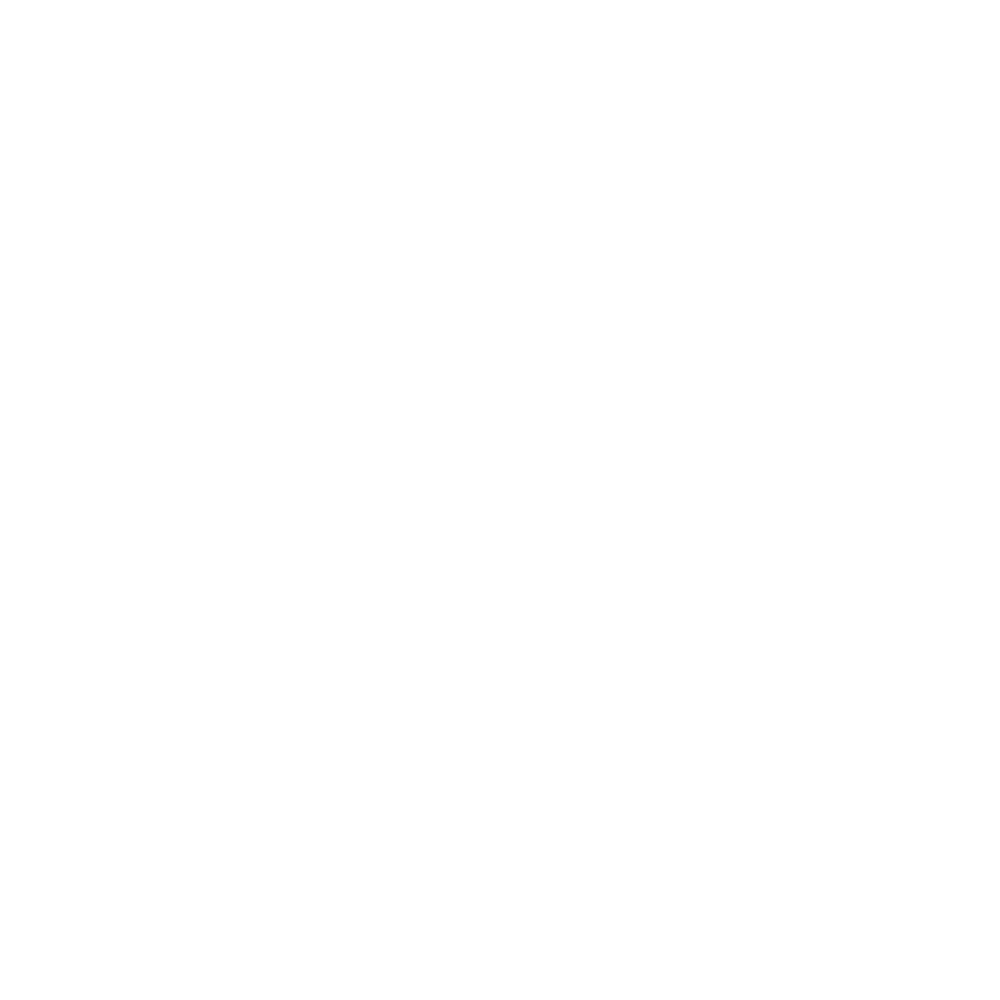

i, sweeptime =  2017-09-09 22:33:50


<IPython.core.display.Javascript object>


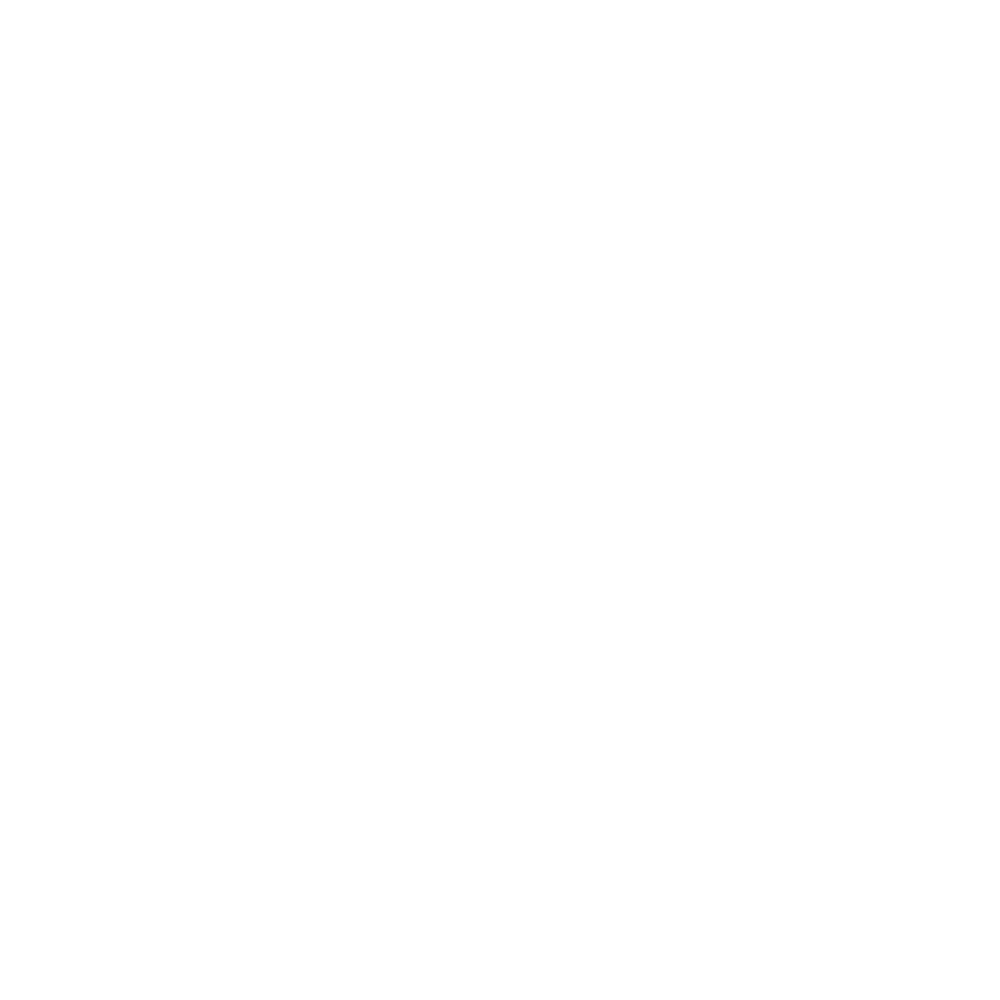

i, sweeptime =  2017-09-09 22:40:22


<IPython.core.display.Javascript object>


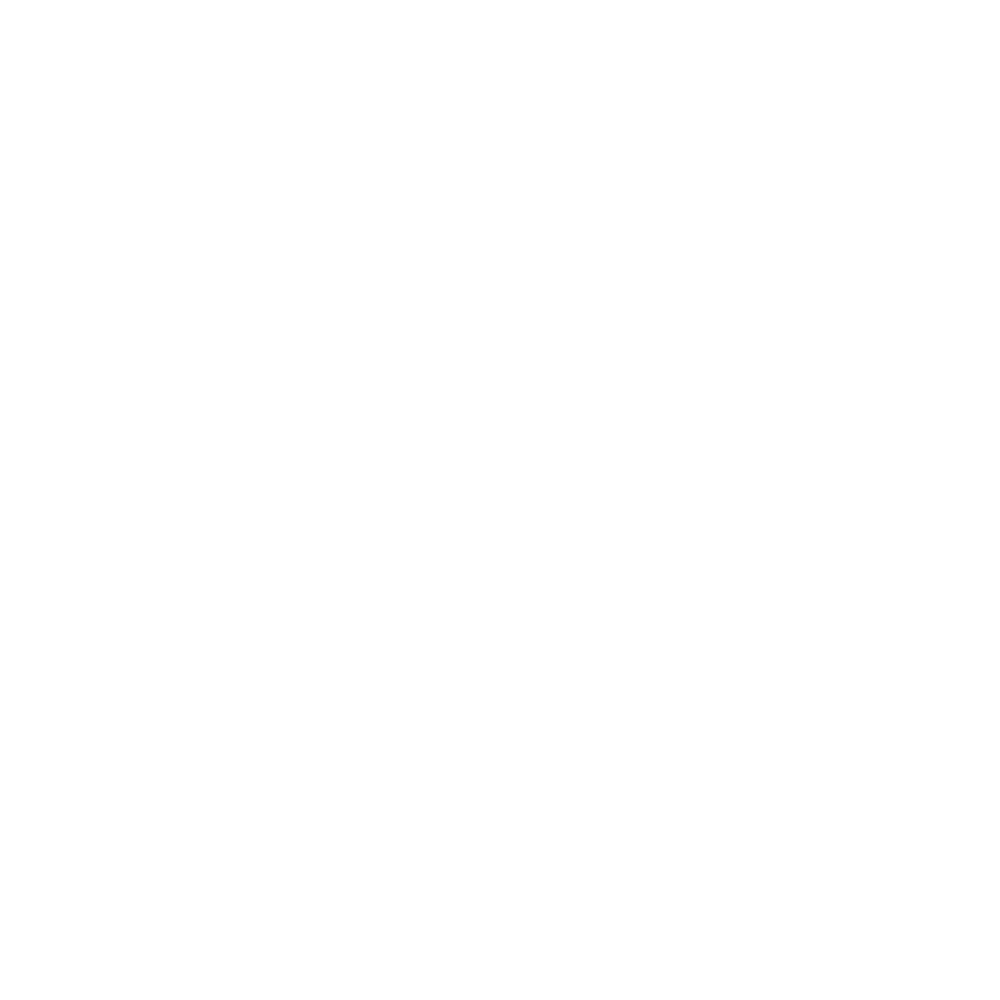

i, sweeptime =  2017-09-09 22:47:03


<IPython.core.display.Javascript object>


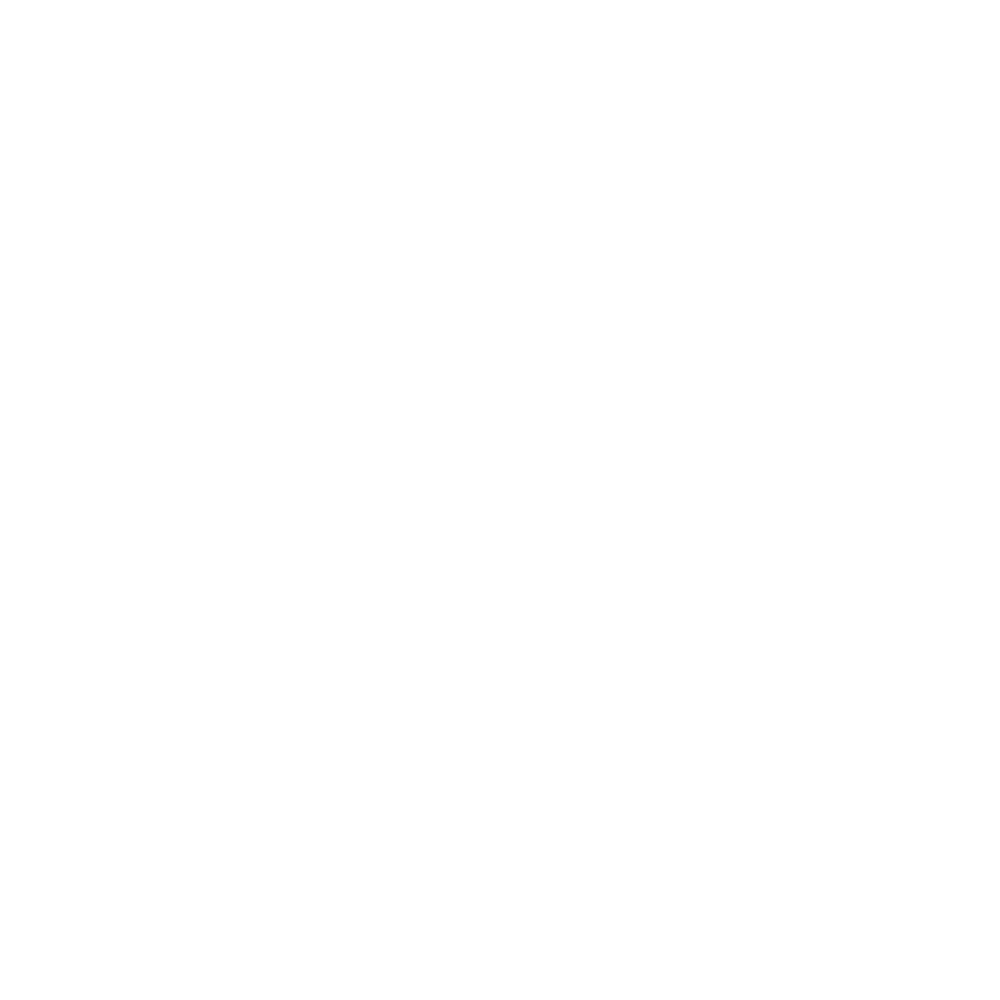

i, sweeptime =  2017-09-09 22:53:52


<IPython.core.display.Javascript object>


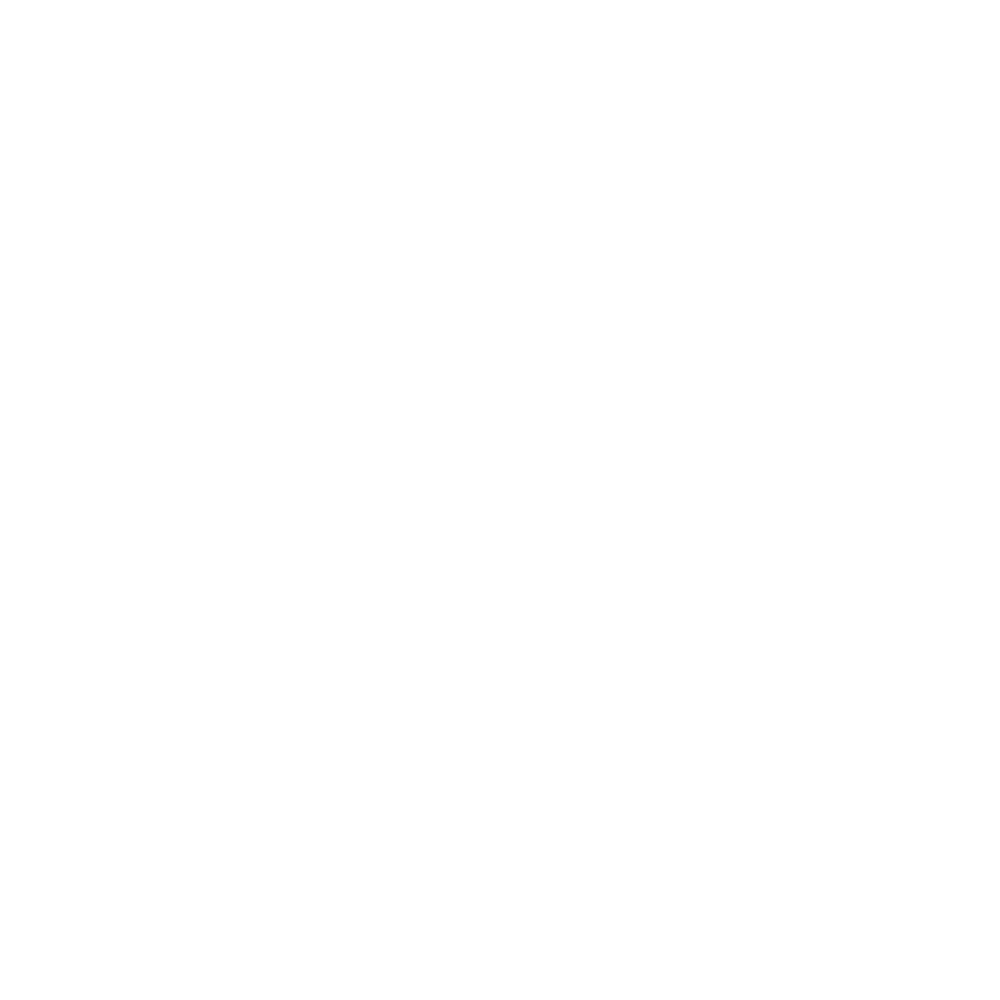

i, sweeptime =  2017-09-09 23:00:36


<IPython.core.display.Javascript object>


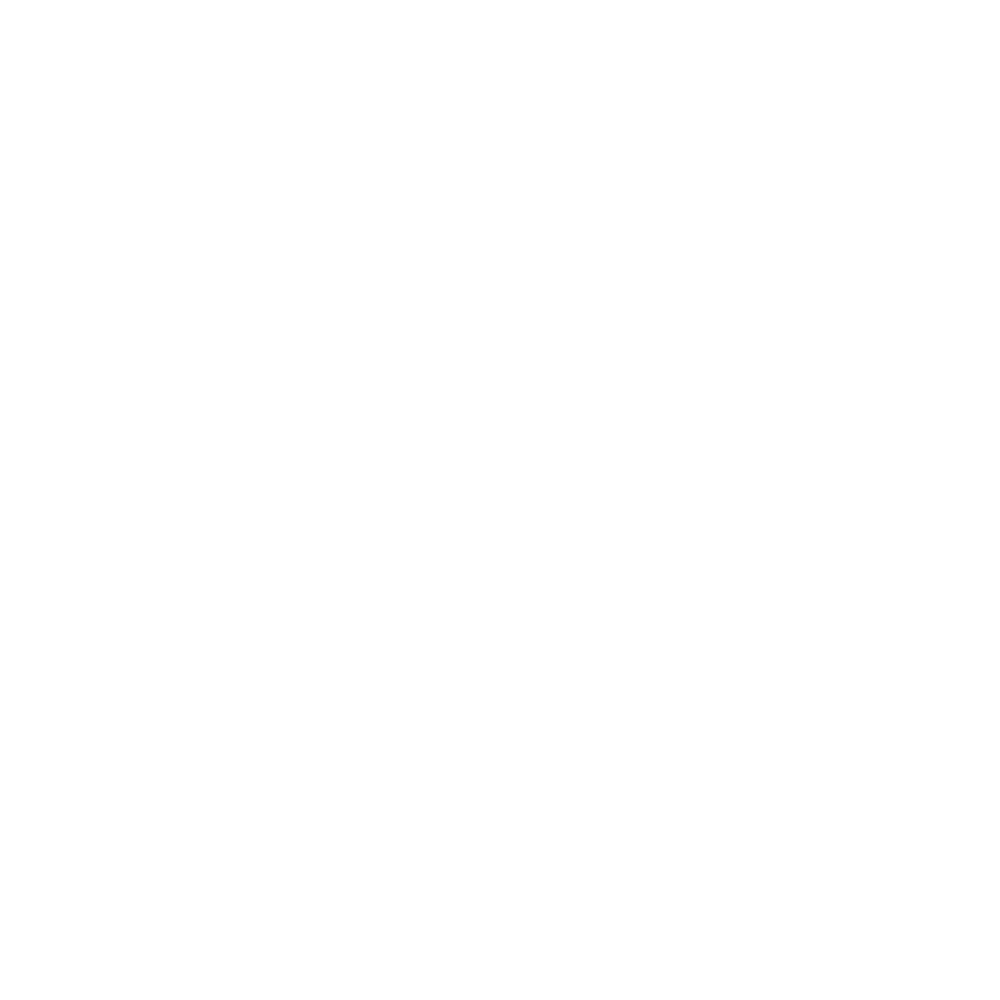

i, sweeptime =  2017-09-09 23:07:12


<IPython.core.display.Javascript object>


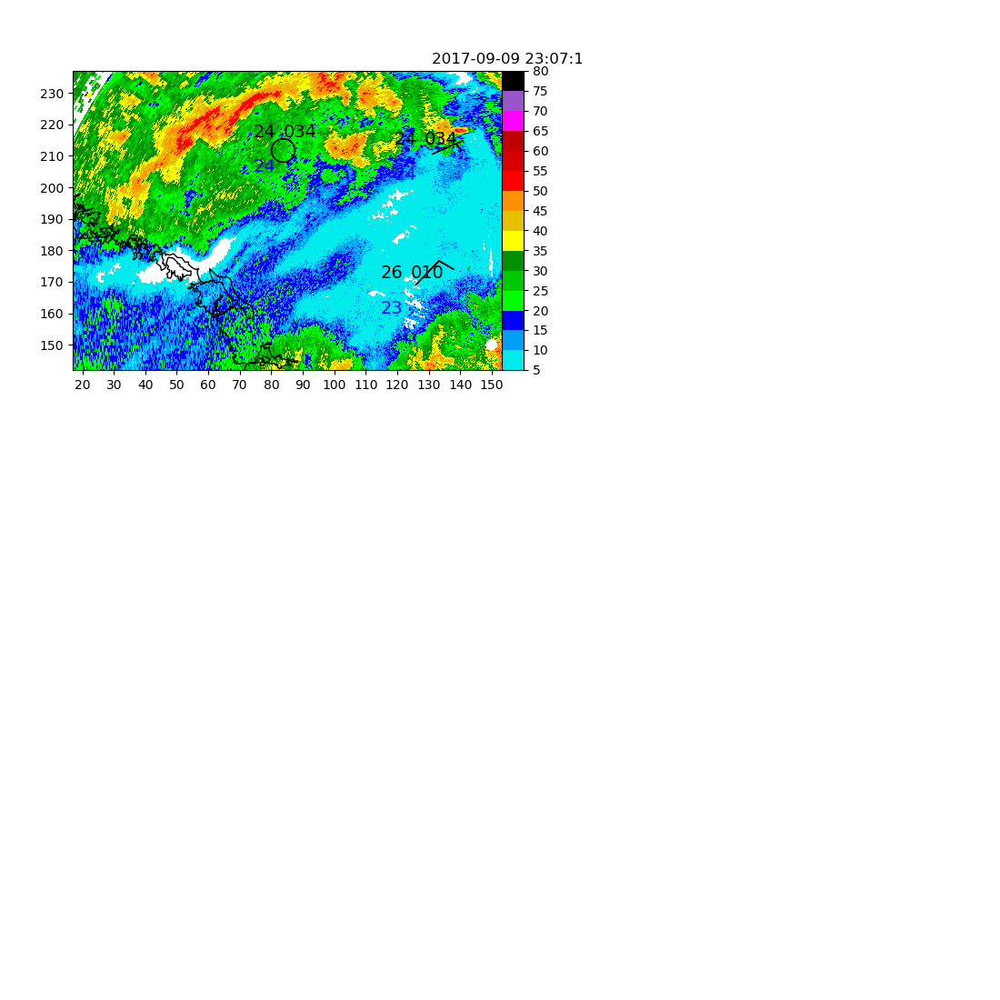

i, sweeptime =  2017-09-09 23:14:08


<IPython.core.display.Javascript object>


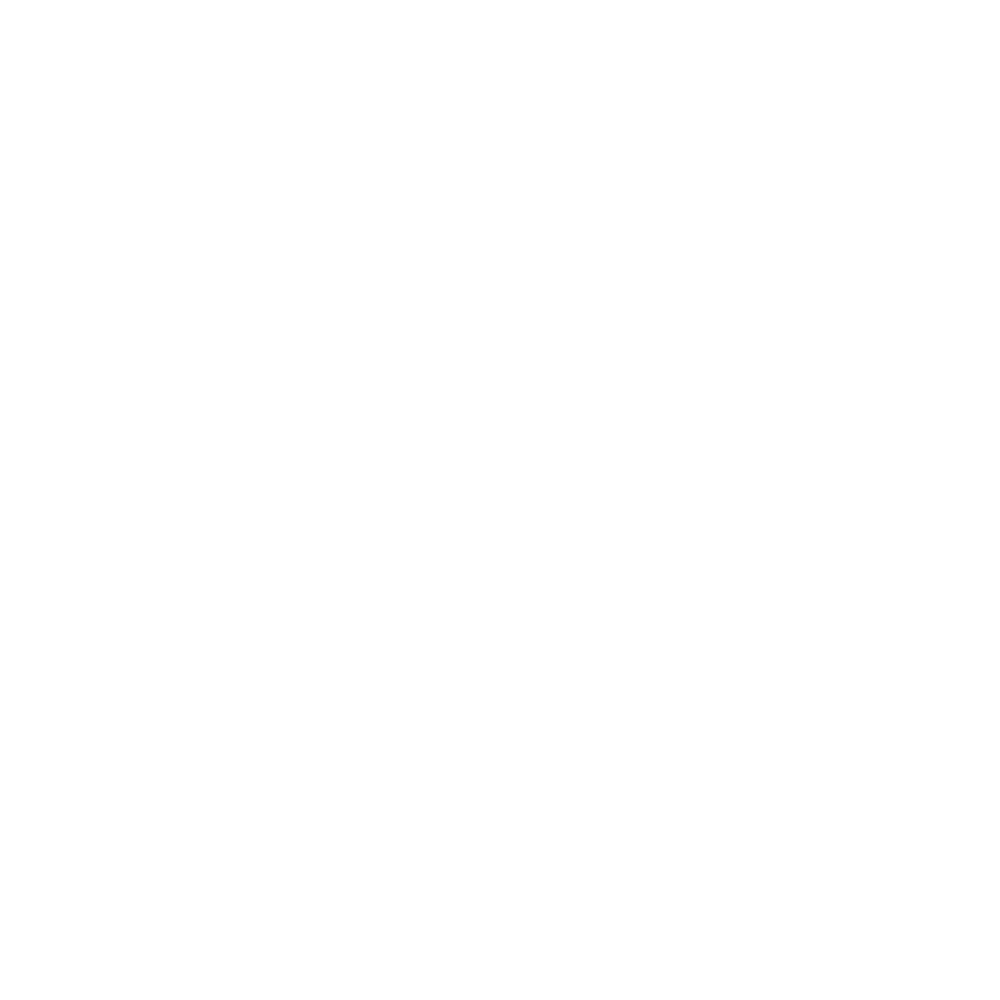

i, sweeptime =  2017-09-09 23:20:48


<IPython.core.display.Javascript object>


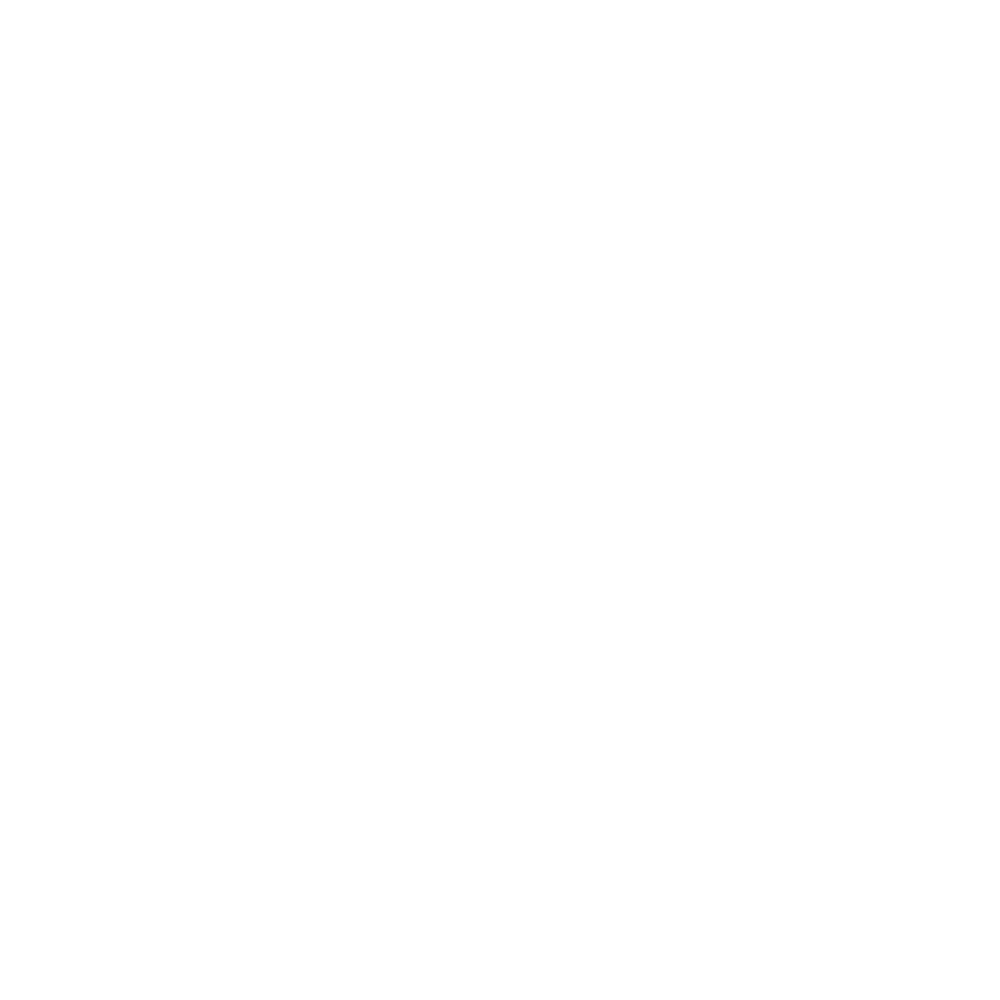

i, sweeptime =  2017-09-09 23:27:30


<IPython.core.display.Javascript object>


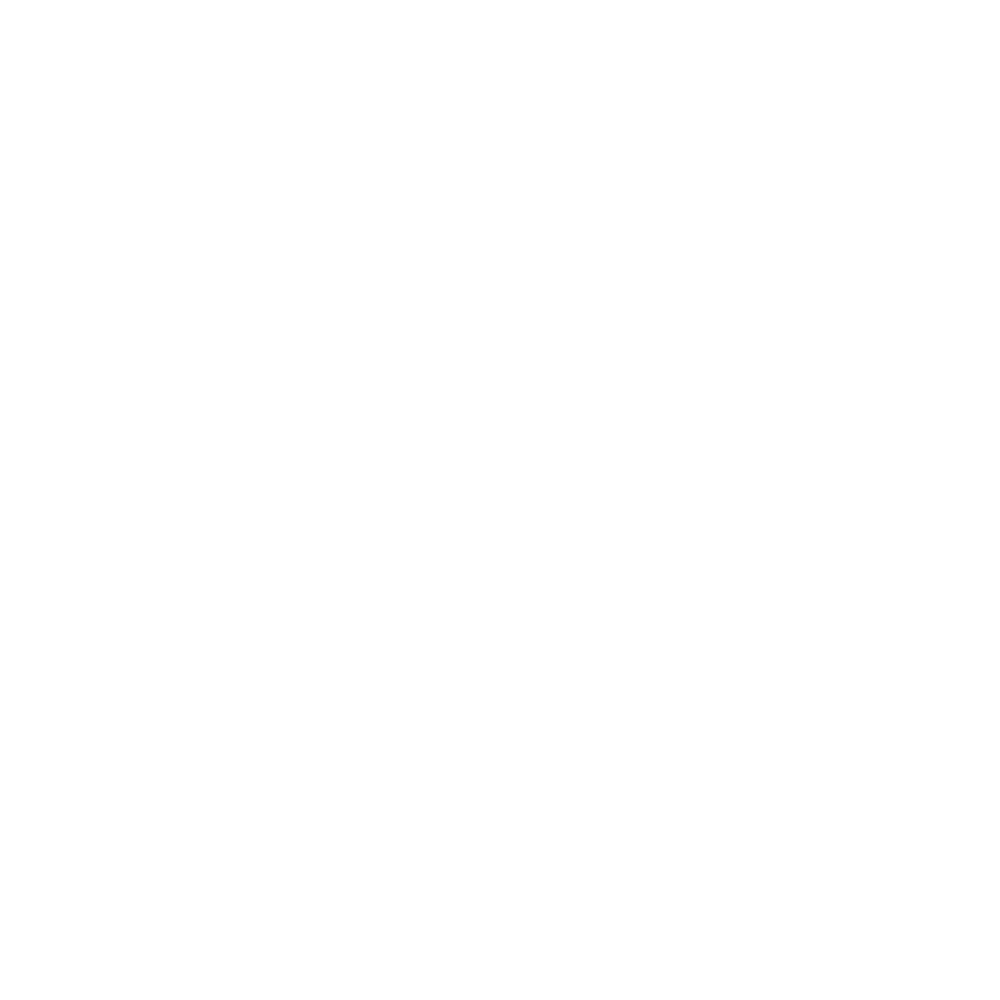

i, sweeptime =  2017-09-09 23:34:31


<IPython.core.display.Javascript object>


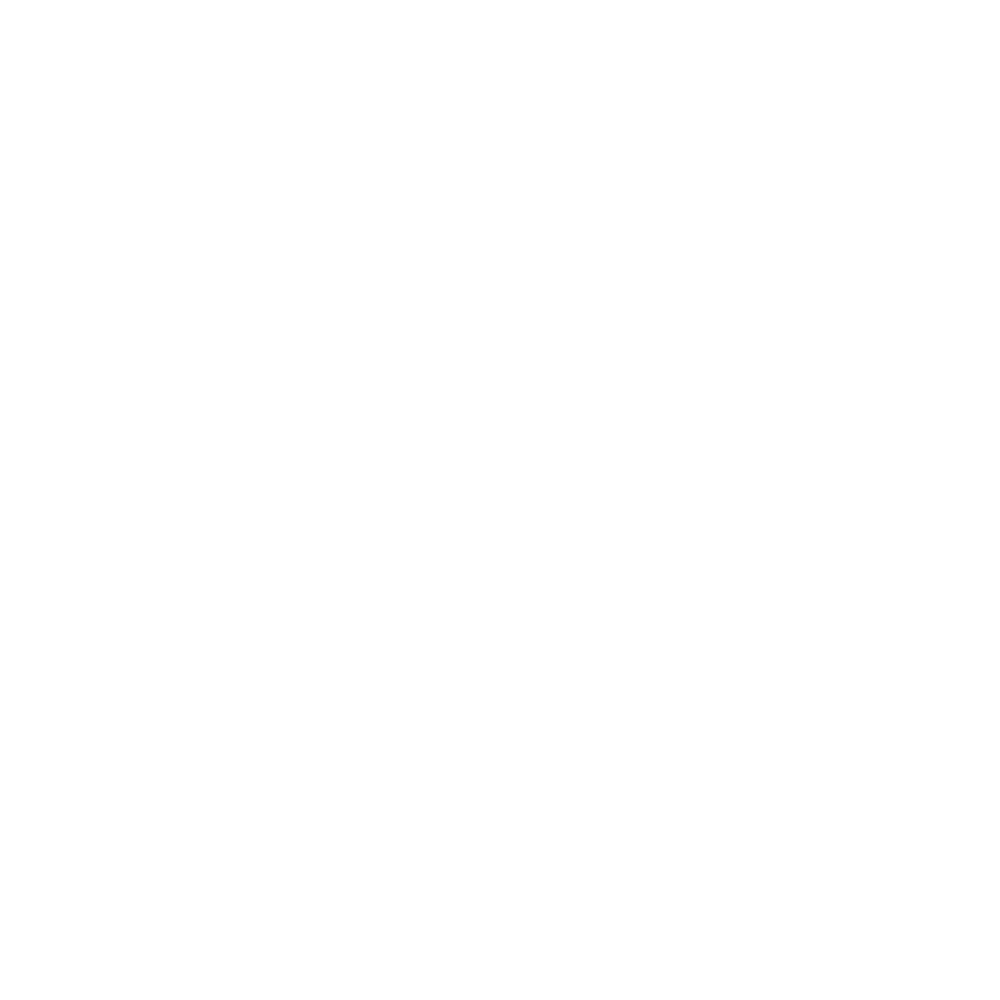

i, sweeptime =  2017-09-09 23:41:26


<IPython.core.display.Javascript object>


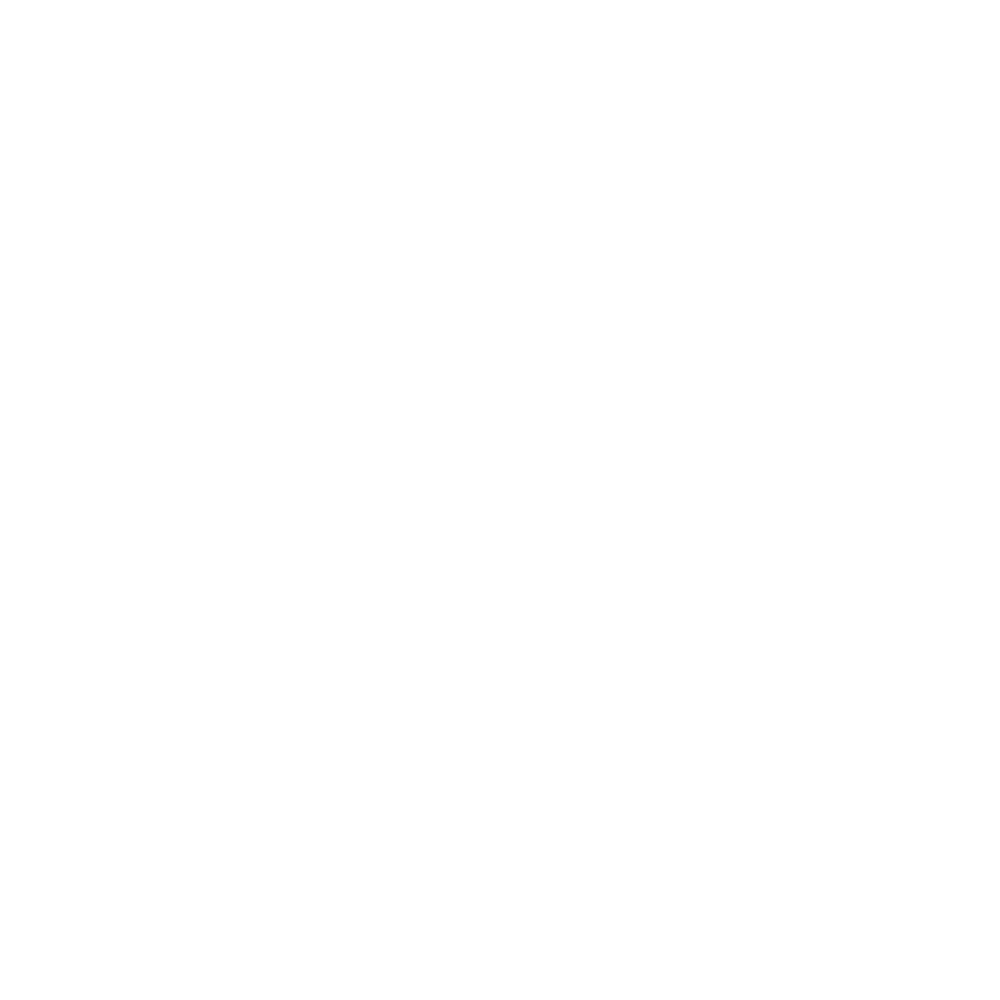

i, sweeptime =  2017-09-09 23:48:06


<IPython.core.display.Javascript object>


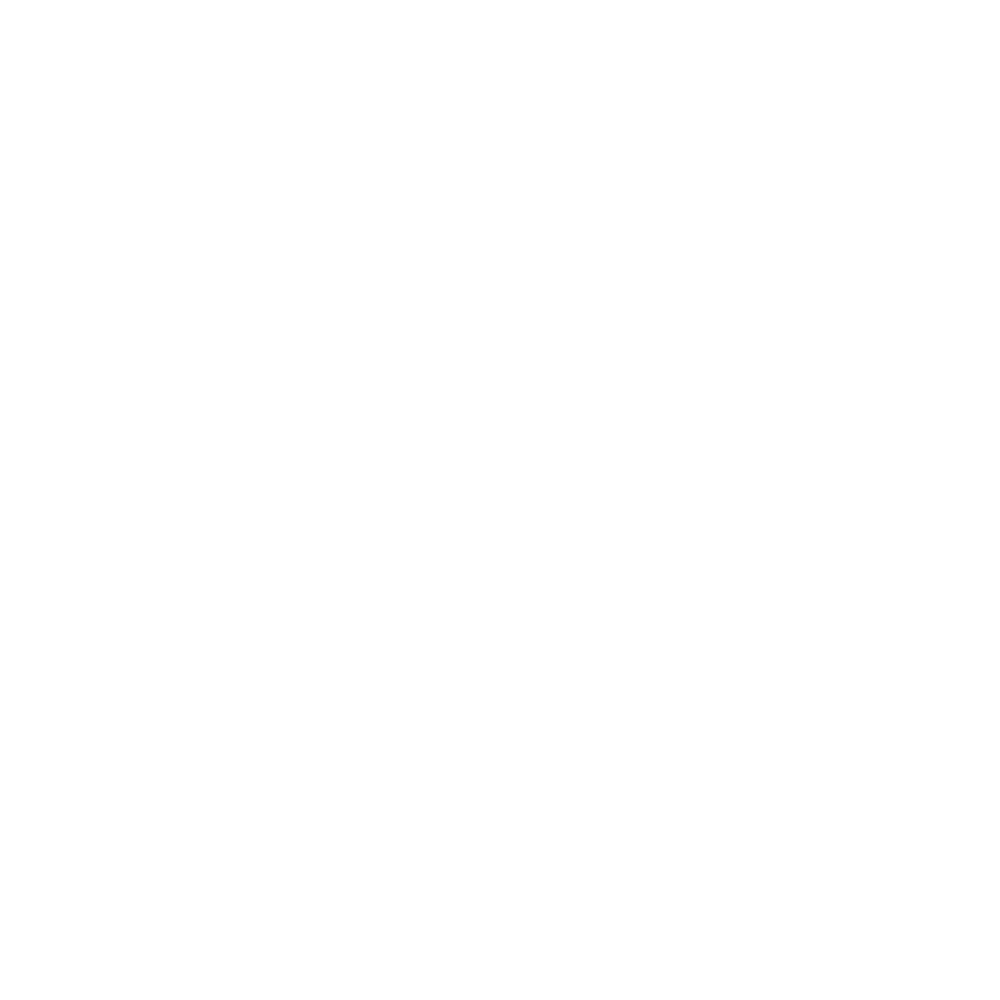

i, sweeptime =  2017-09-09 23:54:45


<IPython.core.display.Javascript object>


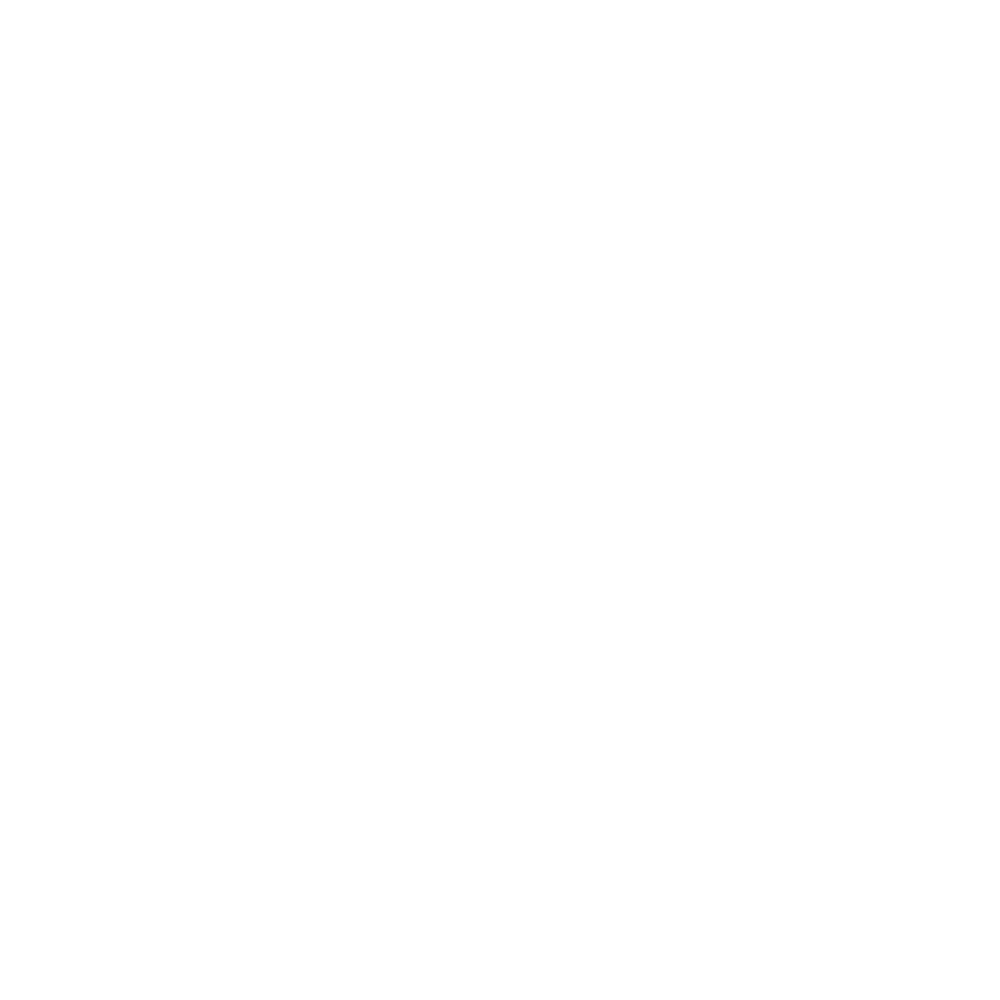

i, sweeptime =  2017-09-10 00:01:22


<IPython.core.display.Javascript object>


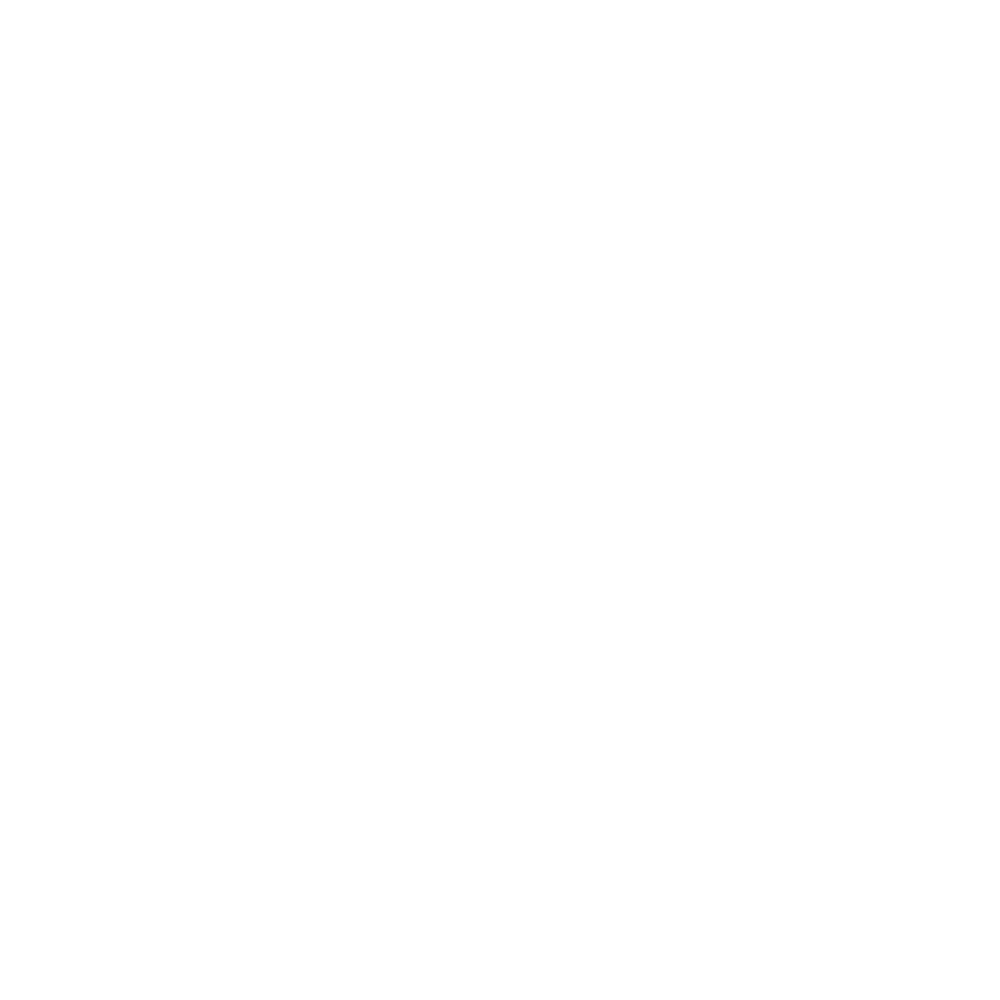

i, sweeptime =  2017-09-10 00:07:56


<IPython.core.display.Javascript object>


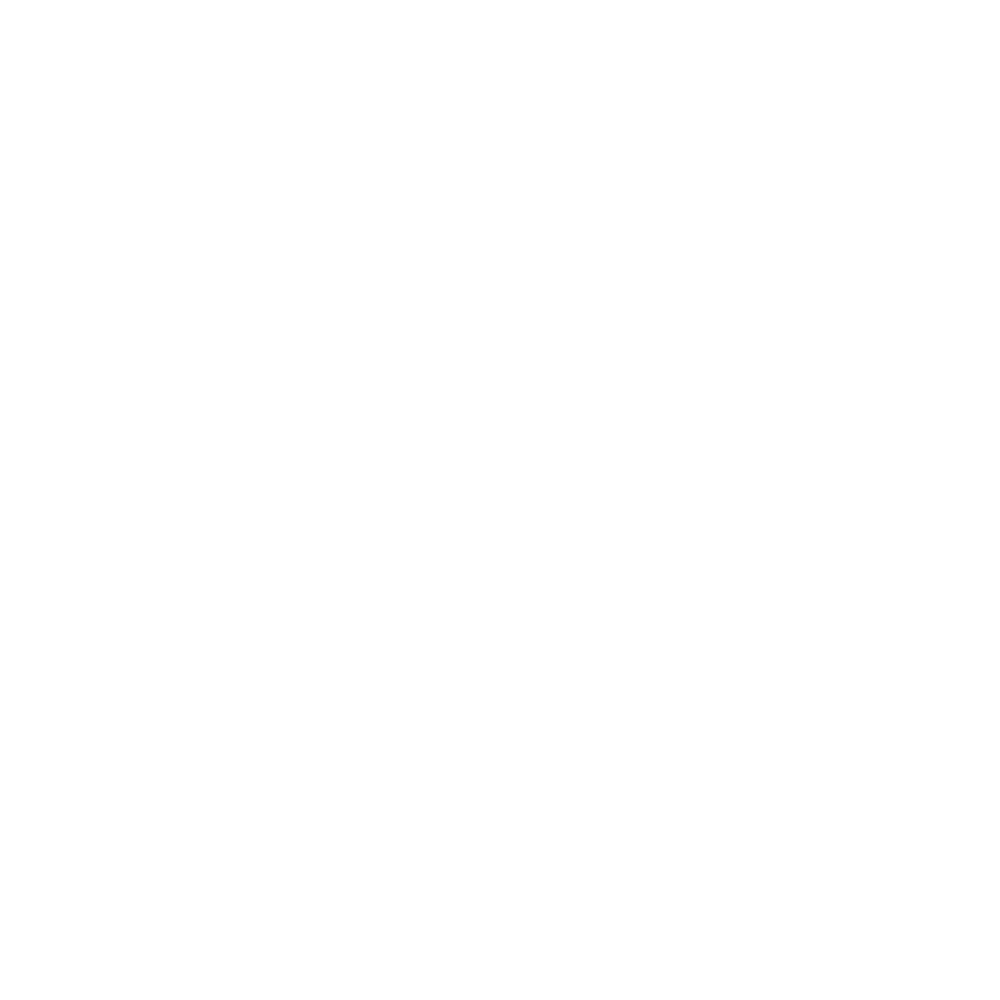

i, sweeptime =  2017-09-10 00:14:43


<IPython.core.display.Javascript object>


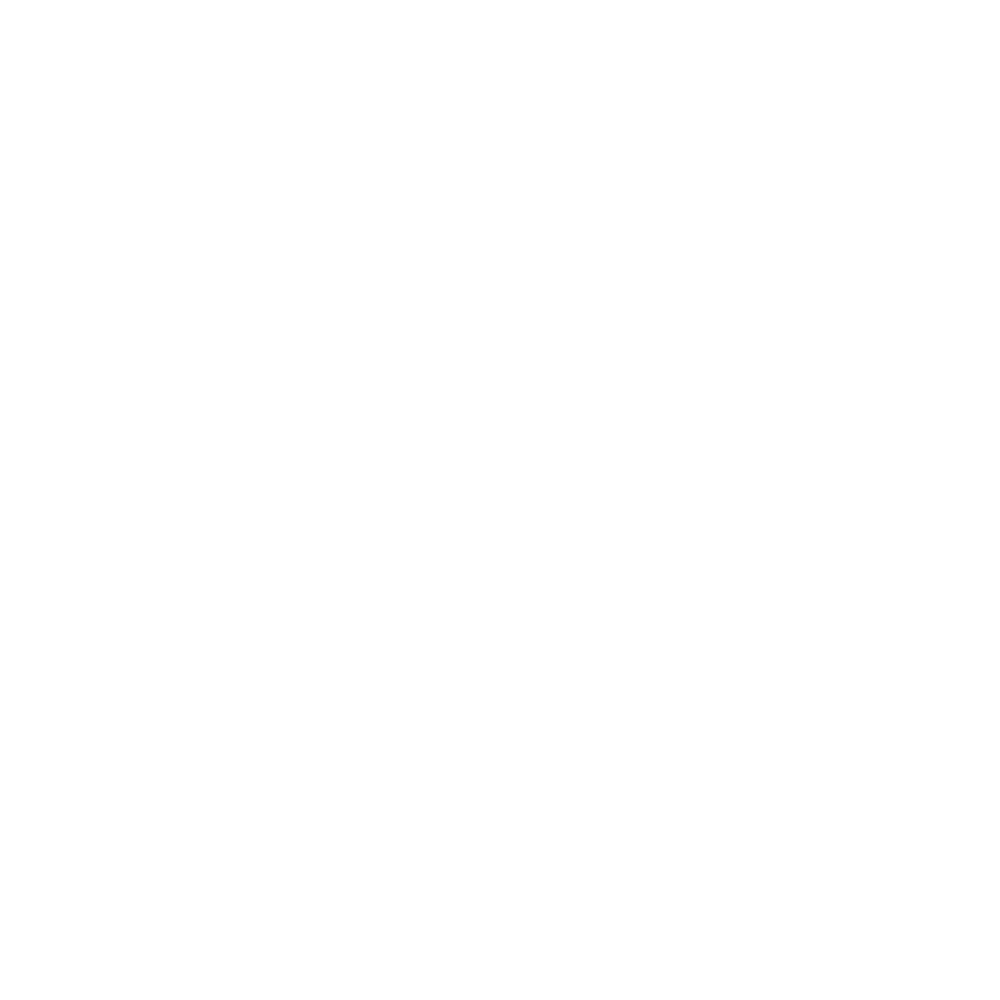

i, sweeptime =  2017-09-10 00:21:24


<IPython.core.display.Javascript object>


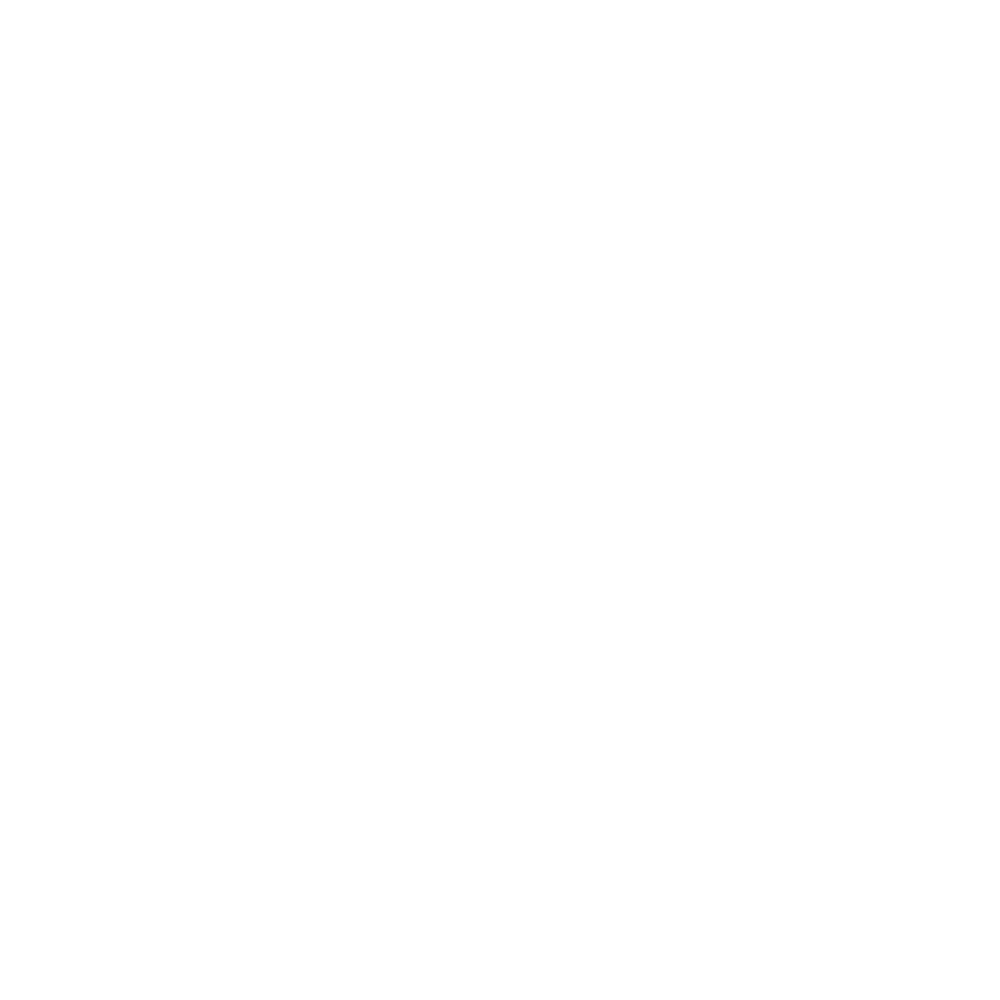

i, sweeptime =  2017-09-10 00:28:11


<IPython.core.display.Javascript object>


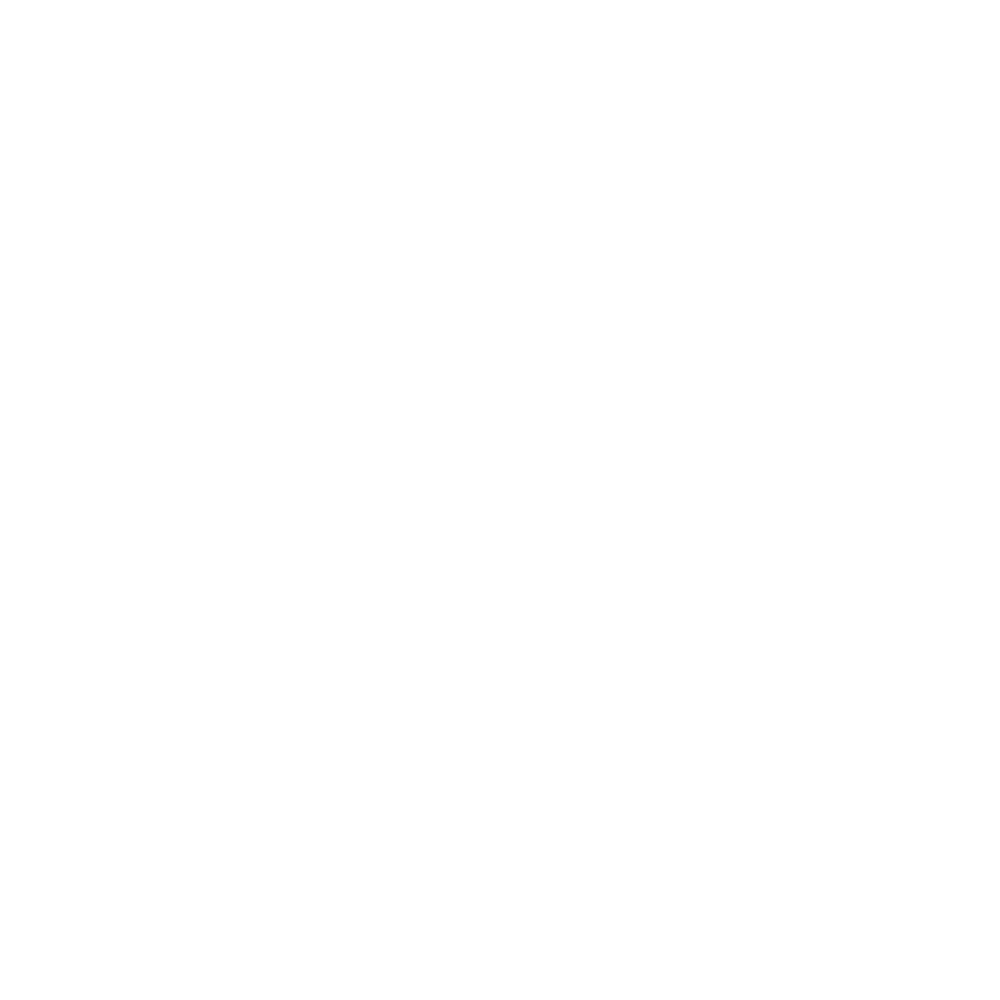

i, sweeptime =  2017-09-10 00:34:41


<IPython.core.display.Javascript object>


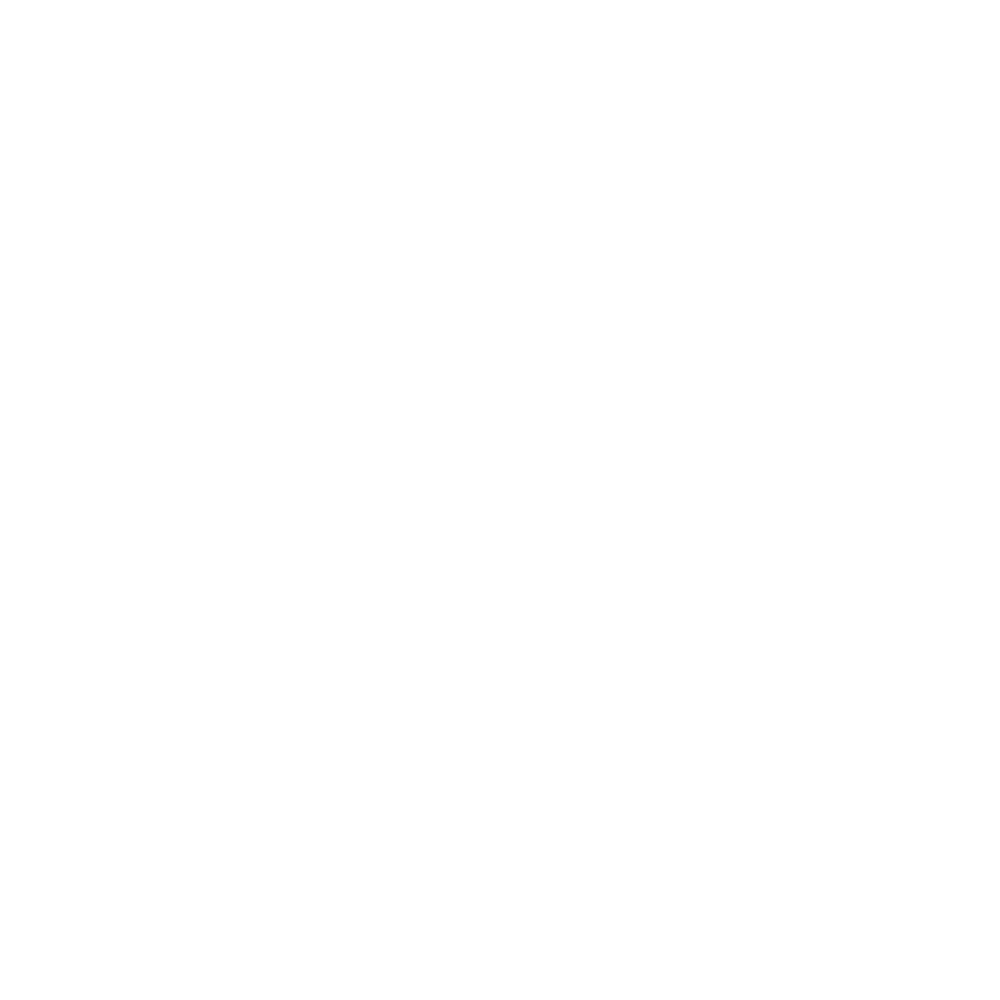

i, sweeptime =  2017-09-10 00:41:12


<IPython.core.display.Javascript object>


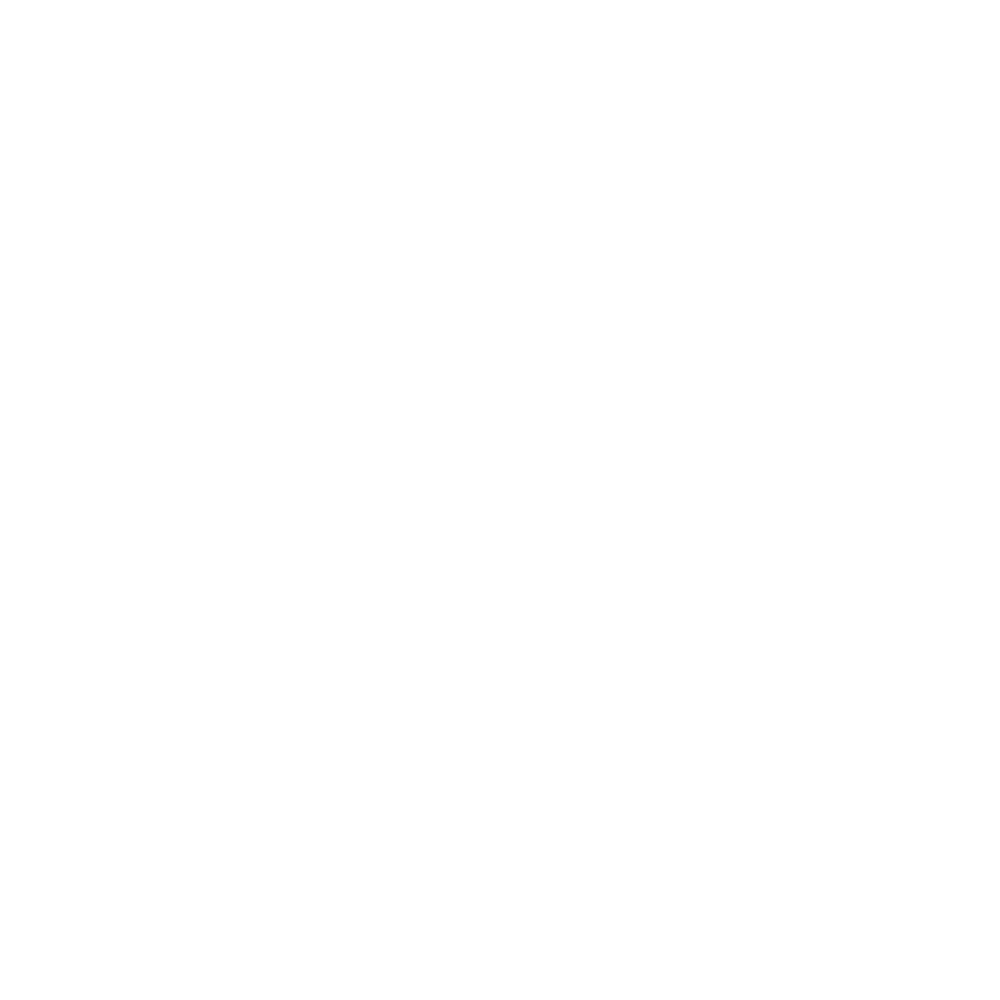

i, sweeptime =  2017-09-10 00:47:42


<IPython.core.display.Javascript object>


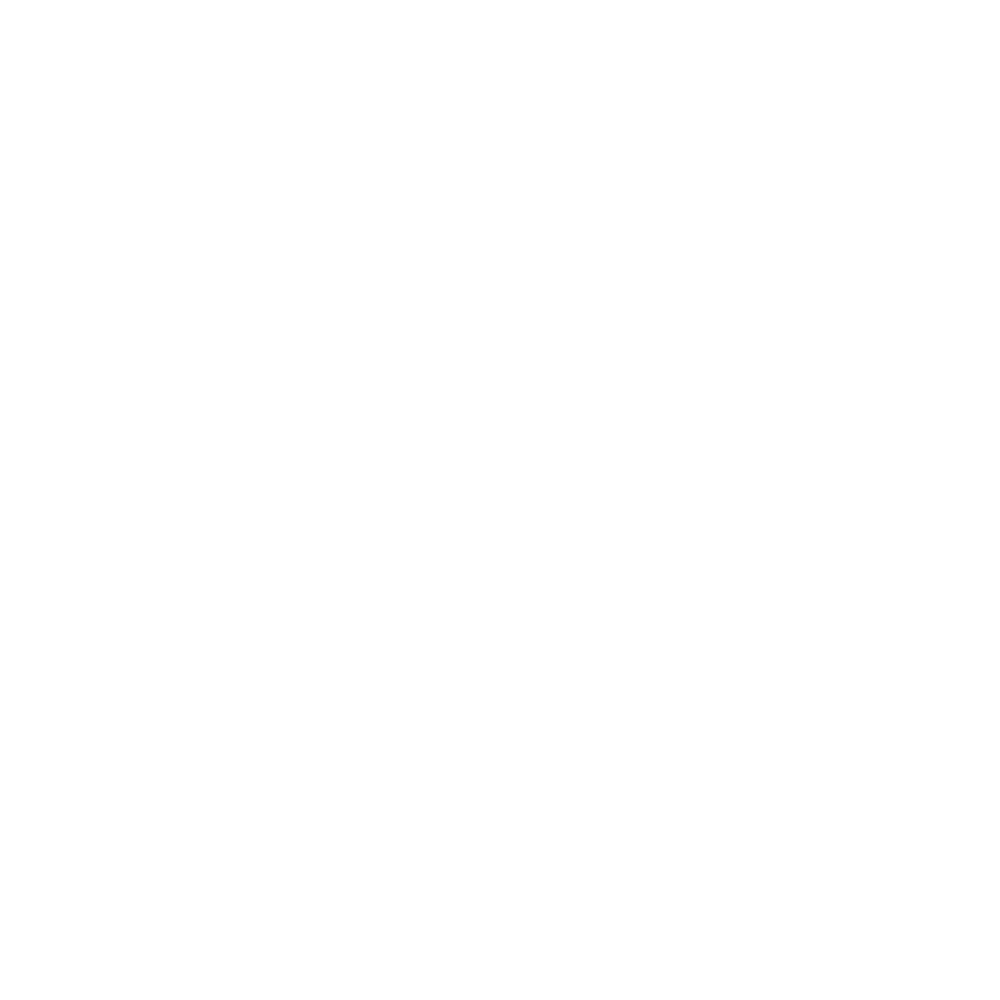

i, sweeptime =  2017-09-10 00:54:12


<IPython.core.display.Javascript object>


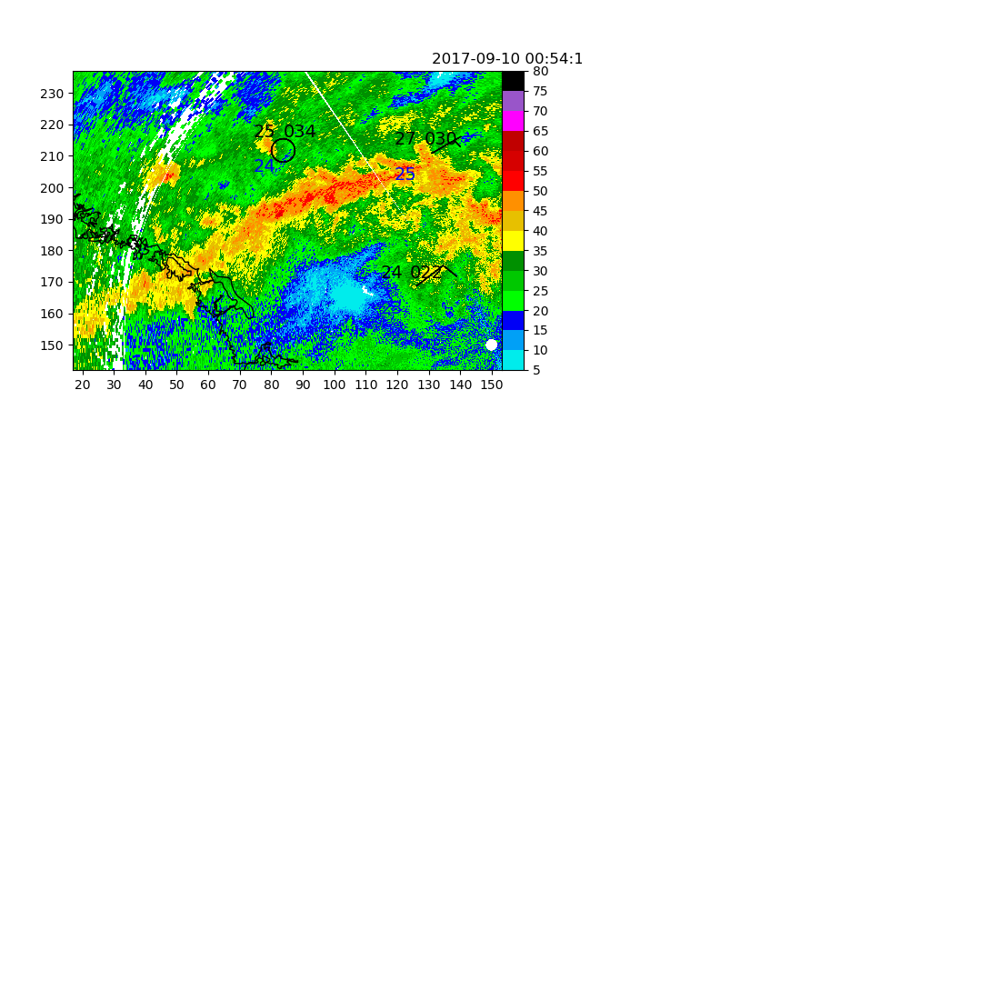

i, sweeptime =  2017-09-10 01:00:44


<IPython.core.display.Javascript object>


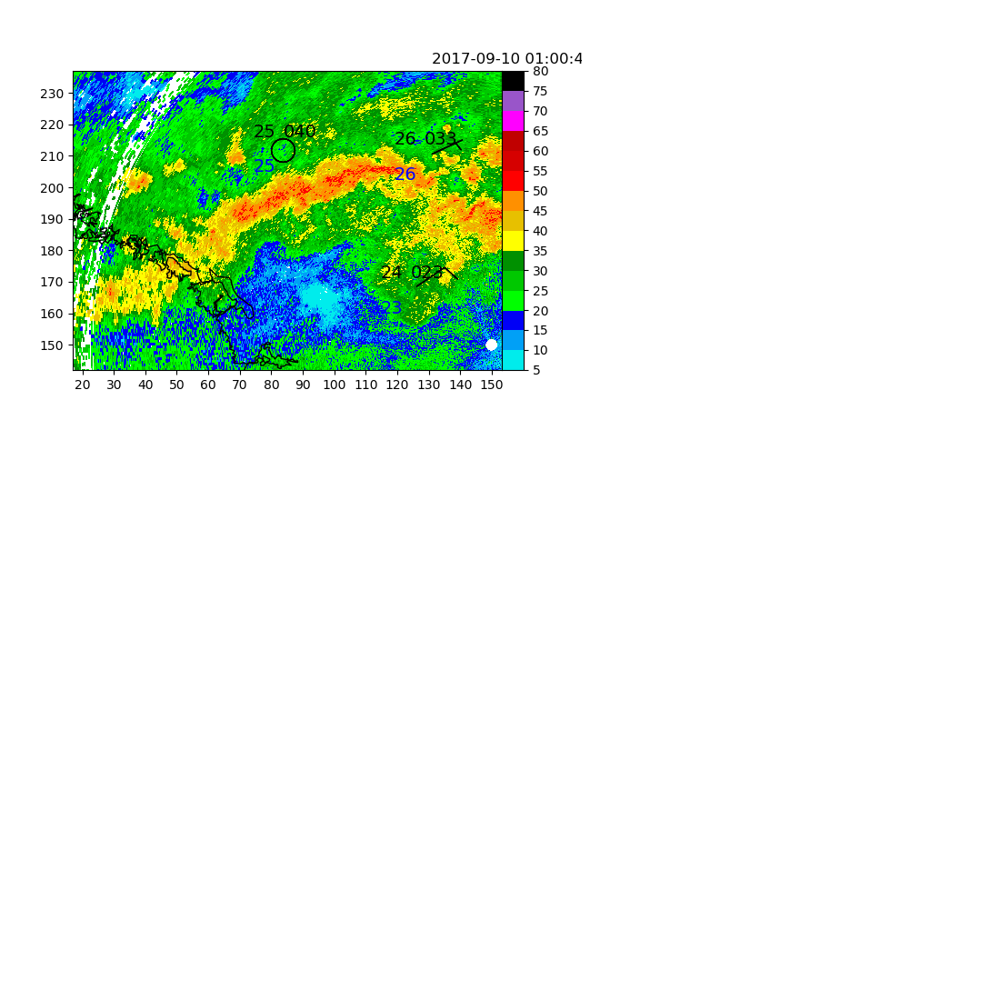

i, sweeptime =  2017-09-10 01:07:24


<IPython.core.display.Javascript object>


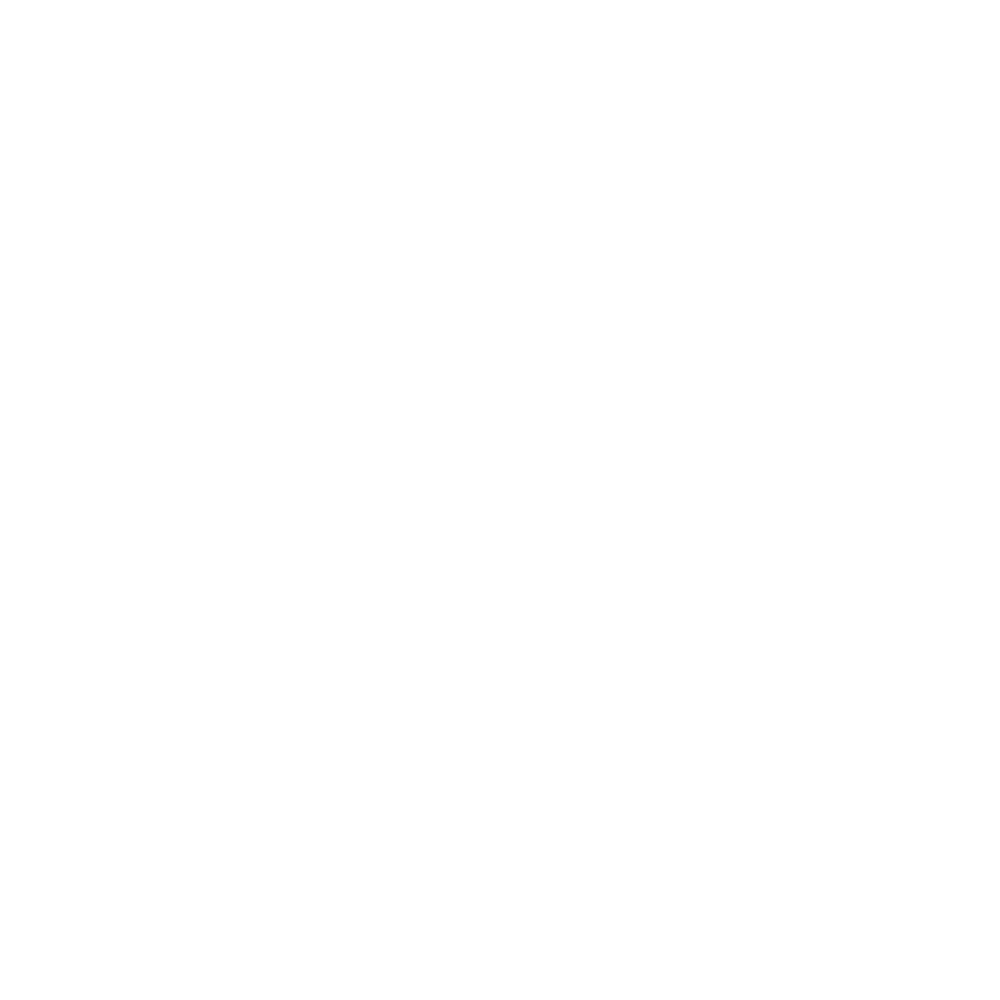

i, sweeptime =  2017-09-10 01:14:02


<IPython.core.display.Javascript object>


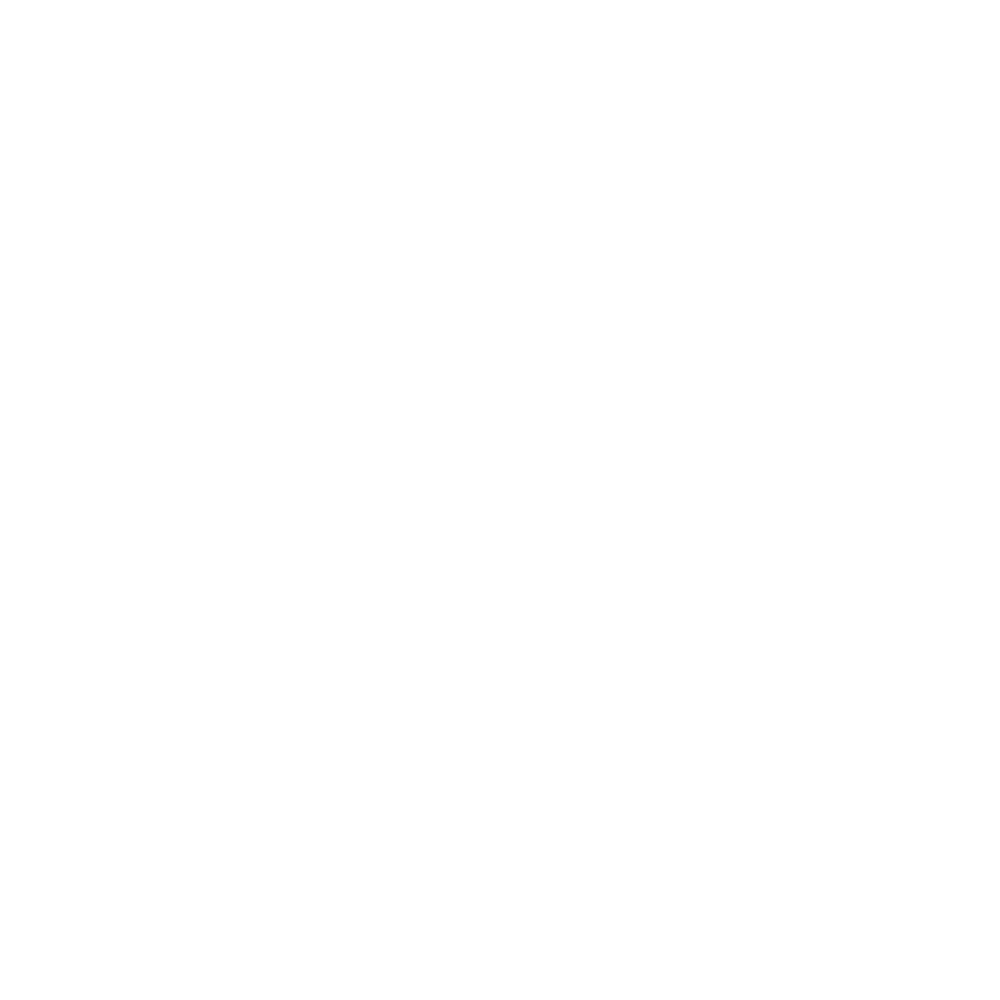

i, sweeptime =  2017-09-10 01:20:33


<IPython.core.display.Javascript object>


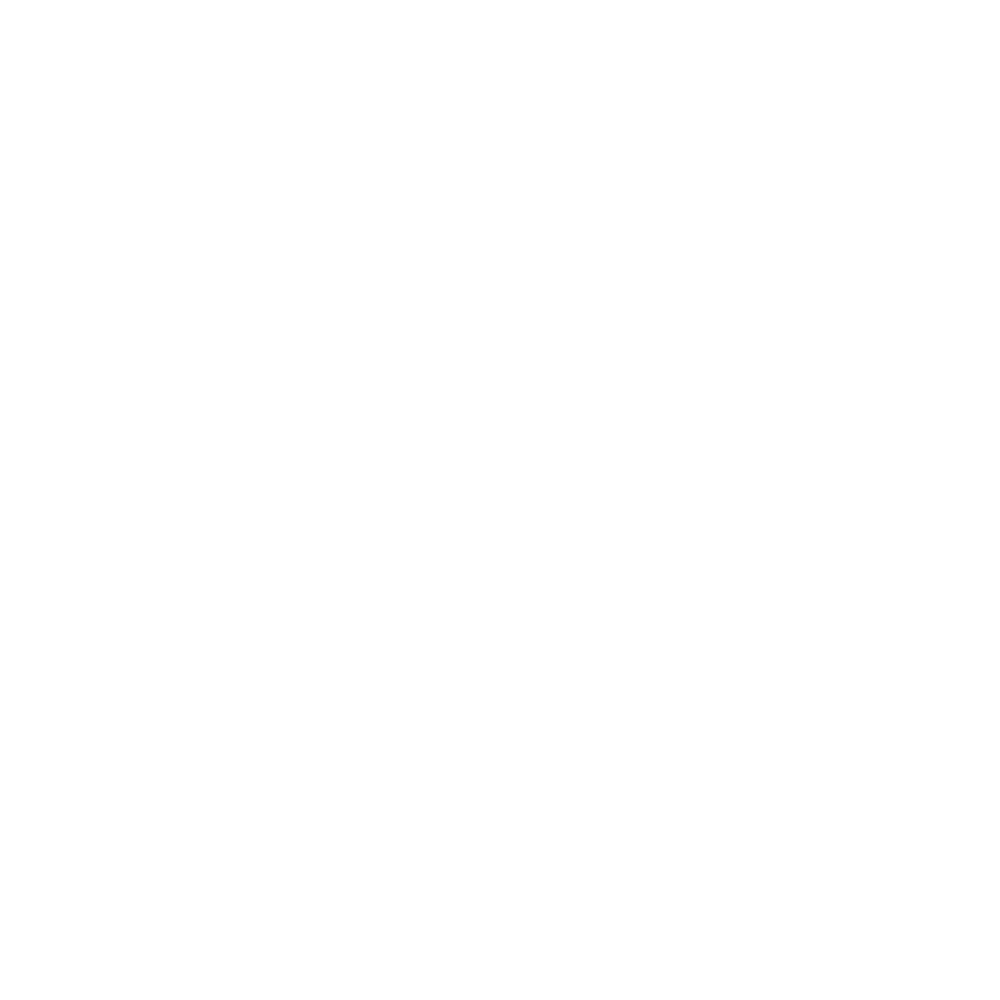

i, sweeptime =  2017-09-10 01:27:14


<IPython.core.display.Javascript object>


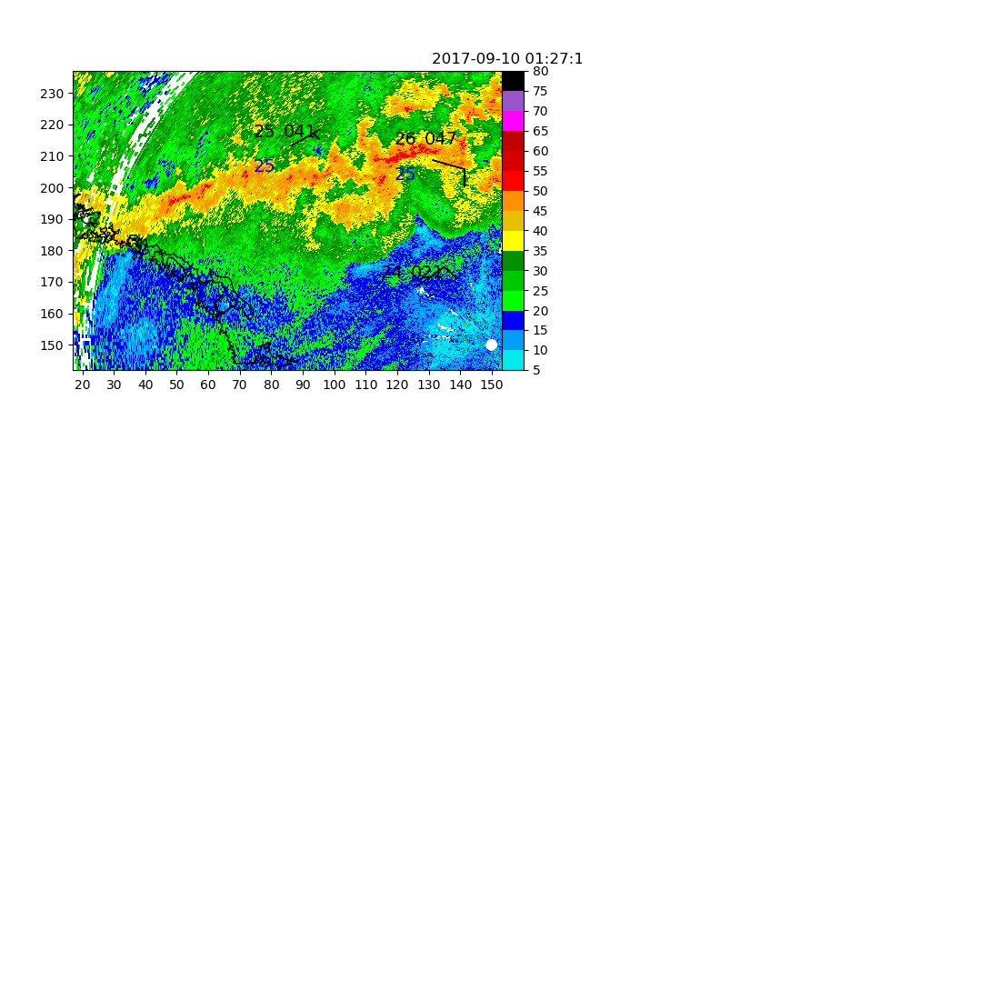

i, sweeptime =  2017-09-10 01:33:53


<IPython.core.display.Javascript object>


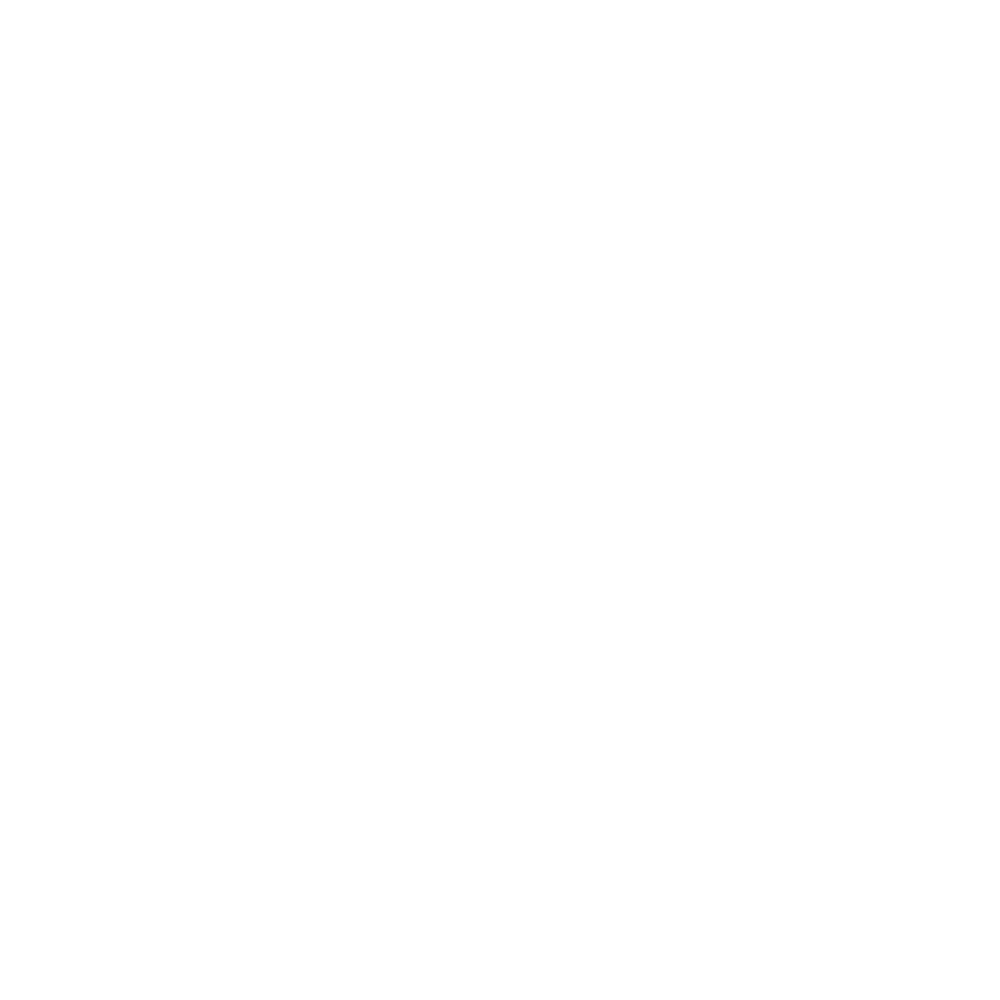

i, sweeptime =  2017-09-10 01:40:34


<IPython.core.display.Javascript object>


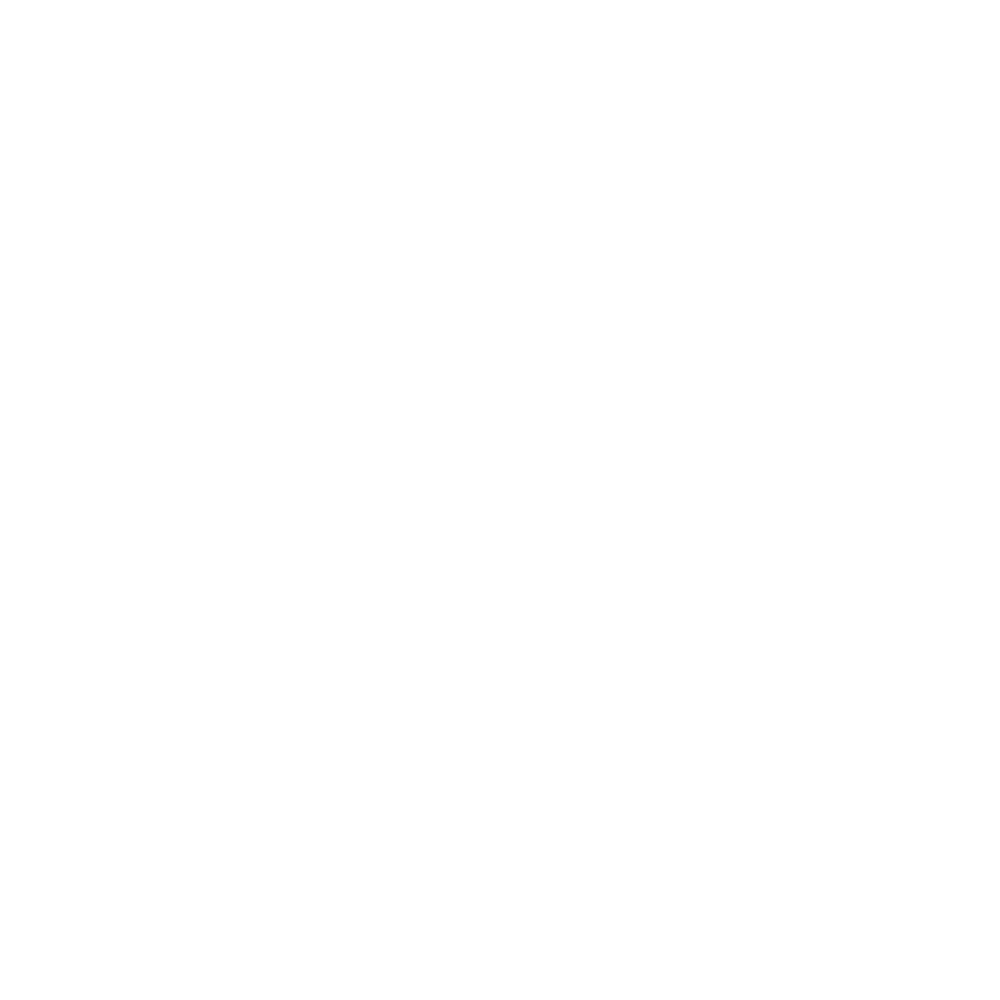

i, sweeptime =  2017-09-10 01:47:17


<IPython.core.display.Javascript object>


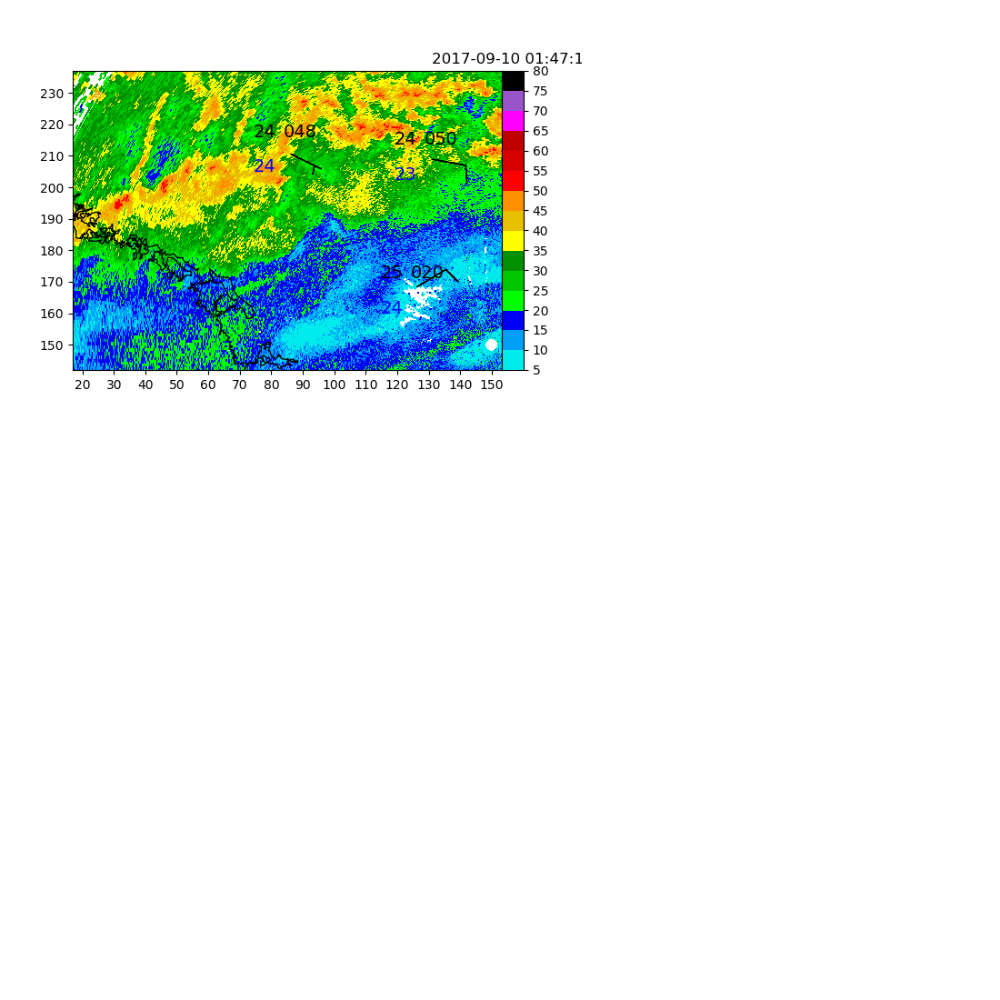

i, sweeptime =  2017-09-10 01:54:16


<IPython.core.display.Javascript object>


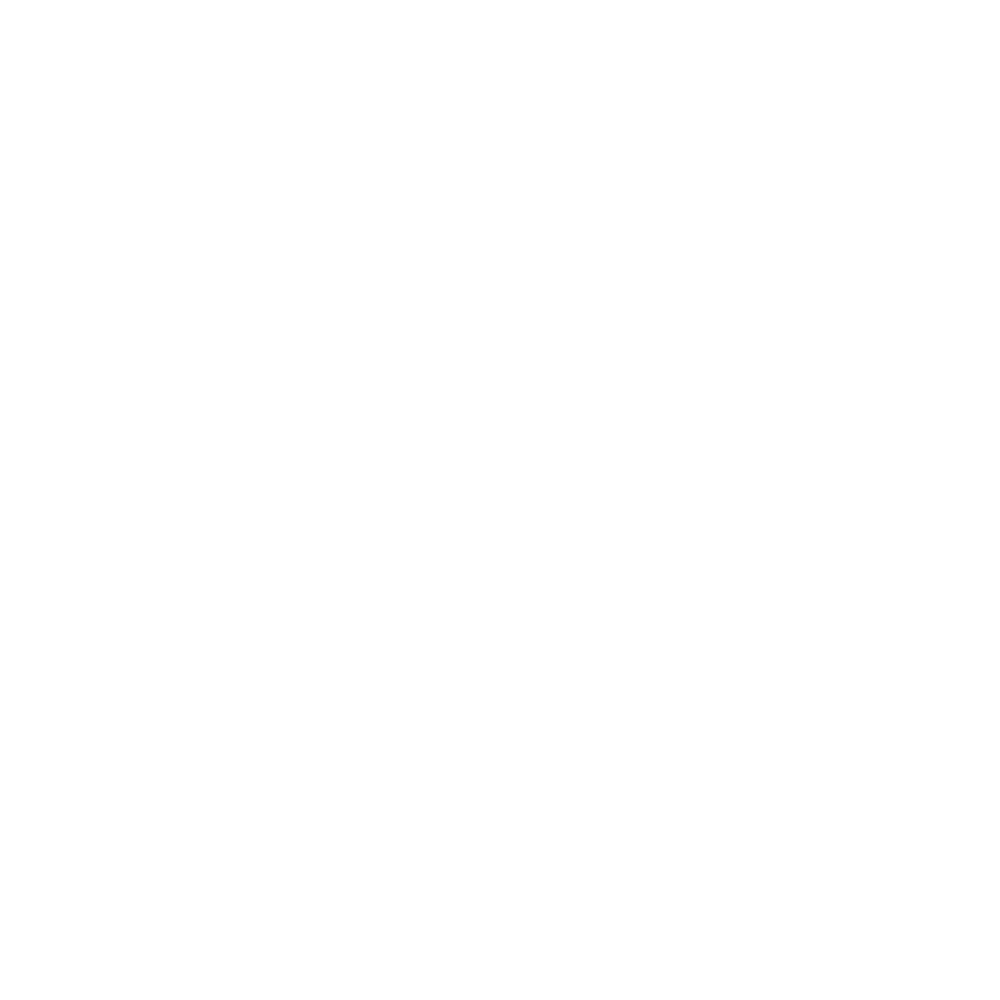

i, sweeptime =  2017-09-10 02:01:05


<IPython.core.display.Javascript object>


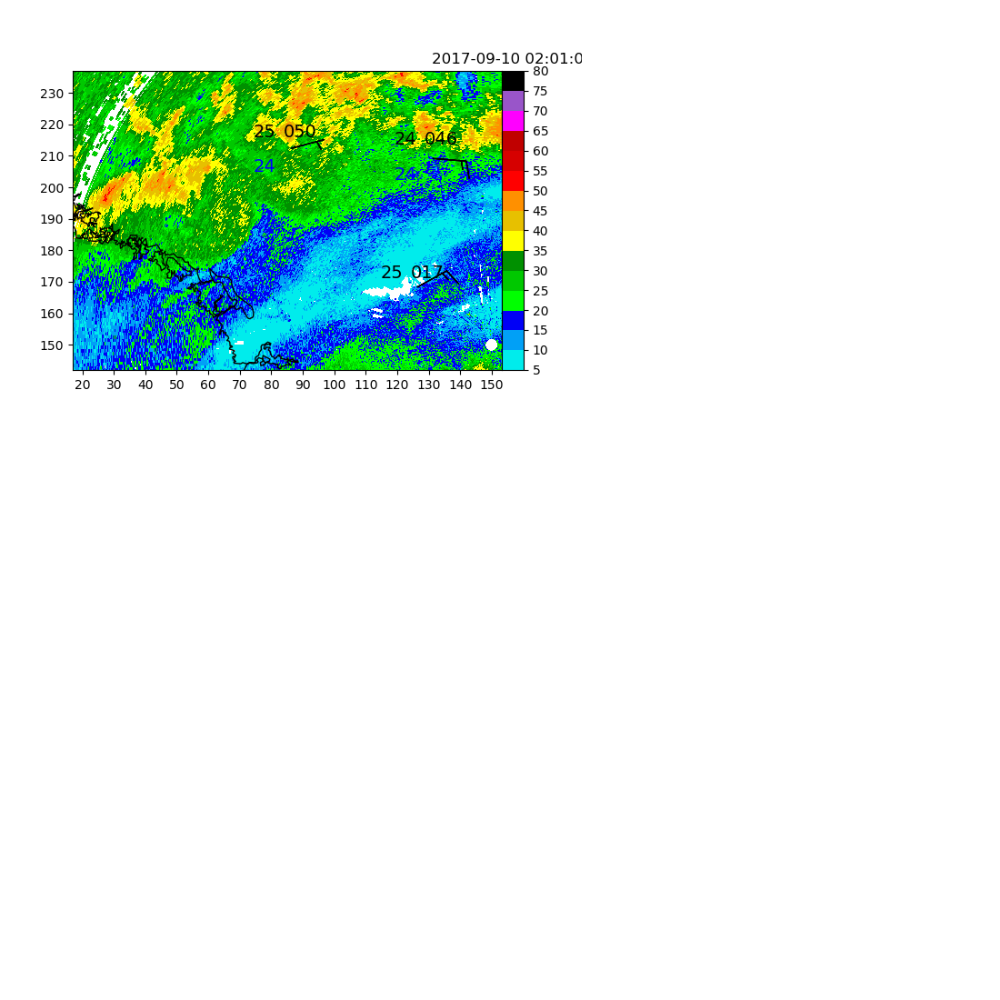

i, sweeptime =  2017-09-10 02:07:52


<IPython.core.display.Javascript object>


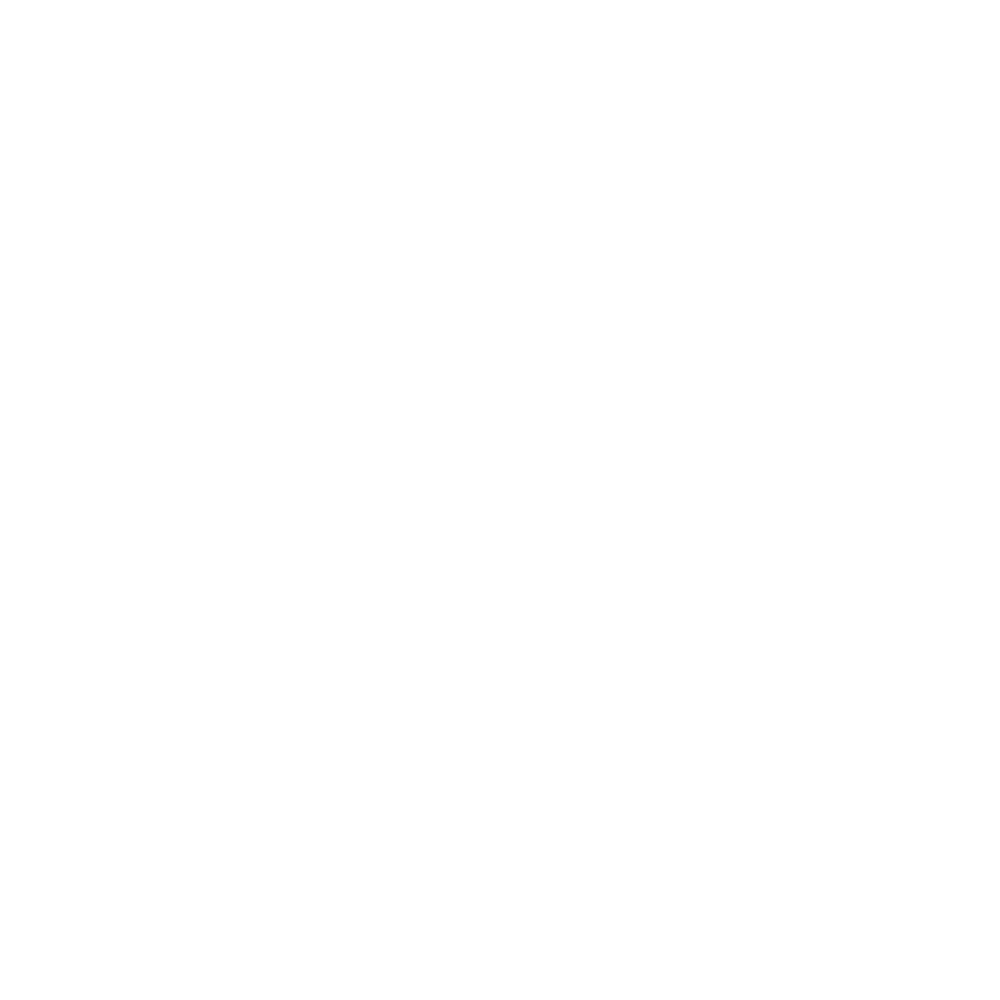

i, sweeptime =  2017-09-10 02:14:21


<IPython.core.display.Javascript object>


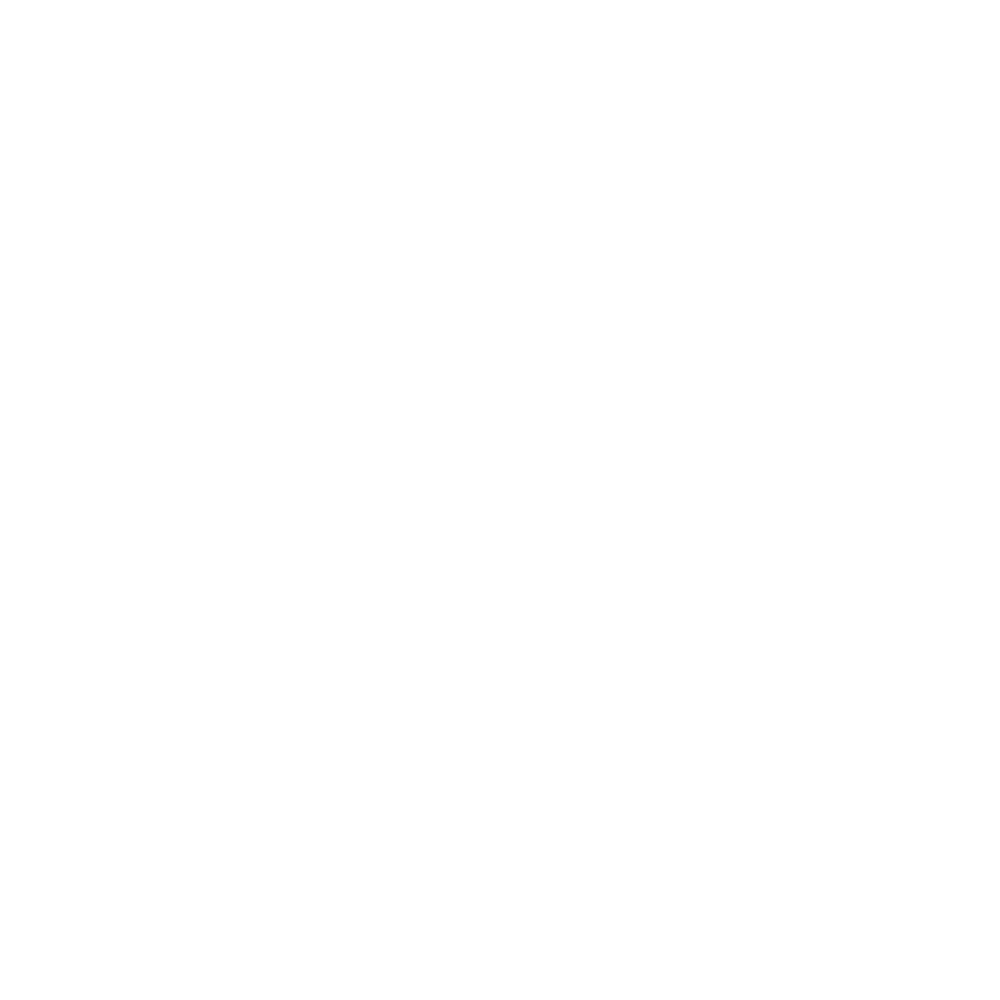

i, sweeptime =  2017-09-10 02:20:51


<IPython.core.display.Javascript object>


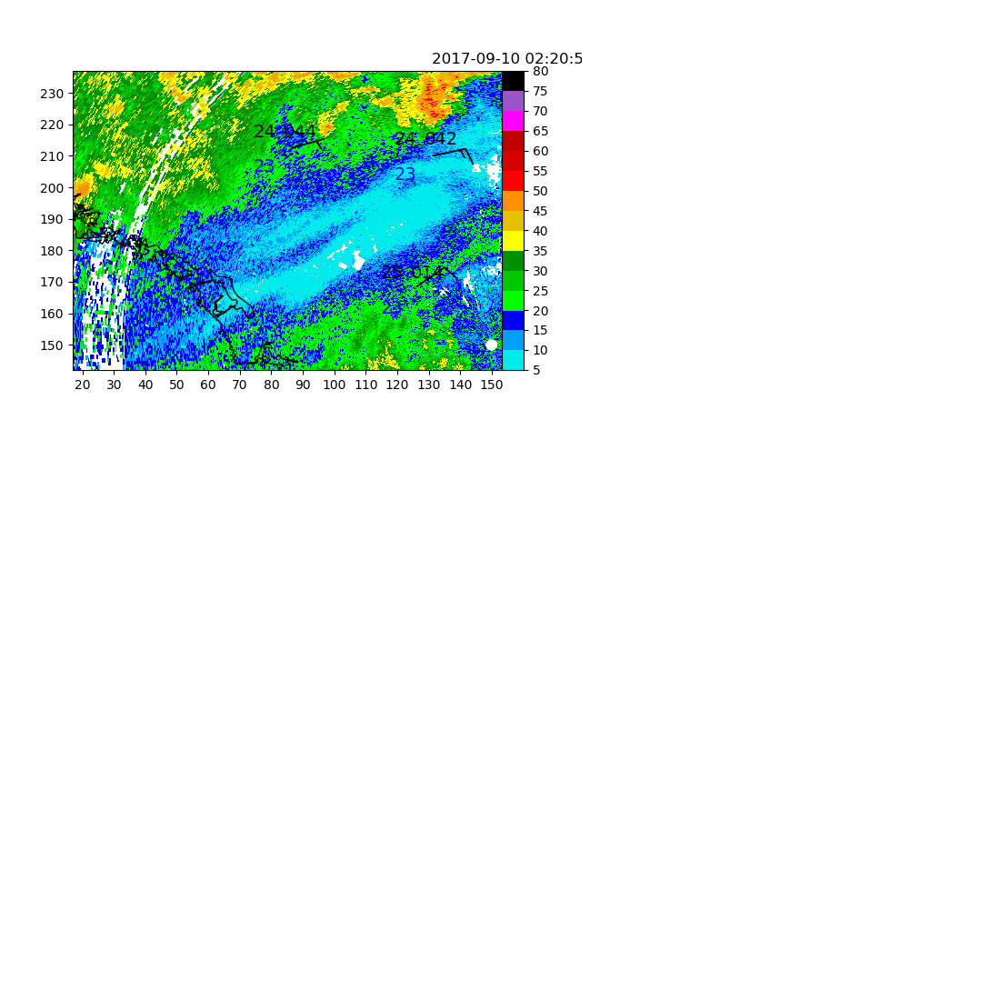

i, sweeptime =  2017-09-10 02:27:23


<IPython.core.display.Javascript object>


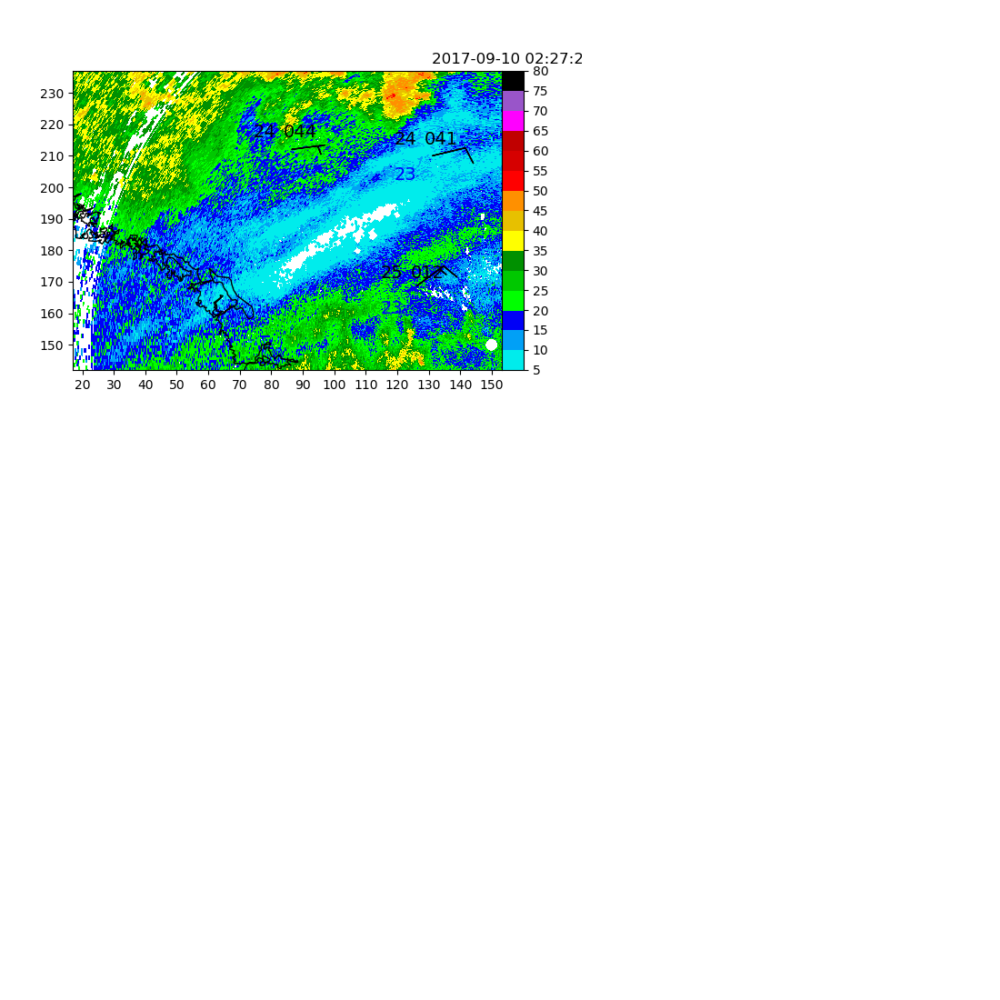

i, sweeptime =  2017-09-10 02:34:00


<IPython.core.display.Javascript object>


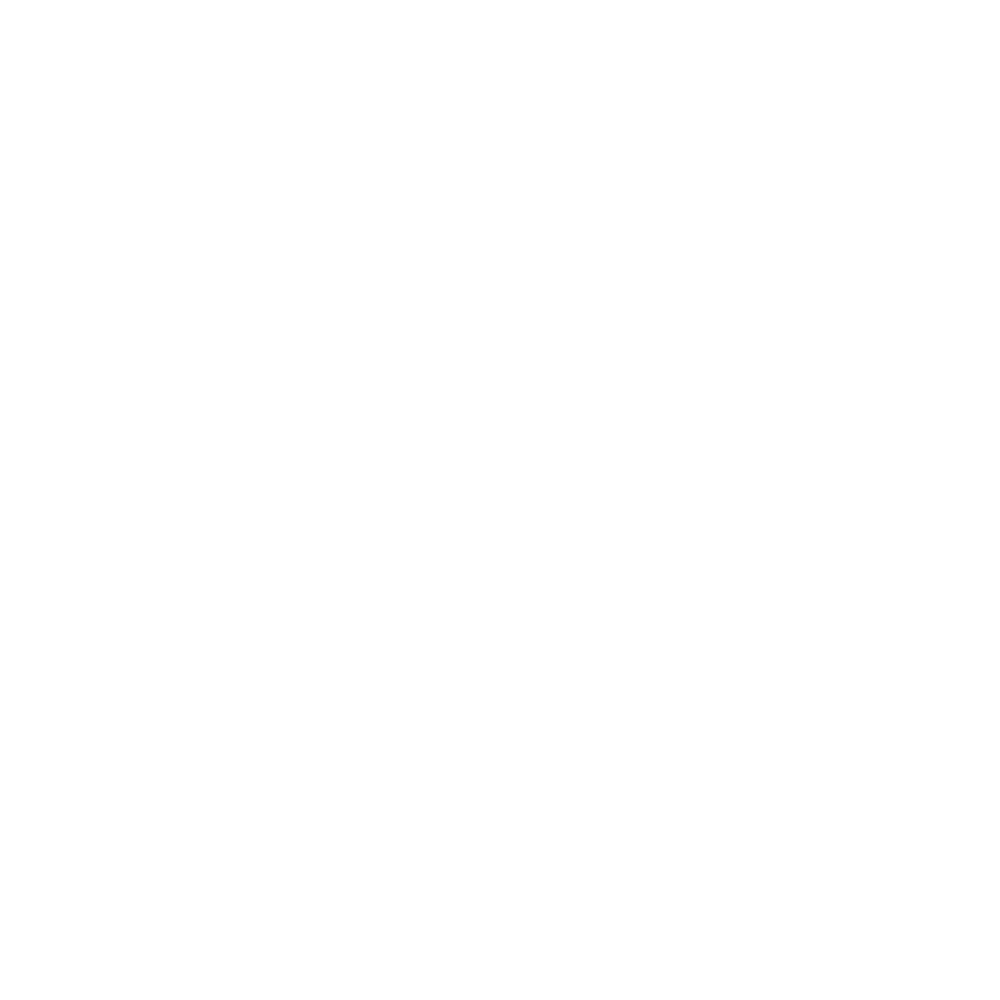

i, sweeptime =  2017-09-10 02:40:30


<IPython.core.display.Javascript object>


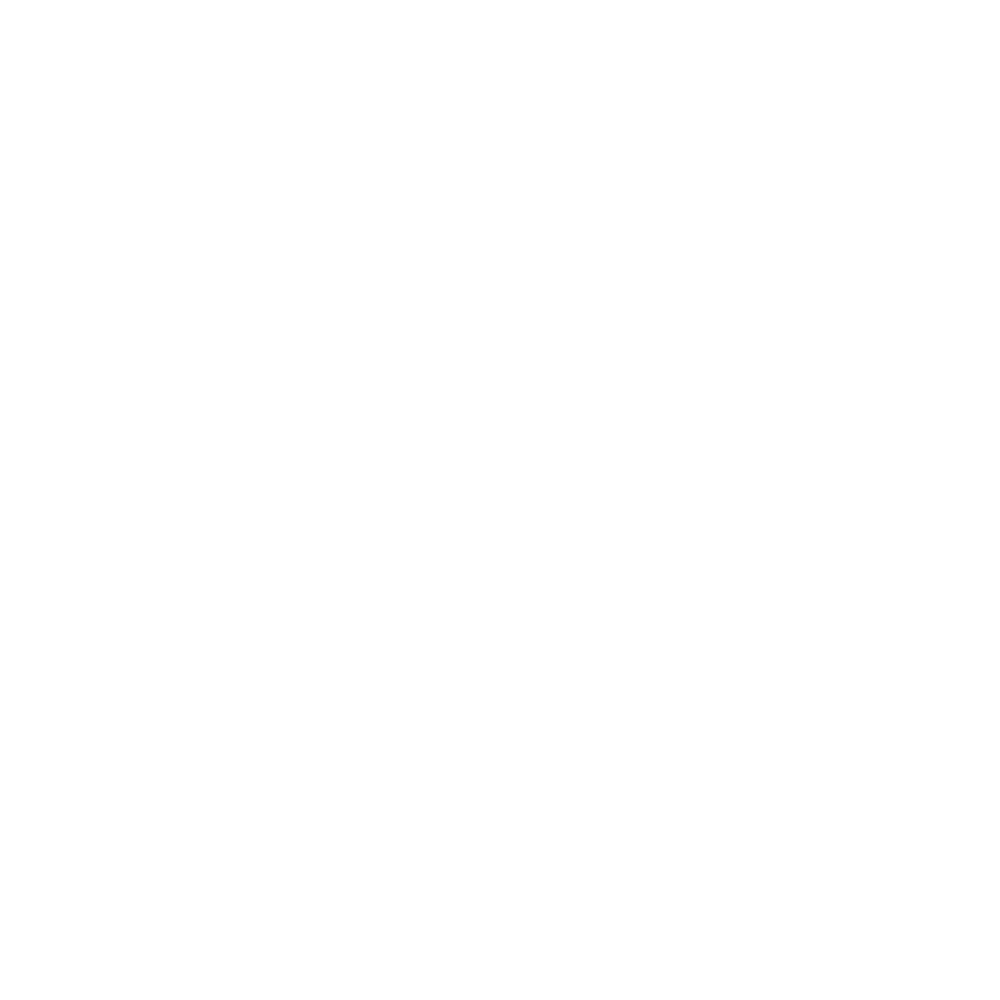

i, sweeptime =  2017-09-10 02:47:00


<IPython.core.display.Javascript object>


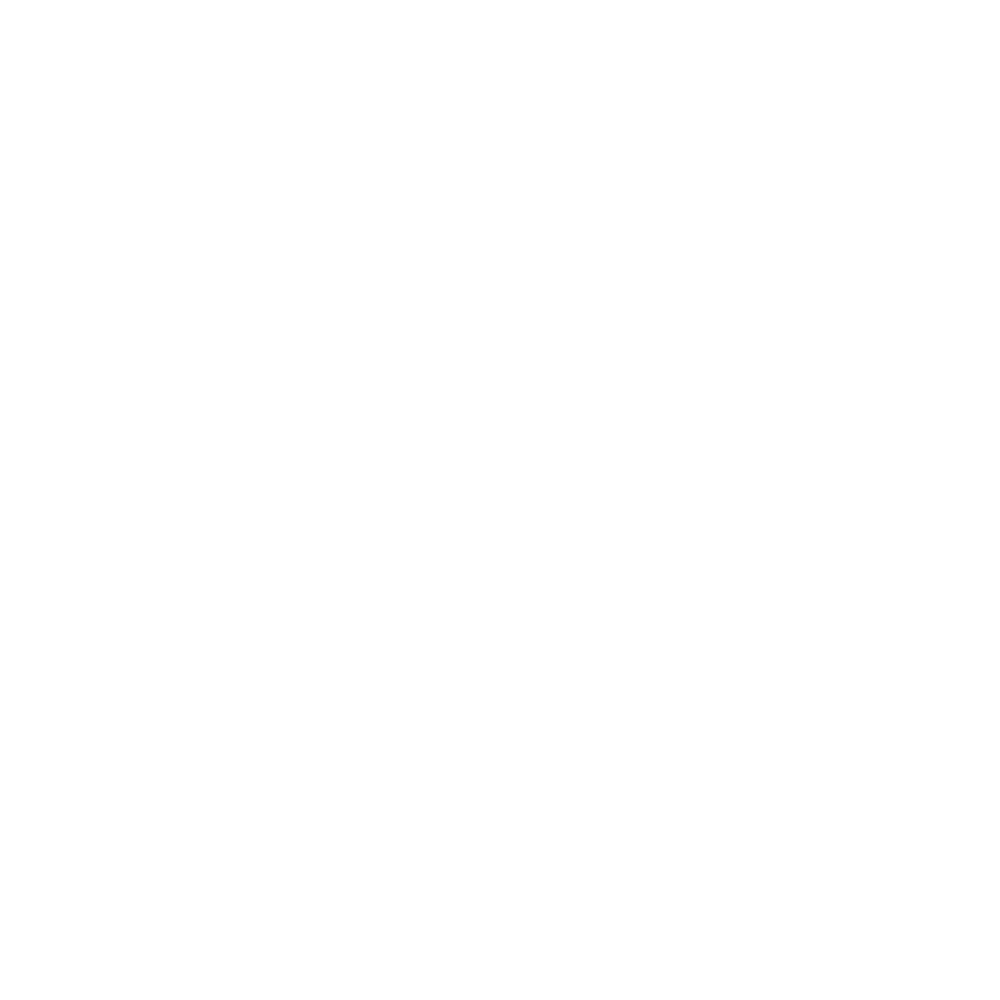

i, sweeptime =  2017-09-10 02:53:30


<IPython.core.display.Javascript object>


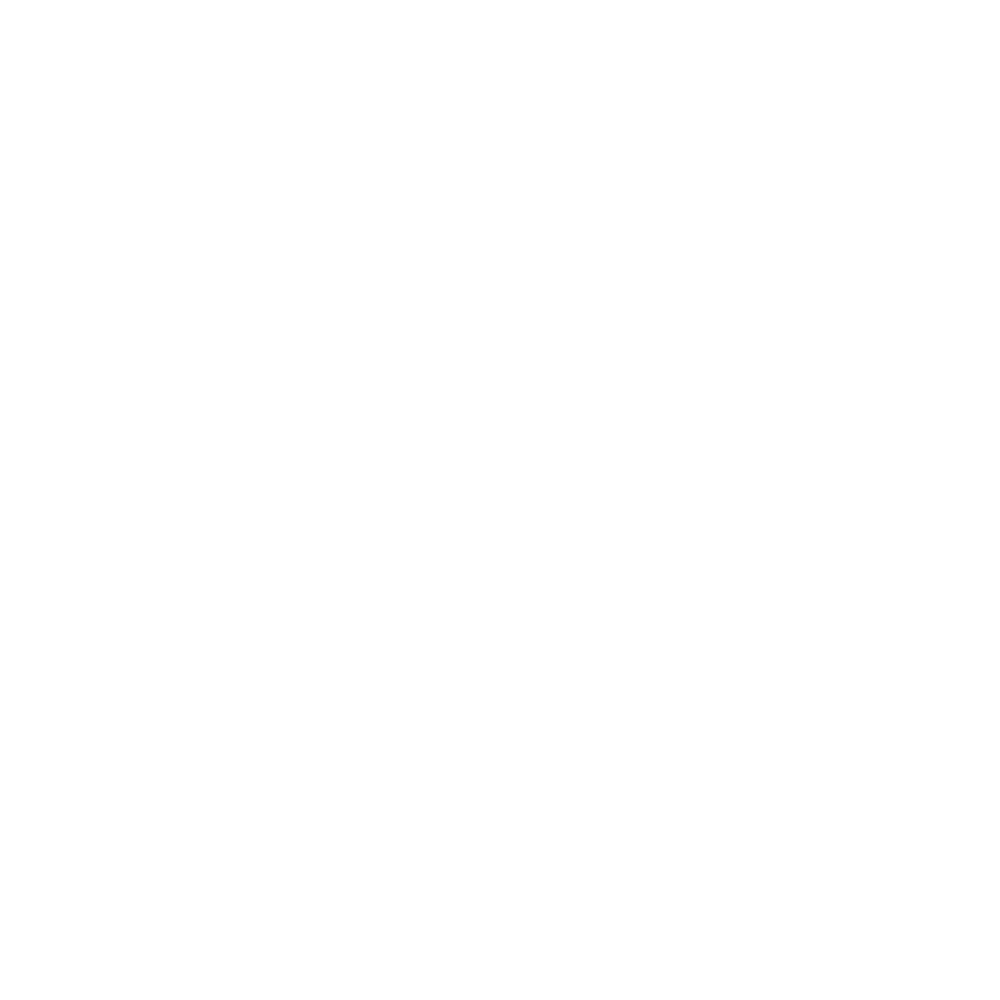

i, sweeptime =  2017-09-10 03:00:02


<IPython.core.display.Javascript object>


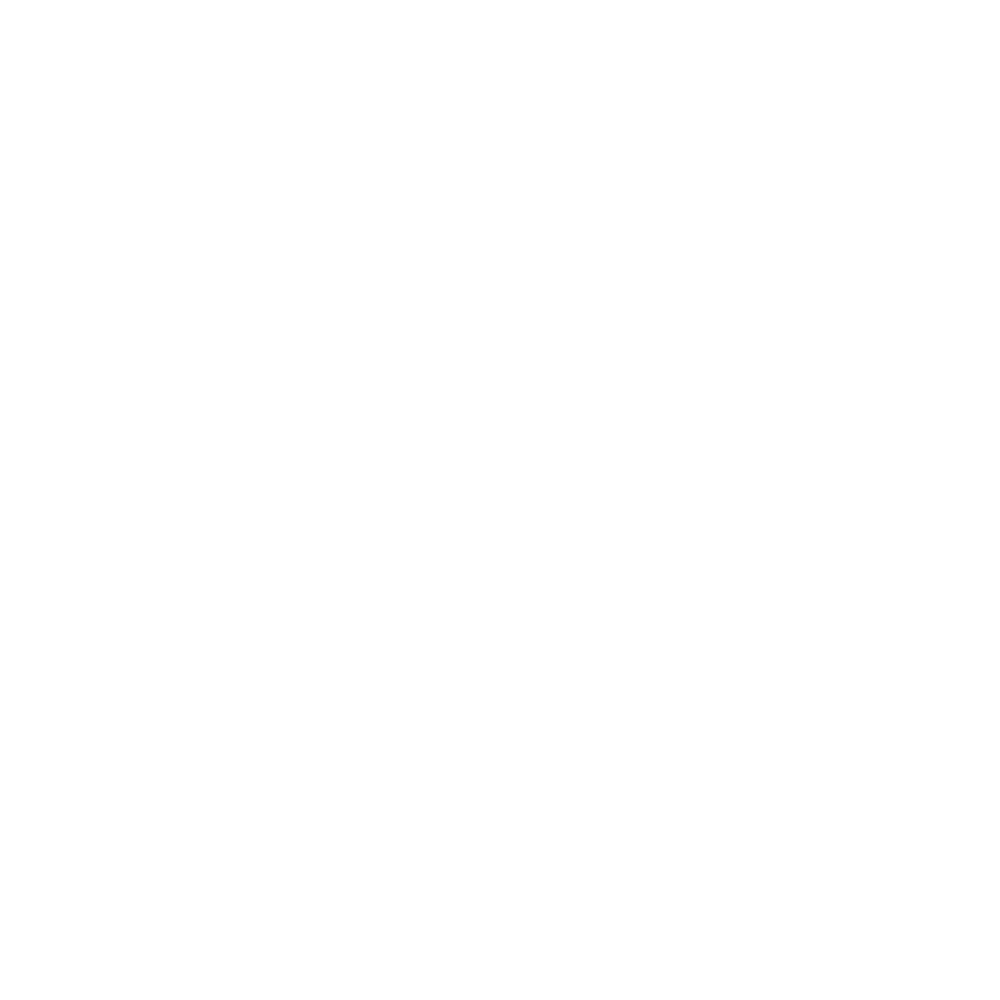

i, sweeptime =  2017-09-10 03:06:32


<IPython.core.display.Javascript object>


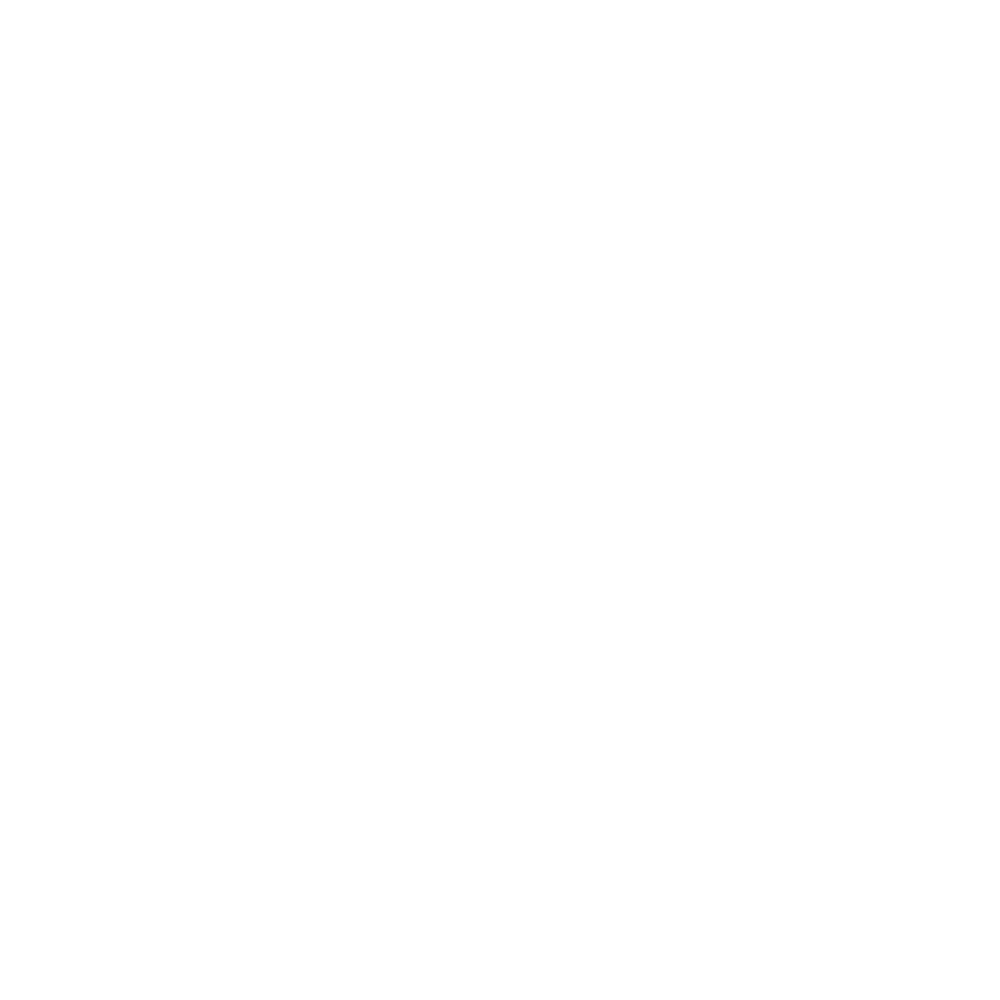

i, sweeptime =  2017-09-10 03:13:01


<IPython.core.display.Javascript object>


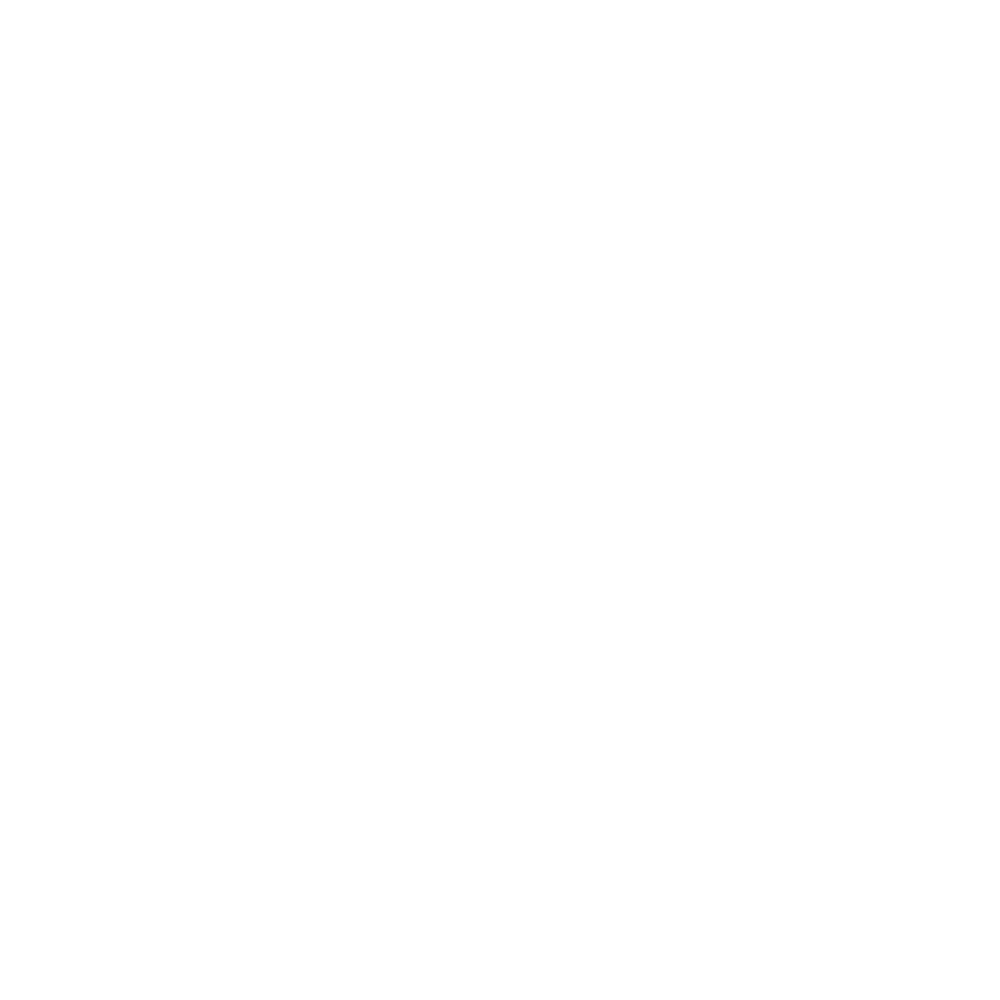

i, sweeptime =  2017-09-10 03:19:30


<IPython.core.display.Javascript object>


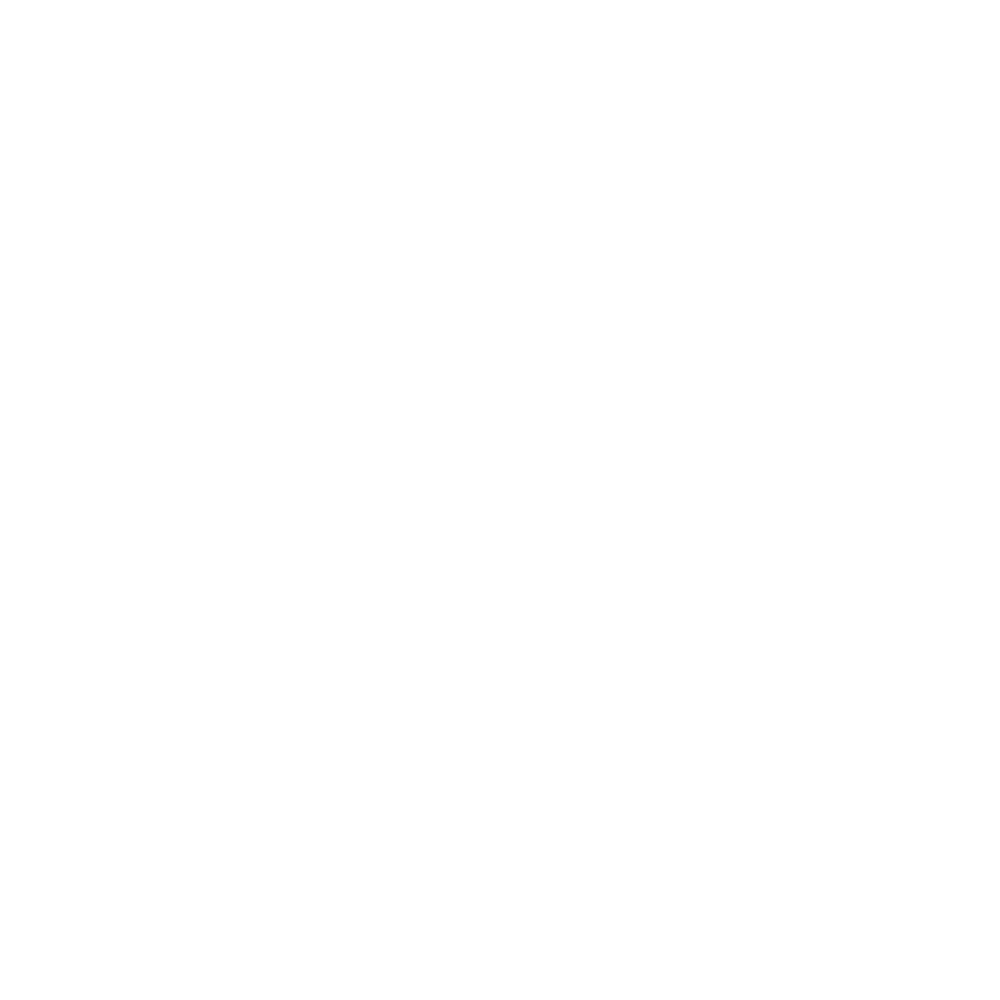

i, sweeptime =  2017-09-10 03:26:01


<IPython.core.display.Javascript object>


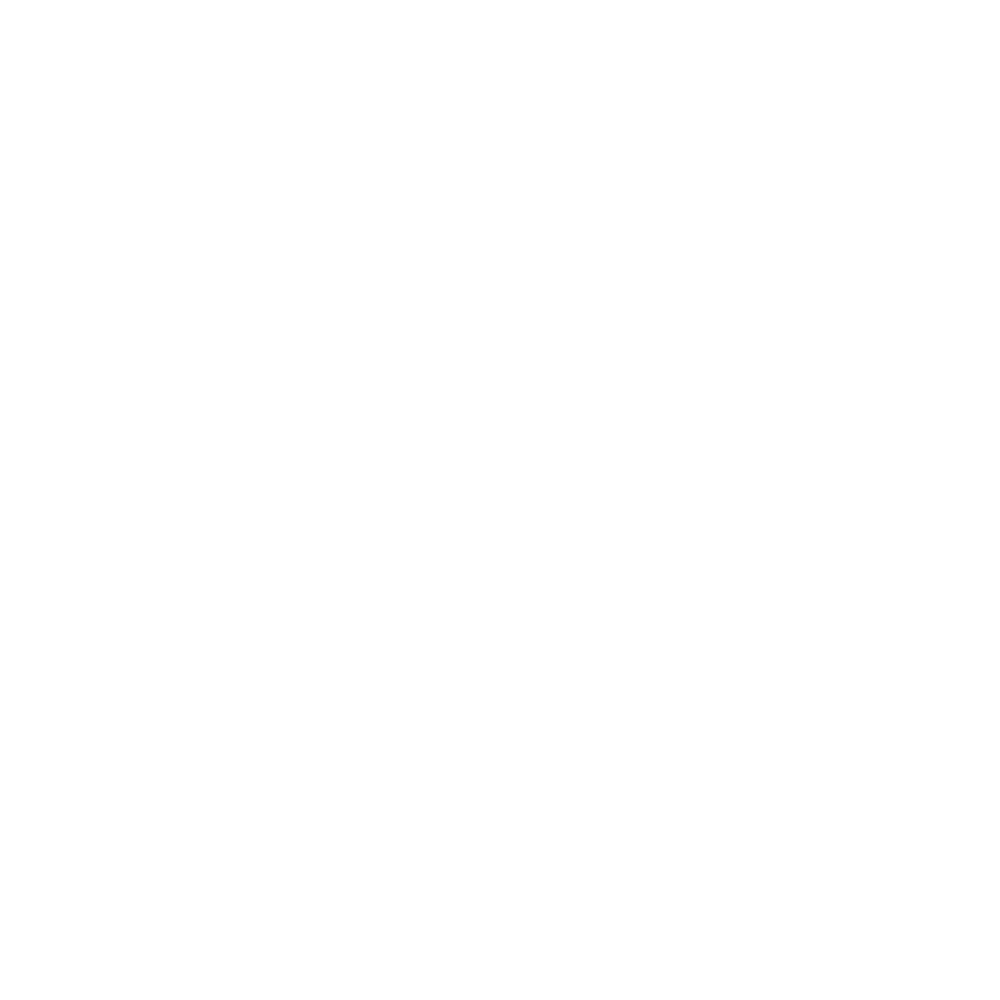

i, sweeptime =  2017-09-10 03:32:32


<IPython.core.display.Javascript object>


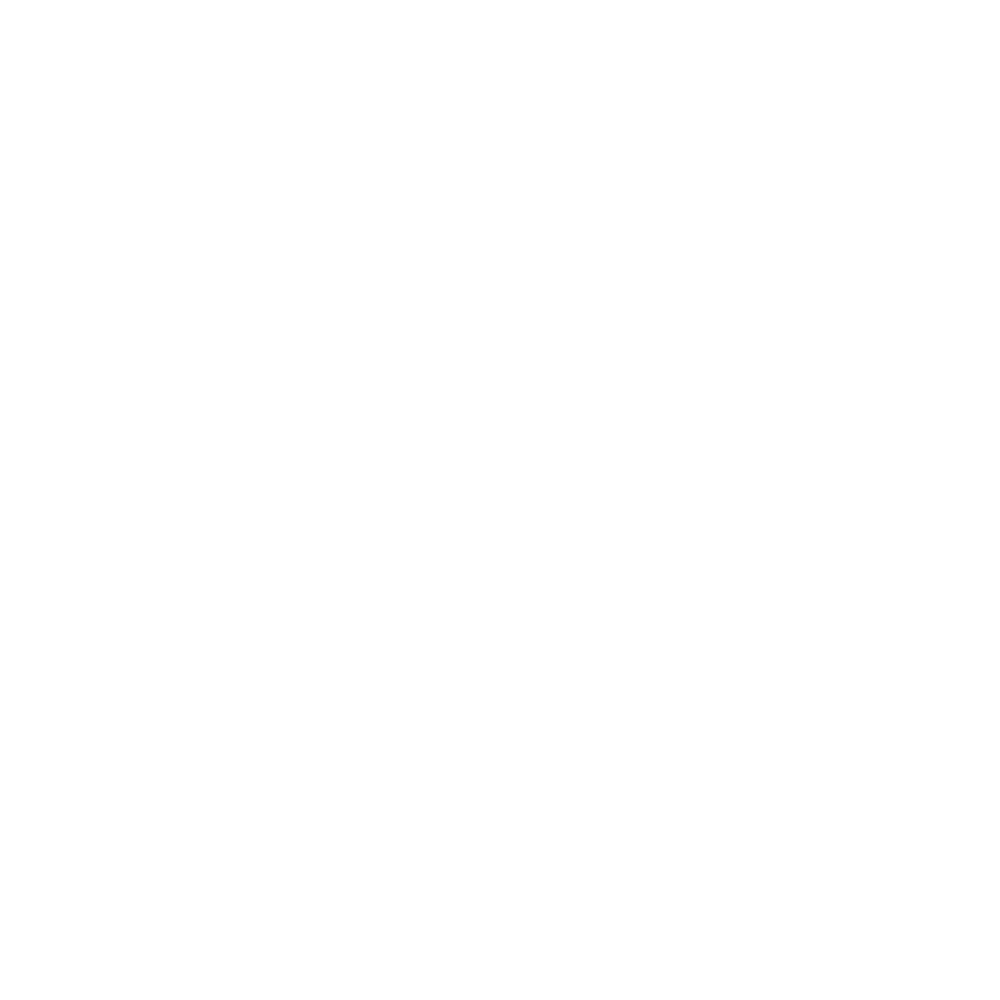

i, sweeptime =  2017-09-10 03:39:02


<IPython.core.display.Javascript object>


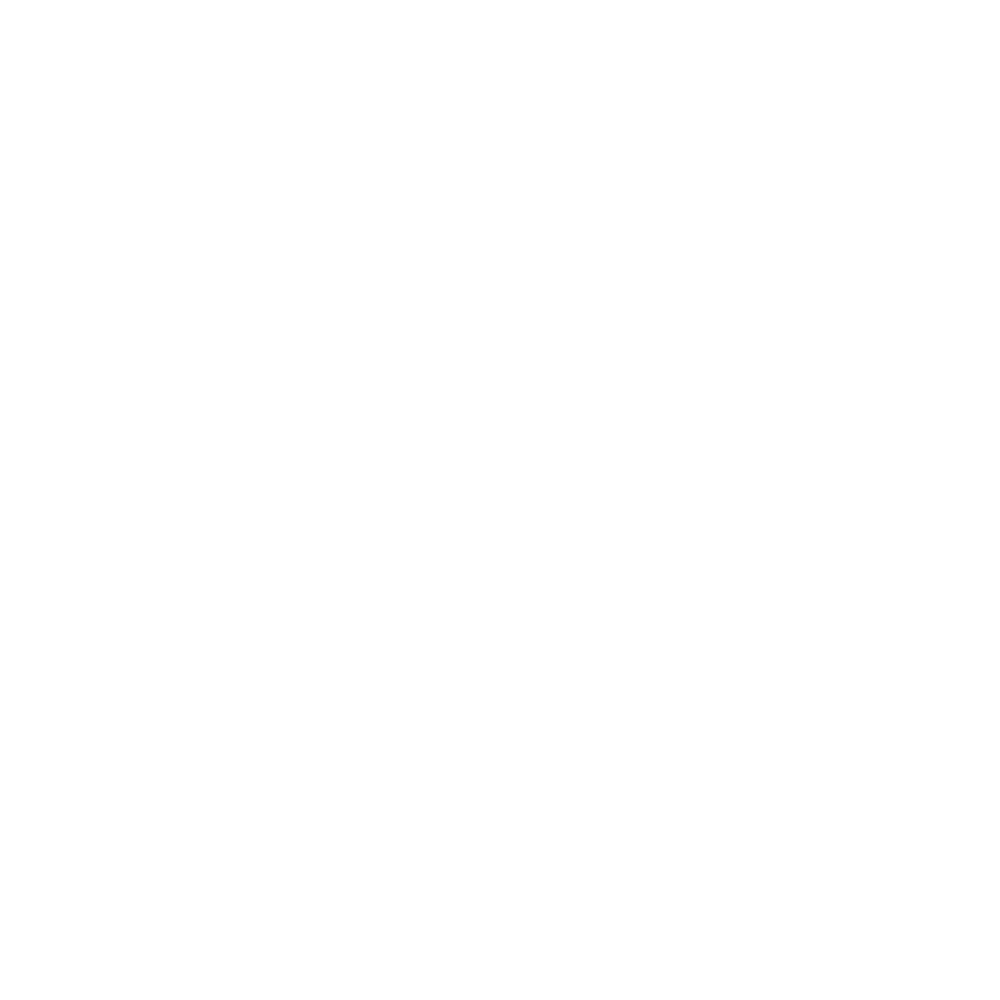

i, sweeptime =  2017-09-10 03:45:33


<IPython.core.display.Javascript object>


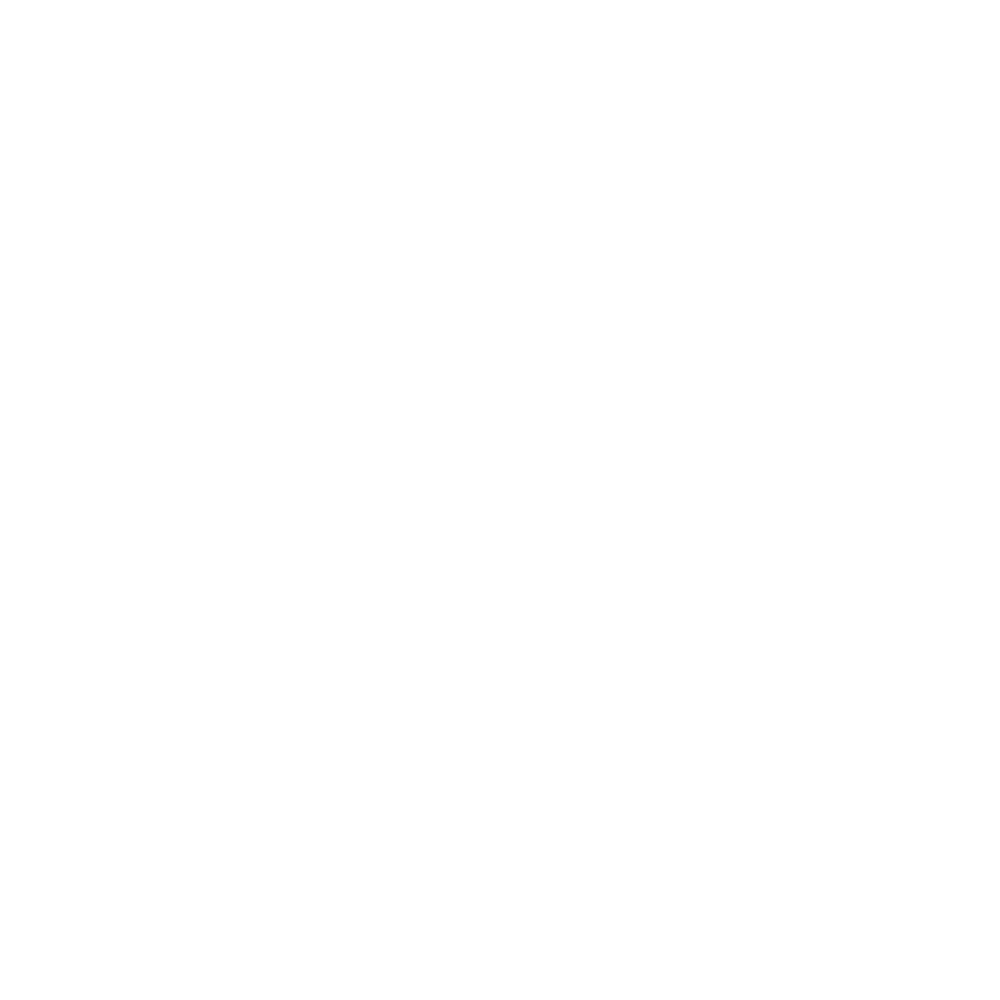

i, sweeptime =  2017-09-10 03:52:04


<IPython.core.display.Javascript object>


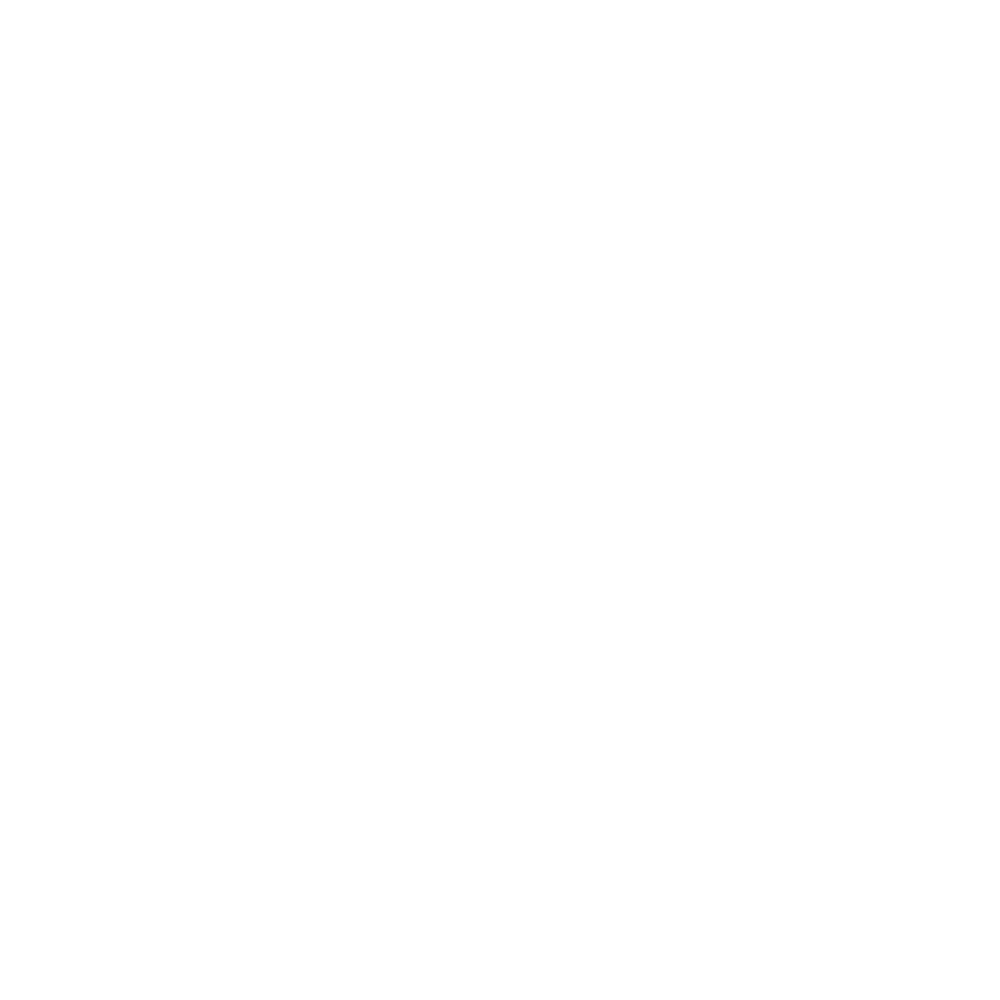

i, sweeptime =  2017-09-10 03:58:34


<IPython.core.display.Javascript object>


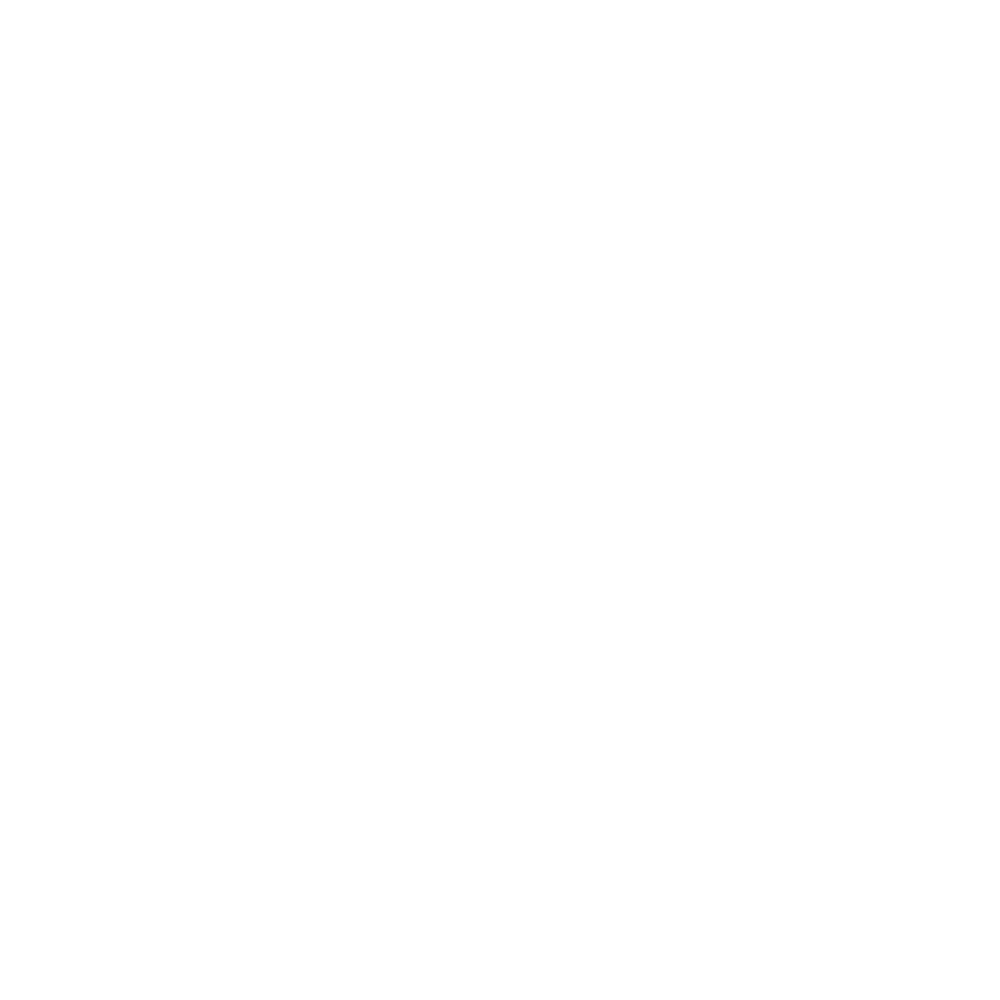

i, sweeptime =  2017-09-10 04:05:05


<IPython.core.display.Javascript object>


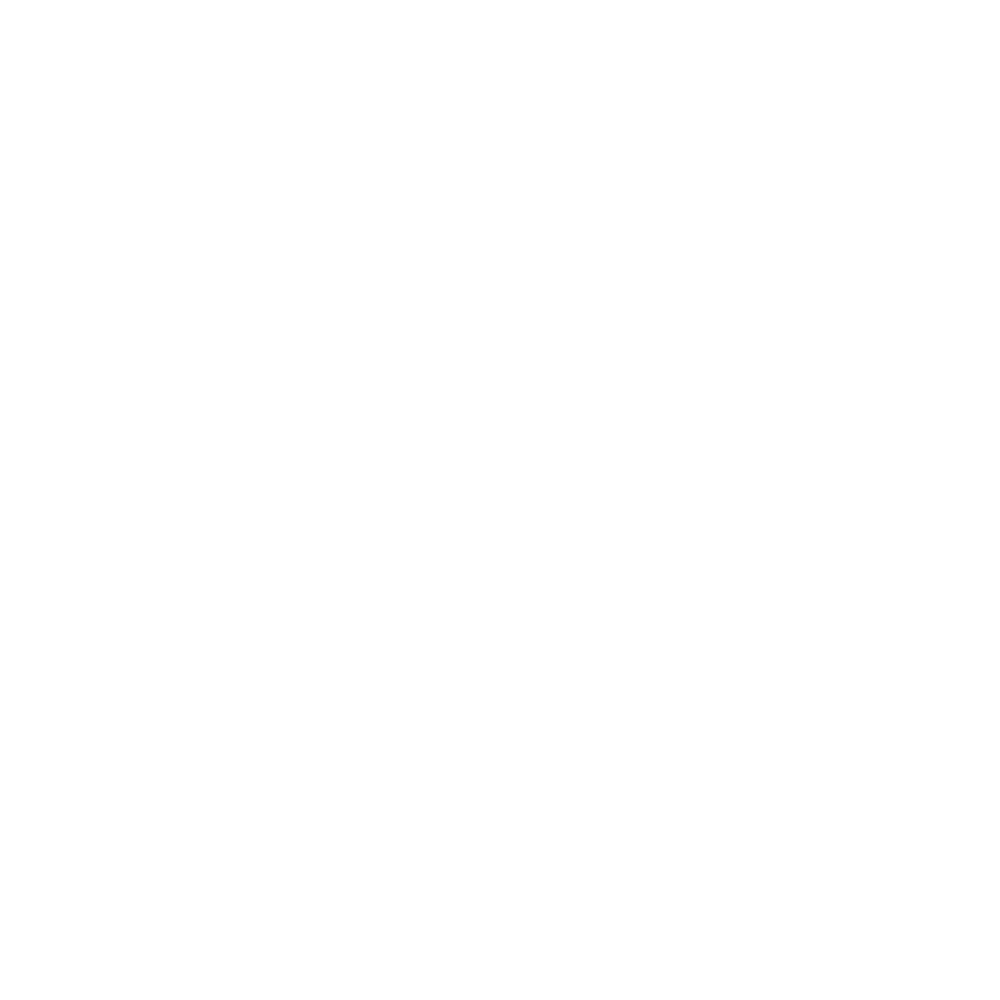

i, sweeptime =  2017-09-10 04:13:33


<IPython.core.display.Javascript object>


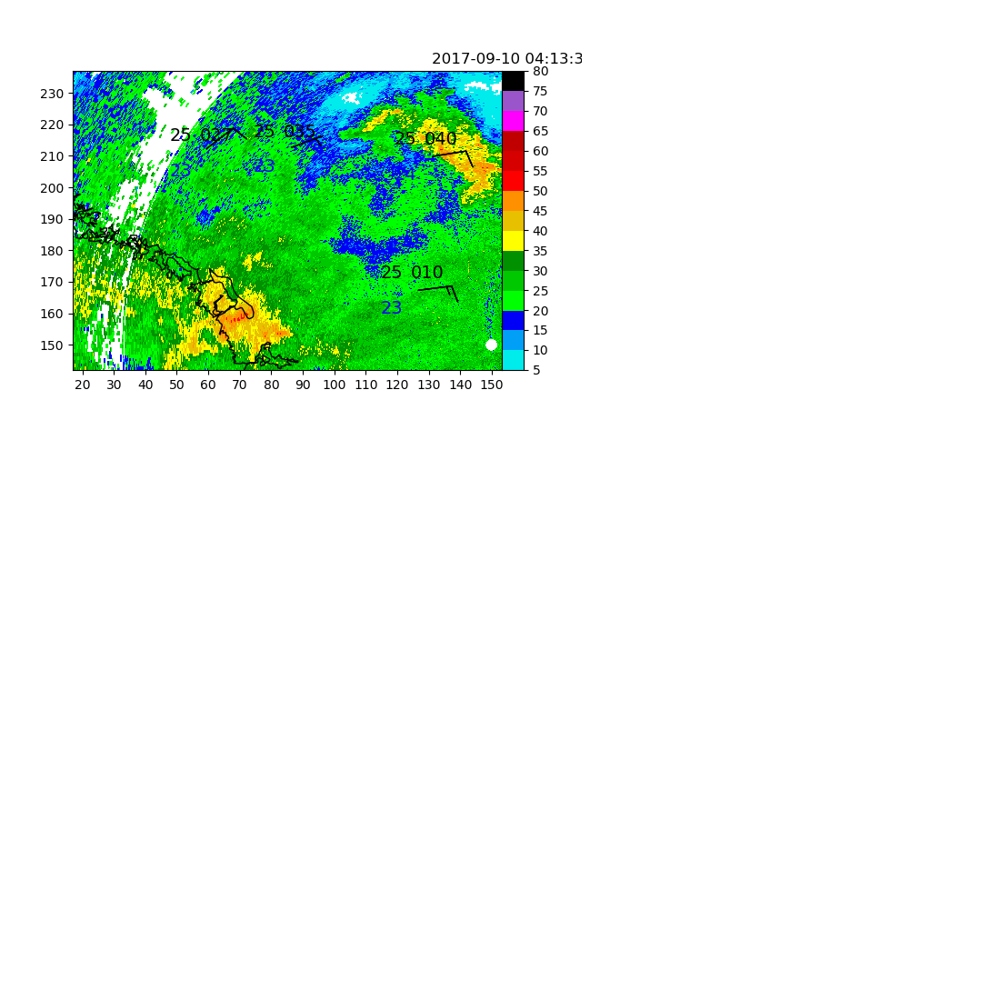

i, sweeptime =  2017-09-10 04:20:04


<IPython.core.display.Javascript object>


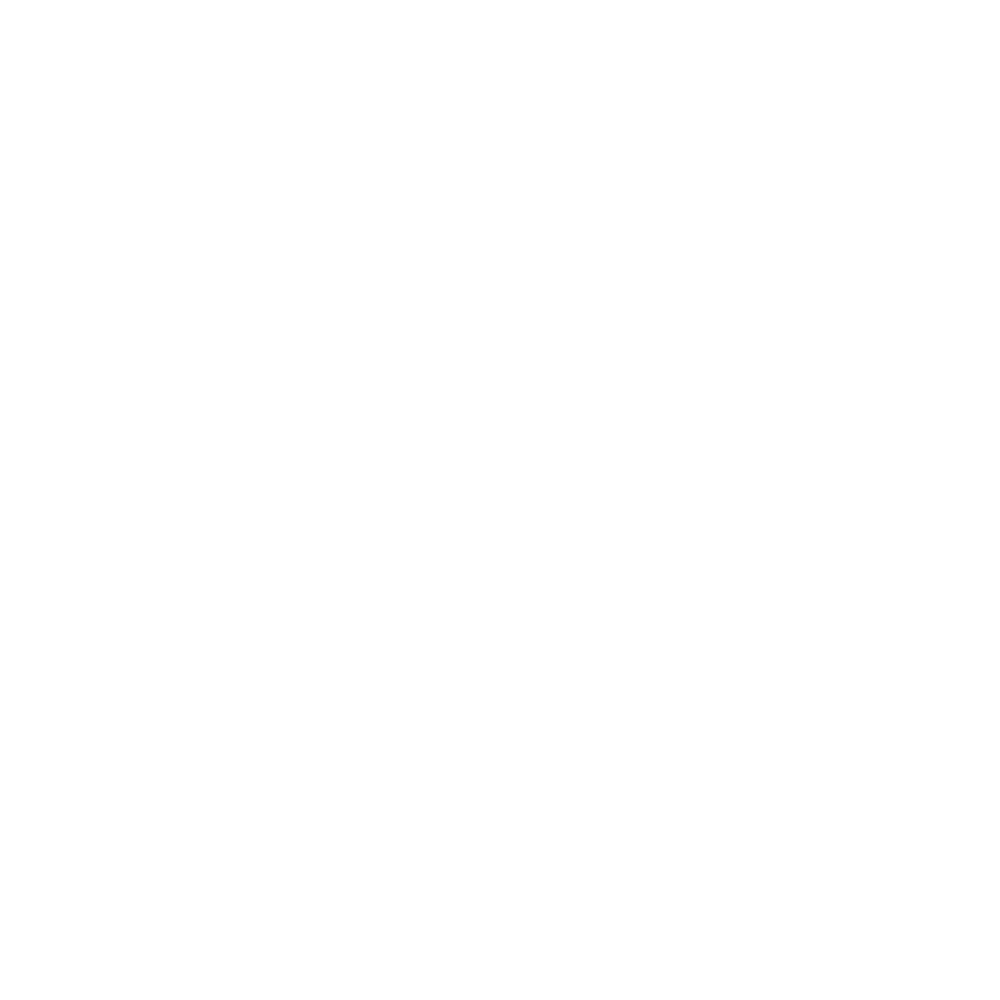

i, sweeptime =  2017-09-10 04:26:36


<IPython.core.display.Javascript object>


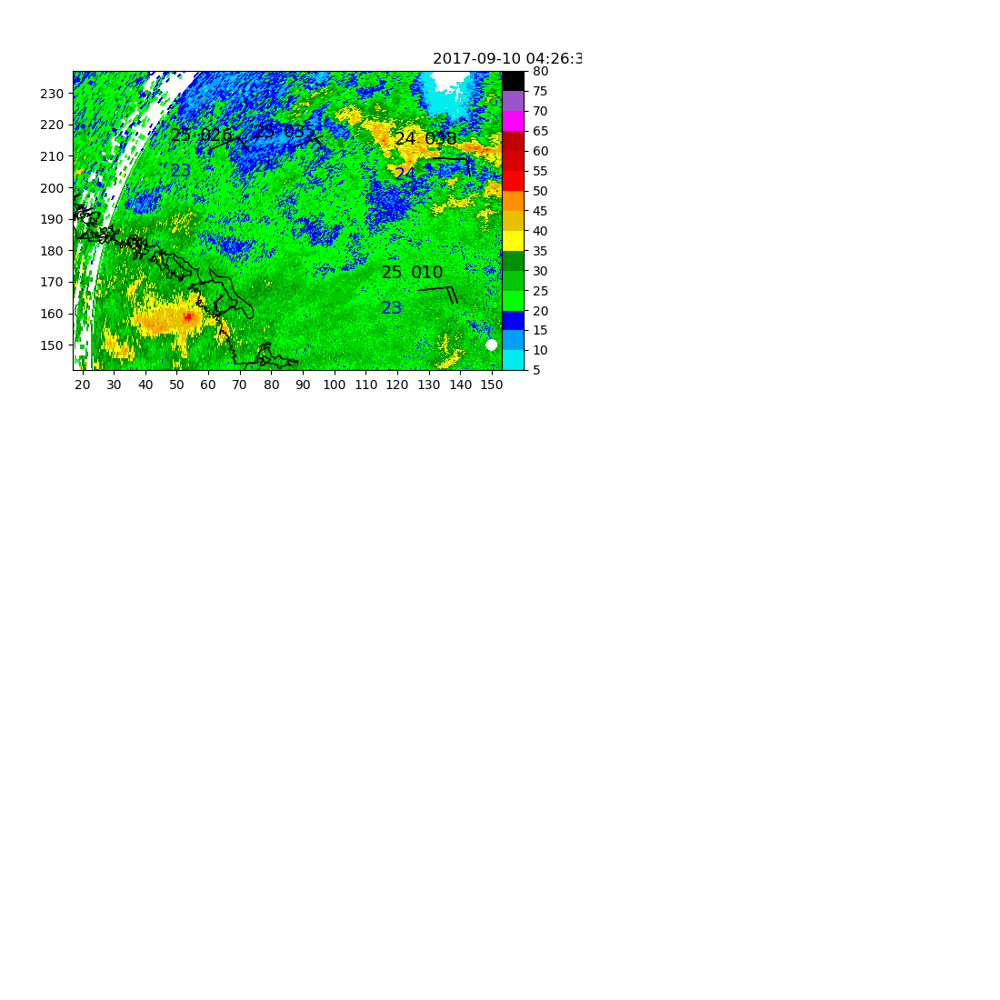

i, sweeptime =  2017-09-10 04:33:16


<IPython.core.display.Javascript object>


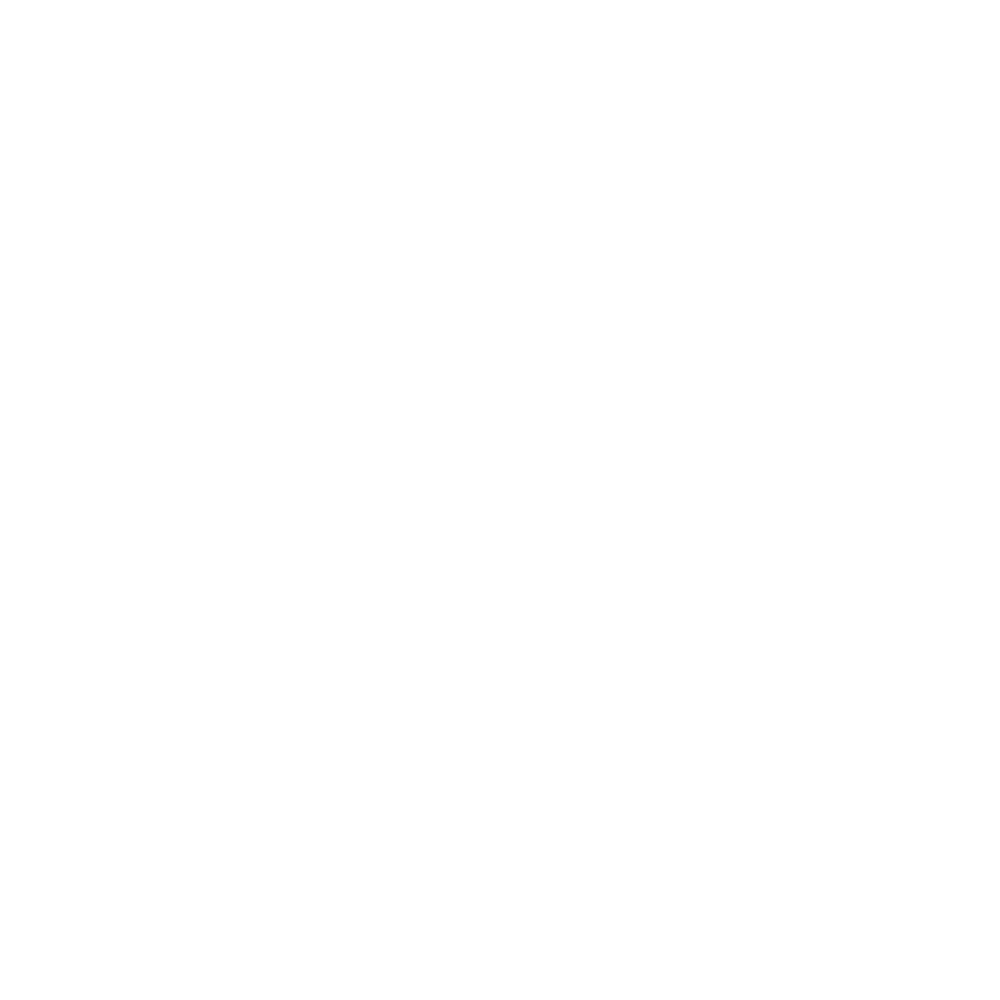

i, sweeptime =  2017-09-10 04:39:54


<IPython.core.display.Javascript object>


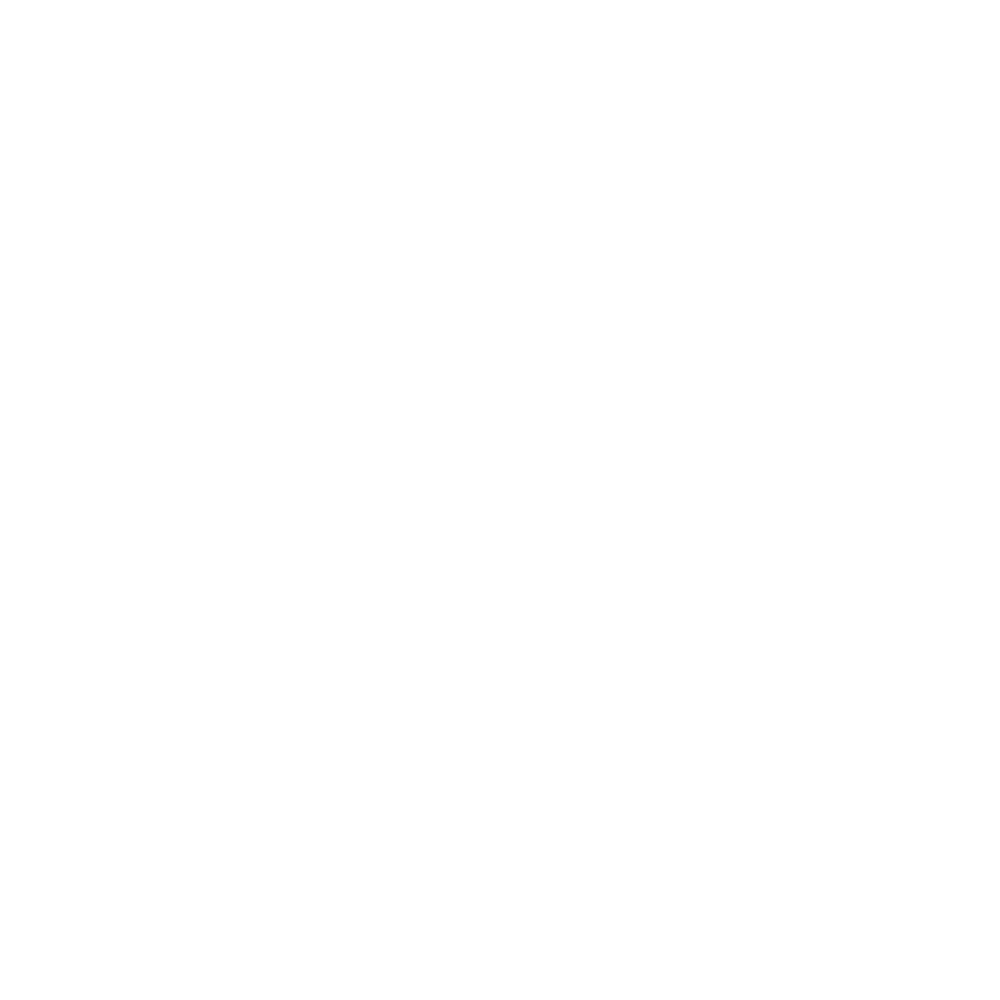

i, sweeptime =  2017-09-10 04:46:24


<IPython.core.display.Javascript object>


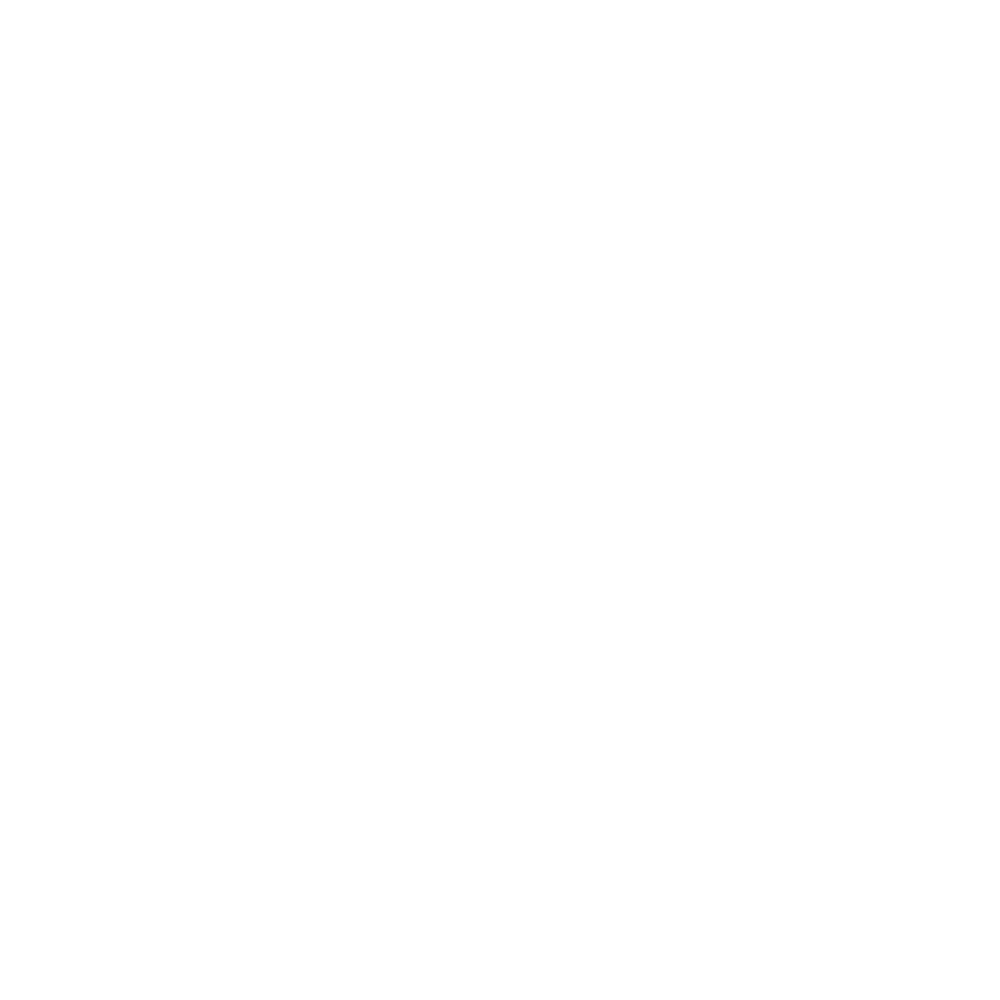

i, sweeptime =  2017-09-10 04:52:59


<IPython.core.display.Javascript object>


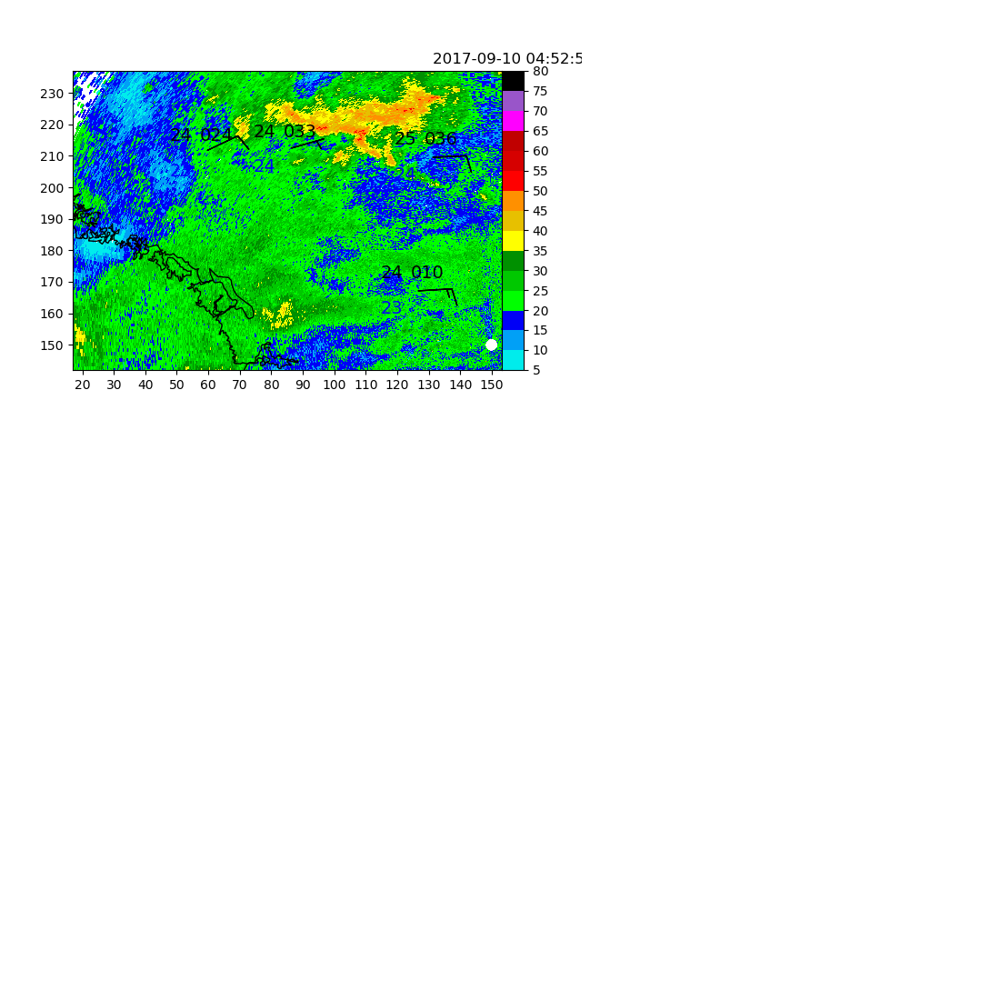

i, sweeptime =  2017-09-10 04:59:55


<IPython.core.display.Javascript object>


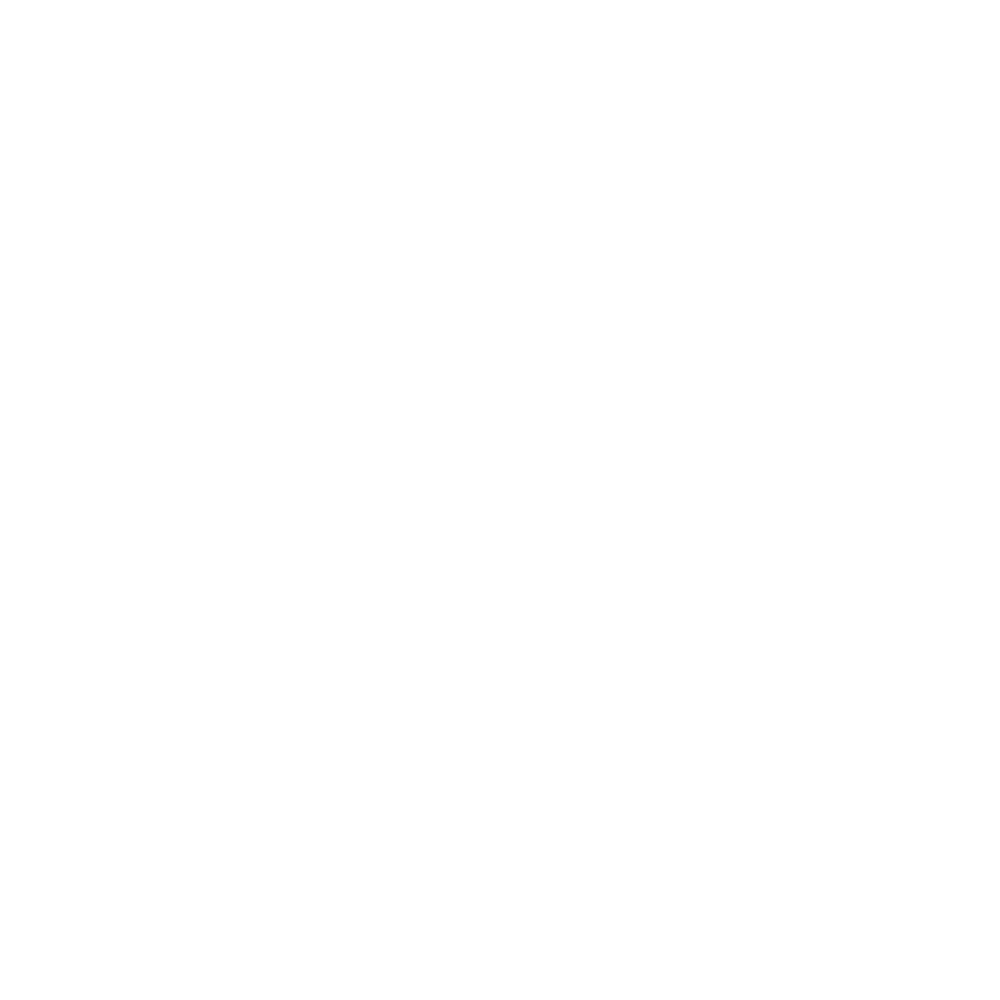

i, sweeptime =  2017-09-10 05:06:31


<IPython.core.display.Javascript object>


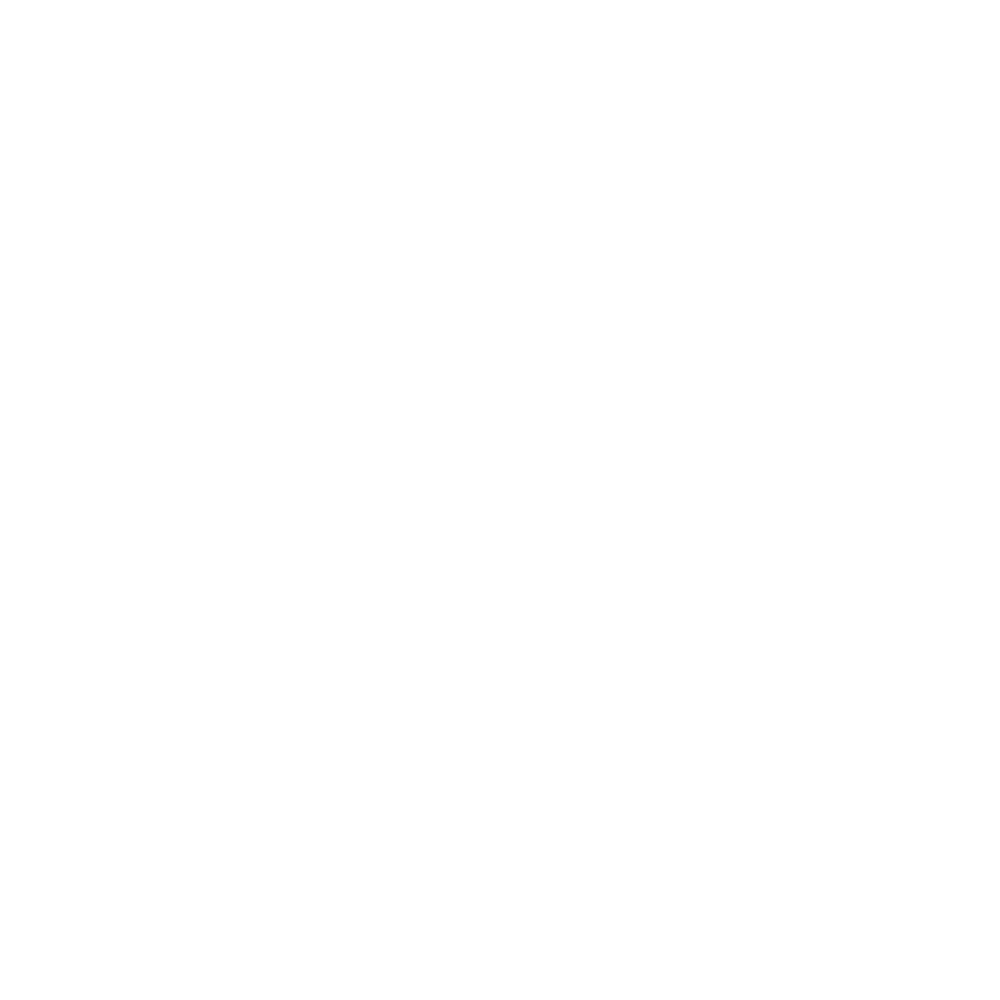

i, sweeptime =  2017-09-10 05:13:26


<IPython.core.display.Javascript object>


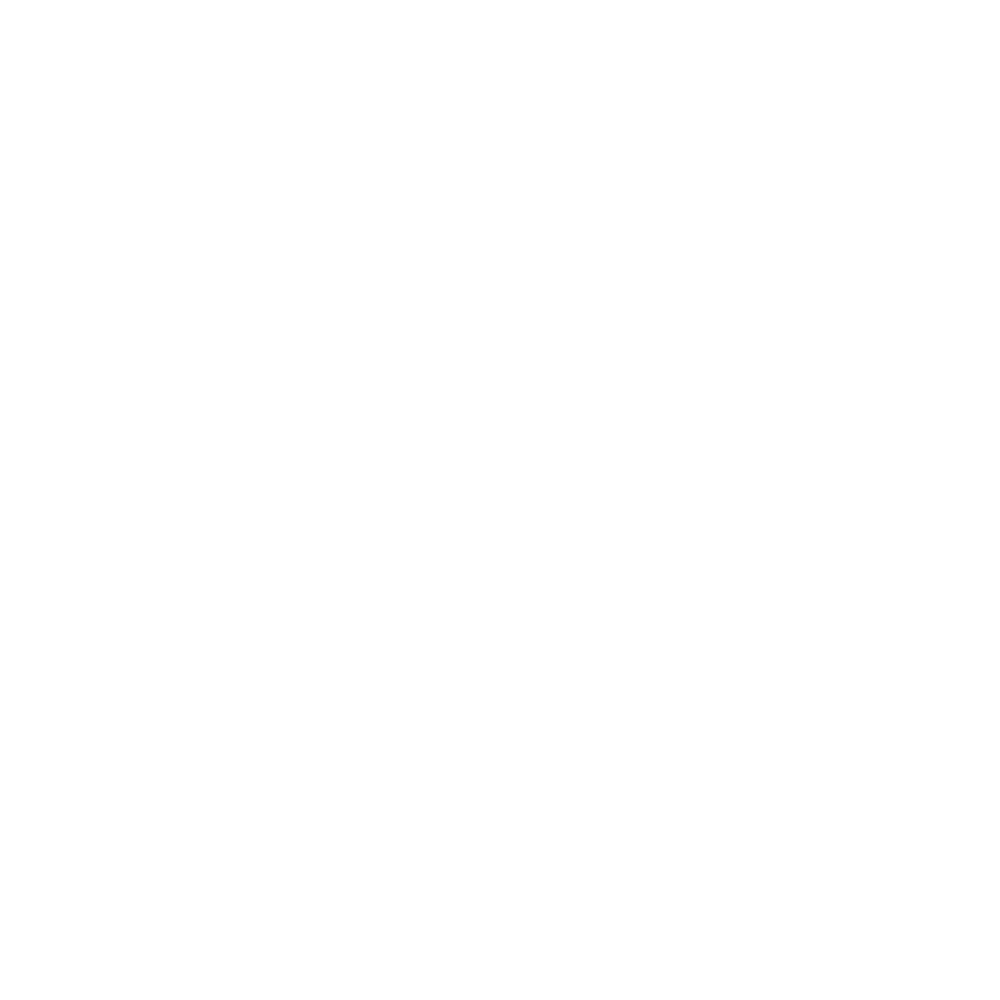

i, sweeptime =  2017-09-10 05:19:56


<IPython.core.display.Javascript object>


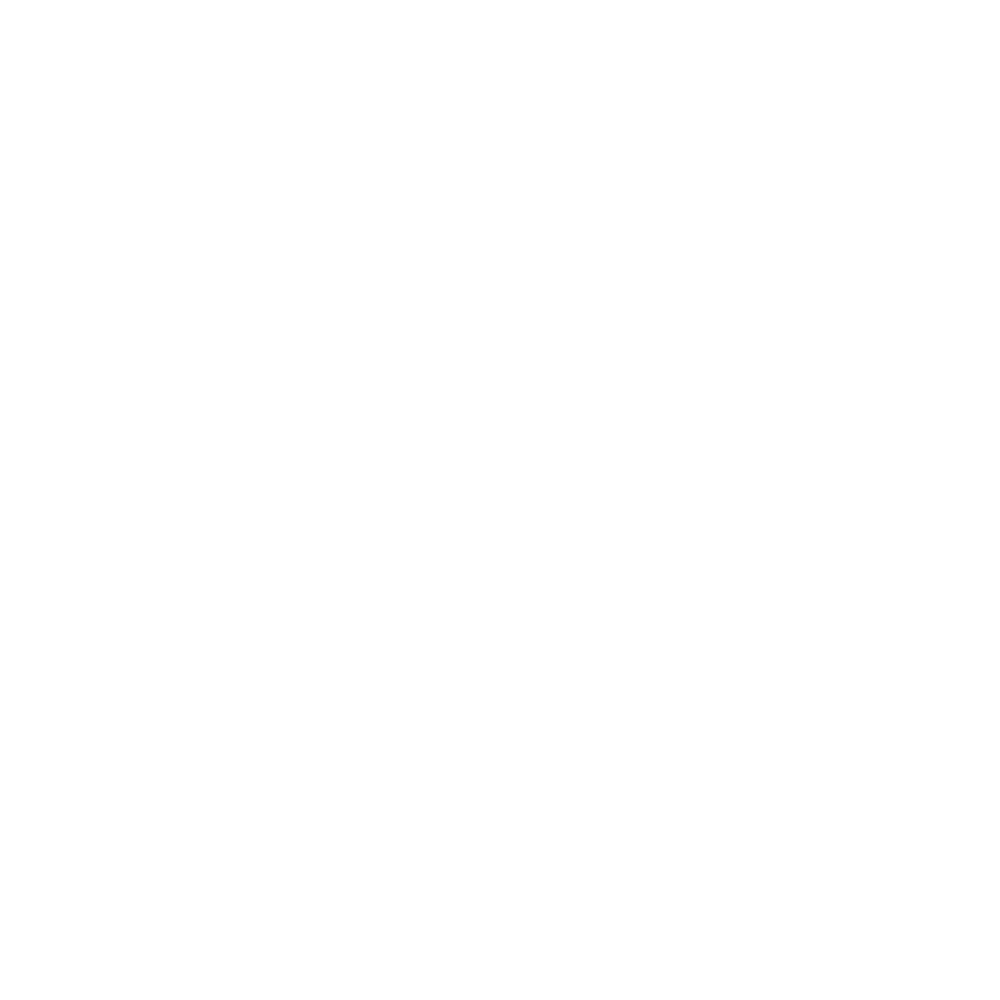

i, sweeptime =  2017-09-10 05:26:32


<IPython.core.display.Javascript object>


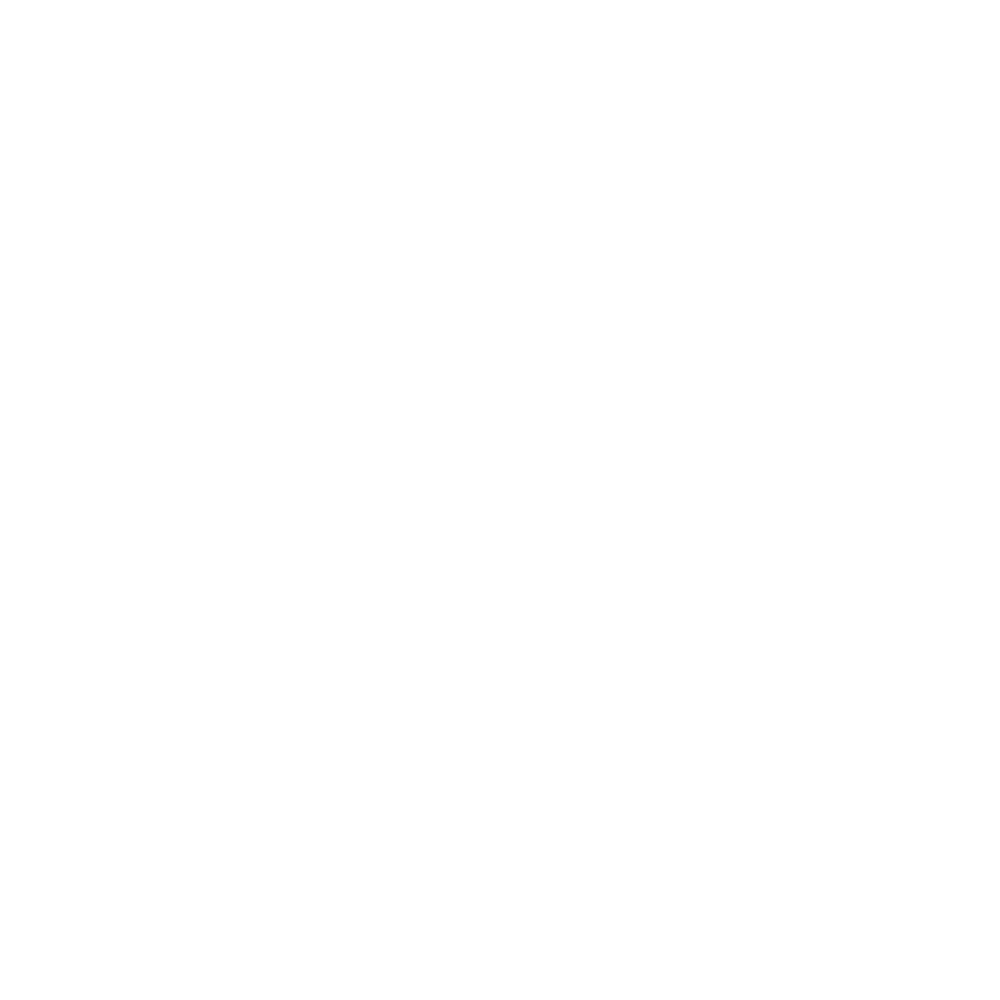

i, sweeptime =  2017-09-10 05:33:26


<IPython.core.display.Javascript object>


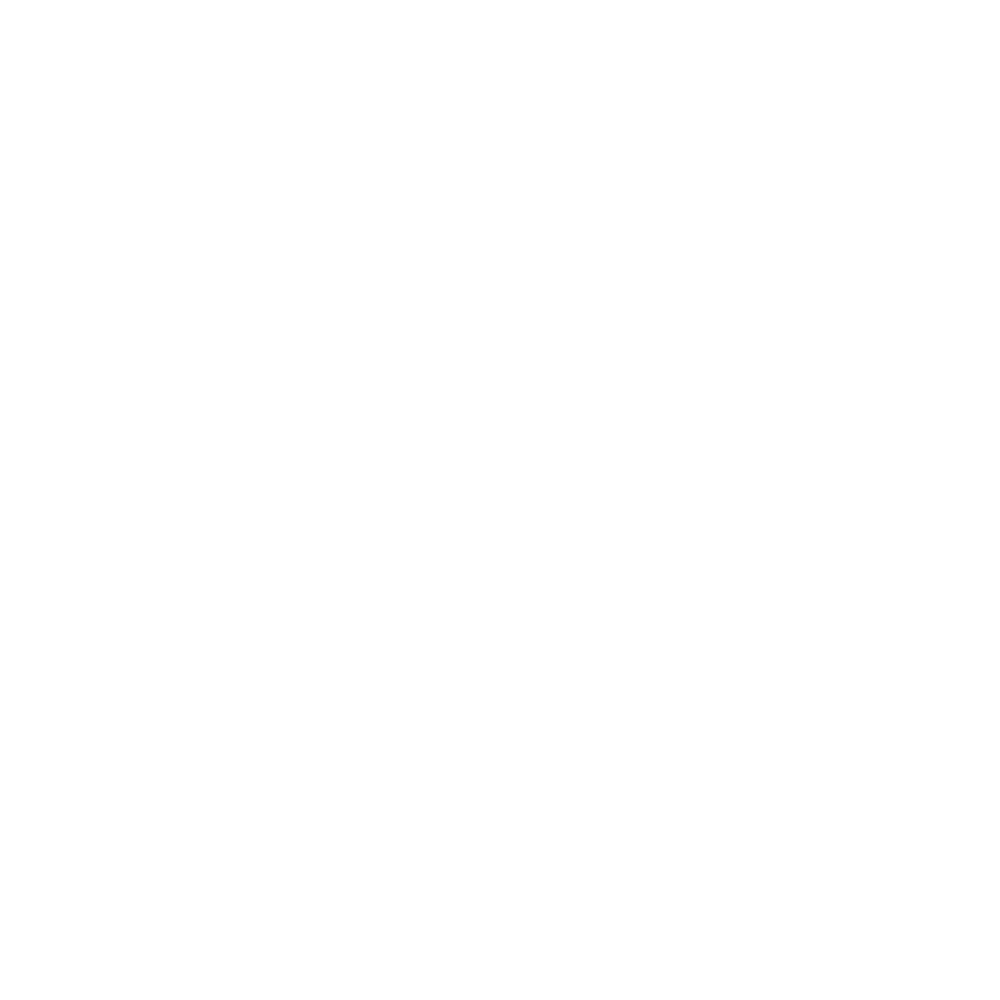

i, sweeptime =  2017-09-10 05:39:56


<IPython.core.display.Javascript object>


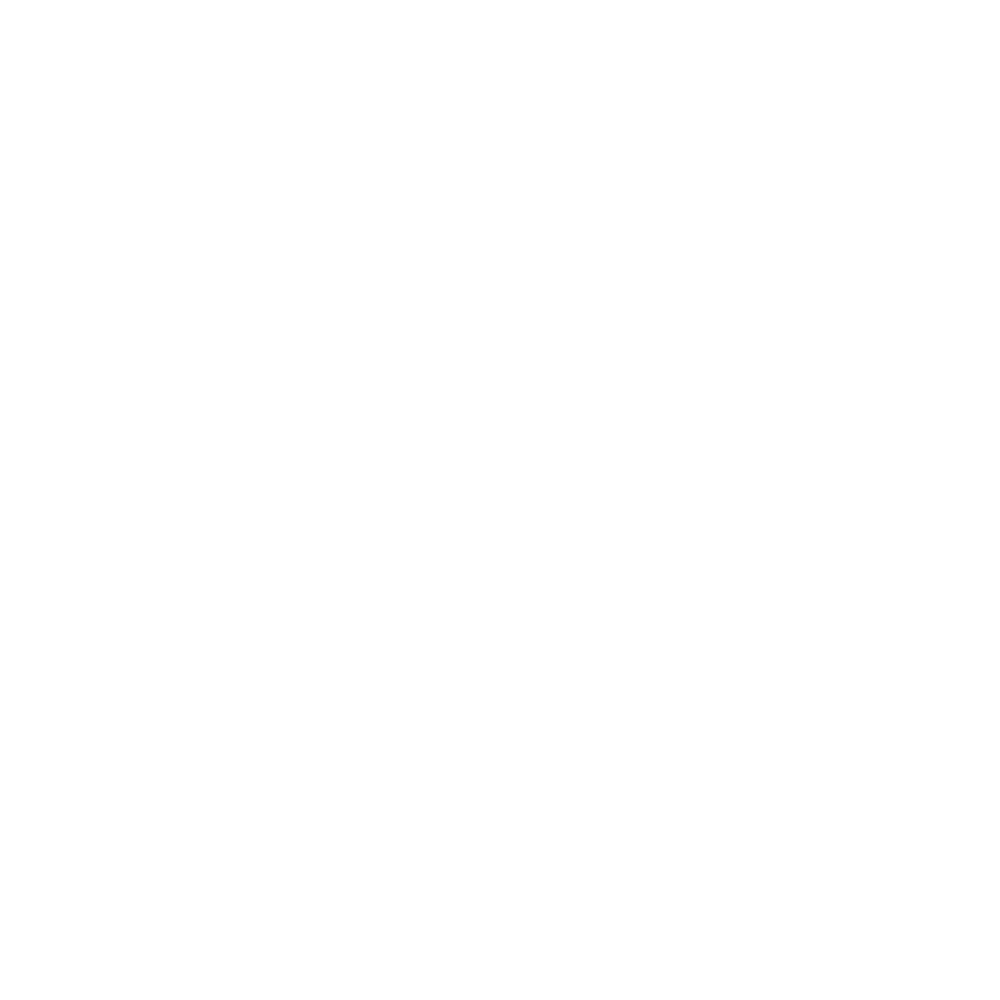

i, sweeptime =  2017-09-10 05:46:31


<IPython.core.display.Javascript object>


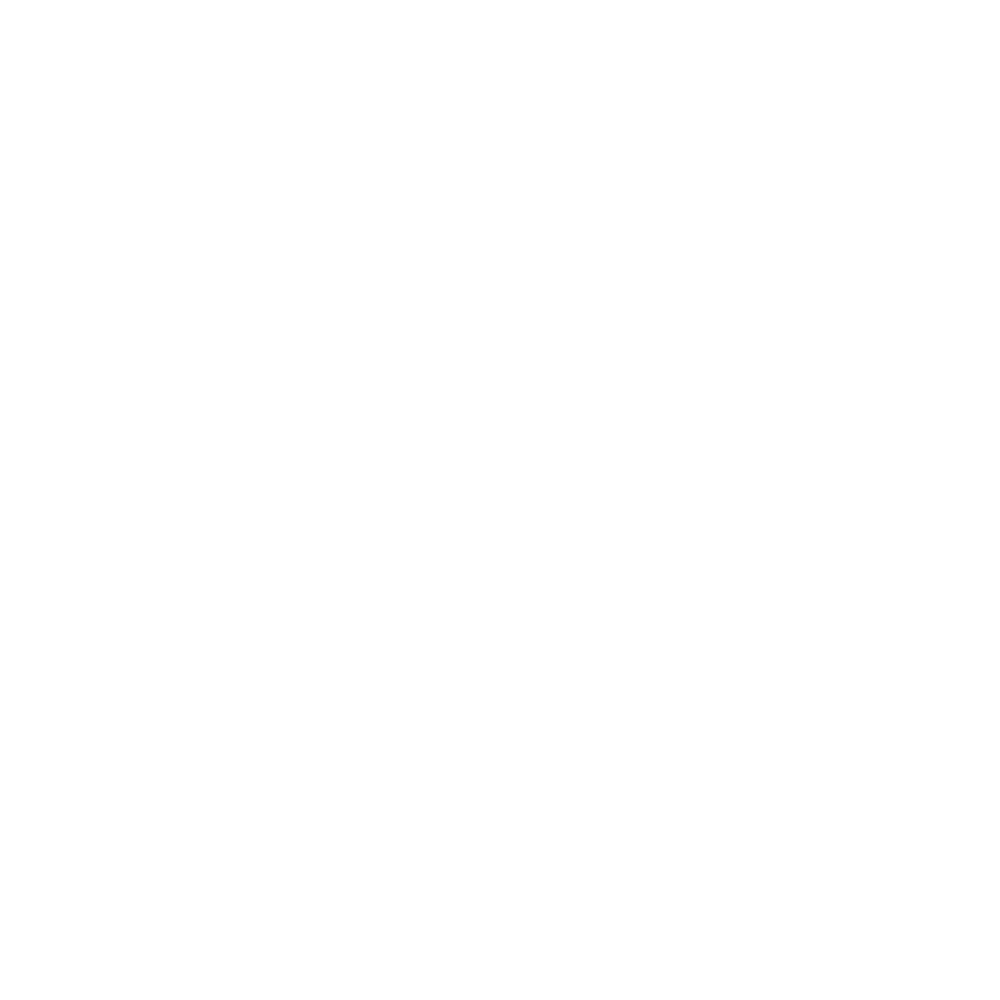

i, sweeptime =  2017-09-10 05:53:31


<IPython.core.display.Javascript object>


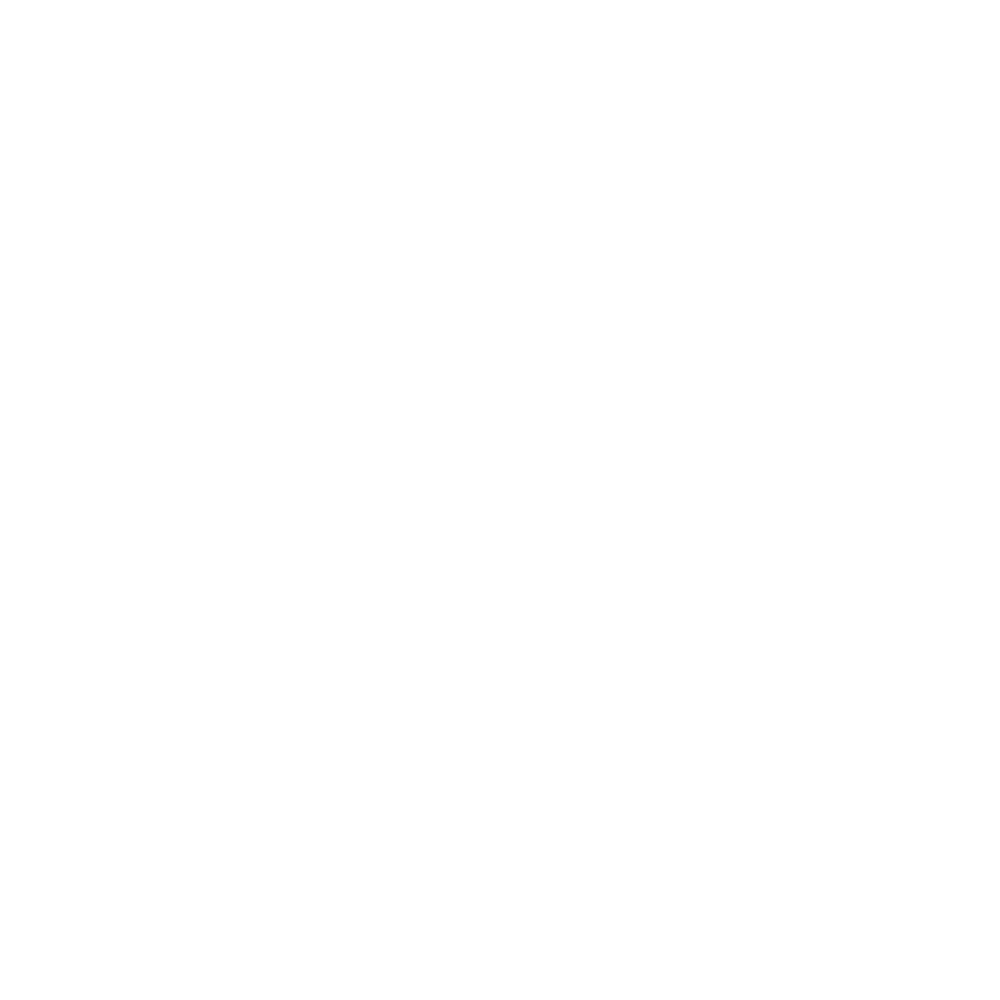

i, sweeptime =  2017-09-10 06:00:26


<IPython.core.display.Javascript object>


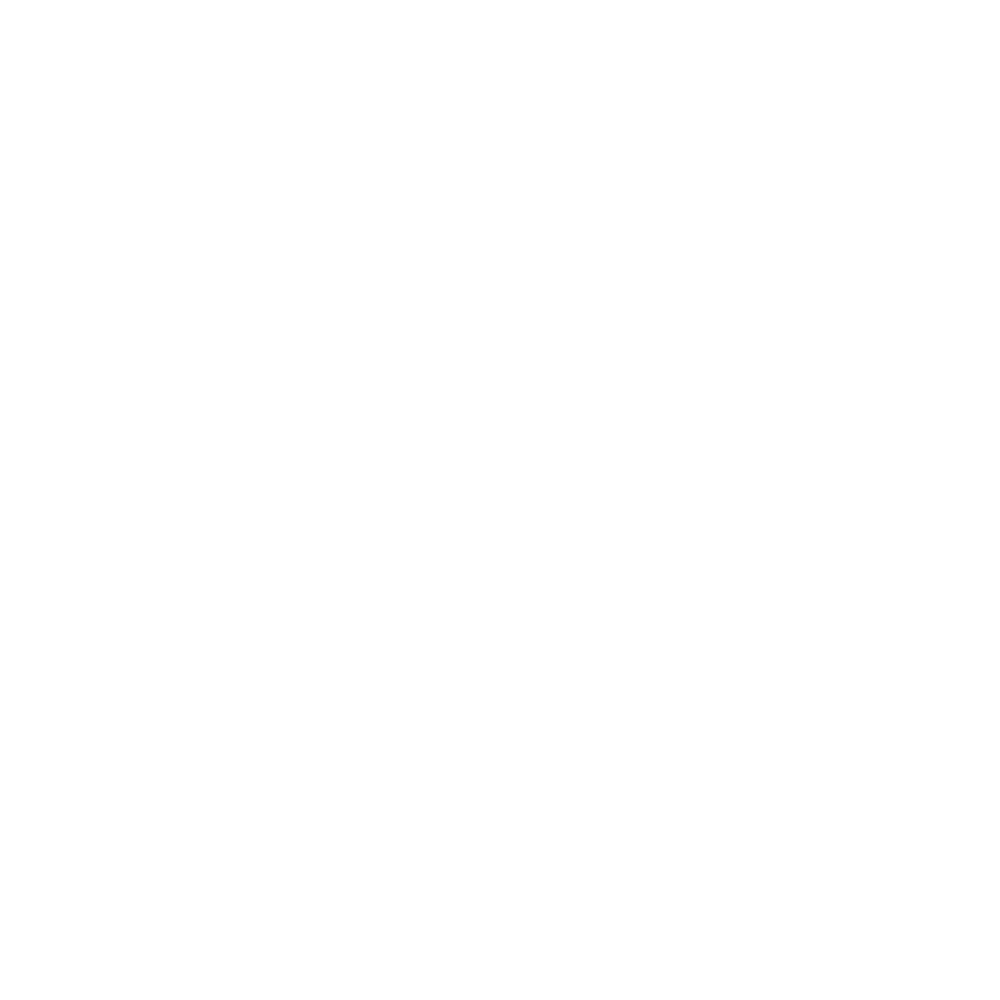

i, sweeptime =  2017-09-10 06:06:57


<IPython.core.display.Javascript object>


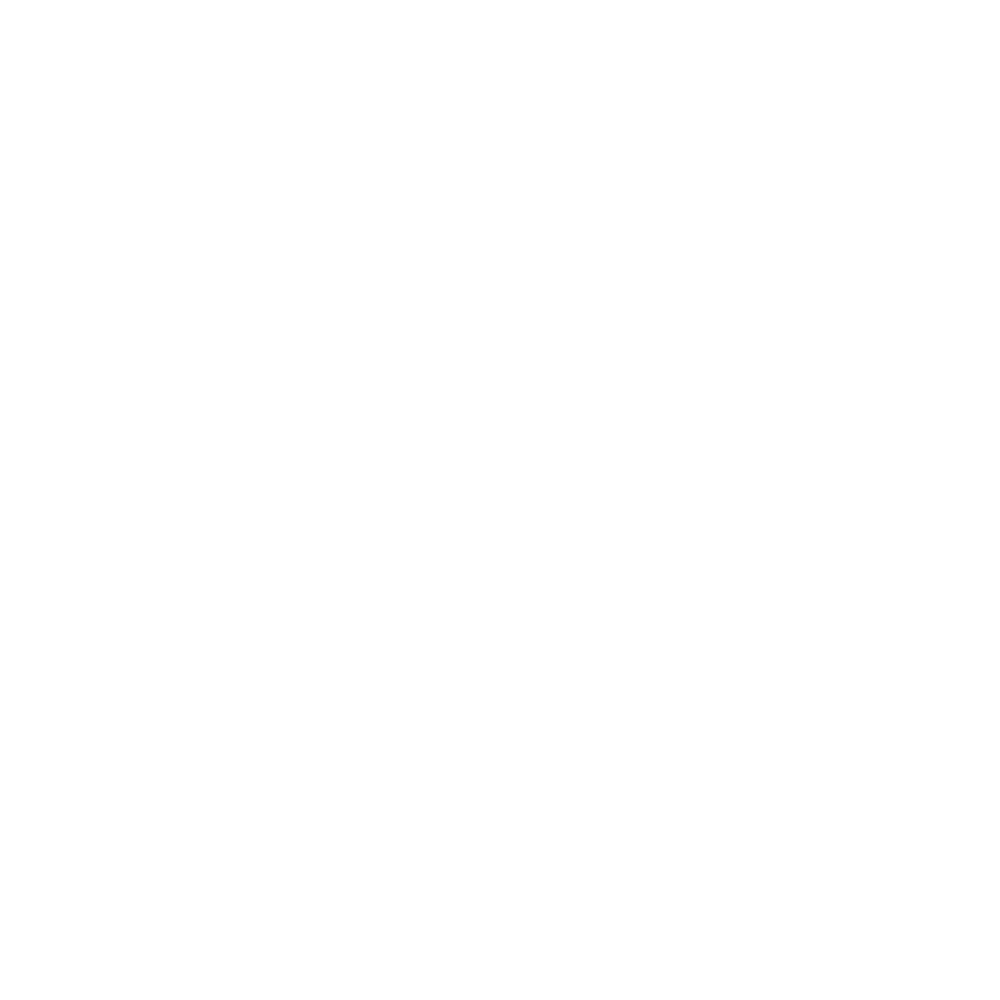

i, sweeptime =  2017-09-10 06:13:27


<IPython.core.display.Javascript object>


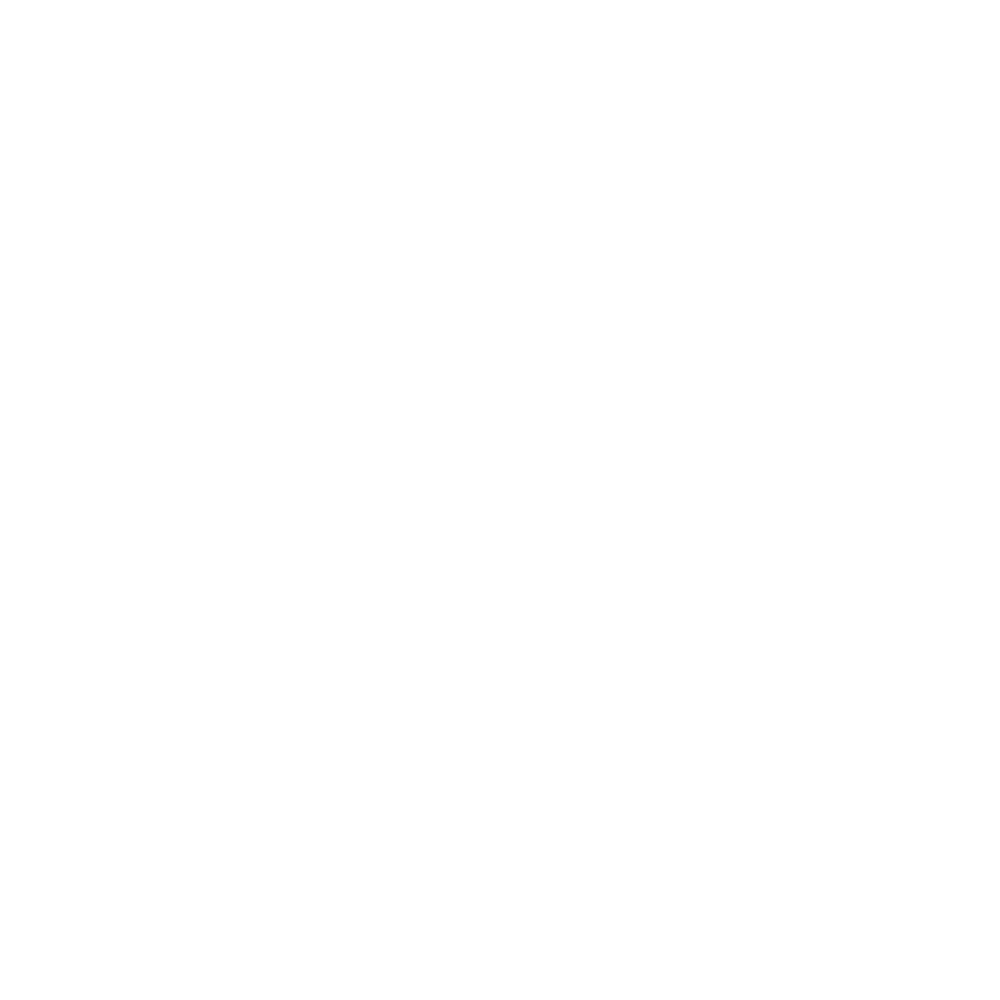

i, sweeptime =  2017-09-10 06:20:04


<IPython.core.display.Javascript object>


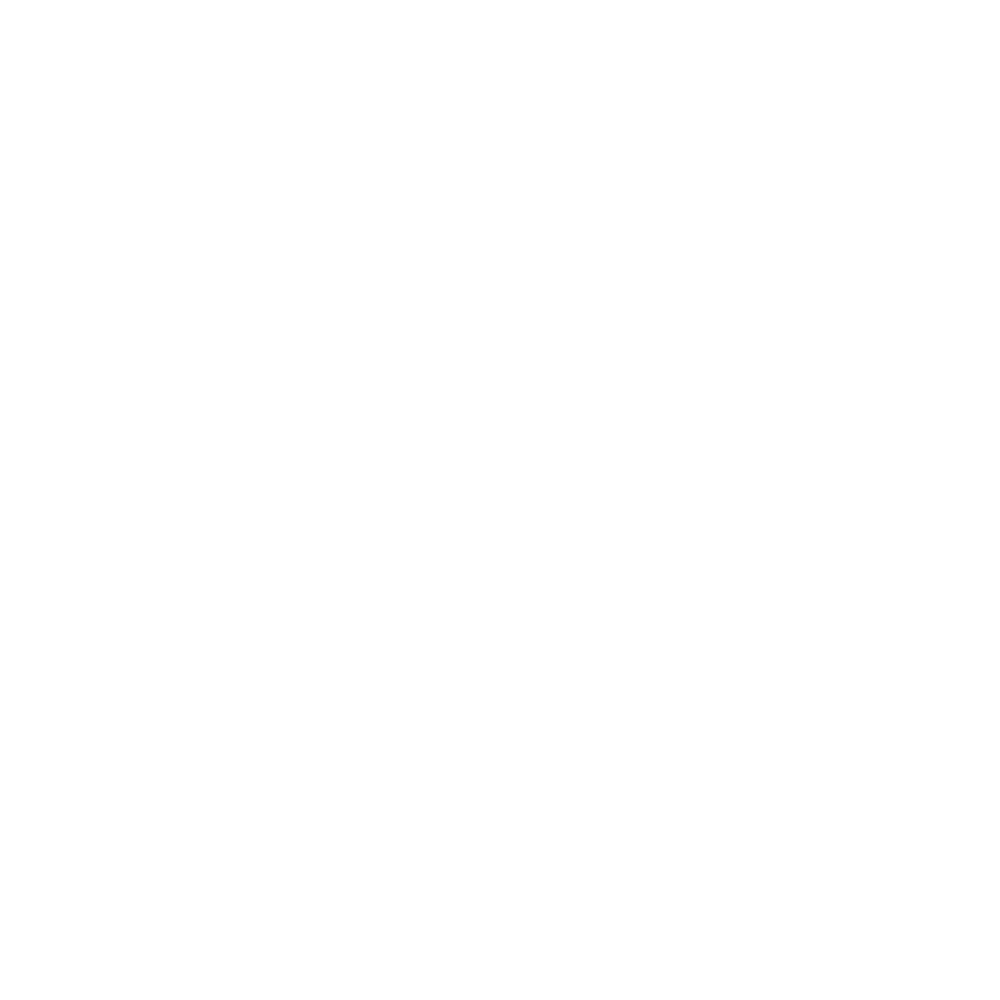

i, sweeptime =  2017-09-10 06:27:03


<IPython.core.display.Javascript object>


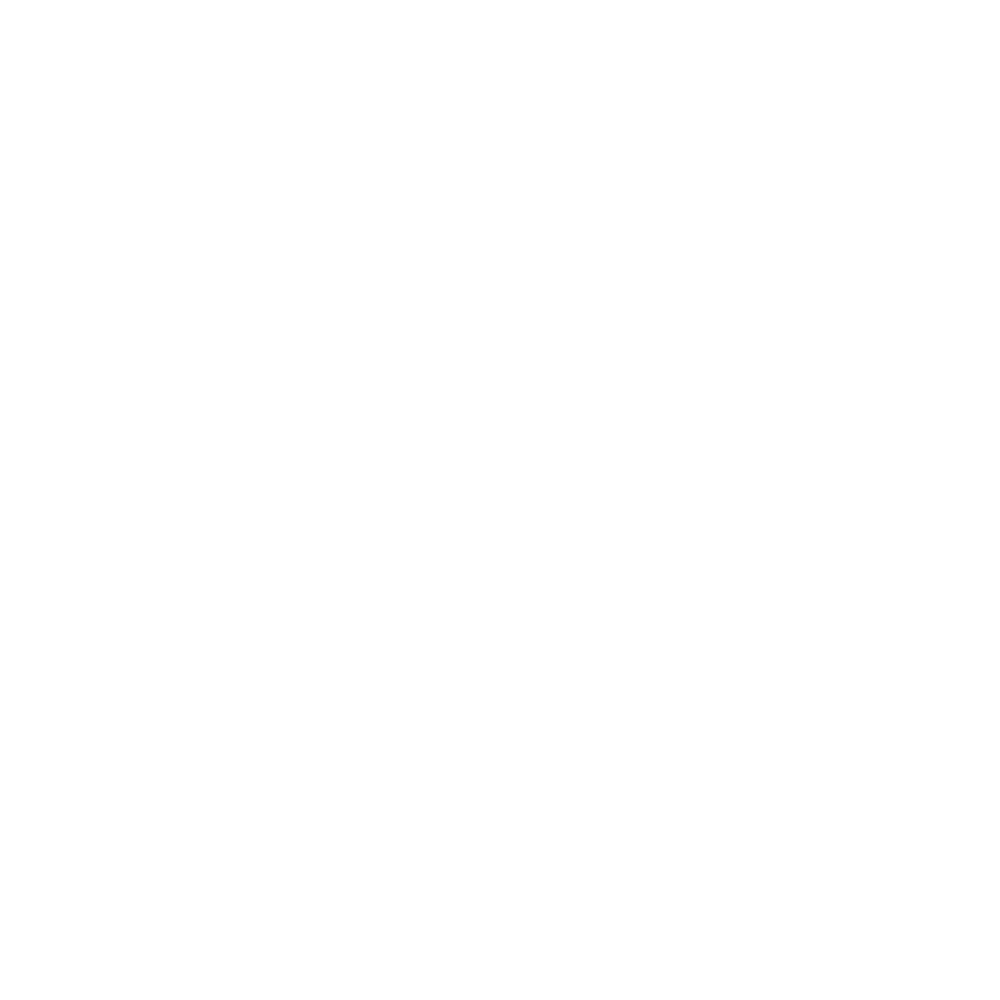

i, sweeptime =  2017-09-10 06:33:58


<IPython.core.display.Javascript object>


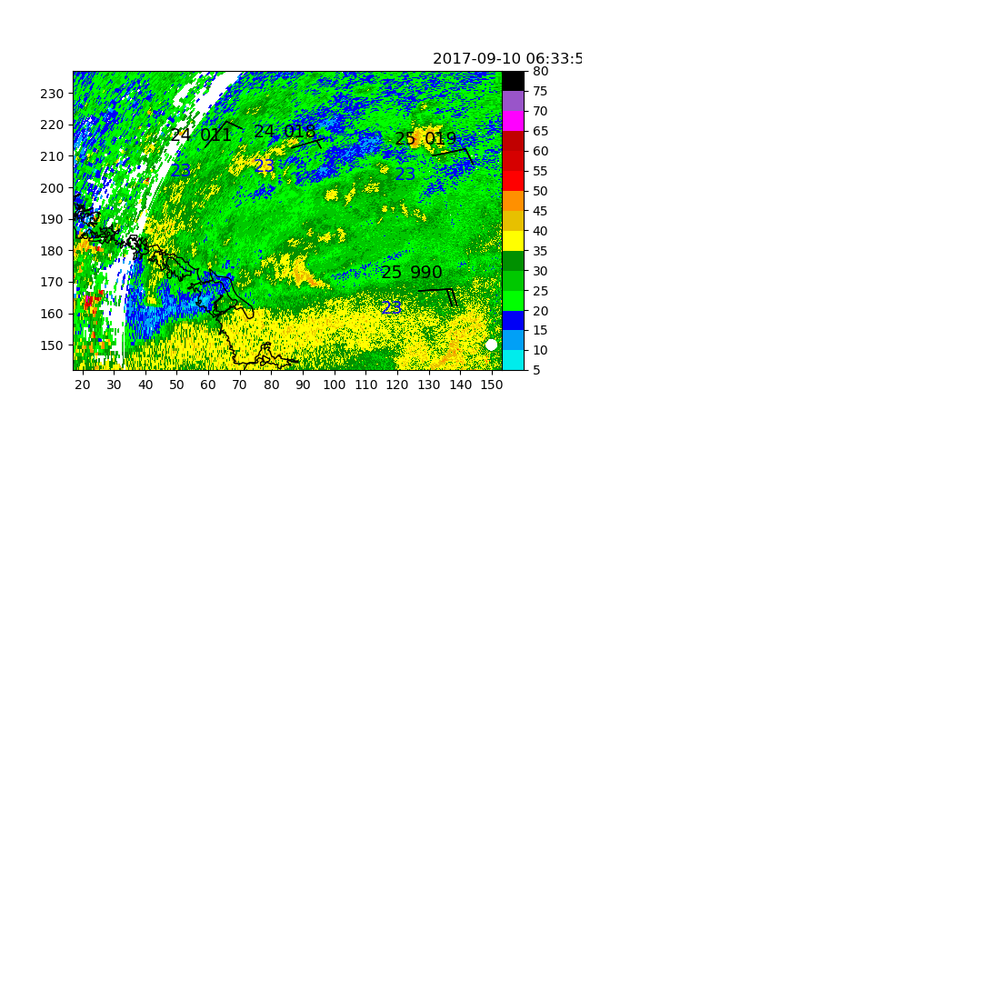

i, sweeptime =  2017-09-10 06:40:31


<IPython.core.display.Javascript object>


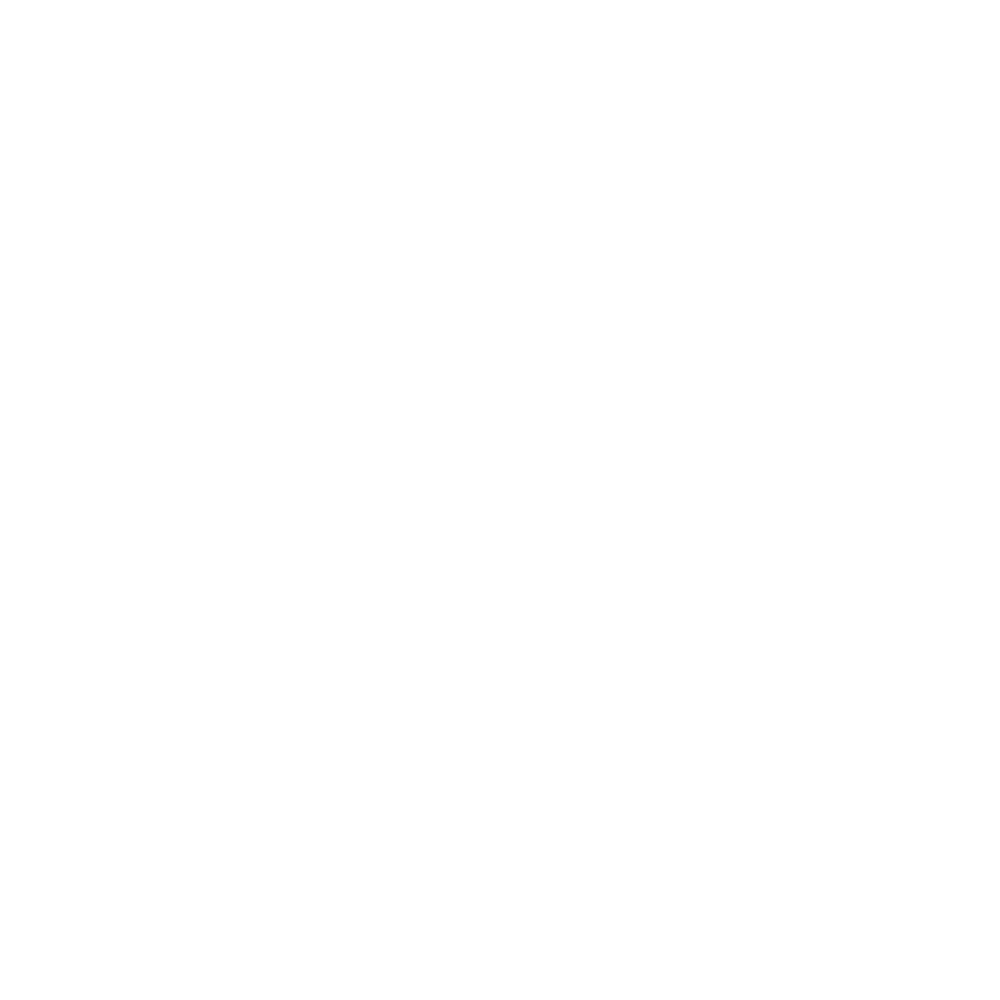

i, sweeptime =  2017-09-10 06:47:17


<IPython.core.display.Javascript object>


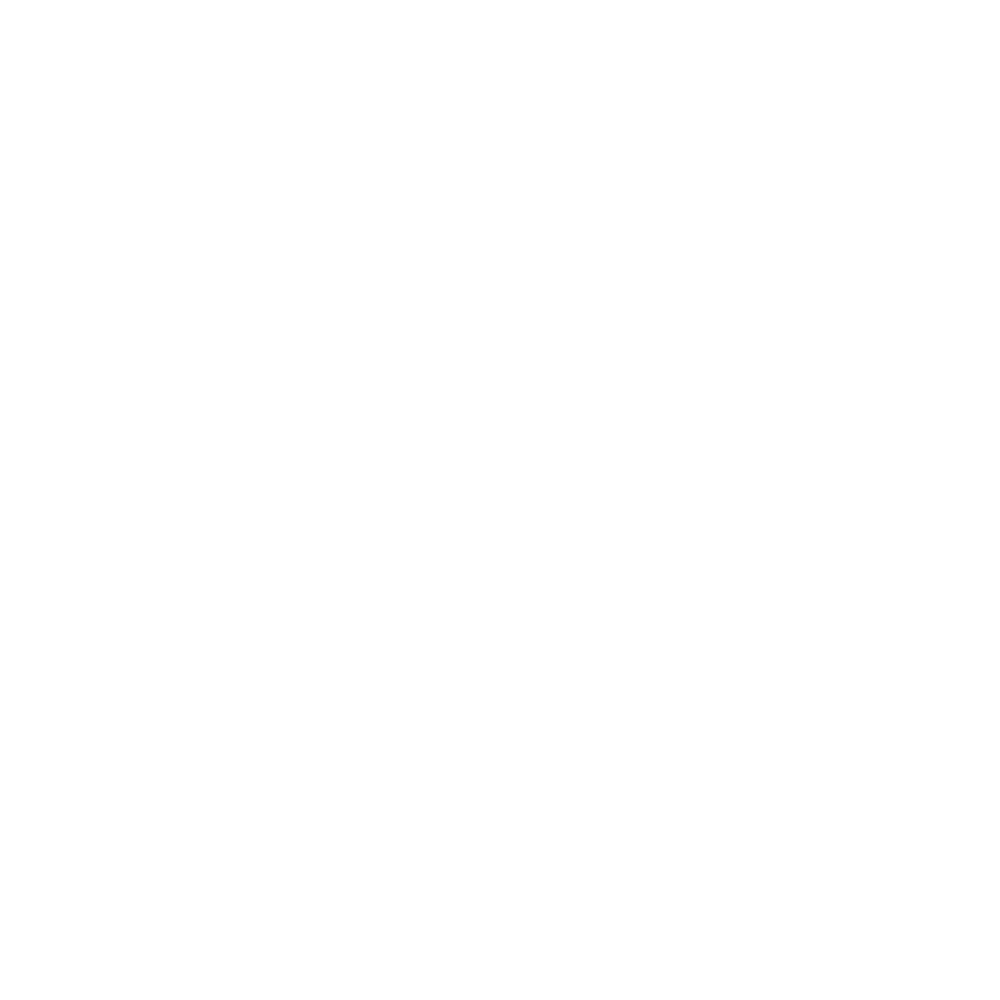

i, sweeptime =  2017-09-10 06:53:47


<IPython.core.display.Javascript object>


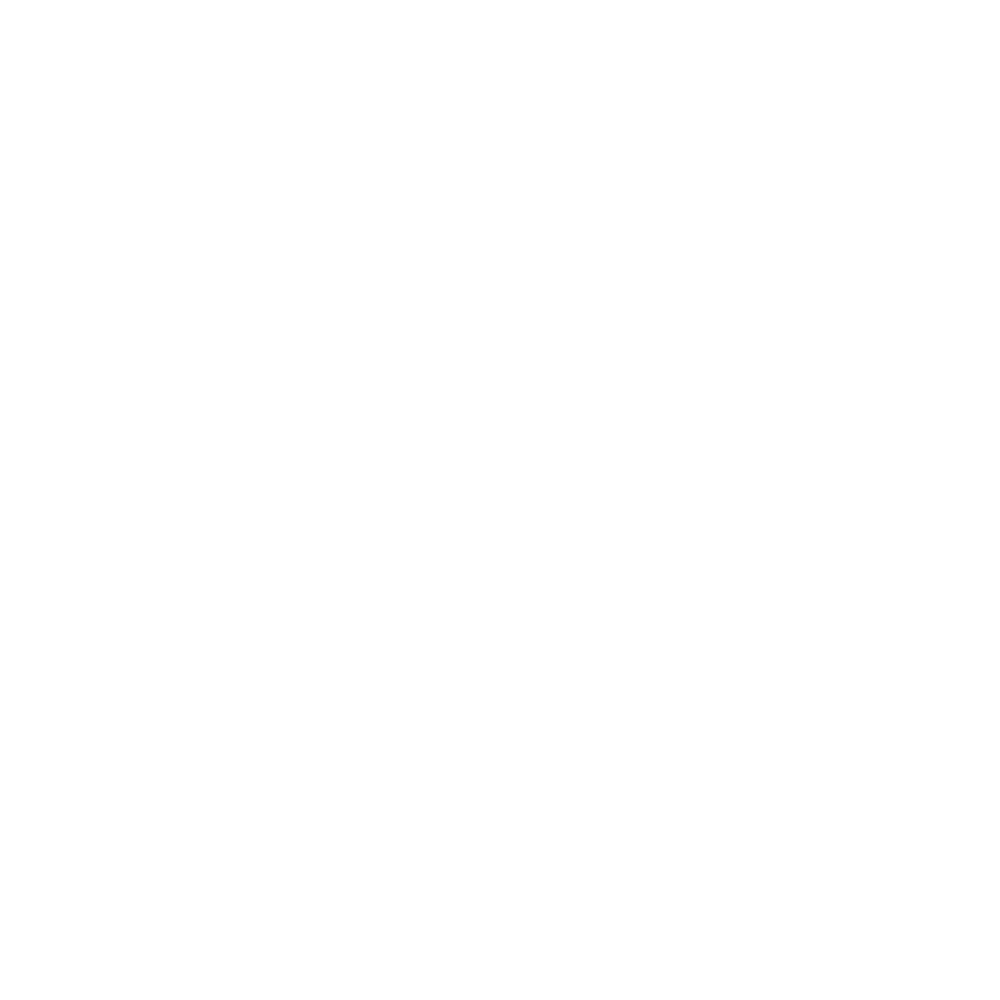

i, sweeptime =  2017-09-10 07:00:17


<IPython.core.display.Javascript object>


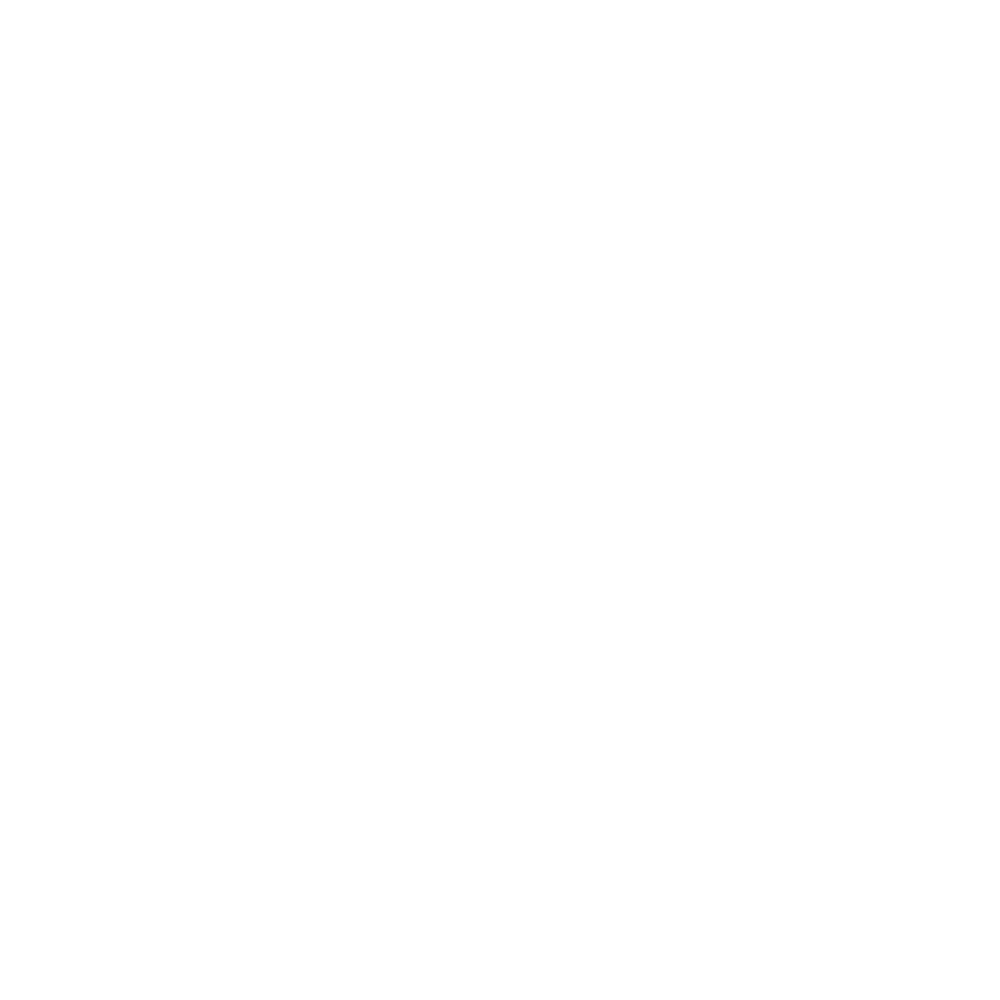

i, sweeptime =  2017-09-10 07:06:47


<IPython.core.display.Javascript object>


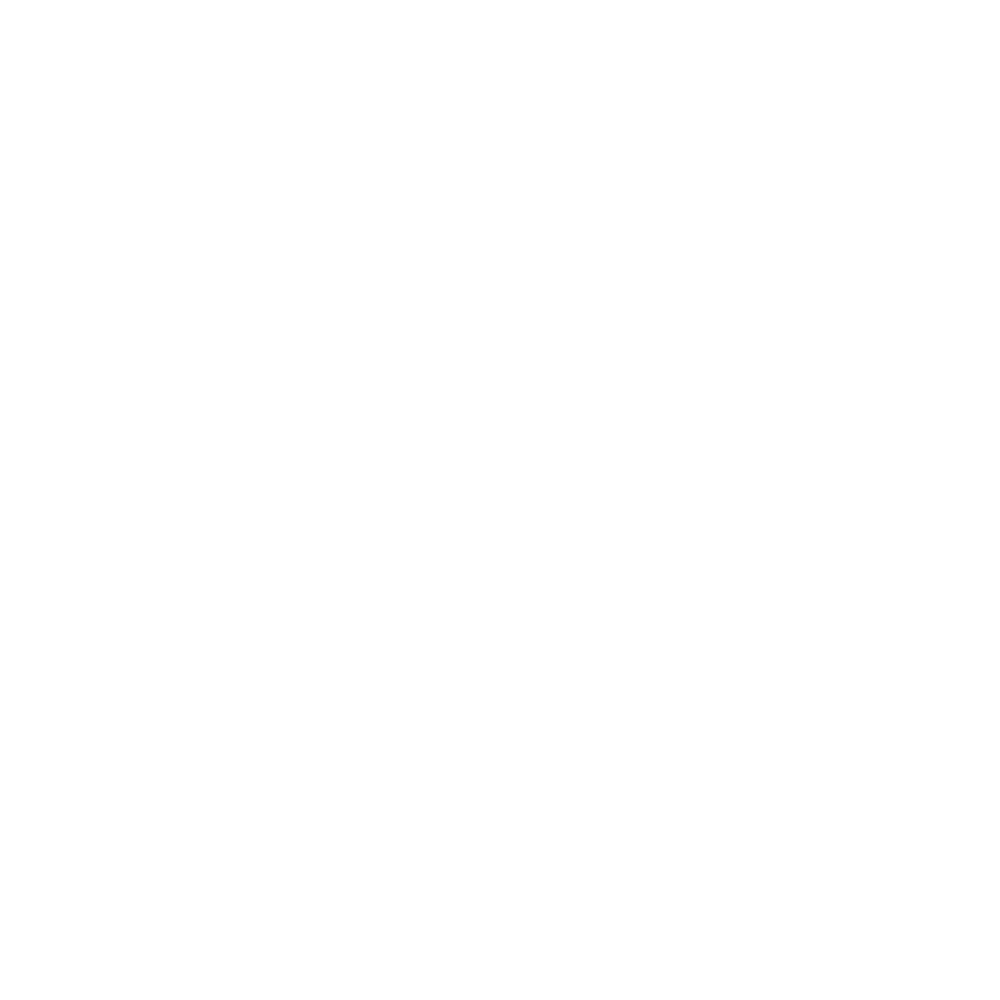

i, sweeptime =  2017-09-10 07:13:17


<IPython.core.display.Javascript object>


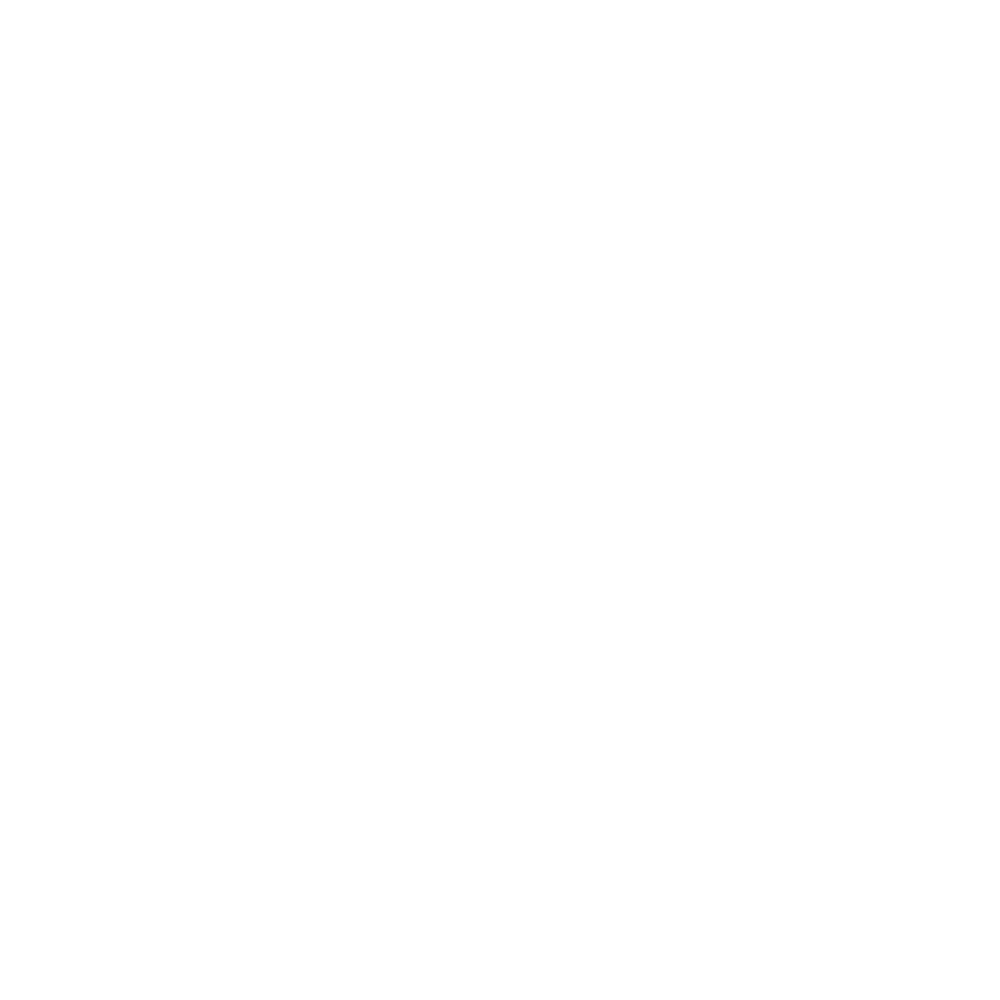

i, sweeptime =  2017-09-10 07:19:49


<IPython.core.display.Javascript object>


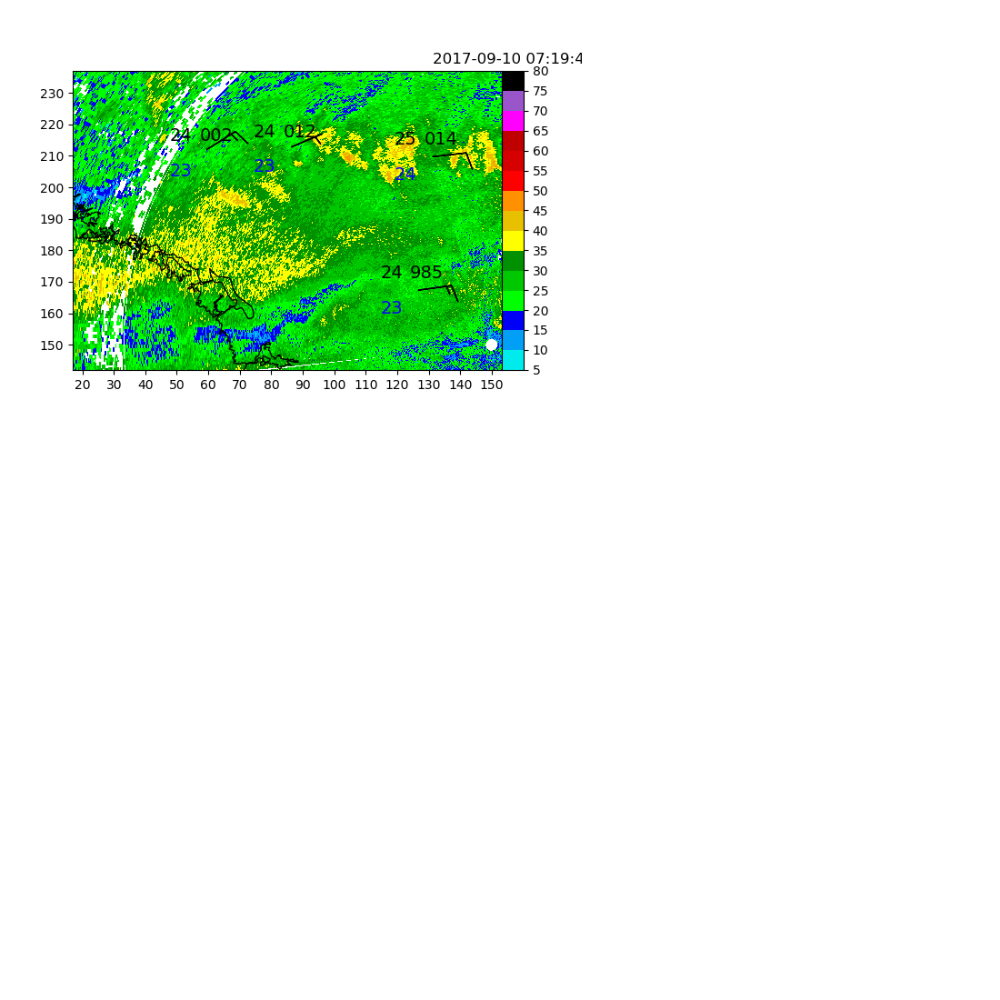

i, sweeptime =  2017-09-10 07:26:19


<IPython.core.display.Javascript object>


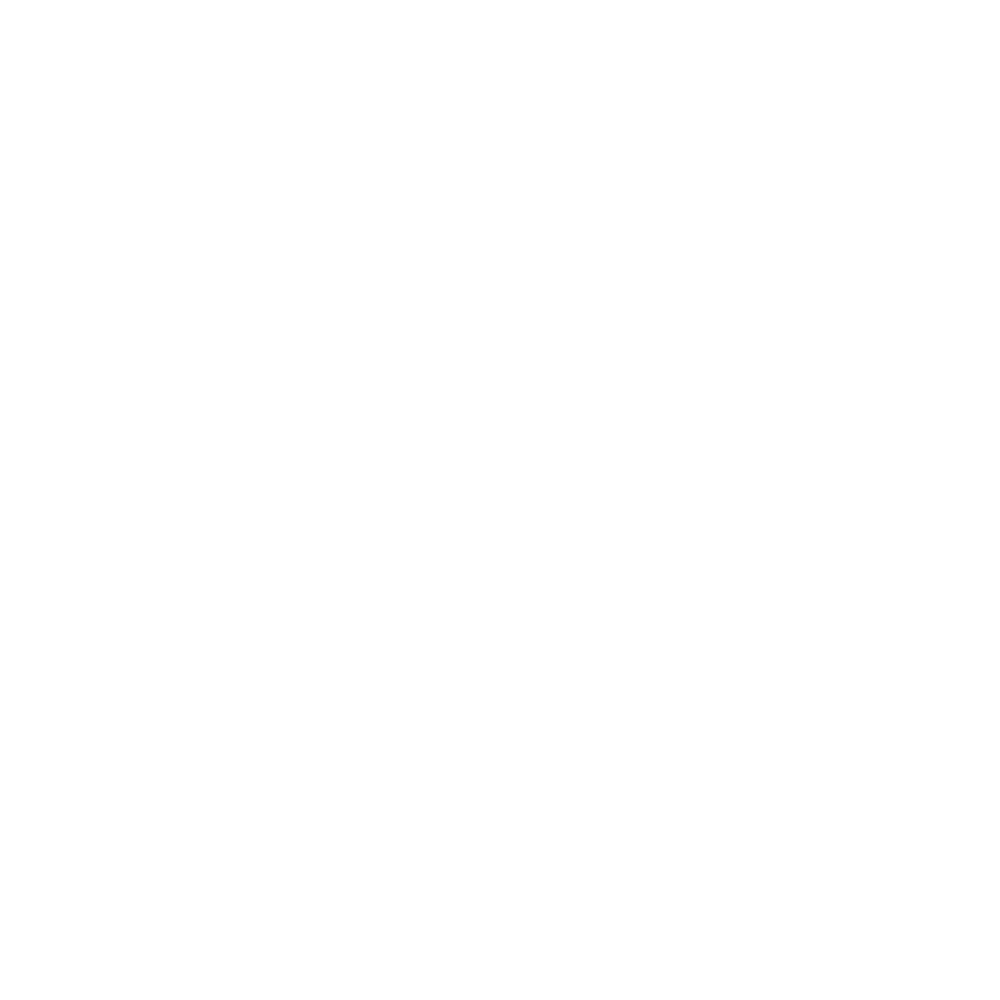

i, sweeptime =  2017-09-10 07:32:49


<IPython.core.display.Javascript object>


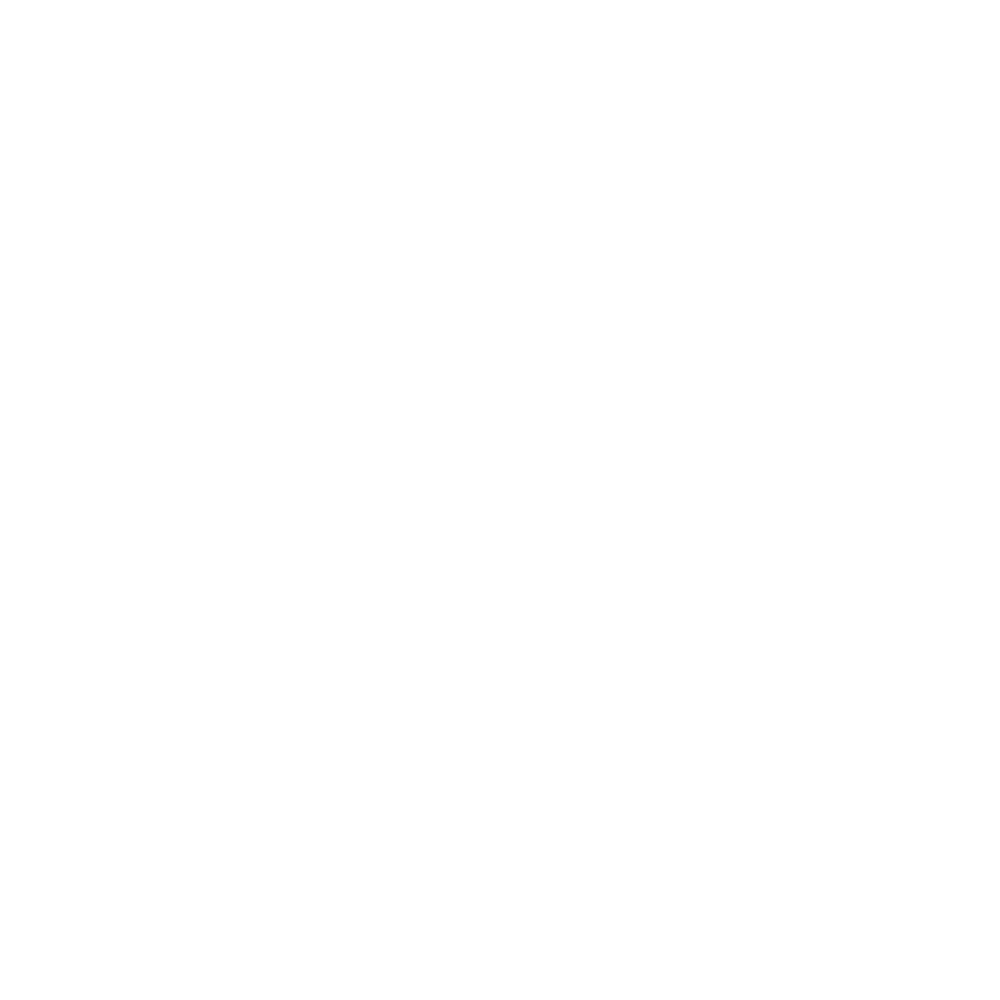

i, sweeptime =  2017-09-10 07:39:18


<IPython.core.display.Javascript object>


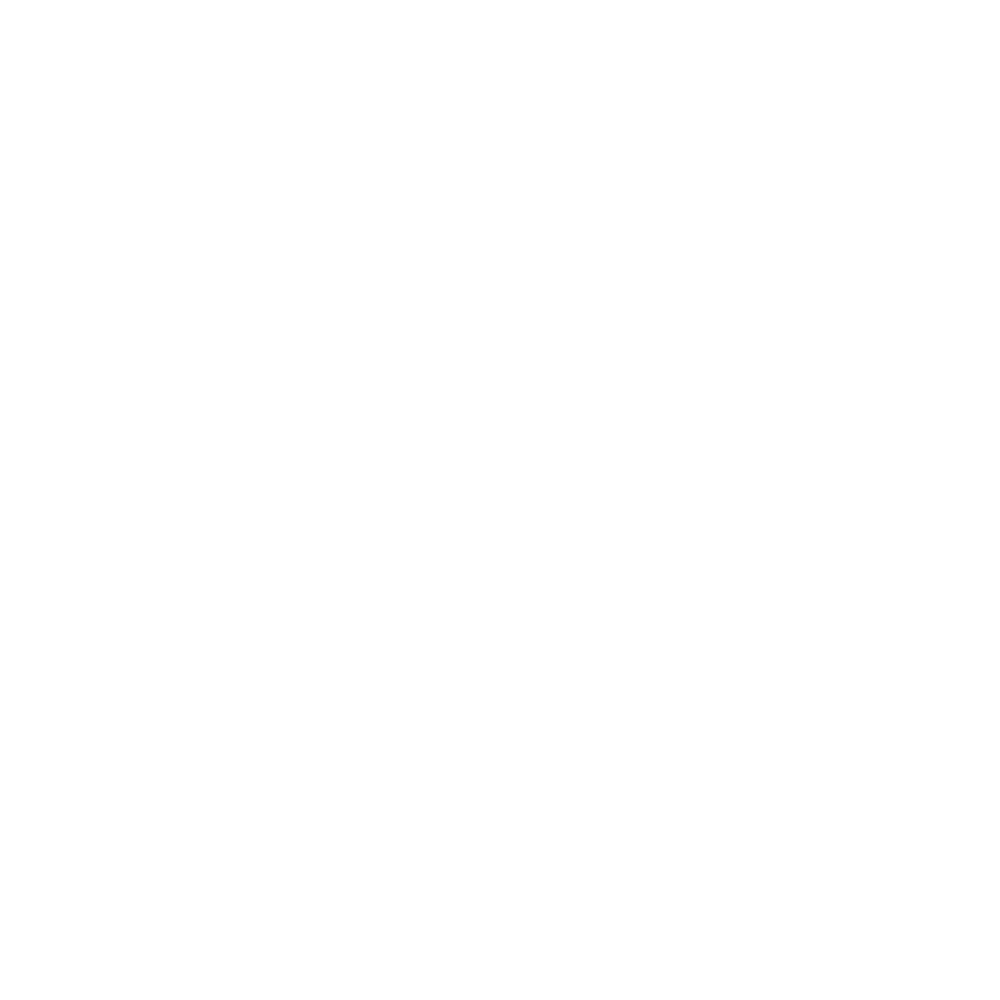

i, sweeptime =  2017-09-10 07:45:48


<IPython.core.display.Javascript object>


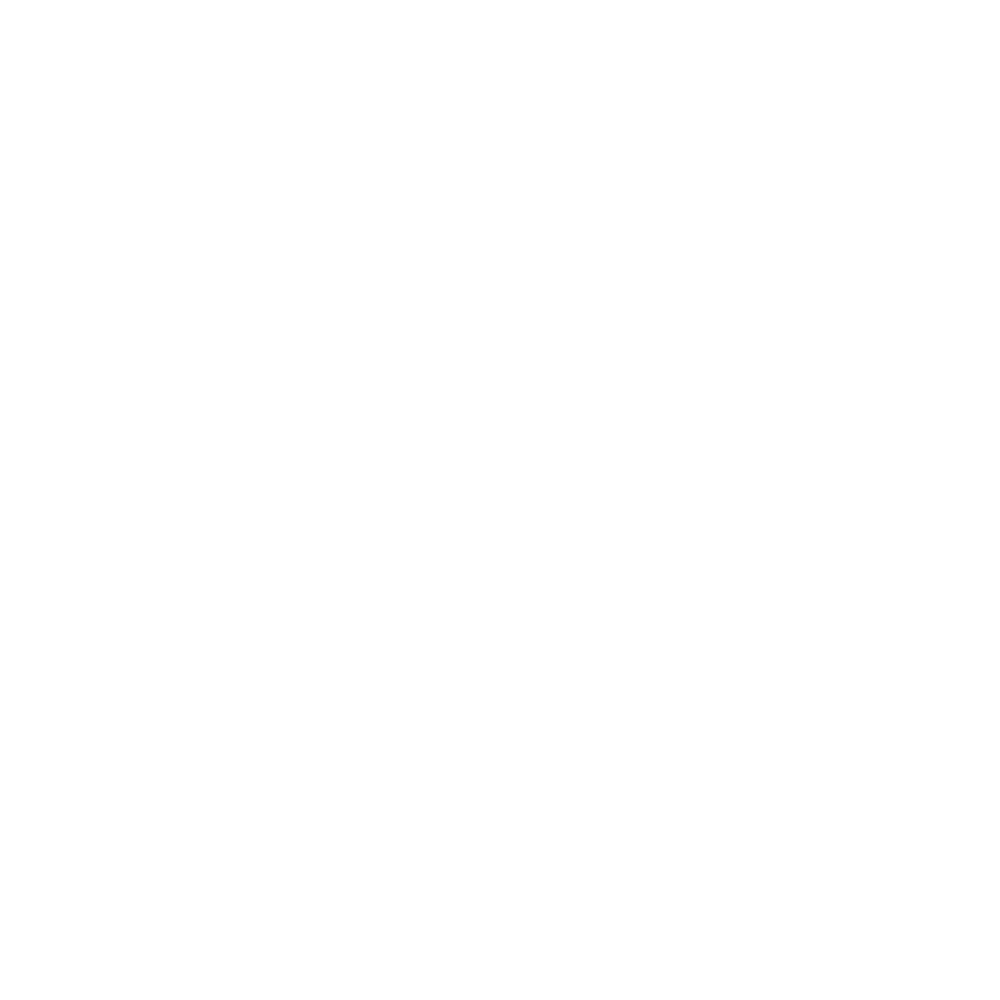

i, sweeptime =  2017-09-10 07:52:18


<IPython.core.display.Javascript object>


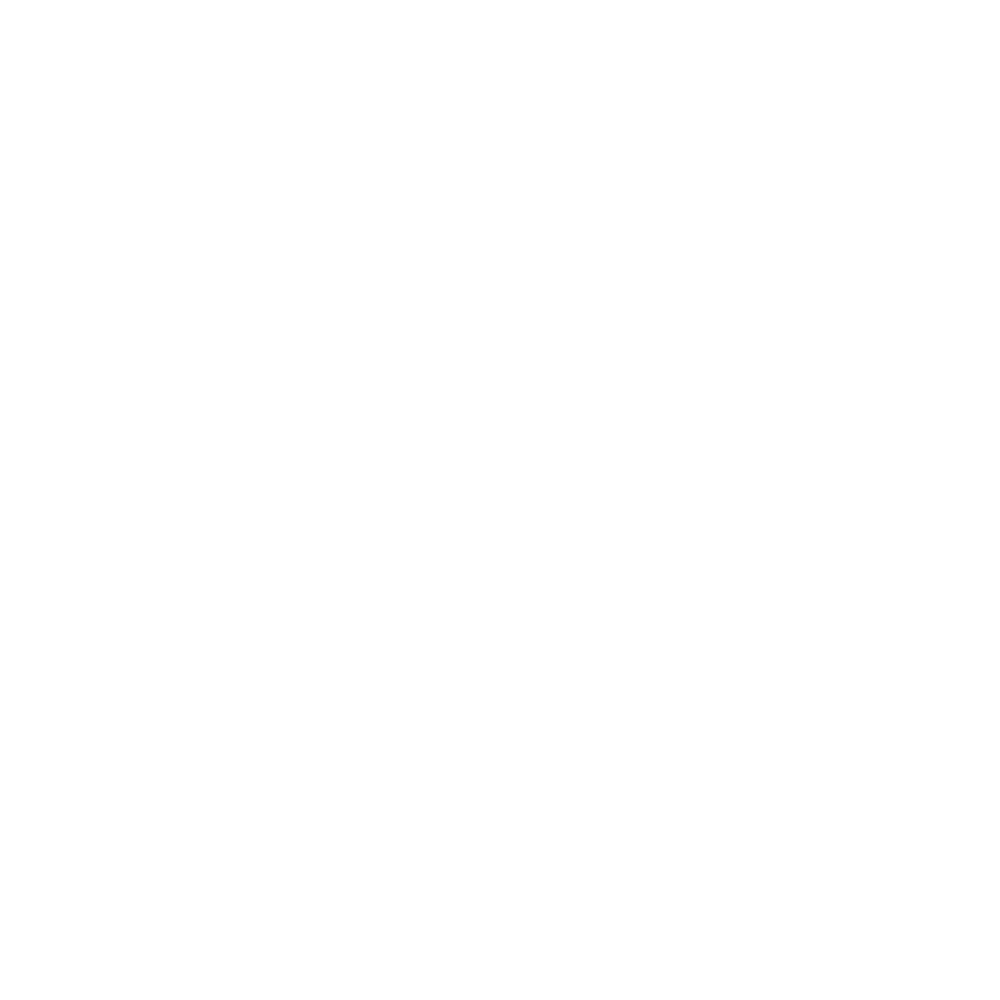

i, sweeptime =  2017-09-10 07:58:49


<IPython.core.display.Javascript object>


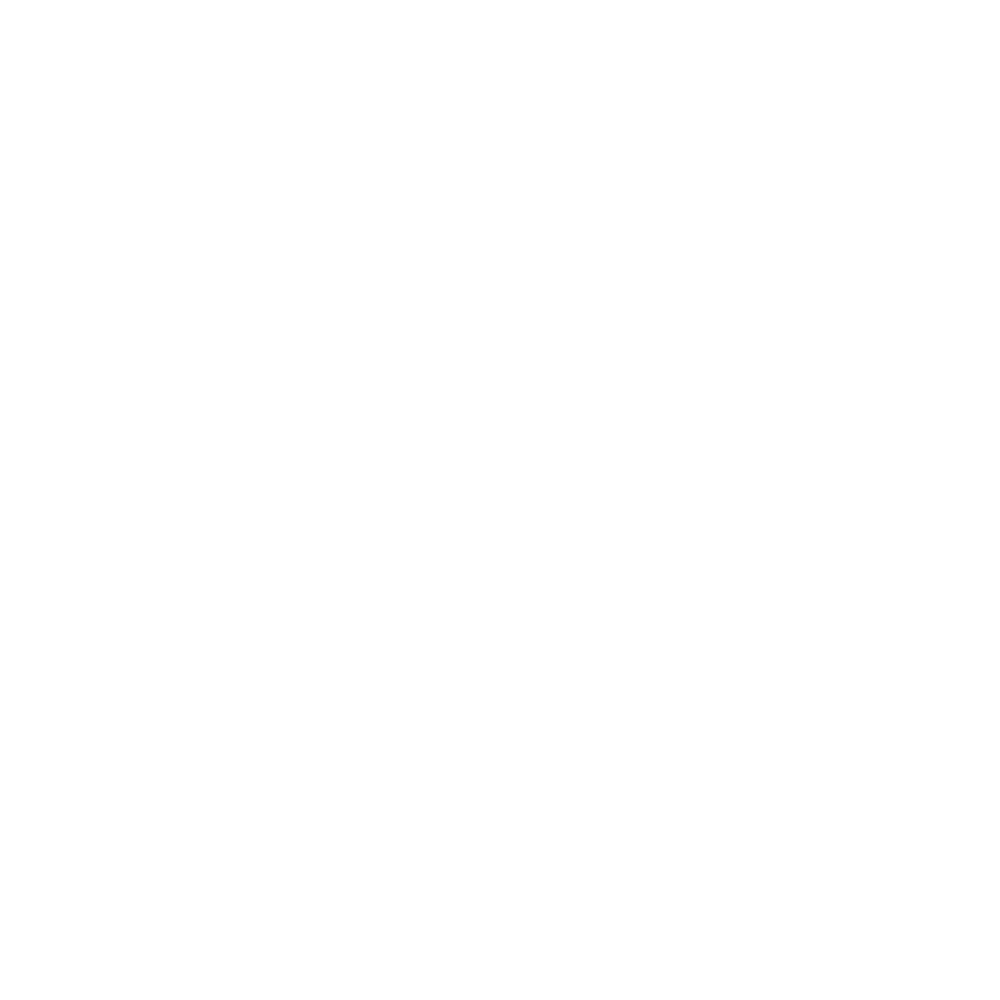

i, sweeptime =  2017-09-10 08:05:22


<IPython.core.display.Javascript object>


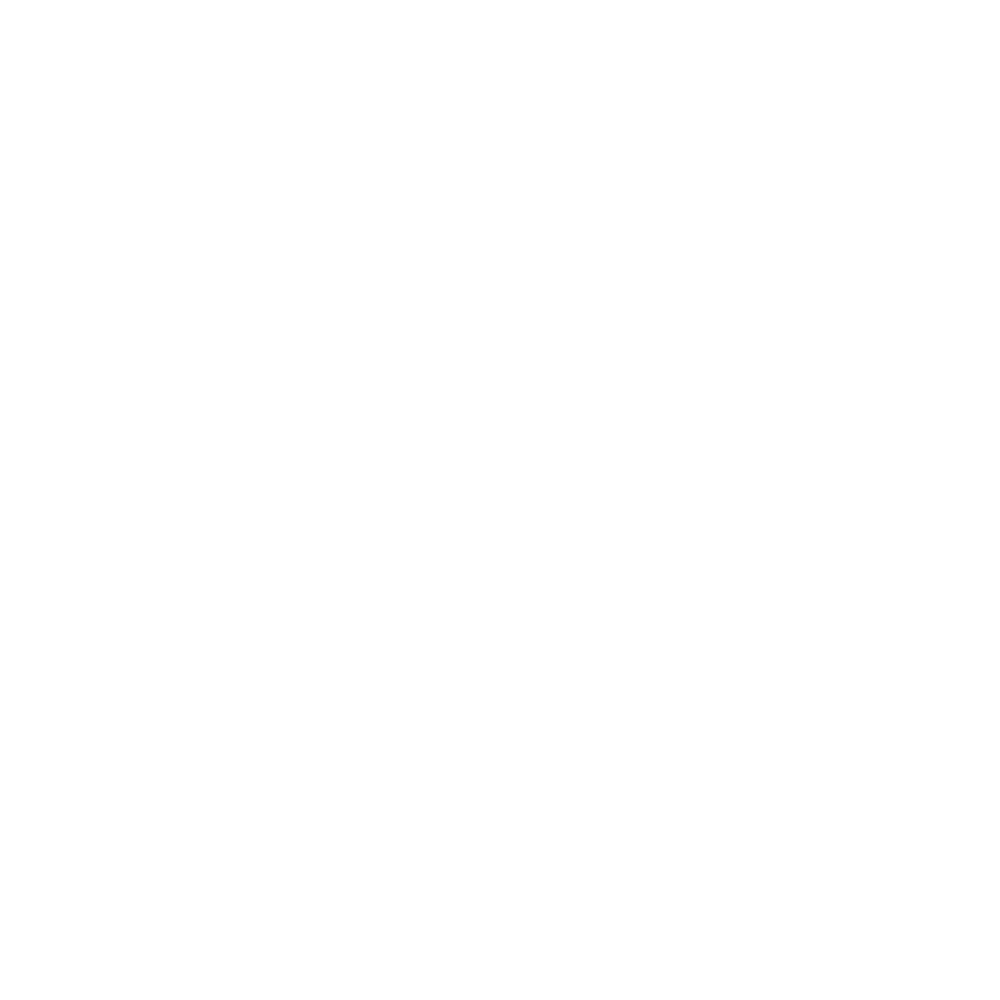

i, sweeptime =  2017-09-10 08:12:09


<IPython.core.display.Javascript object>


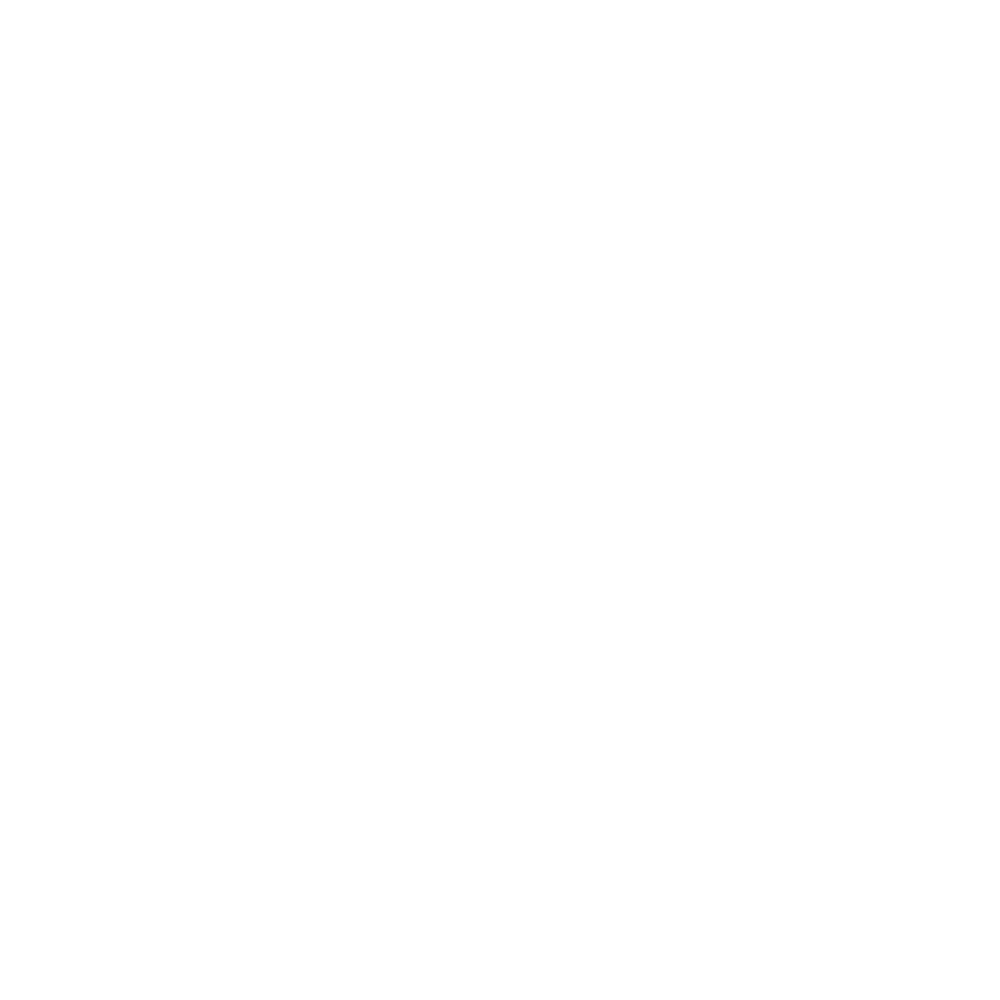

i, sweeptime =  2017-09-10 08:18:40


<IPython.core.display.Javascript object>


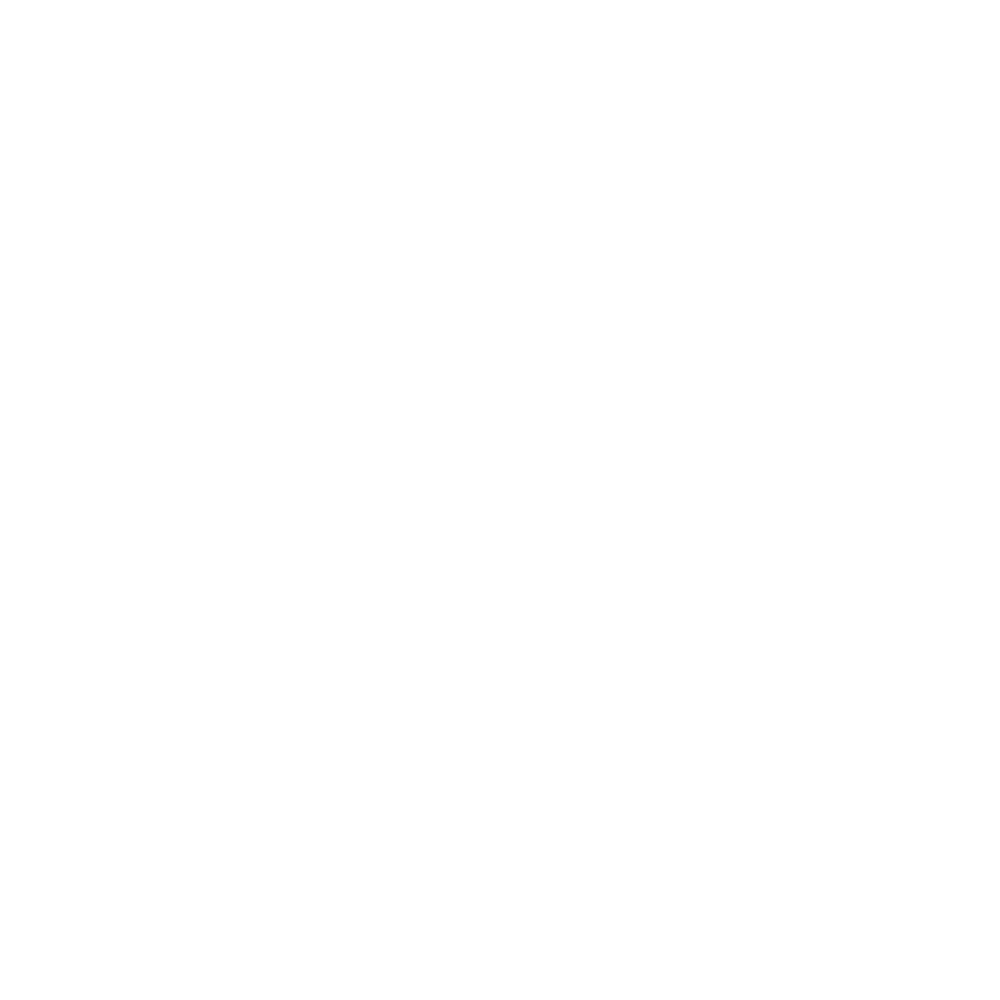

i, sweeptime =  2017-09-10 08:25:10


<IPython.core.display.Javascript object>


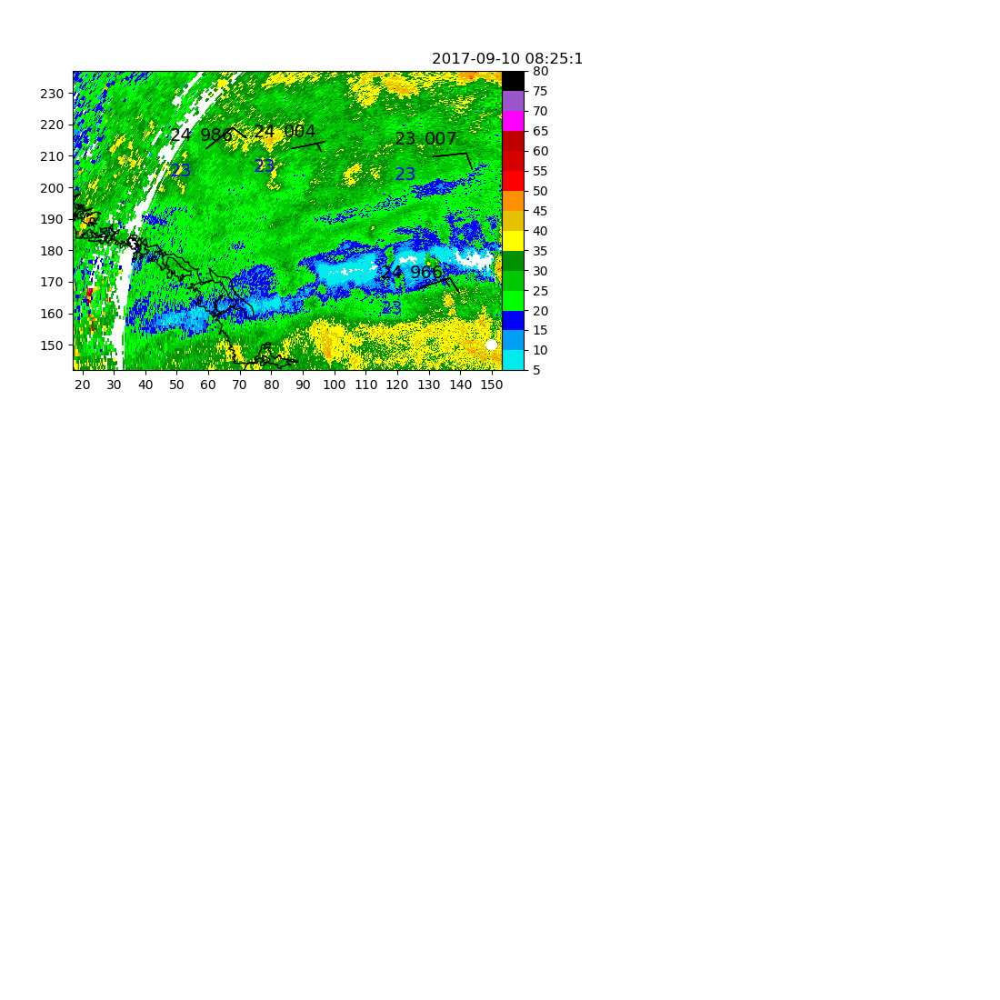

i, sweeptime =  2017-09-10 08:31:42


<IPython.core.display.Javascript object>


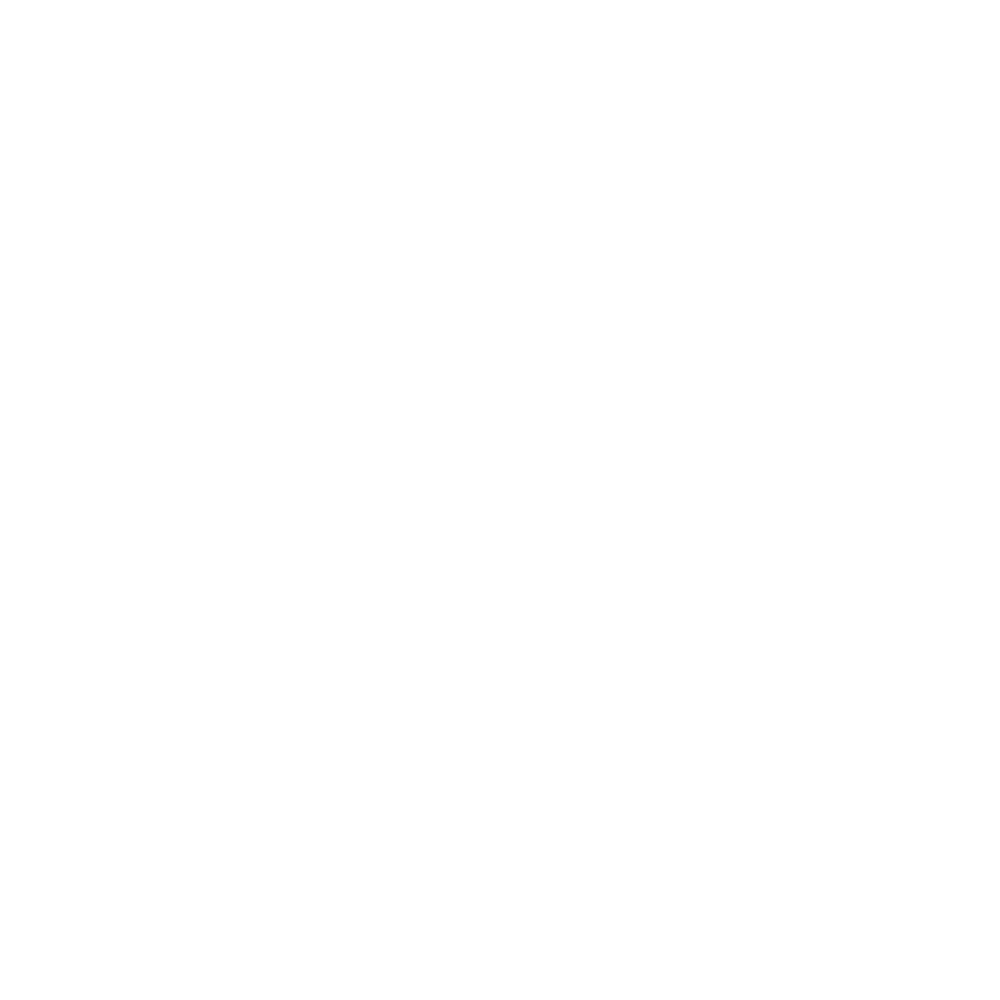

i, sweeptime =  2017-09-10 08:36:49


<IPython.core.display.Javascript object>


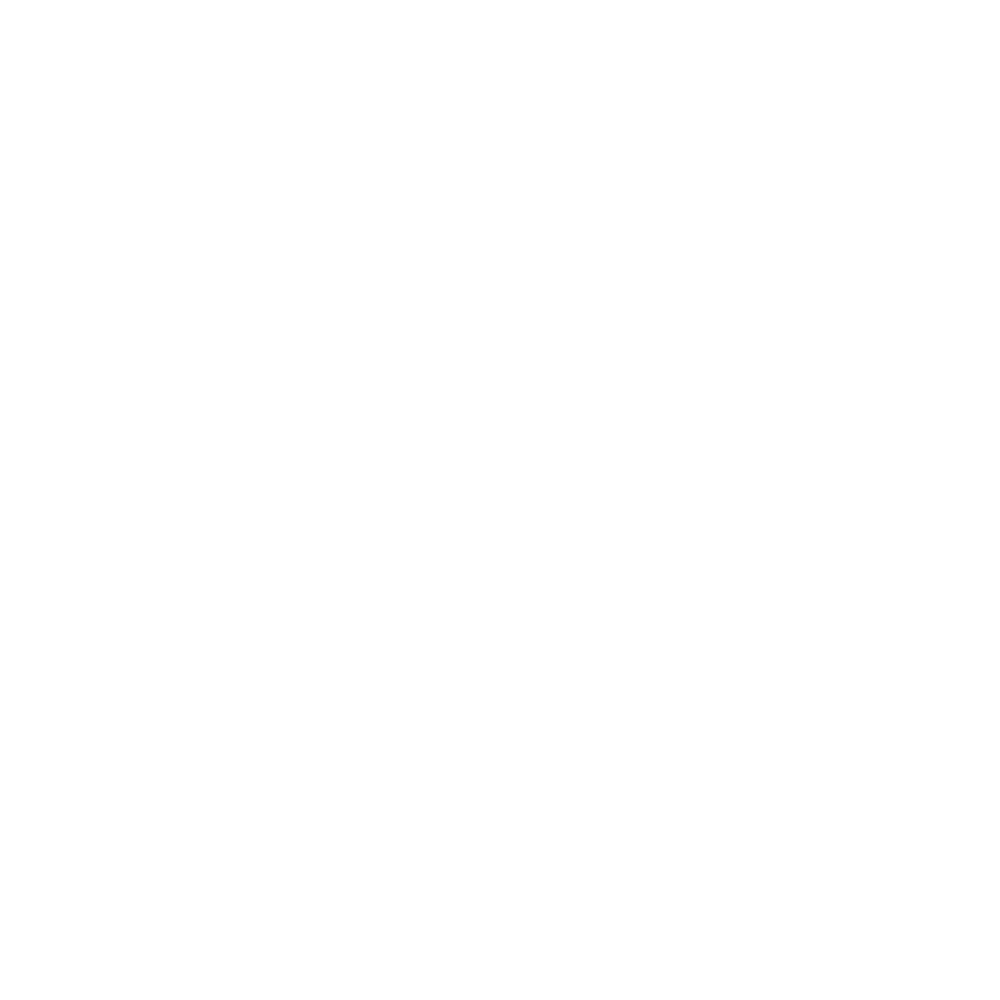

i, sweeptime =  2017-09-10 08:43:19


<IPython.core.display.Javascript object>


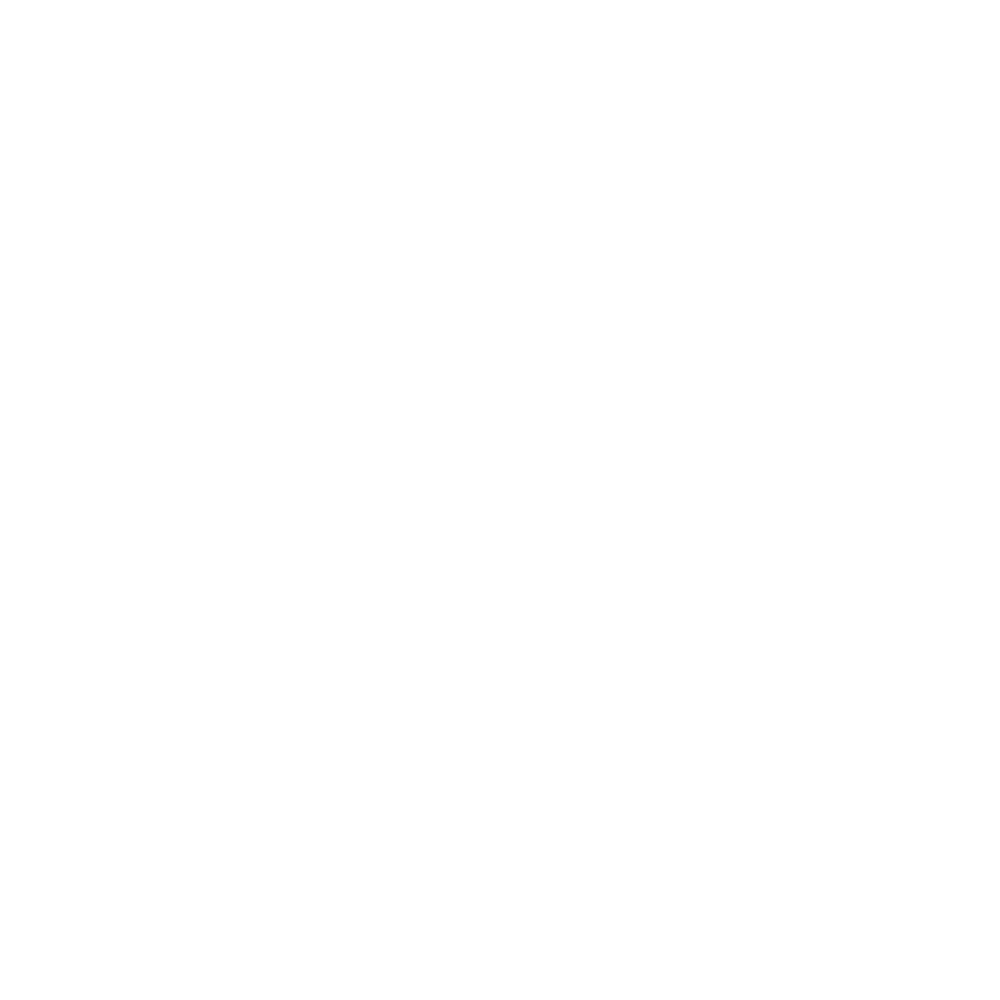

i, sweeptime =  2017-09-10 08:49:49


<IPython.core.display.Javascript object>


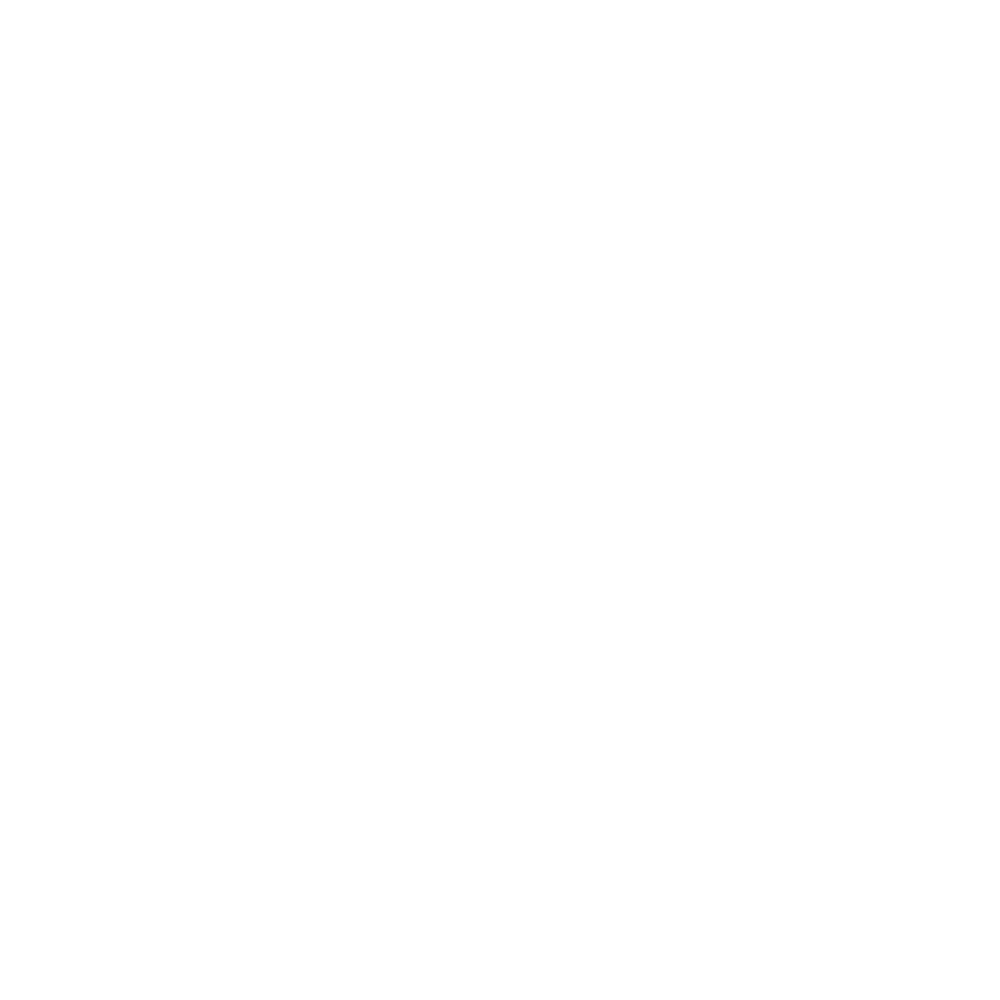

i, sweeptime =  2017-09-10 08:56:19


<IPython.core.display.Javascript object>


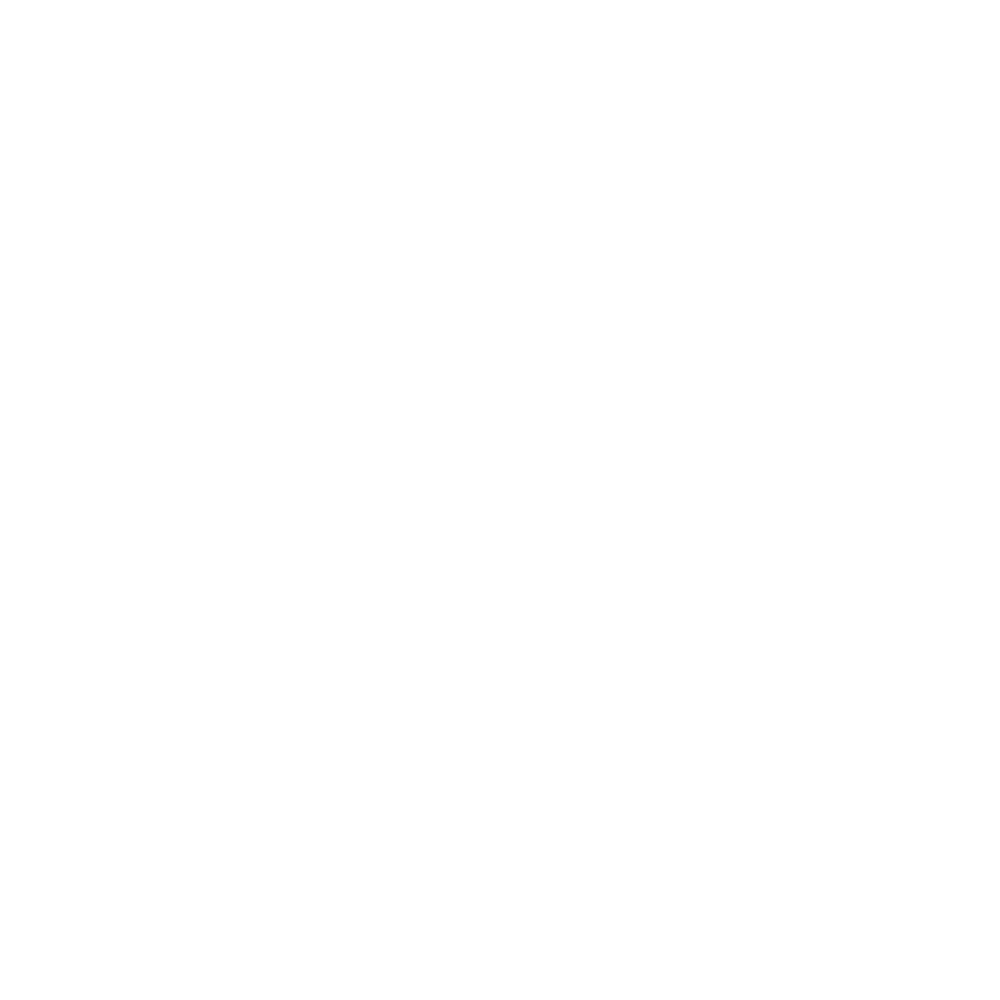

i, sweeptime =  2017-09-10 09:02:48


<IPython.core.display.Javascript object>


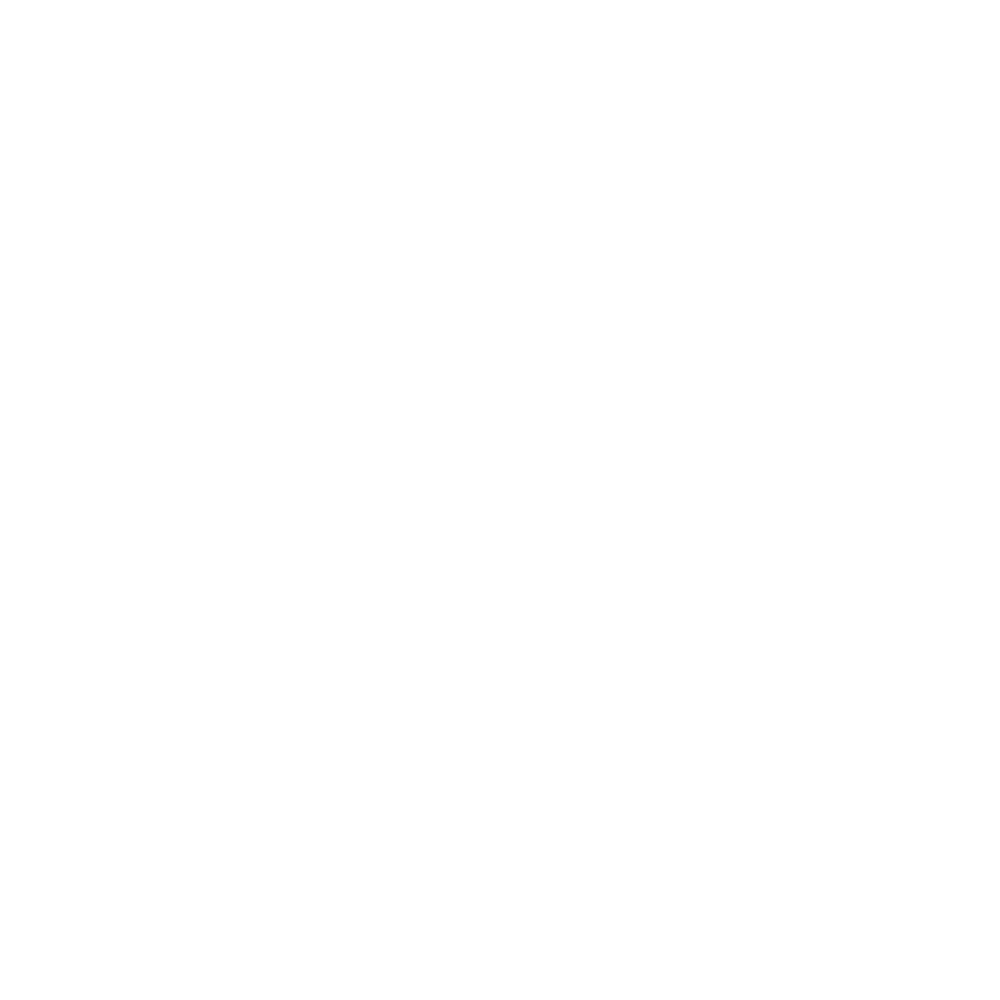

i, sweeptime =  2017-09-10 09:09:21


<IPython.core.display.Javascript object>


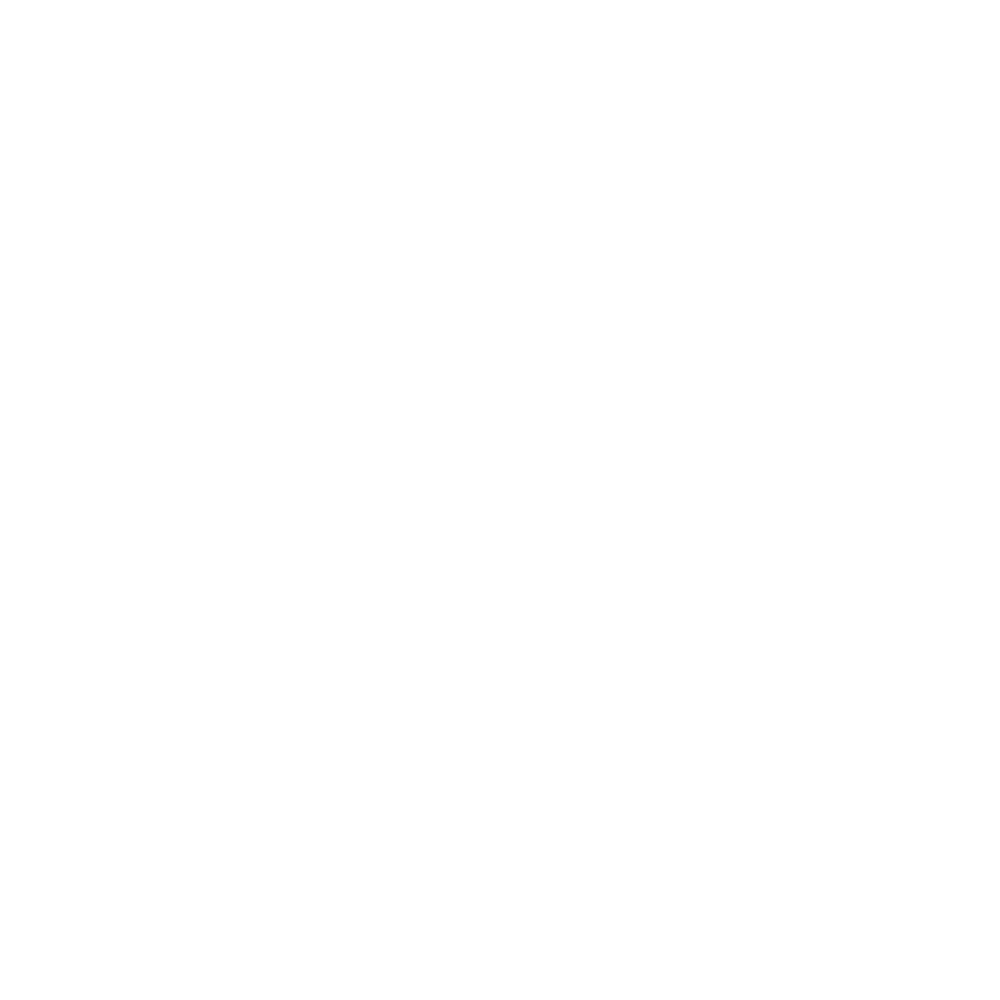

i, sweeptime =  2017-09-10 09:15:59


<IPython.core.display.Javascript object>


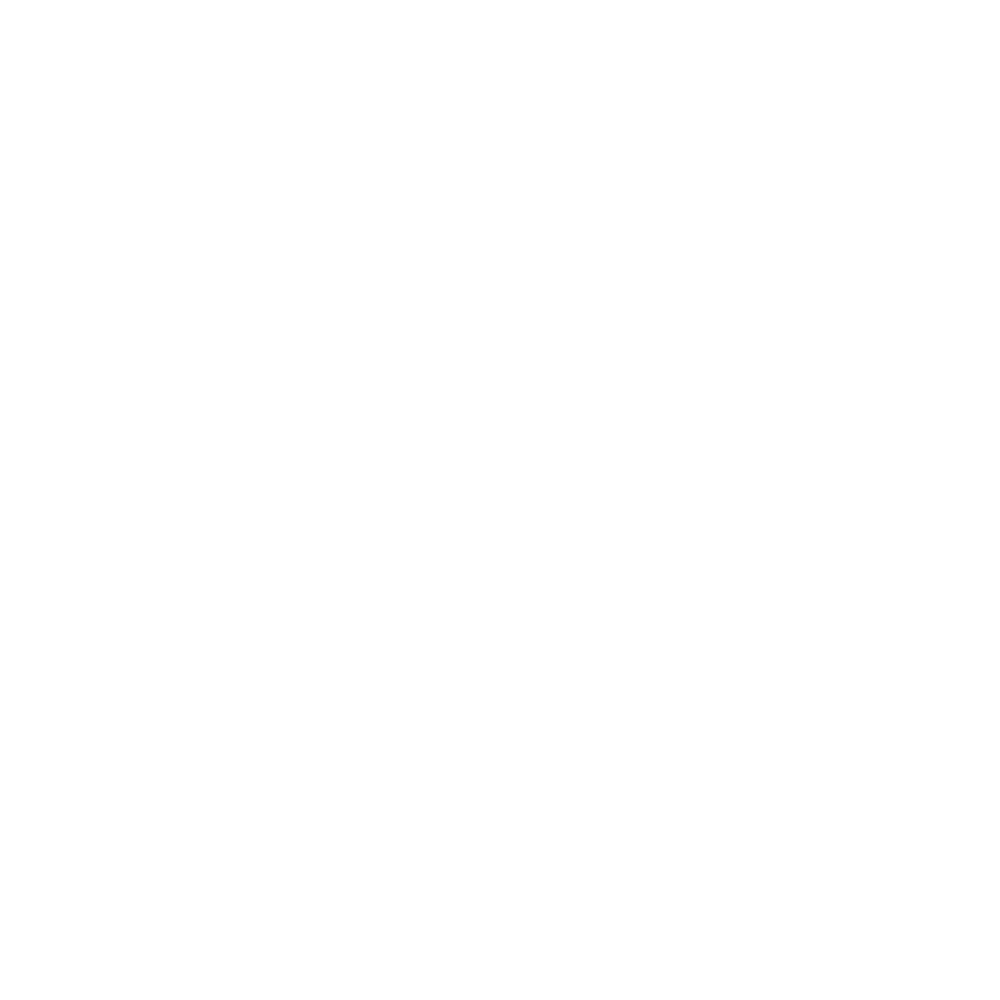

i, sweeptime =  2017-09-10 09:22:30


<IPython.core.display.Javascript object>


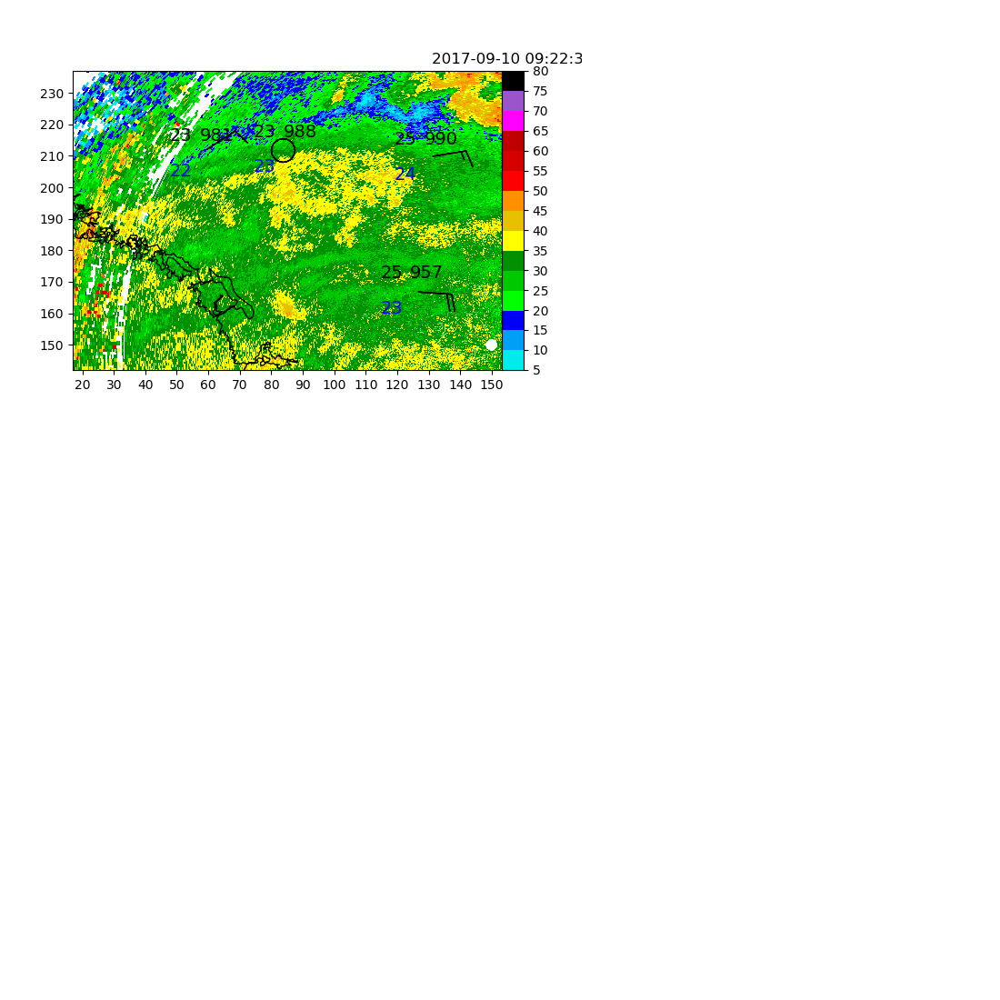

i, sweeptime =  2017-09-10 09:28:59


<IPython.core.display.Javascript object>


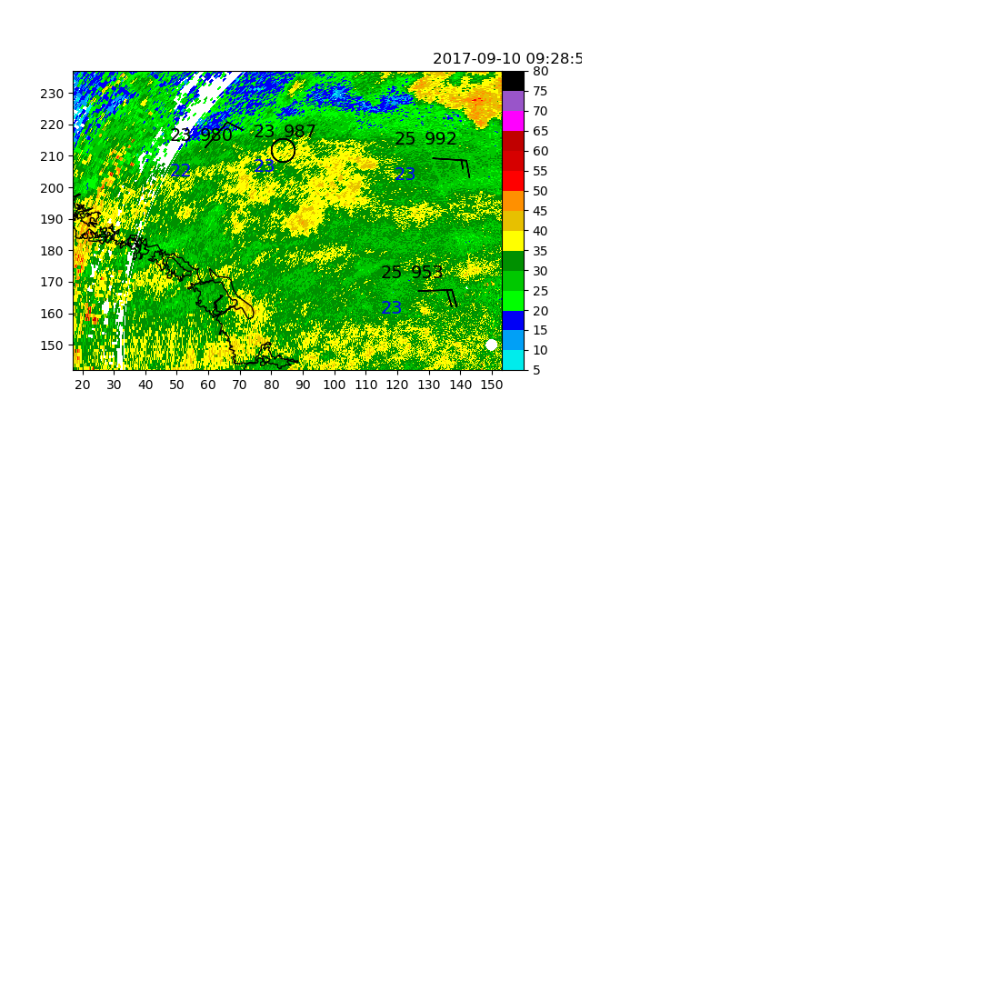

i, sweeptime =  2017-09-10 09:35:30


<IPython.core.display.Javascript object>


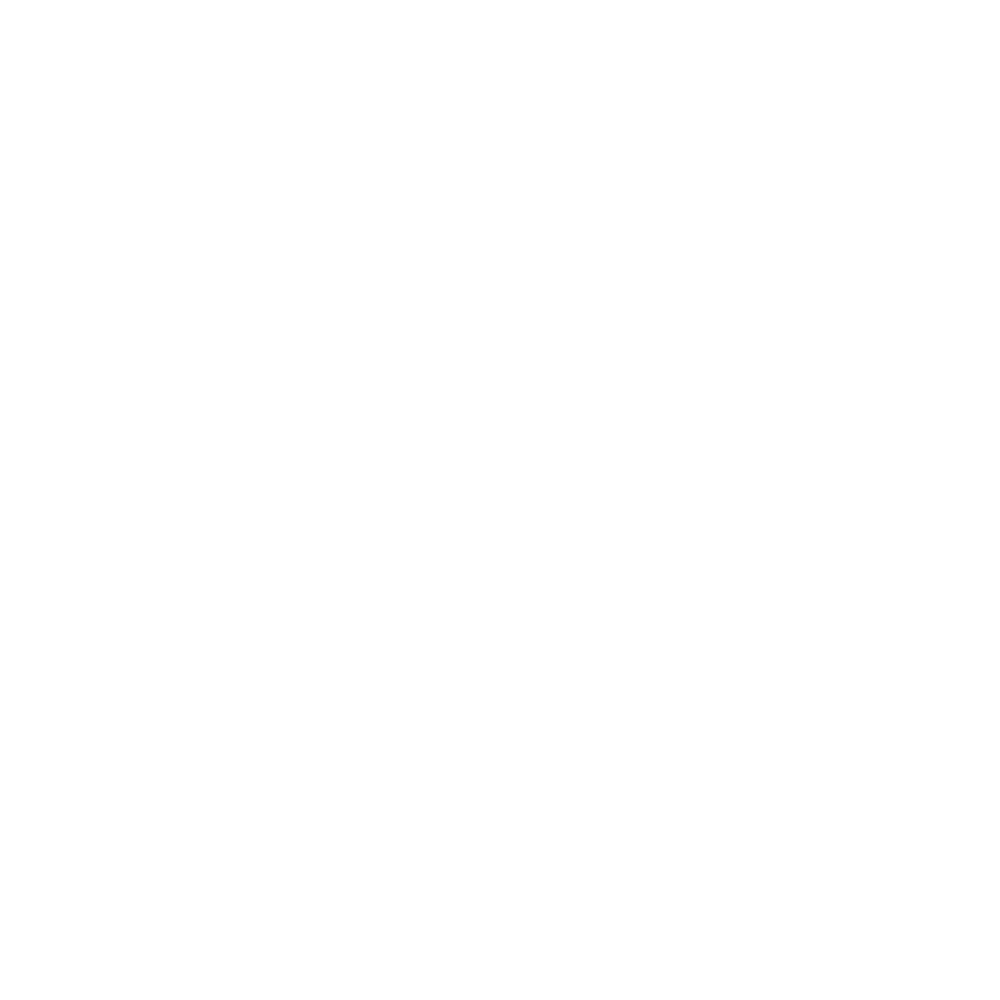

i, sweeptime =  2017-09-10 09:41:59


<IPython.core.display.Javascript object>


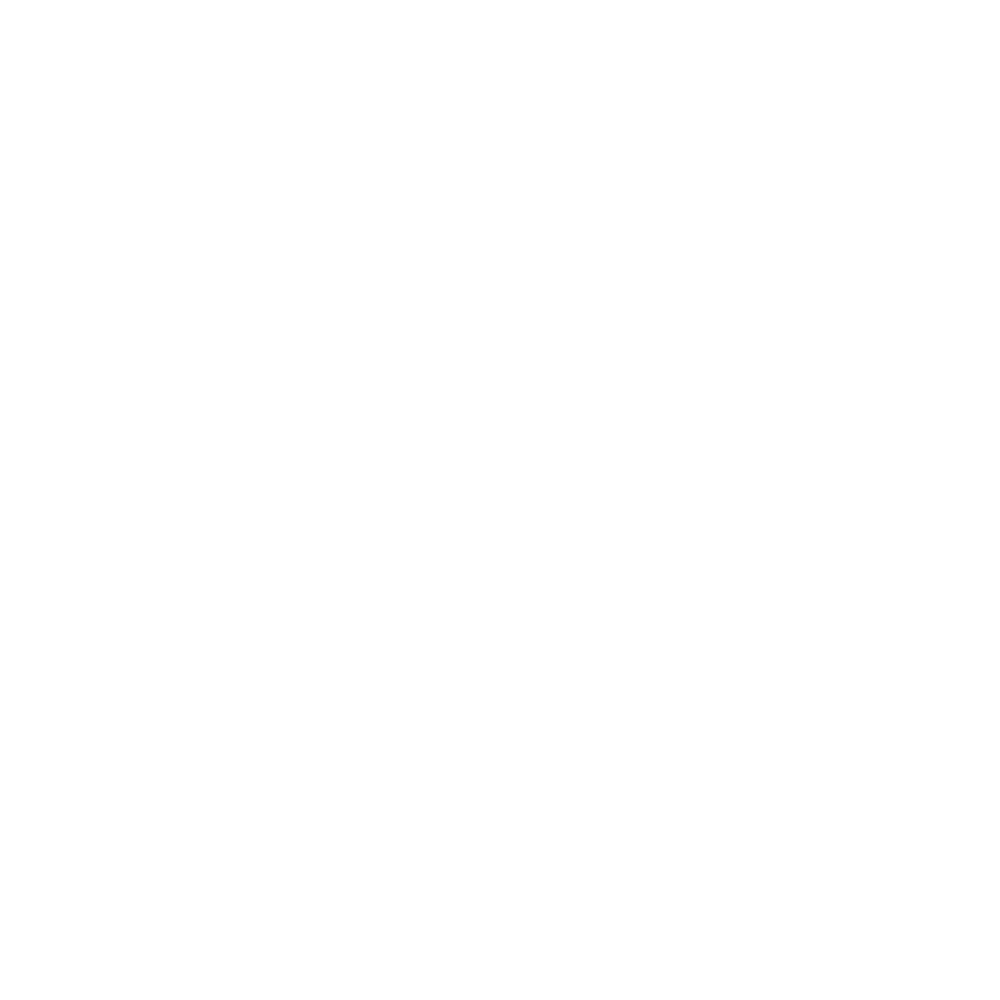

i, sweeptime =  2017-09-10 09:48:31


<IPython.core.display.Javascript object>


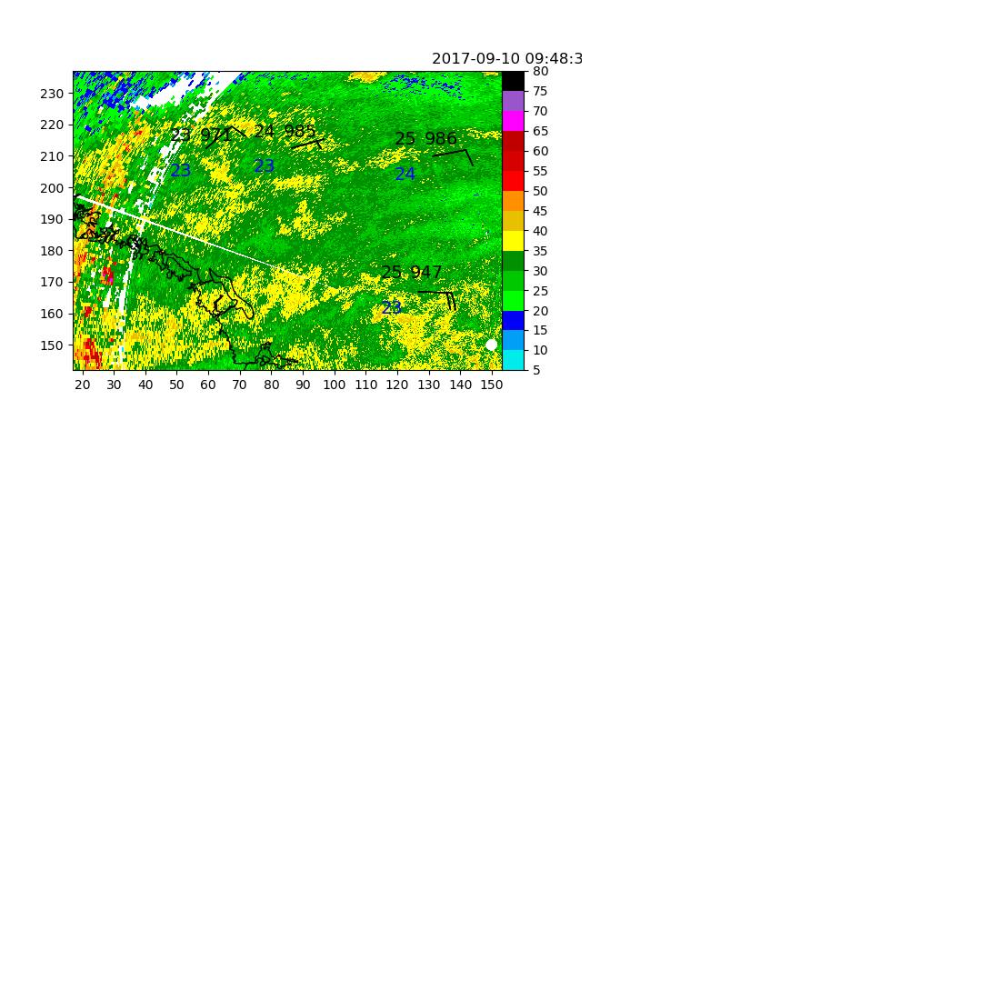

i, sweeptime =  2017-09-10 09:55:01


<IPython.core.display.Javascript object>


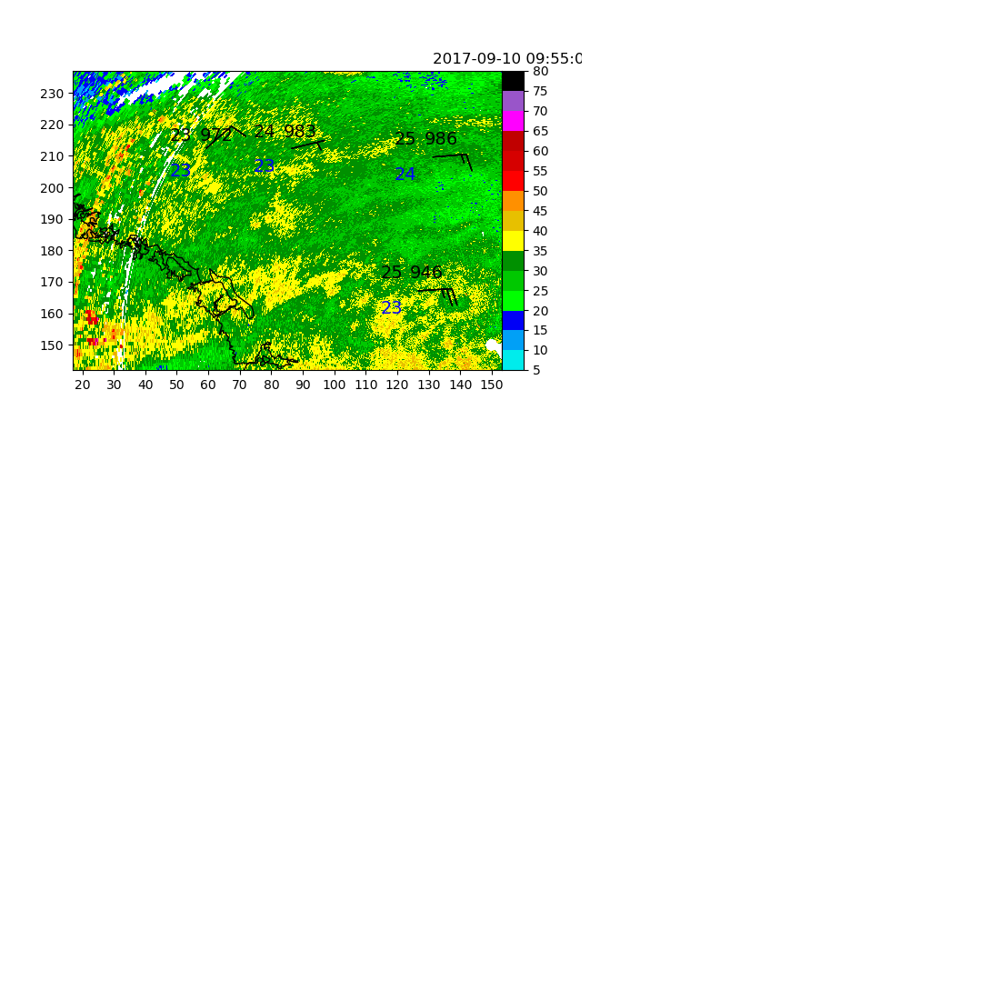

i, sweeptime =  2017-09-10 09:58:03


<IPython.core.display.Javascript object>


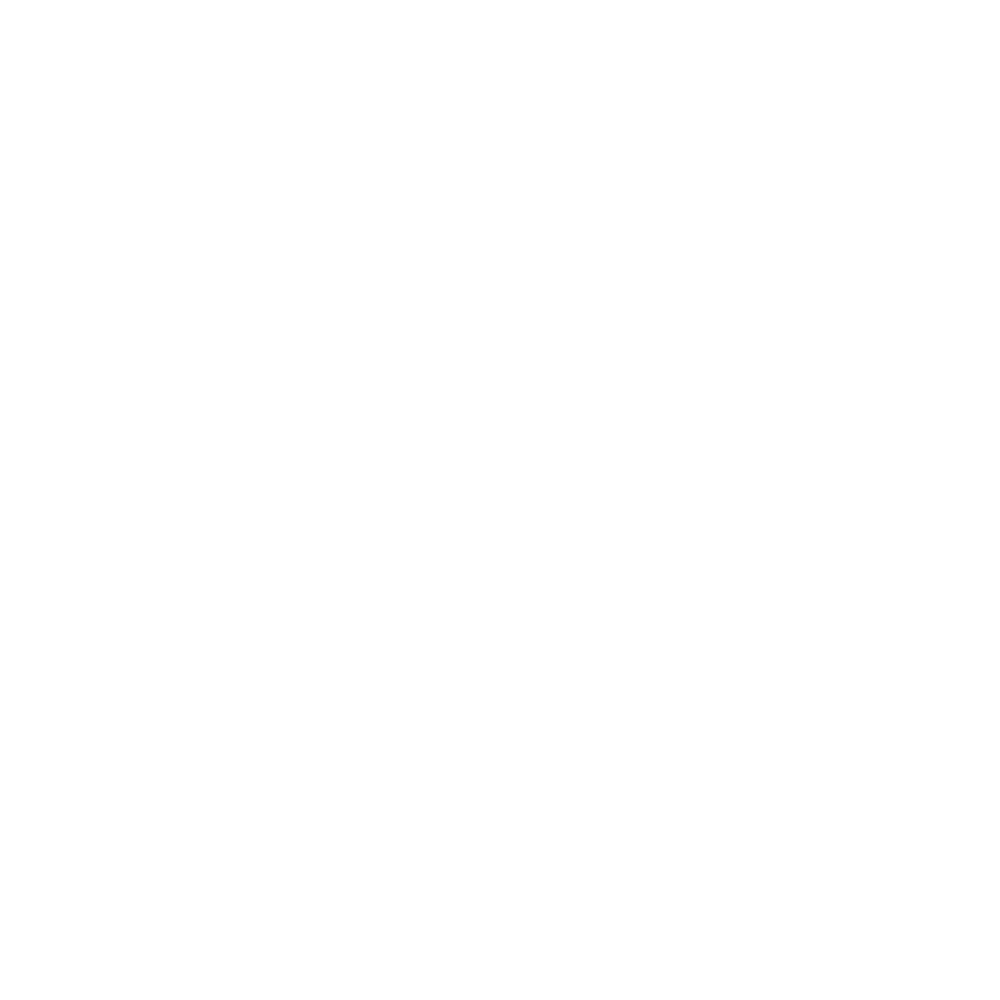

i, sweeptime =  2017-09-10 10:04:34


<IPython.core.display.Javascript object>


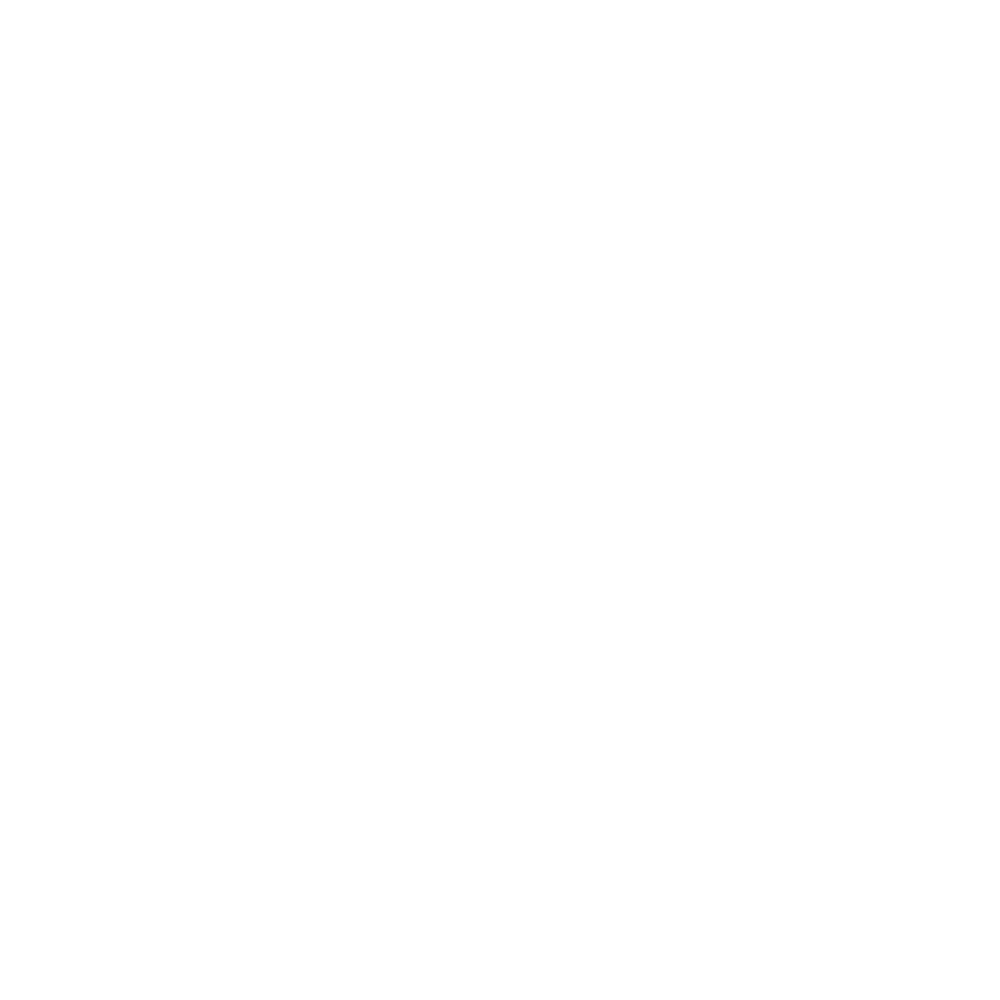

i, sweeptime =  2017-09-10 10:11:09


<IPython.core.display.Javascript object>


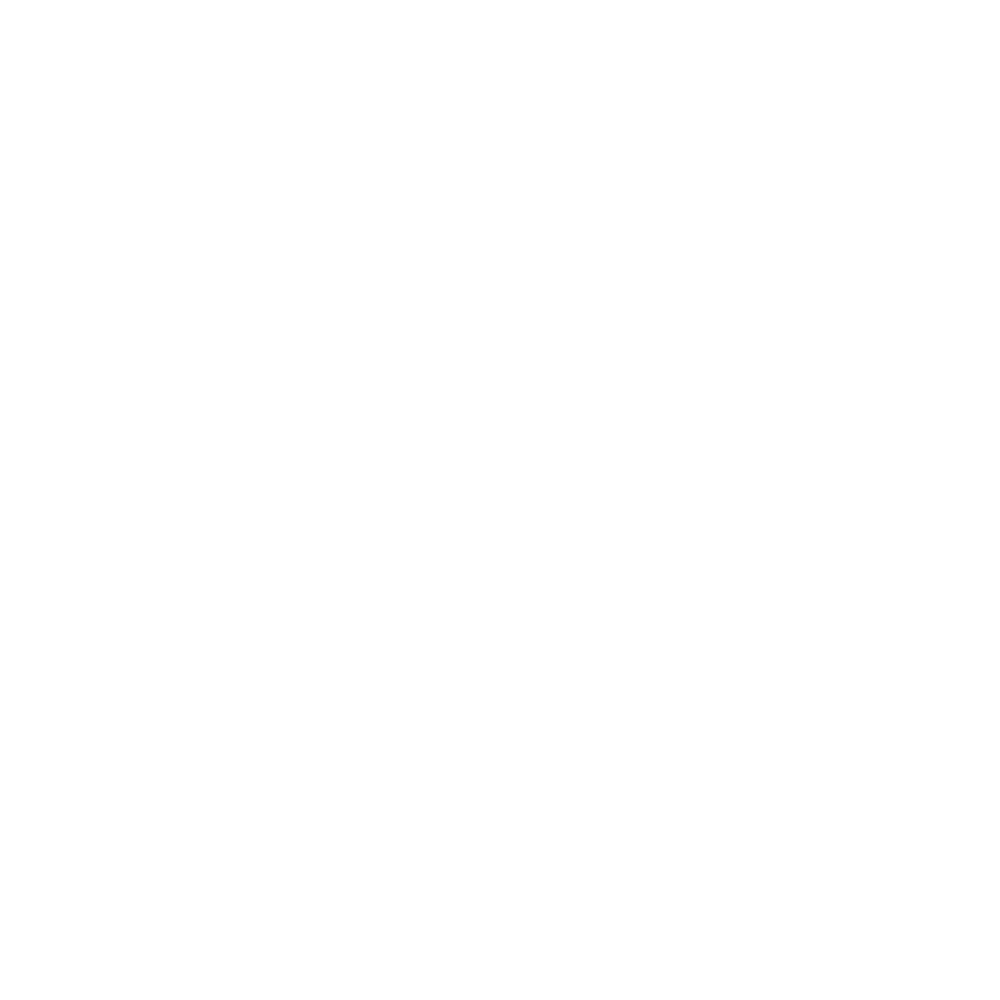

i, sweeptime =  2017-09-10 10:18:09


<IPython.core.display.Javascript object>


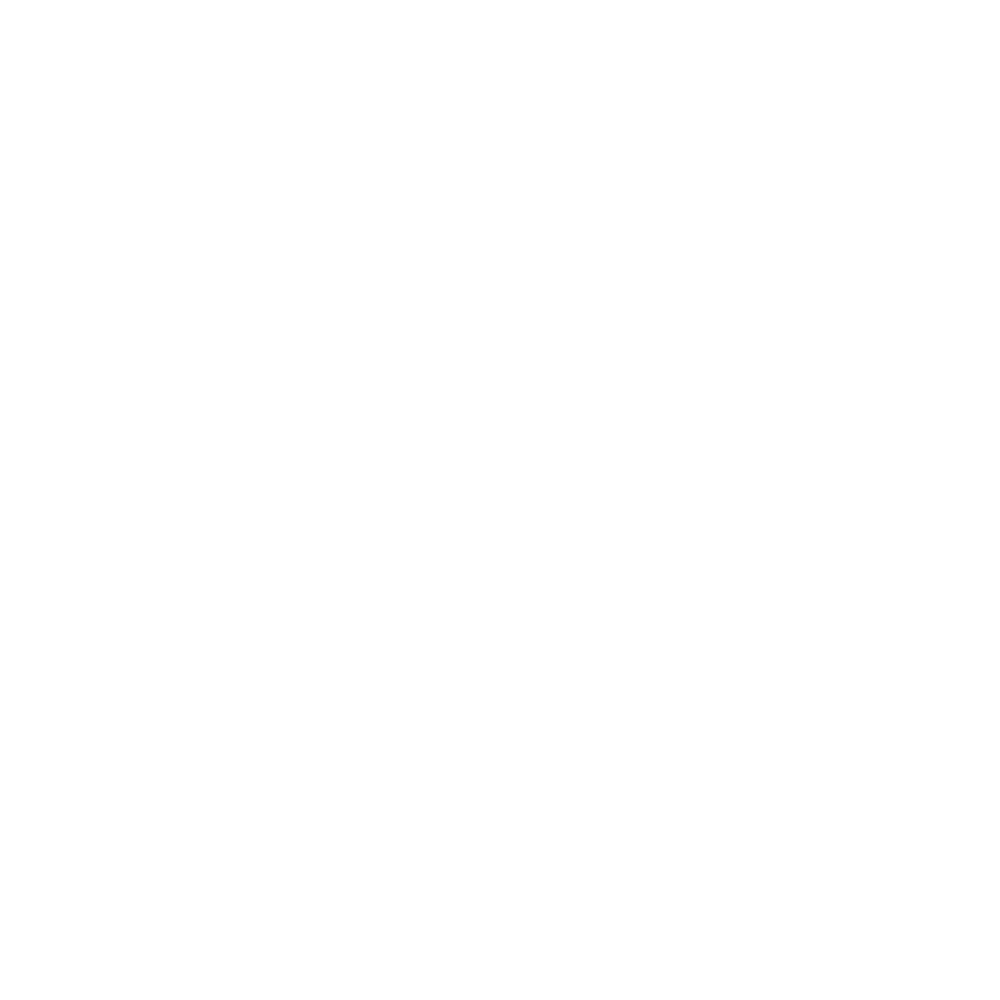

i, sweeptime =  2017-09-10 10:25:04


<IPython.core.display.Javascript object>


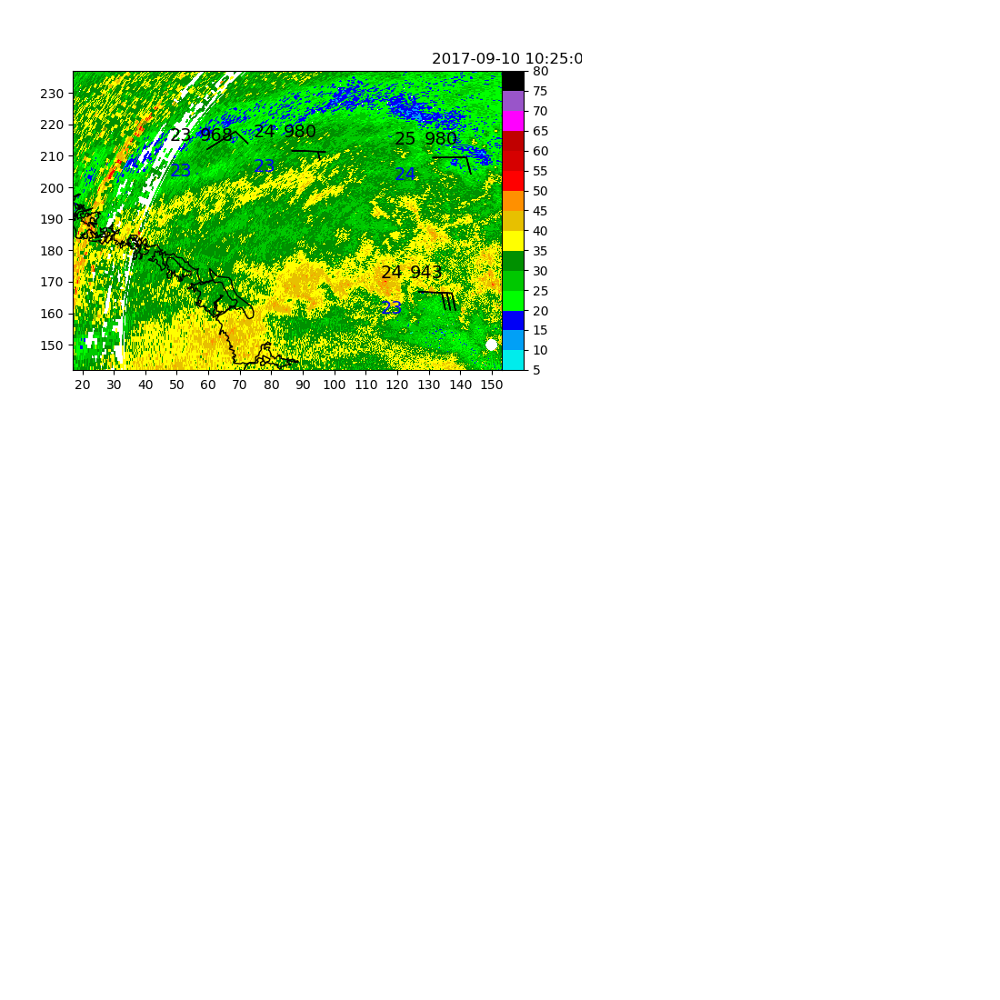

i, sweeptime =  2017-09-10 10:31:41


<IPython.core.display.Javascript object>


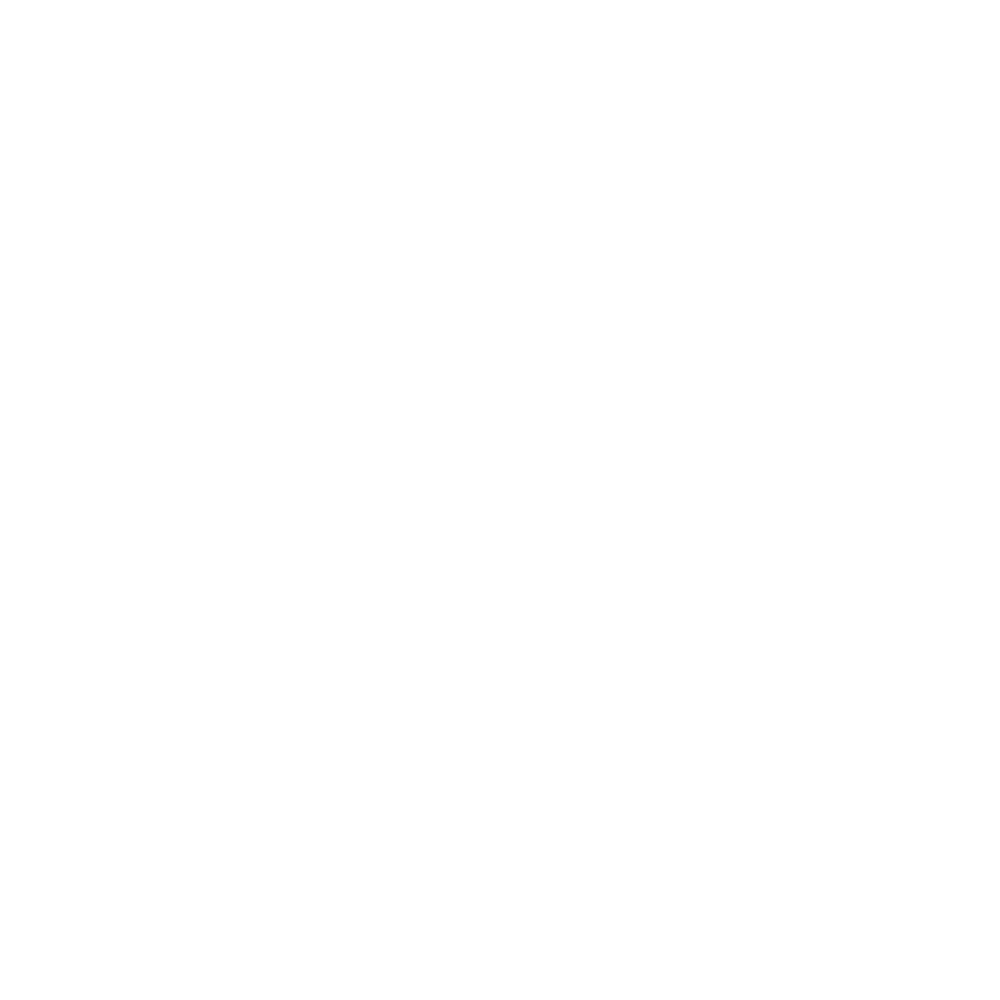

i, sweeptime =  2017-09-10 10:38:35


<IPython.core.display.Javascript object>


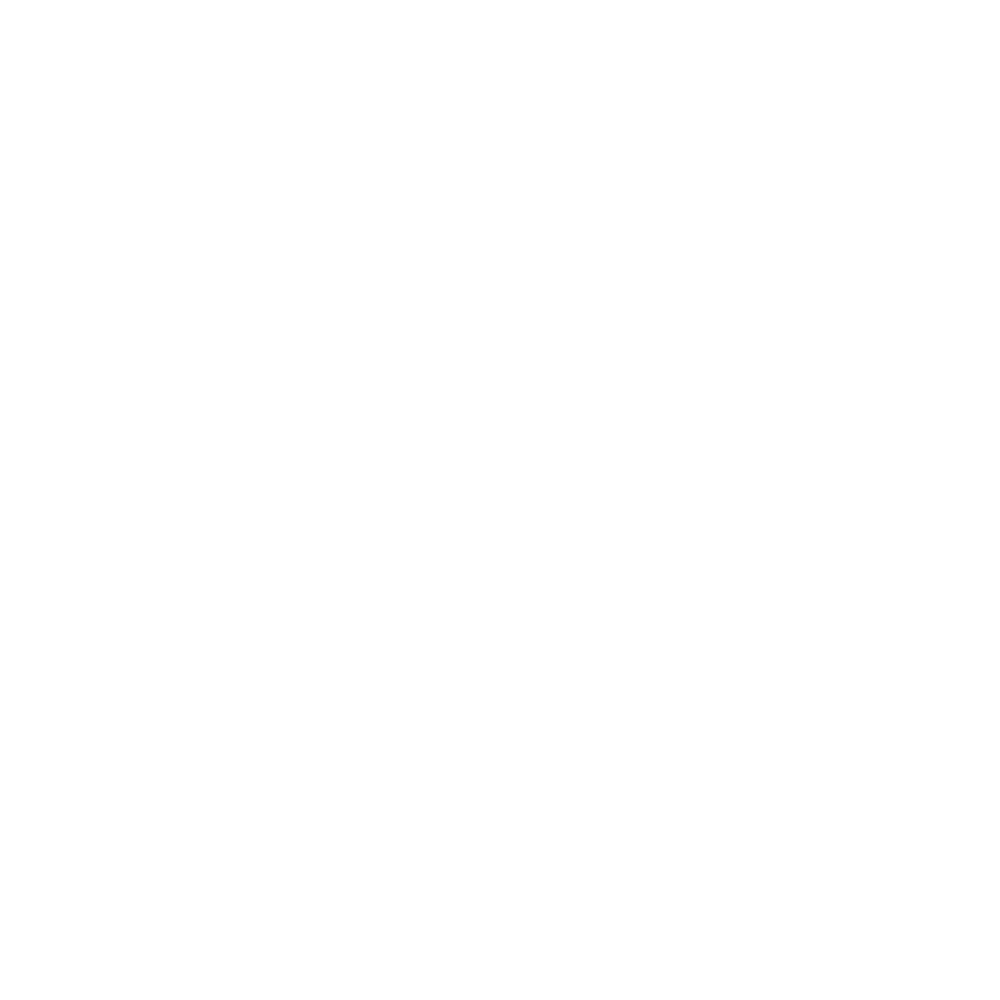

i, sweeptime =  2017-09-10 10:45:06


<IPython.core.display.Javascript object>


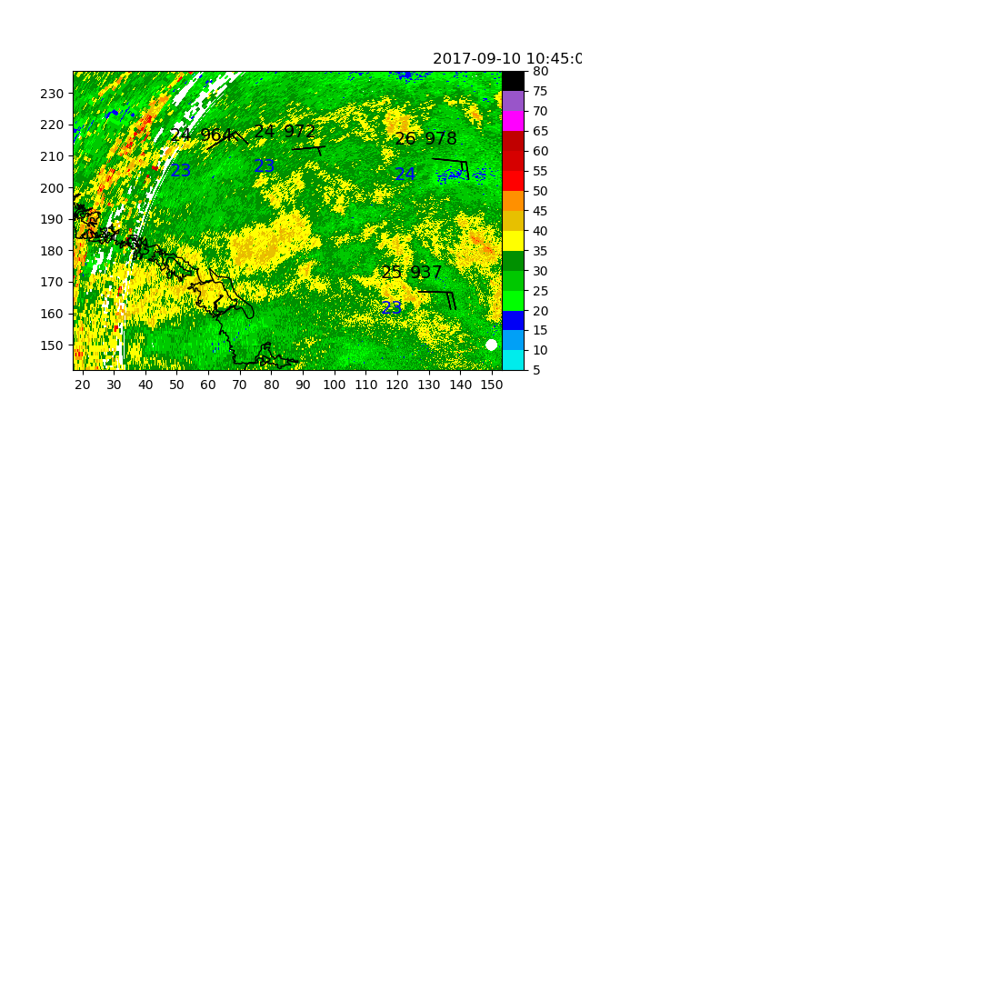

i, sweeptime =  2017-09-10 10:51:40


<IPython.core.display.Javascript object>


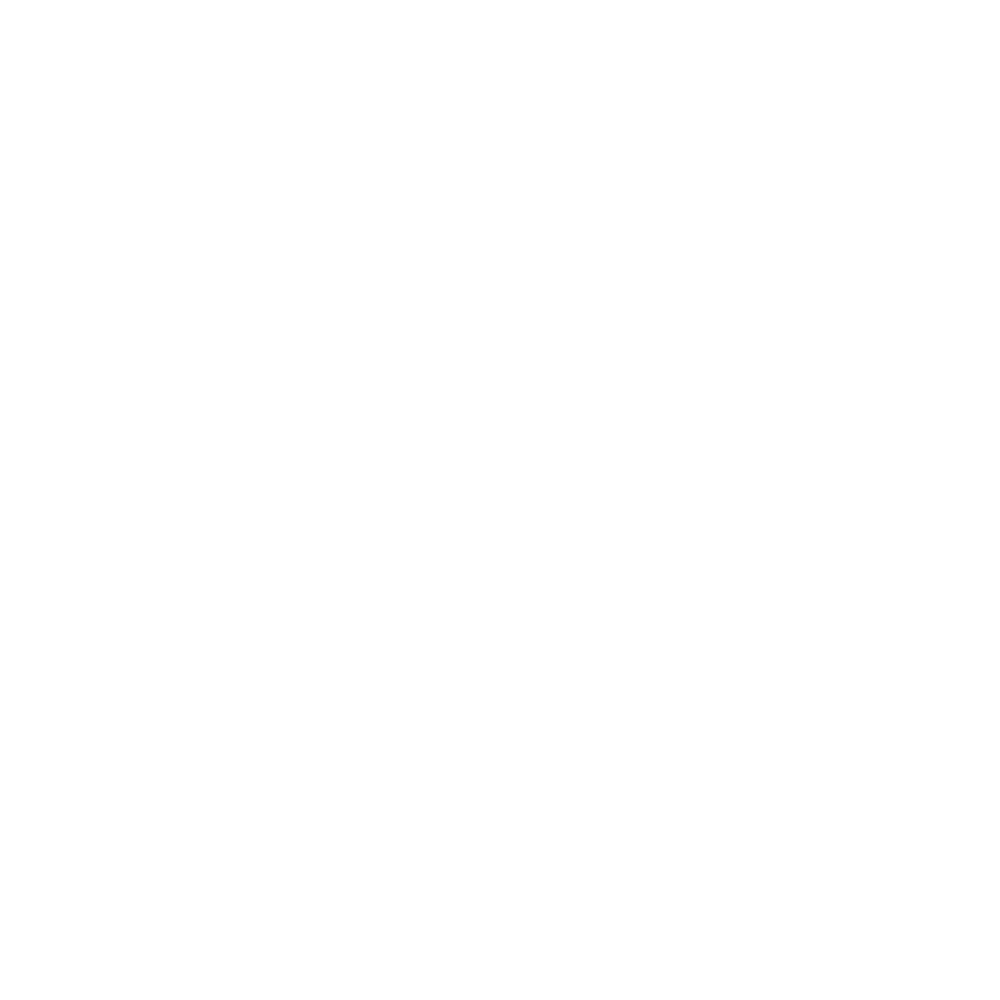

i, sweeptime =  2017-09-10 10:58:35


<IPython.core.display.Javascript object>


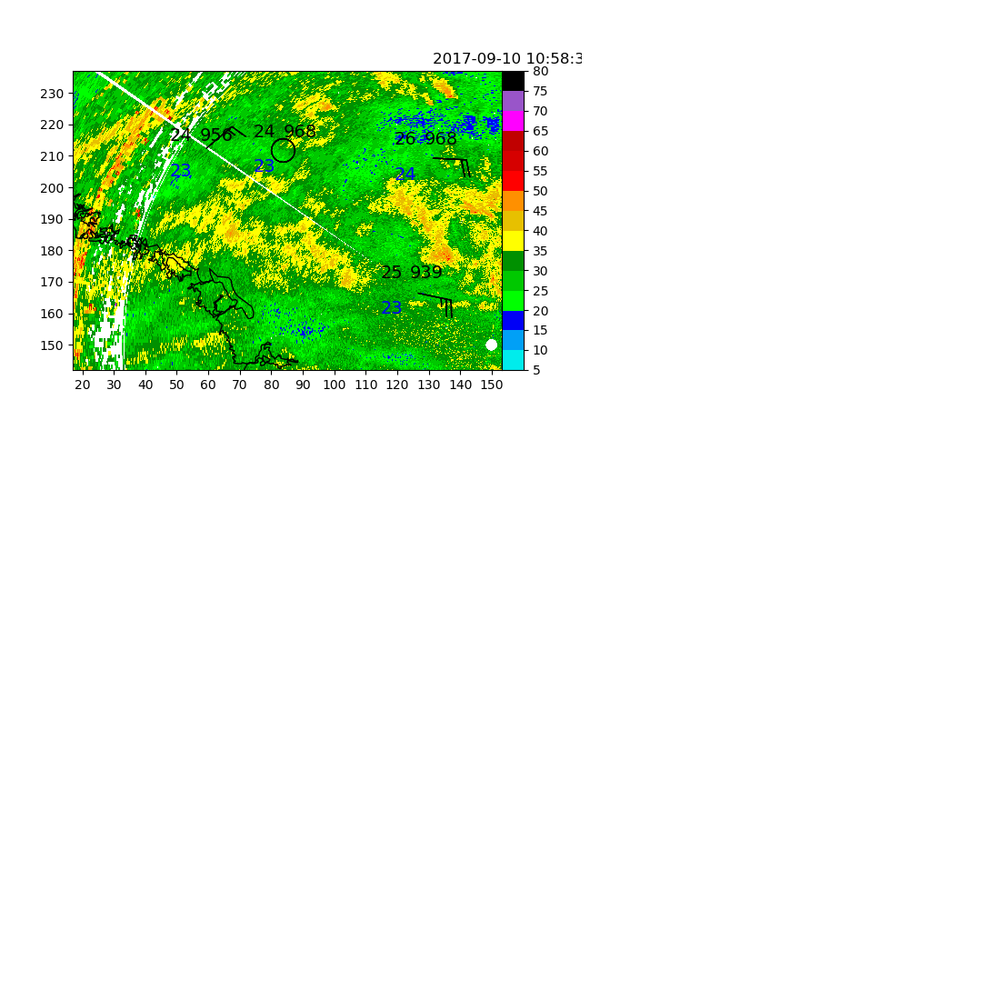

i, sweeptime =  2017-09-10 11:05:05


<IPython.core.display.Javascript object>


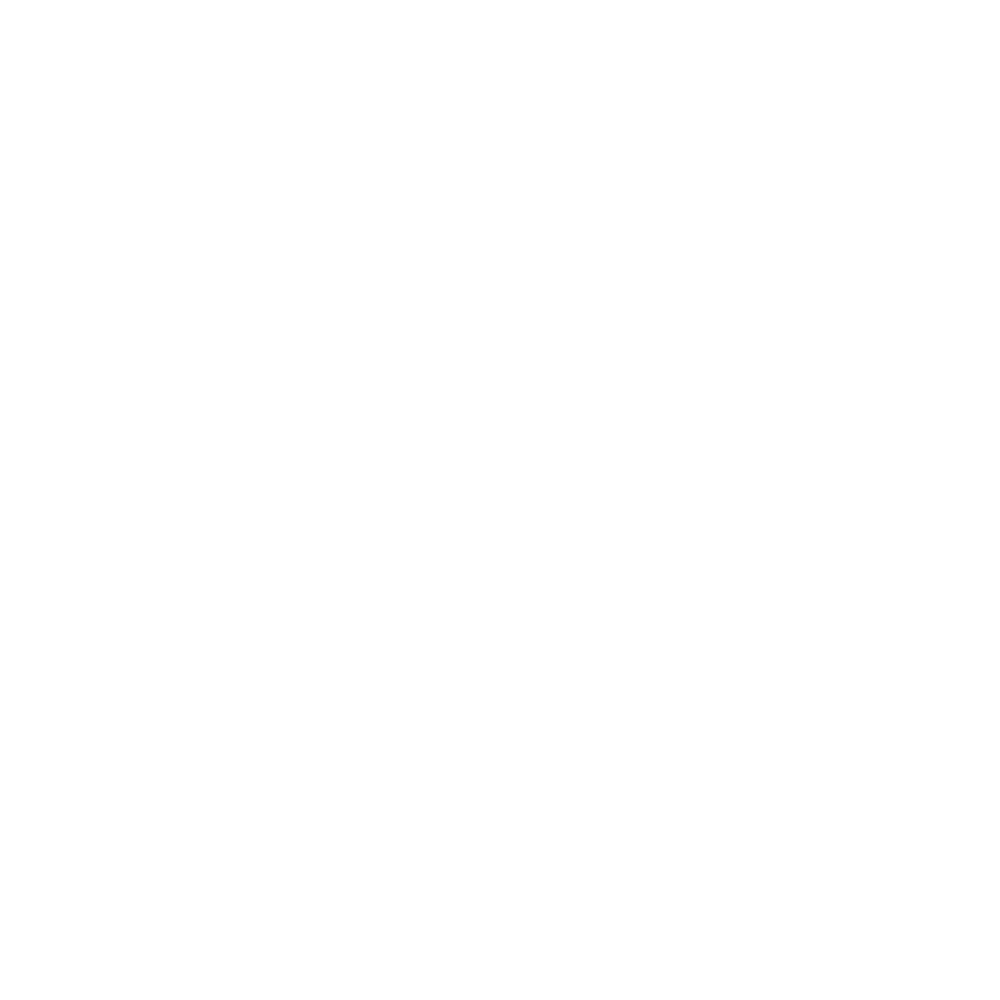

i, sweeptime =  2017-09-10 11:11:36


<IPython.core.display.Javascript object>


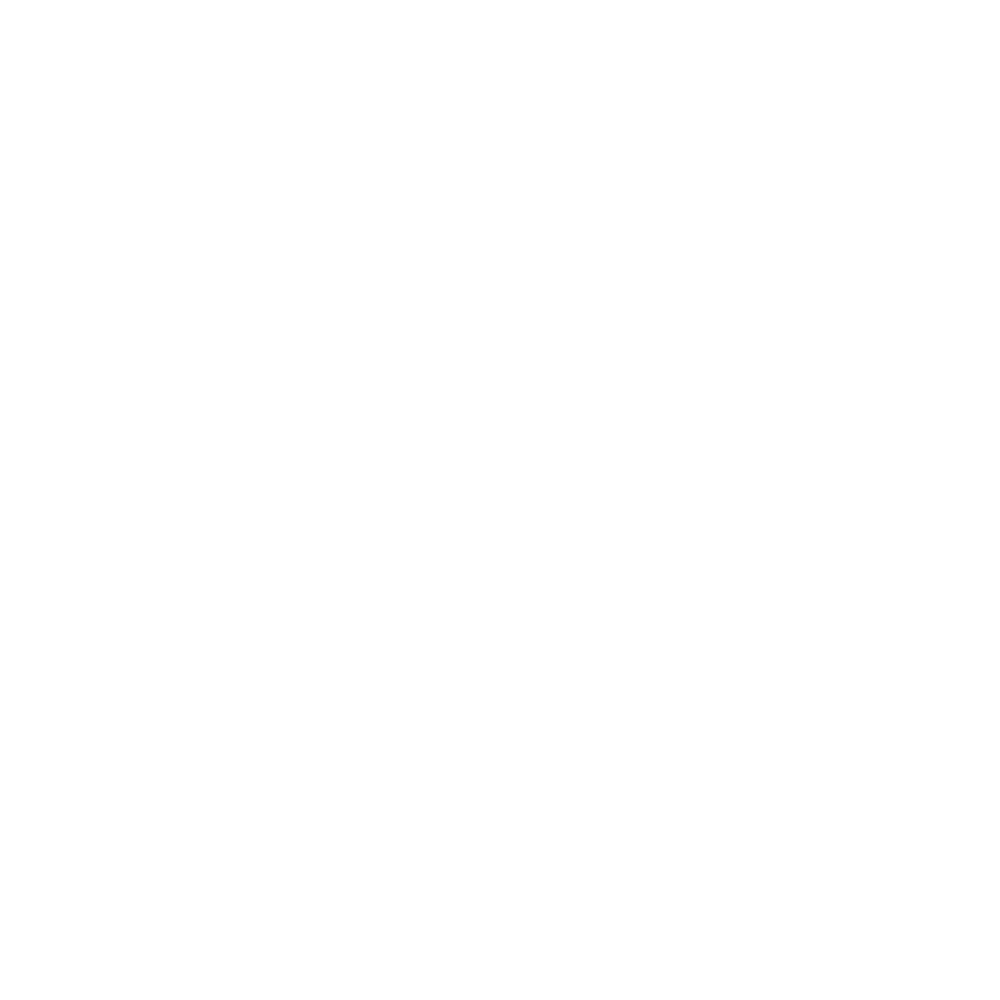

i, sweeptime =  2017-09-10 11:18:05


<IPython.core.display.Javascript object>


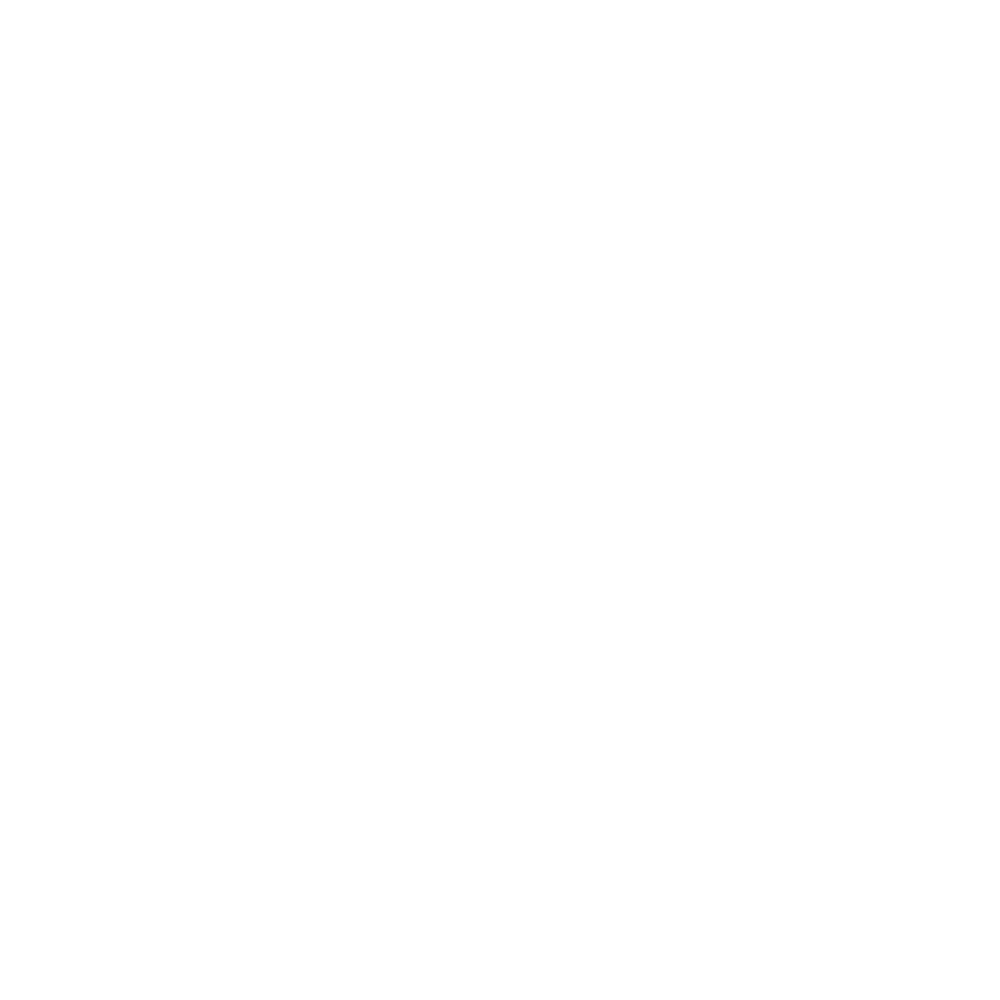

i, sweeptime =  2017-09-10 11:24:35


<IPython.core.display.Javascript object>


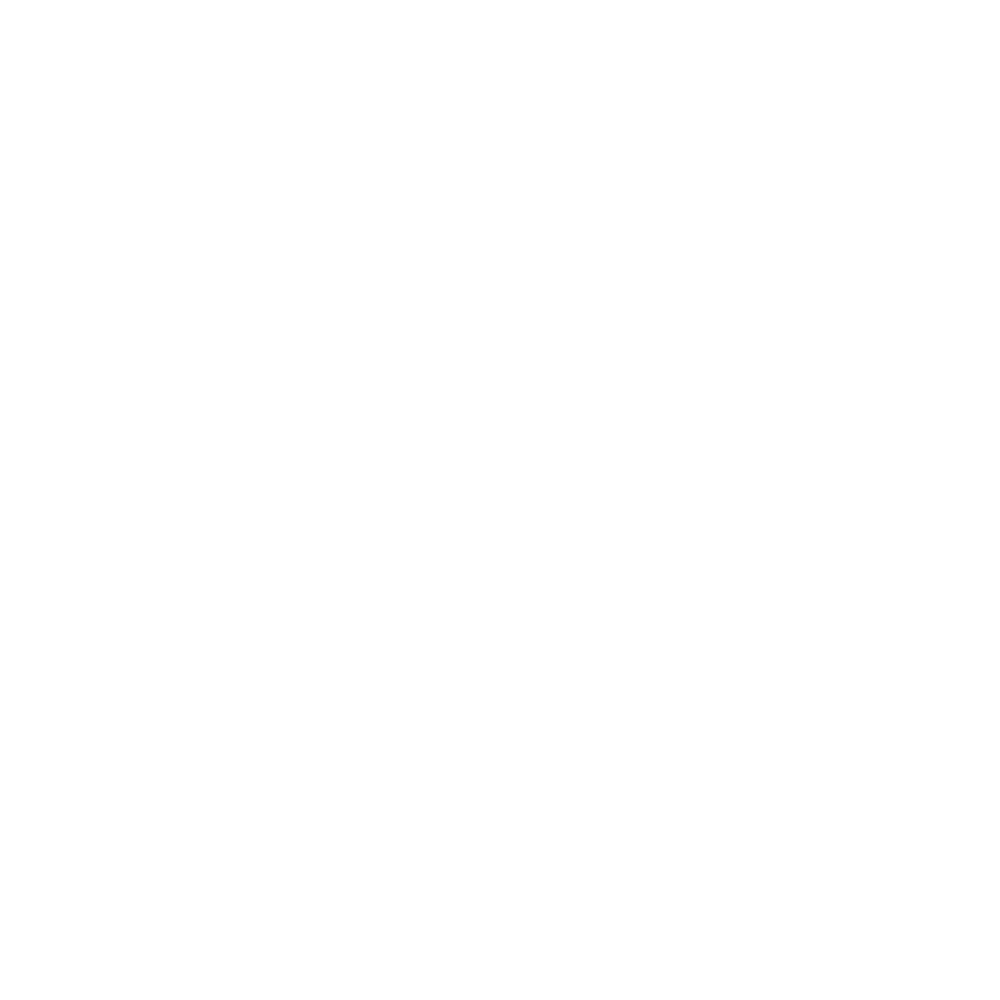

i, sweeptime =  2017-09-10 11:31:06


<IPython.core.display.Javascript object>


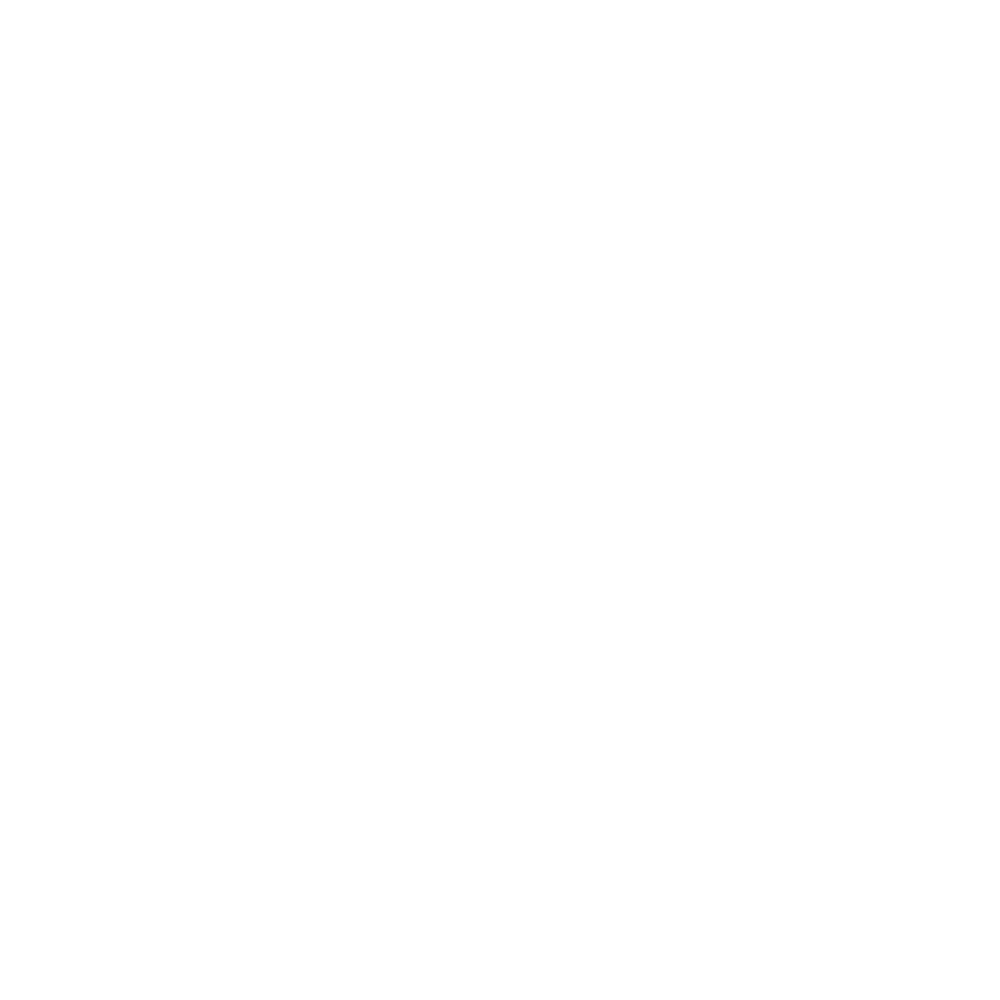

i, sweeptime =  2017-09-10 11:37:35


<IPython.core.display.Javascript object>


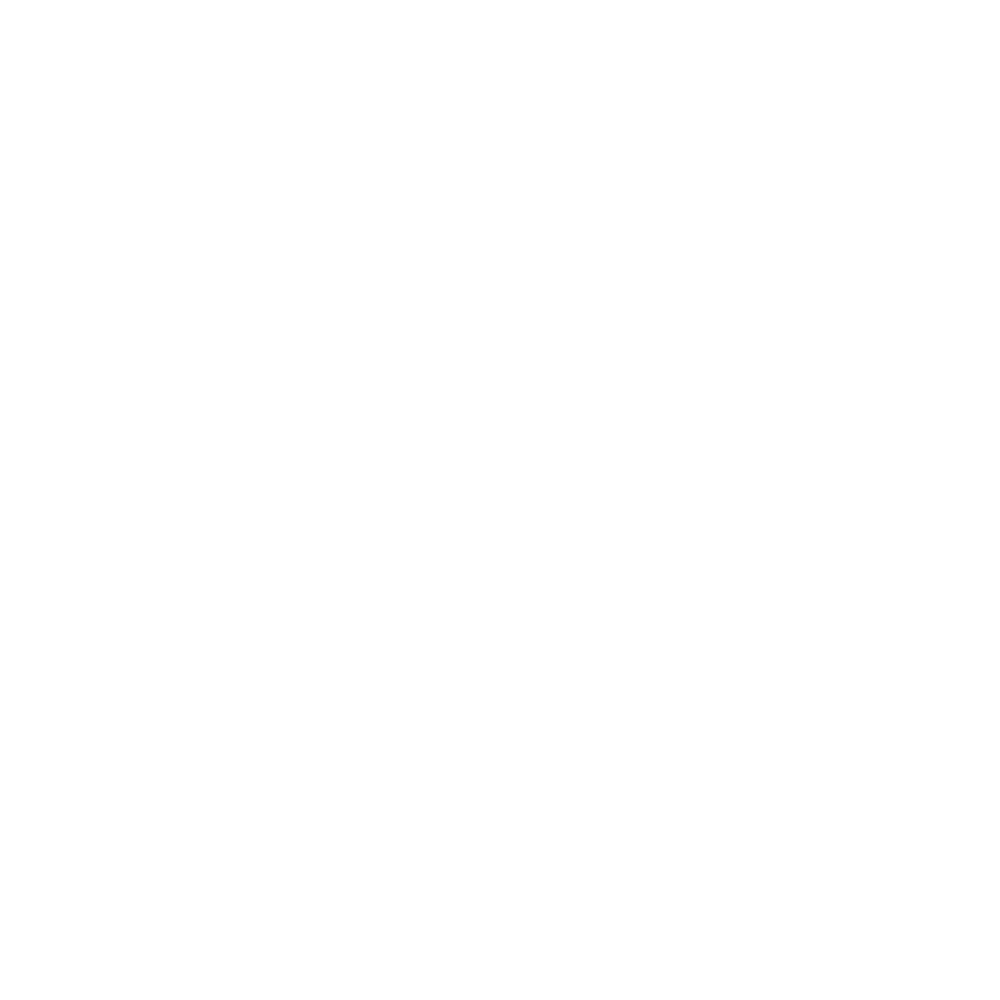

i, sweeptime =  2017-09-10 11:44:06


<IPython.core.display.Javascript object>


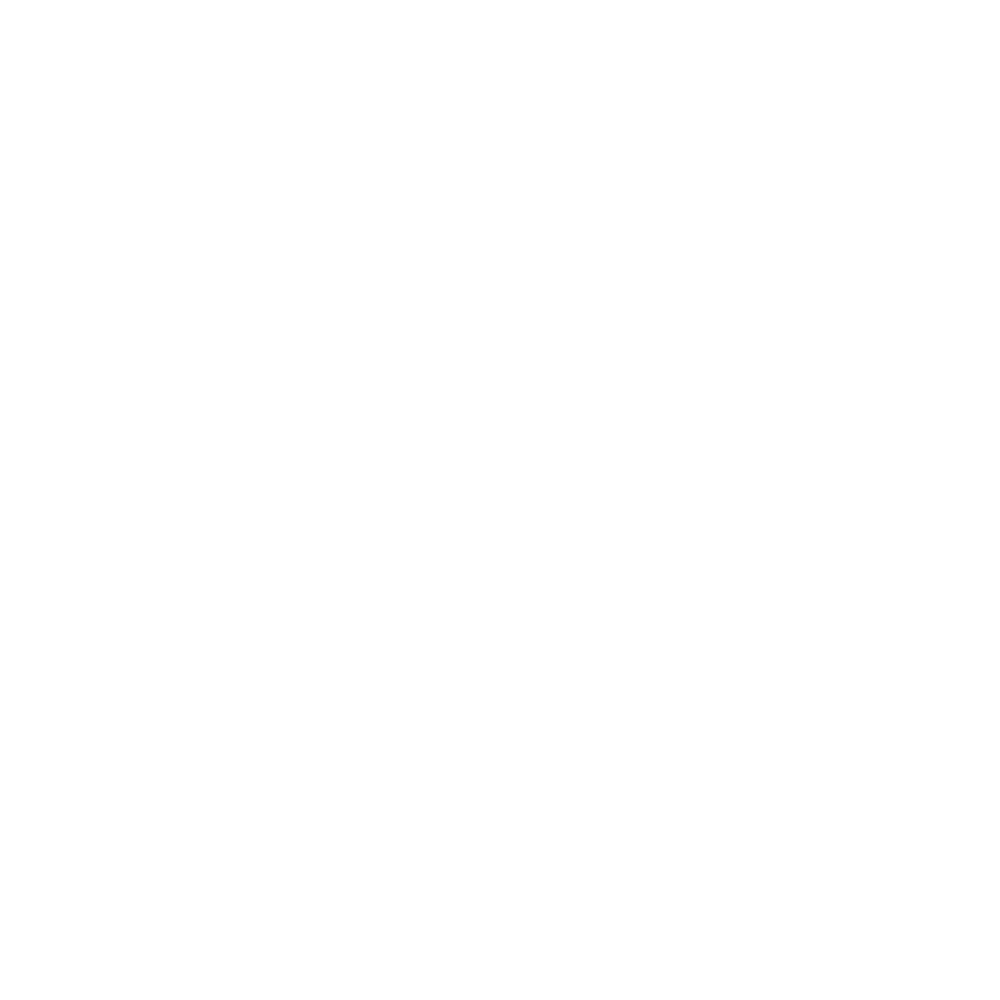

i, sweeptime =  2017-09-10 11:50:37


<IPython.core.display.Javascript object>


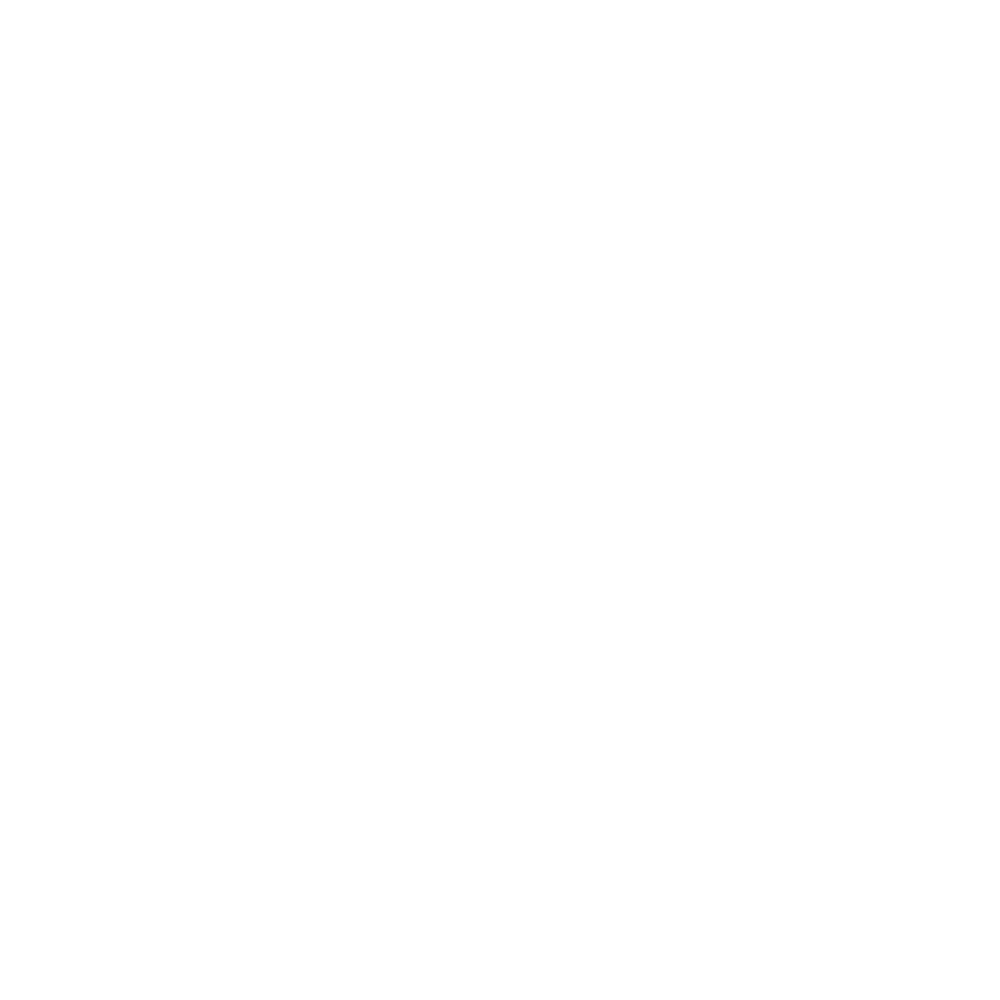

i, sweeptime =  2017-09-10 11:57:07


<IPython.core.display.Javascript object>


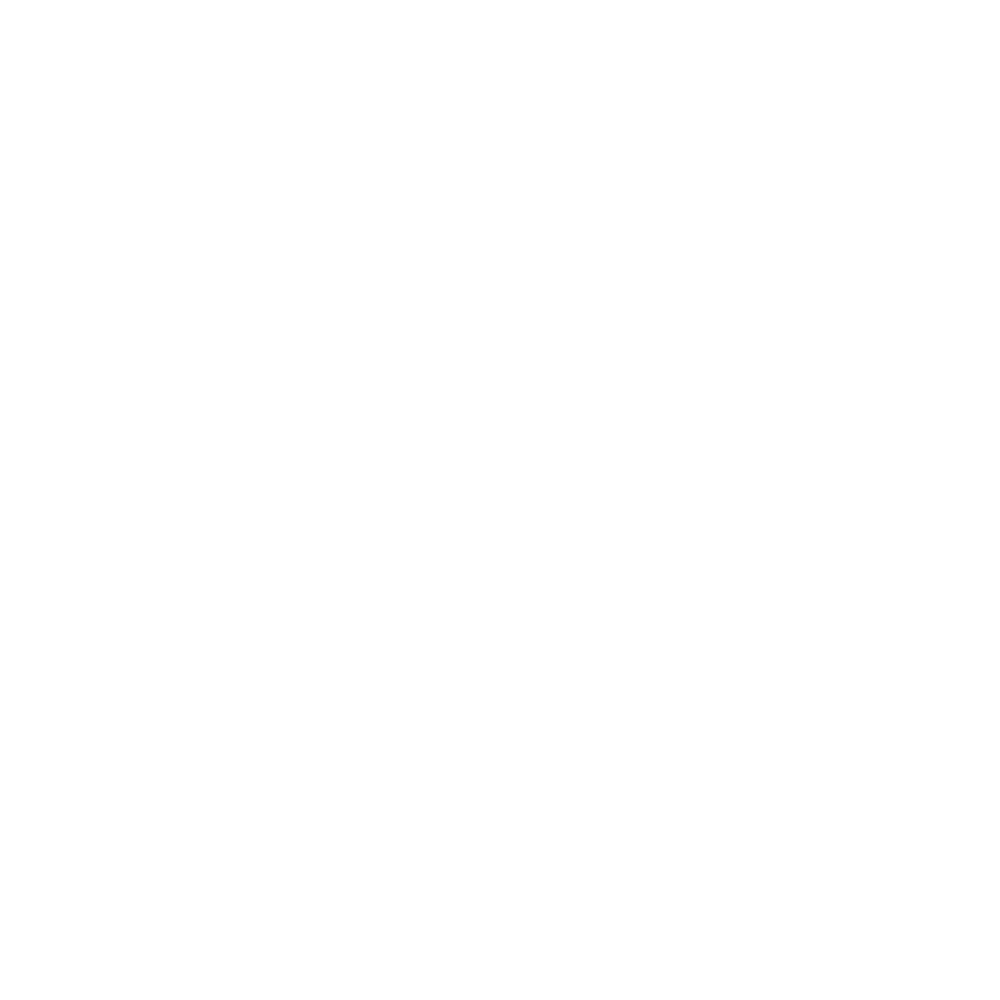

i, sweeptime =  2017-09-10 12:03:39


<IPython.core.display.Javascript object>


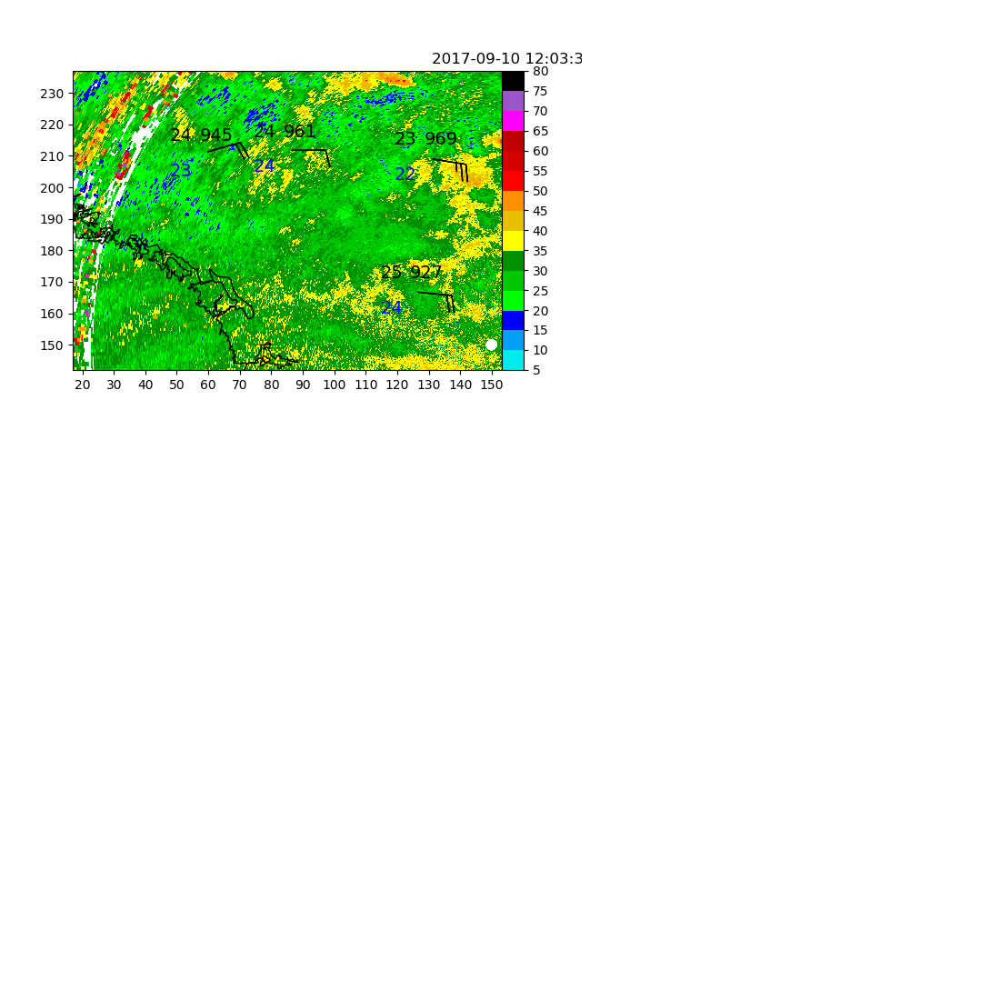

i, sweeptime =  2017-09-10 12:09:18


<IPython.core.display.Javascript object>


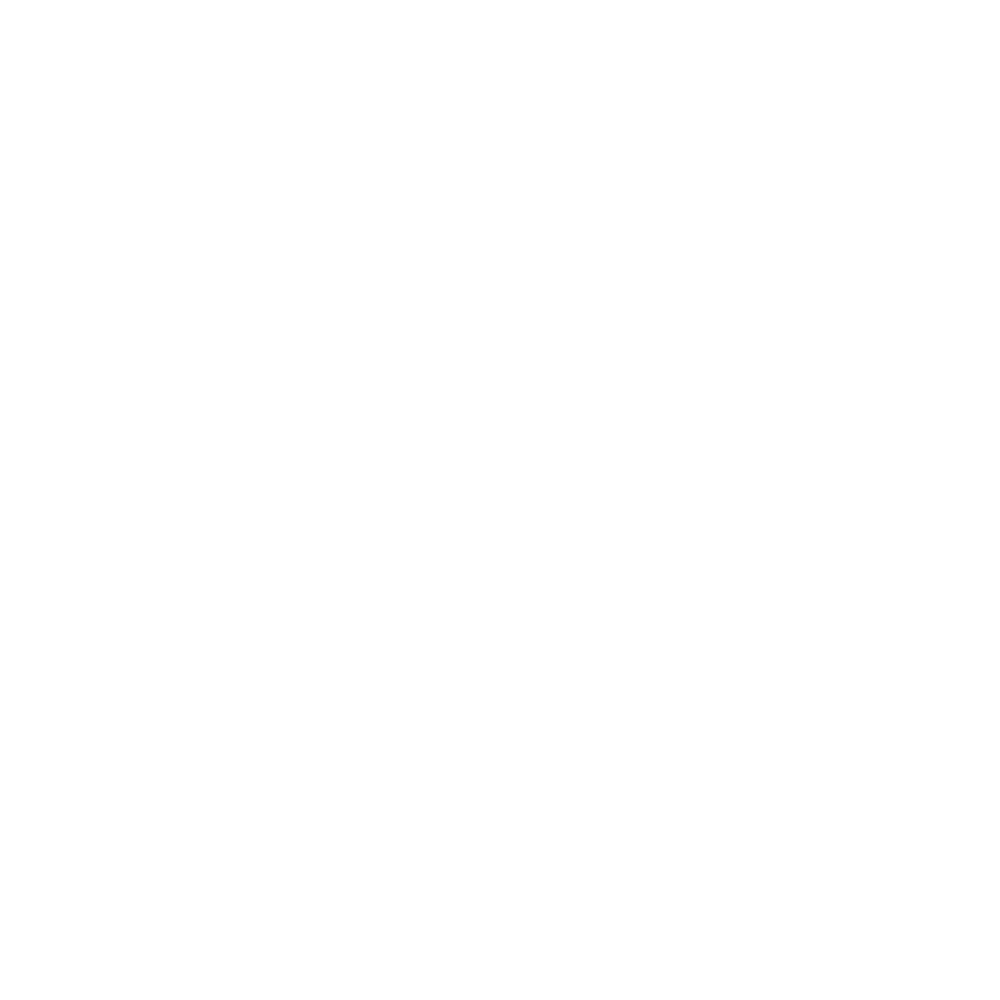

i, sweeptime =  2017-09-10 12:17:56


<IPython.core.display.Javascript object>


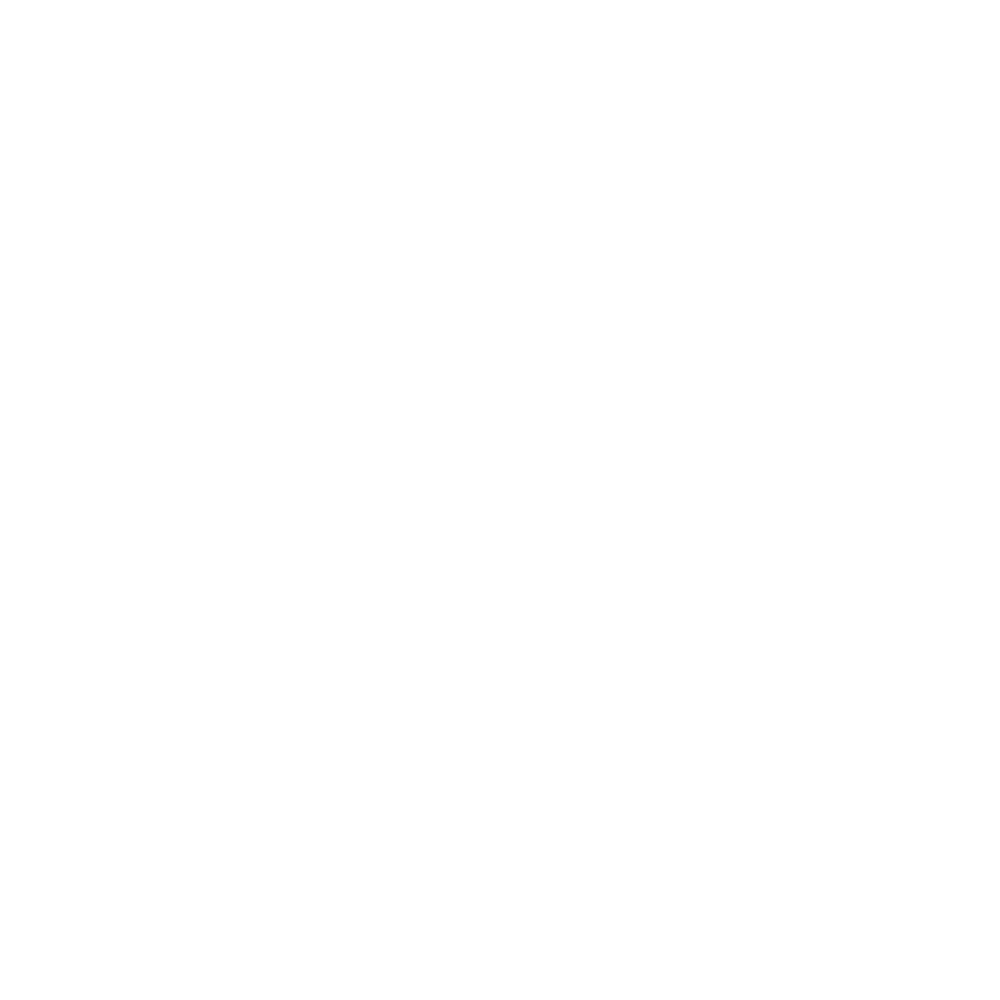

i, sweeptime =  2017-09-10 12:24:33


<IPython.core.display.Javascript object>


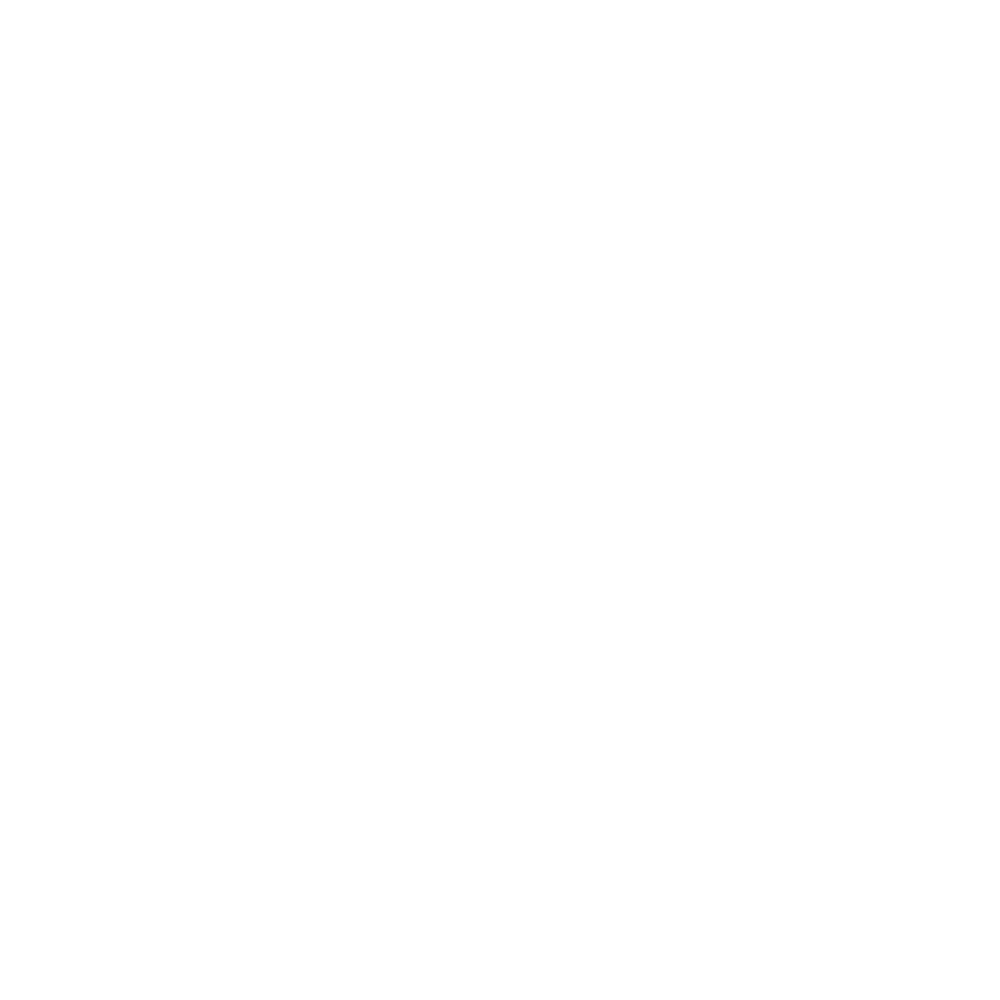

i, sweeptime =  2017-09-10 12:31:03


<IPython.core.display.Javascript object>


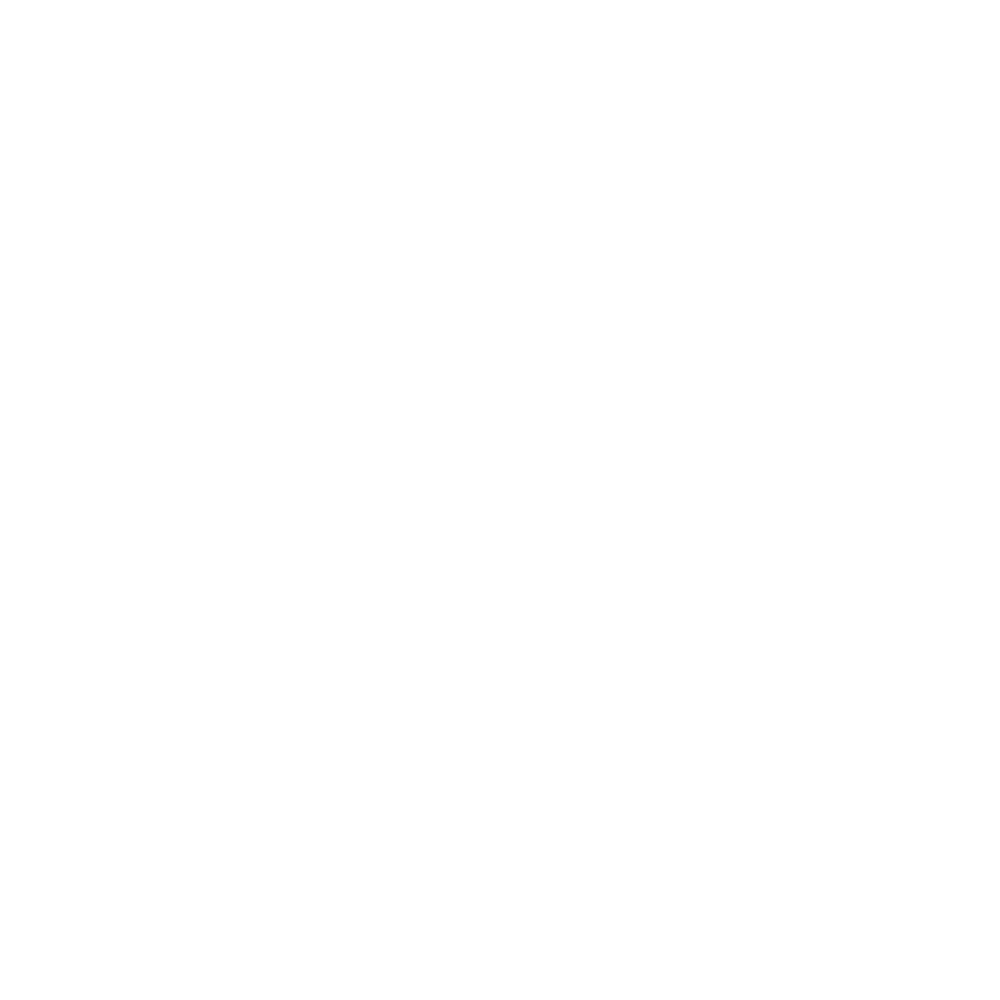

i, sweeptime =  2017-09-10 12:36:41


<IPython.core.display.Javascript object>


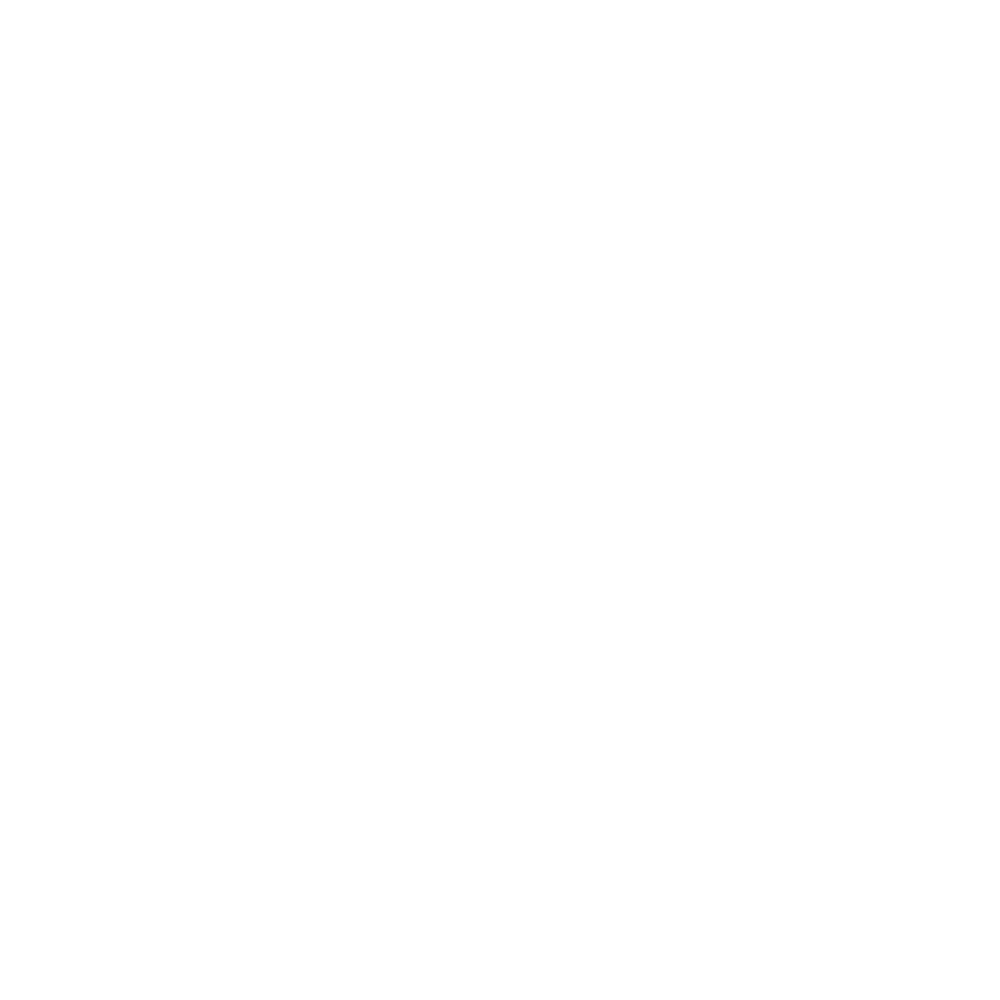

i, sweeptime =  2017-09-10 12:43:11


<IPython.core.display.Javascript object>


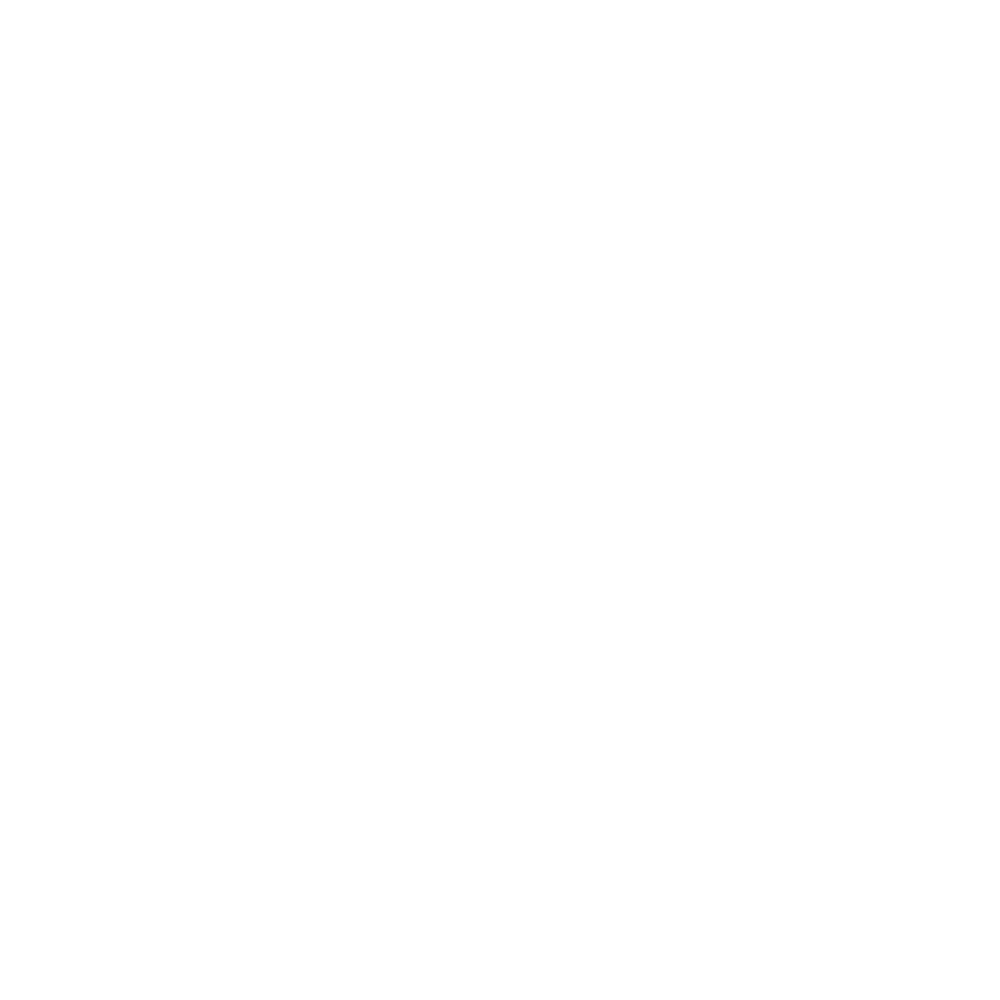

i, sweeptime =  2017-09-10 12:49:46


<IPython.core.display.Javascript object>


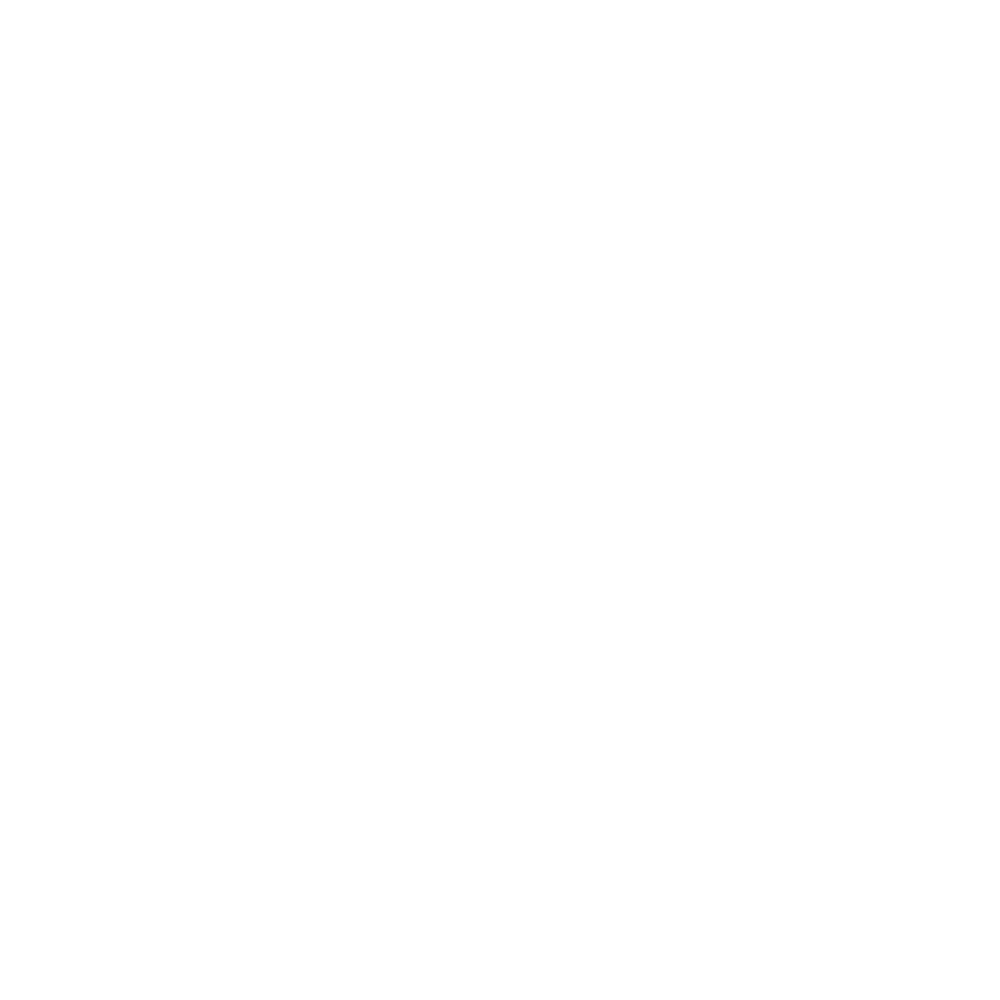

i, sweeptime =  2017-09-10 12:56:42


<IPython.core.display.Javascript object>


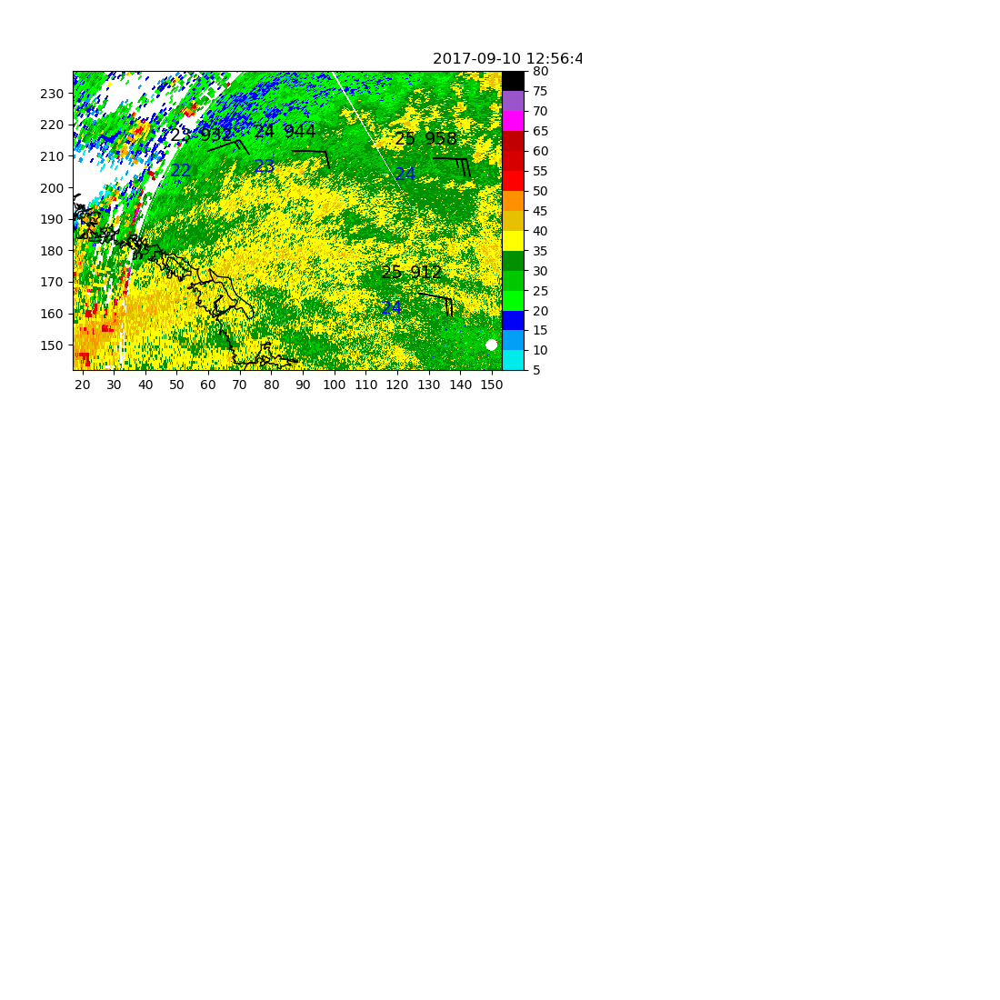

i, sweeptime =  2017-09-10 13:03:14


<IPython.core.display.Javascript object>


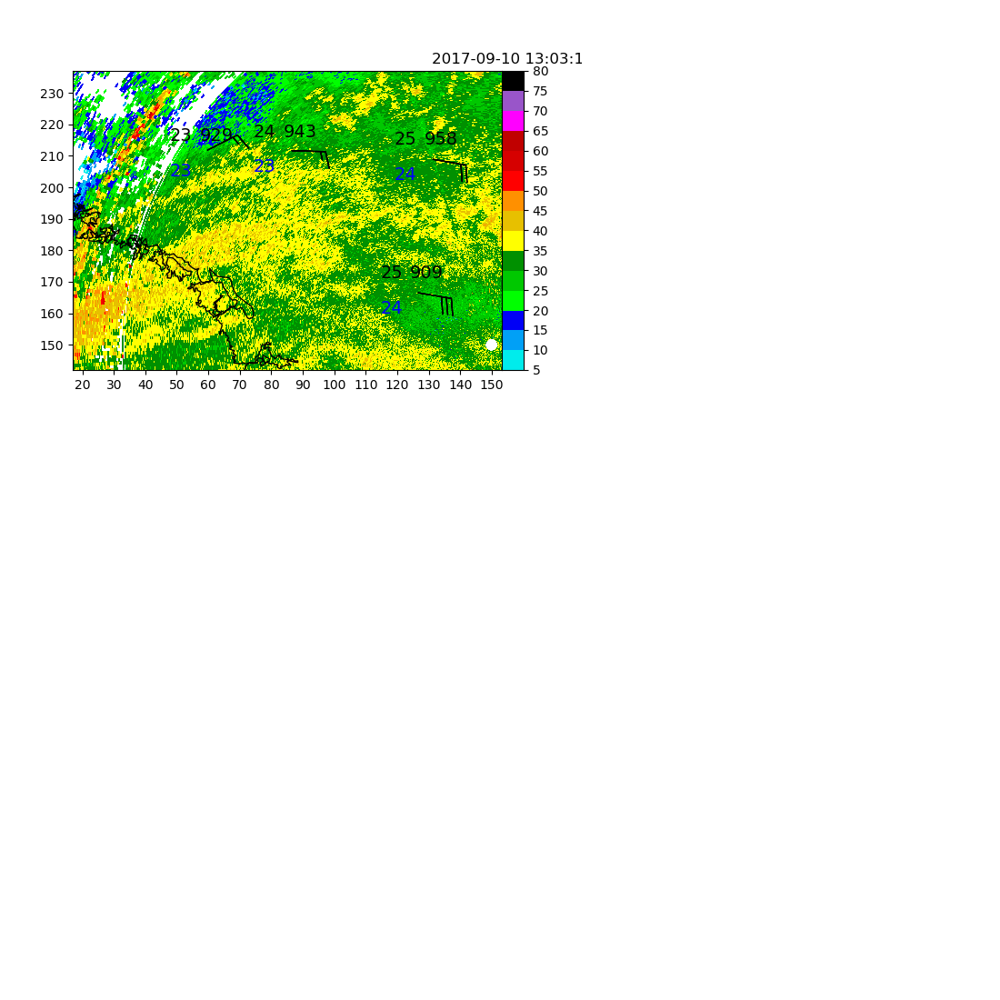

i, sweeptime =  2017-09-10 13:09:50


<IPython.core.display.Javascript object>


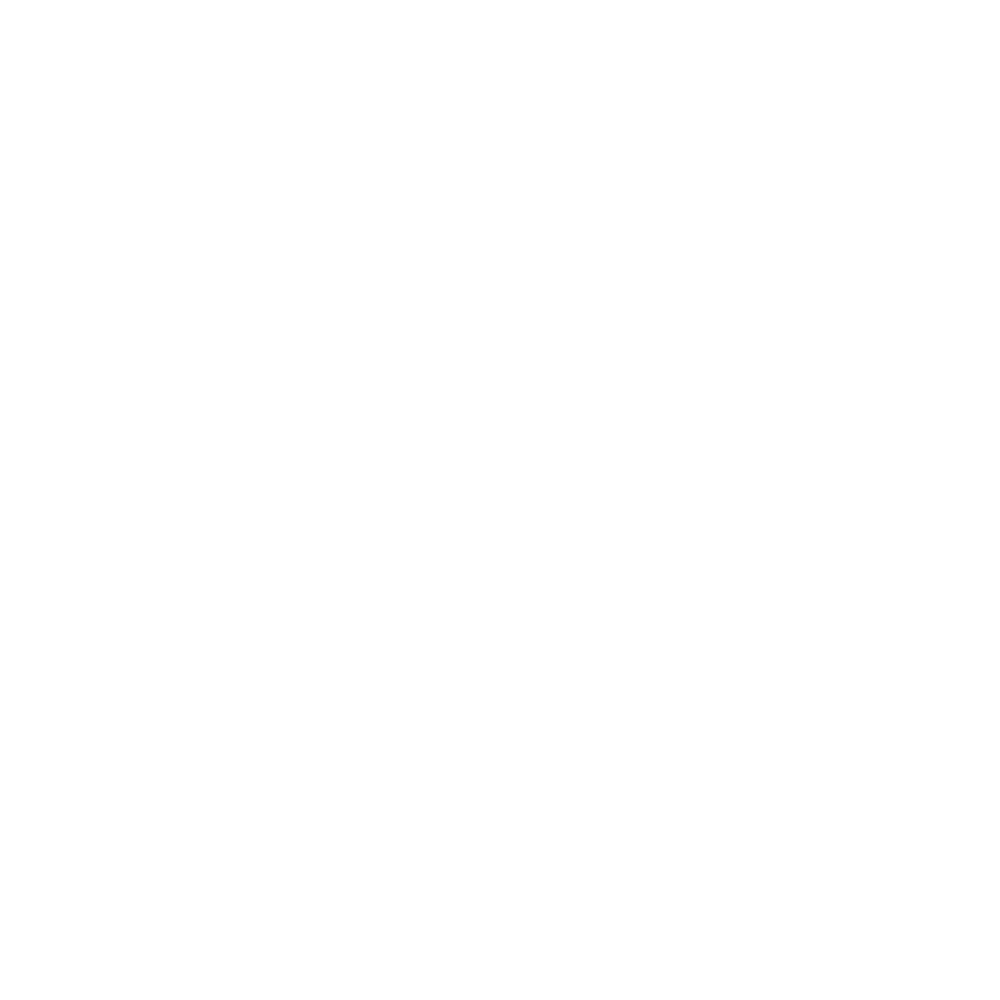

i, sweeptime =  2017-09-10 13:16:45


<IPython.core.display.Javascript object>


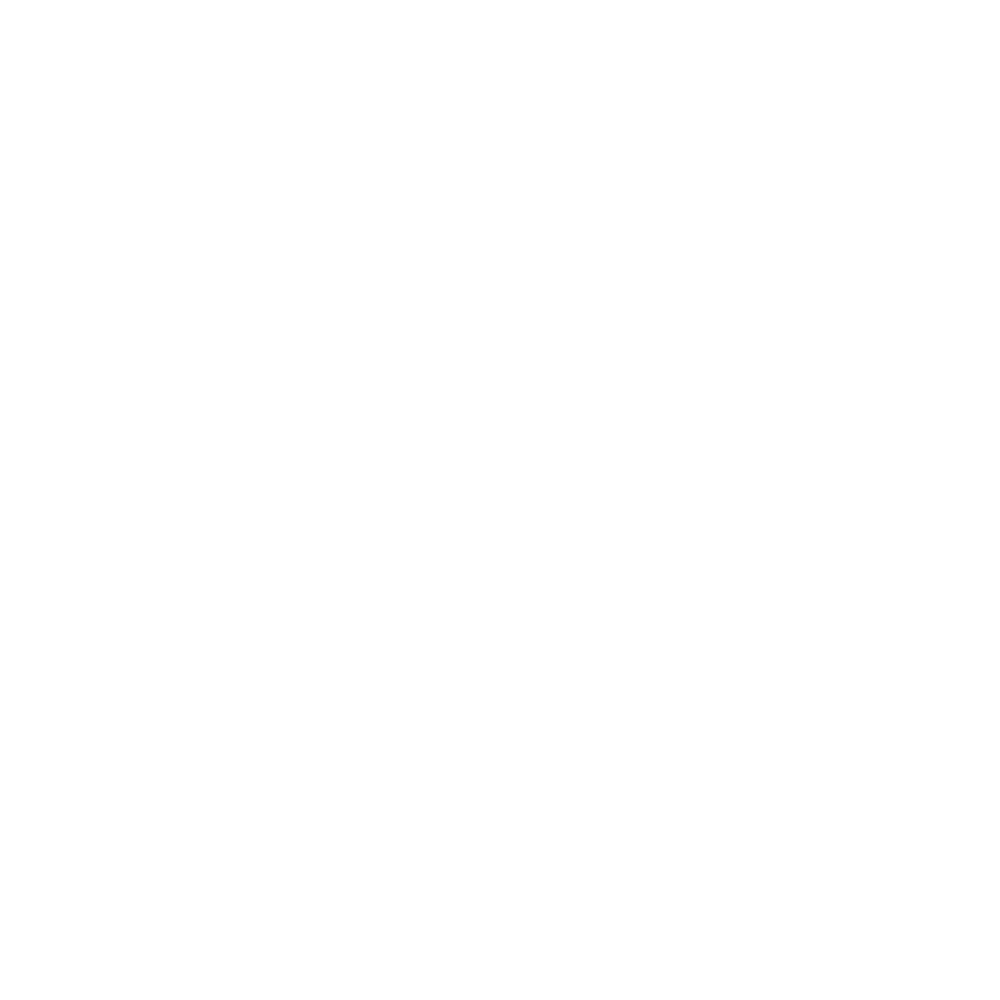

i, sweeptime =  2017-09-10 13:23:15


<IPython.core.display.Javascript object>


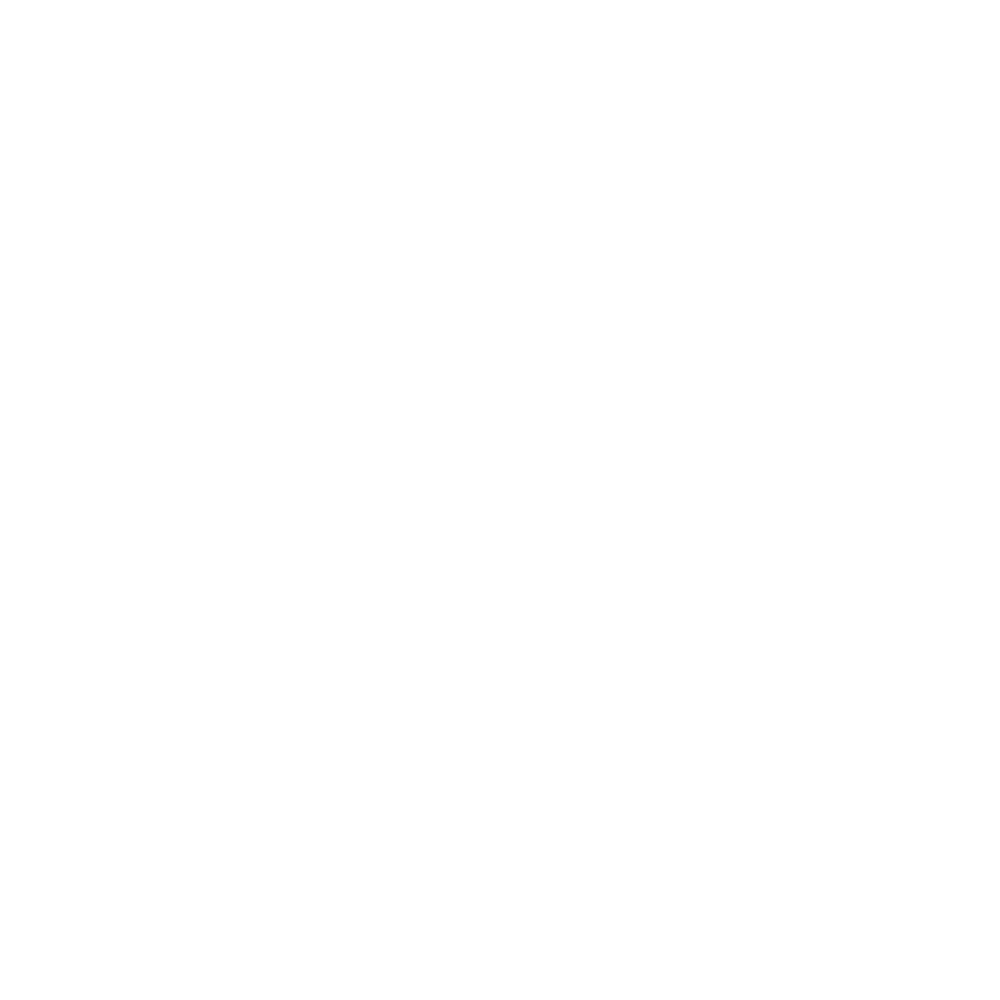

i, sweeptime =  2017-09-10 13:29:47


<IPython.core.display.Javascript object>


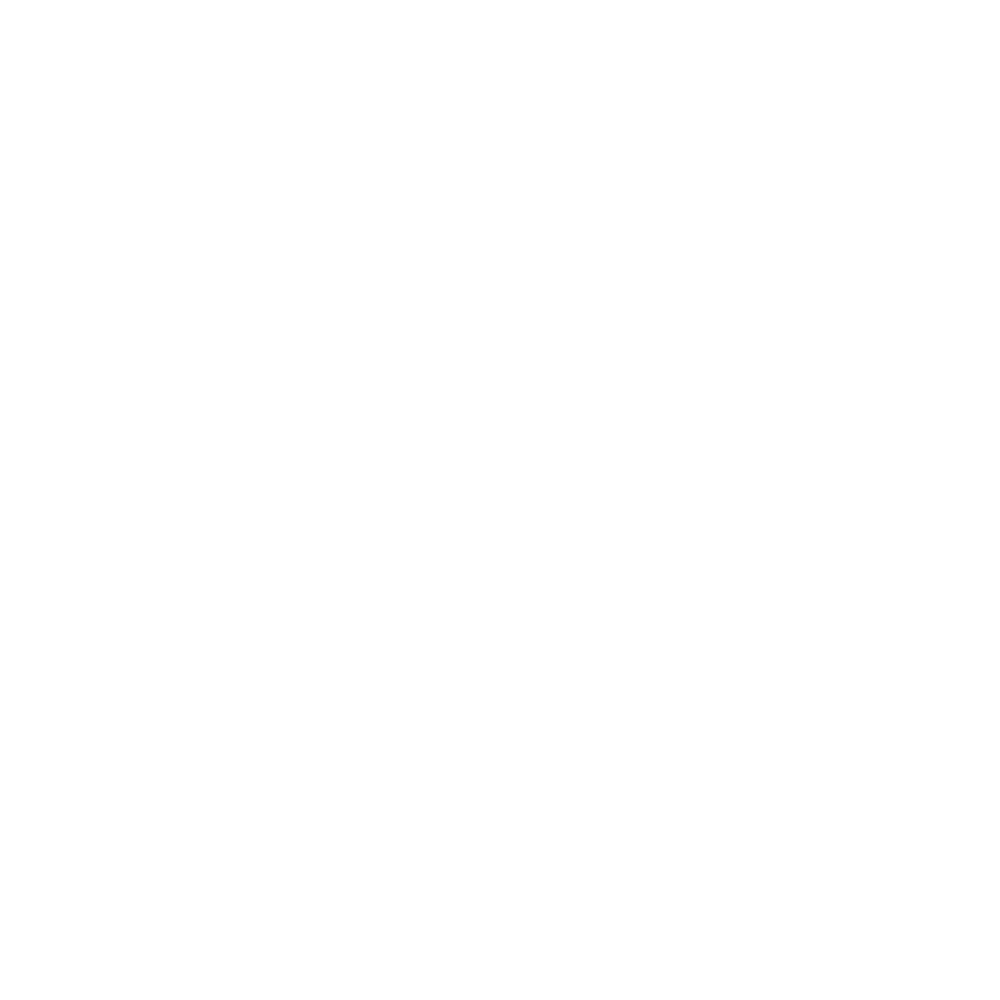

i, sweeptime =  2017-09-10 13:36:23


<IPython.core.display.Javascript object>


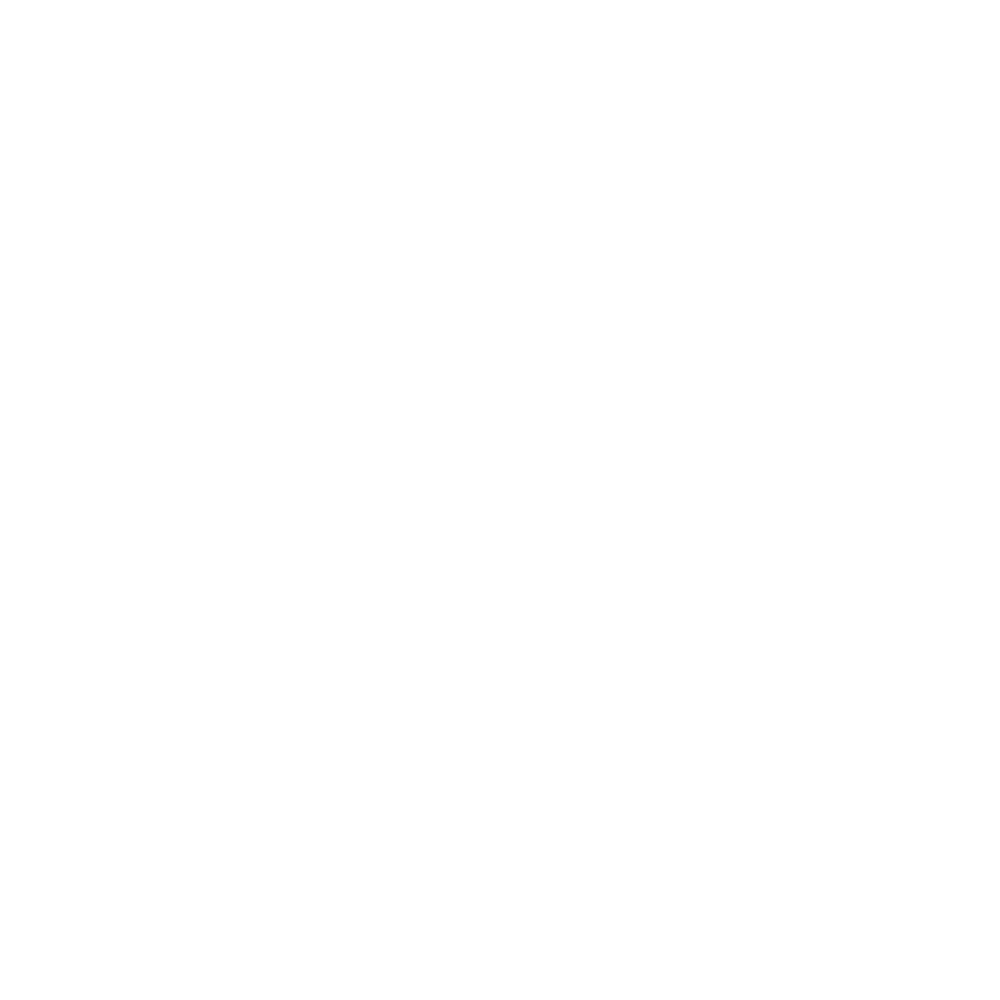

i, sweeptime =  2017-09-10 13:43:18


<IPython.core.display.Javascript object>


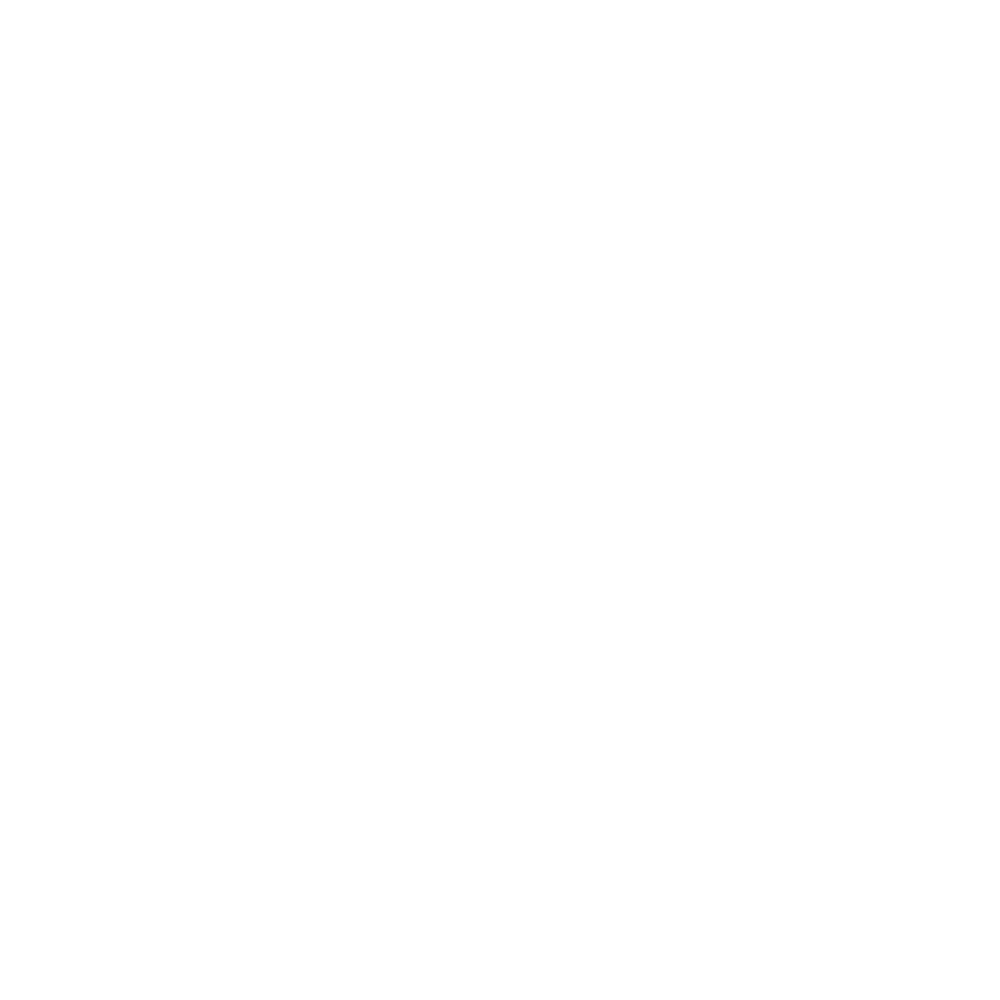

i, sweeptime =  2017-09-10 13:49:48


<IPython.core.display.Javascript object>


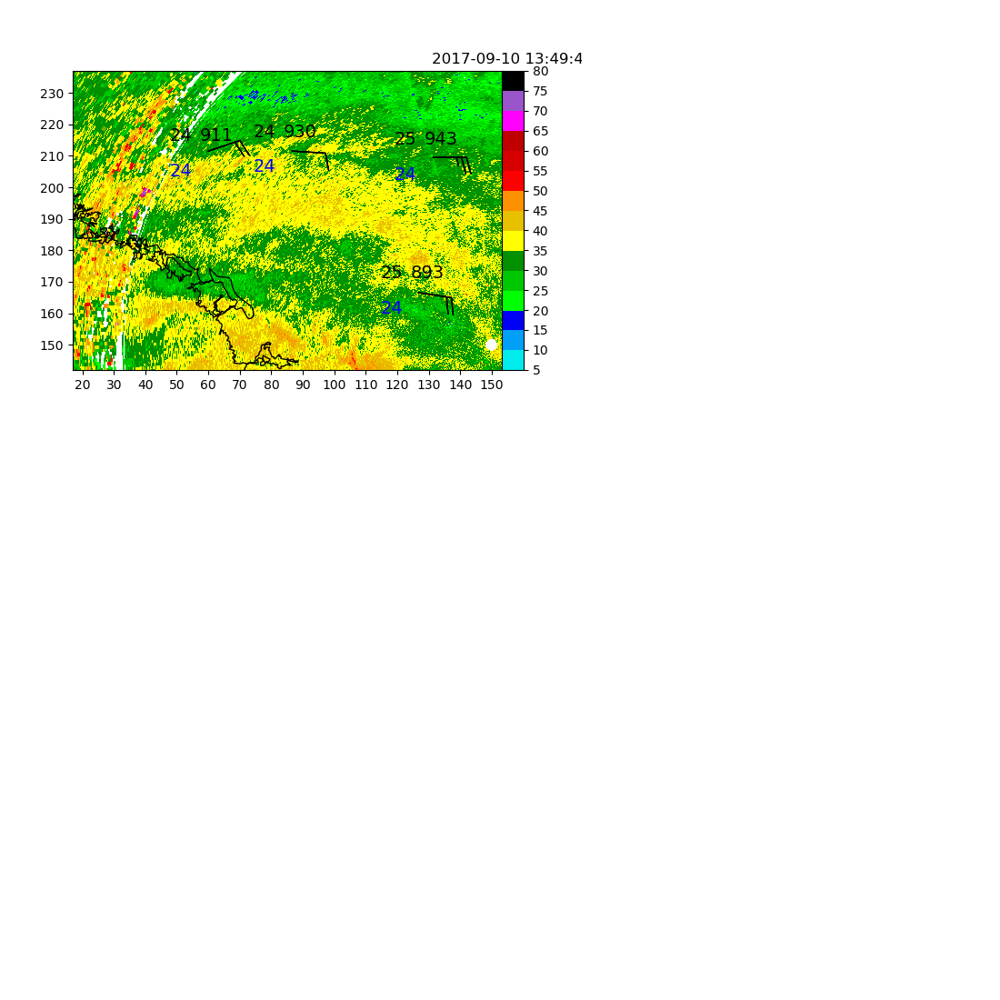

i, sweeptime =  2017-09-10 13:57:29


<IPython.core.display.Javascript object>


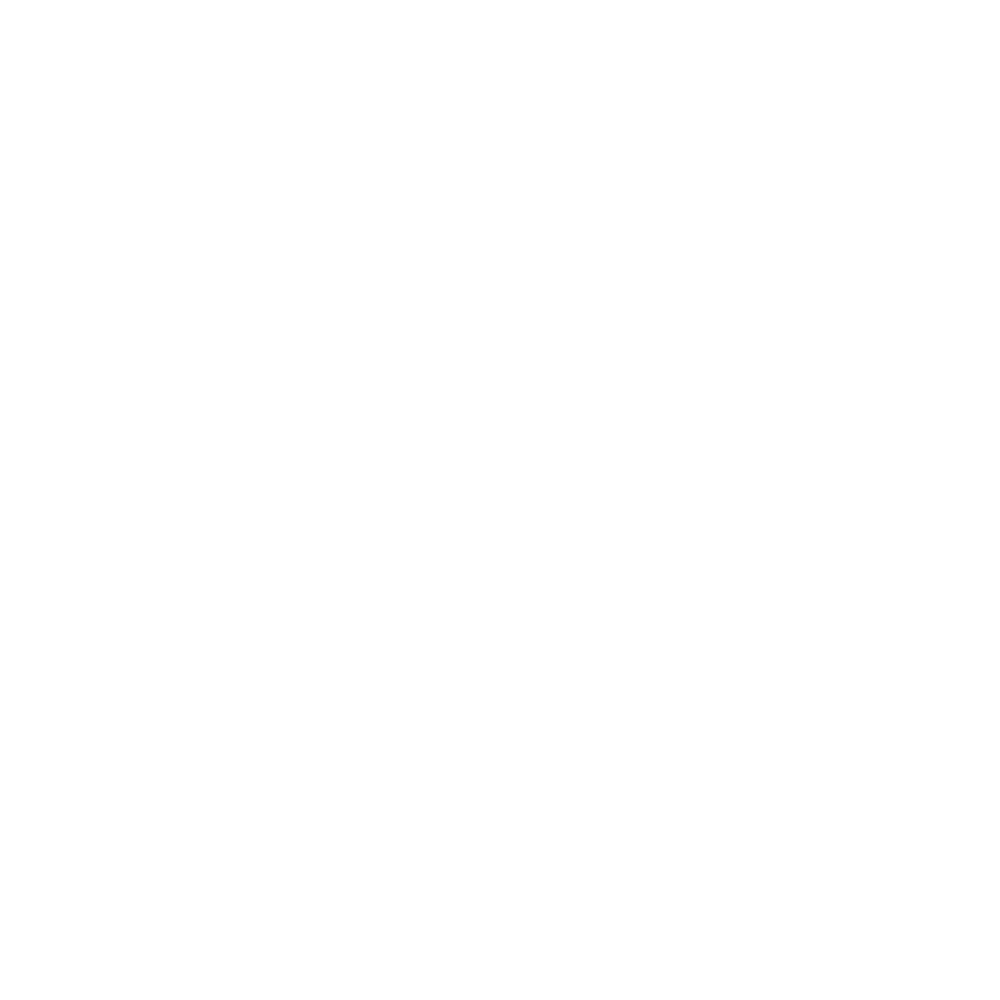

i, sweeptime =  2017-09-10 14:03:59


<IPython.core.display.Javascript object>


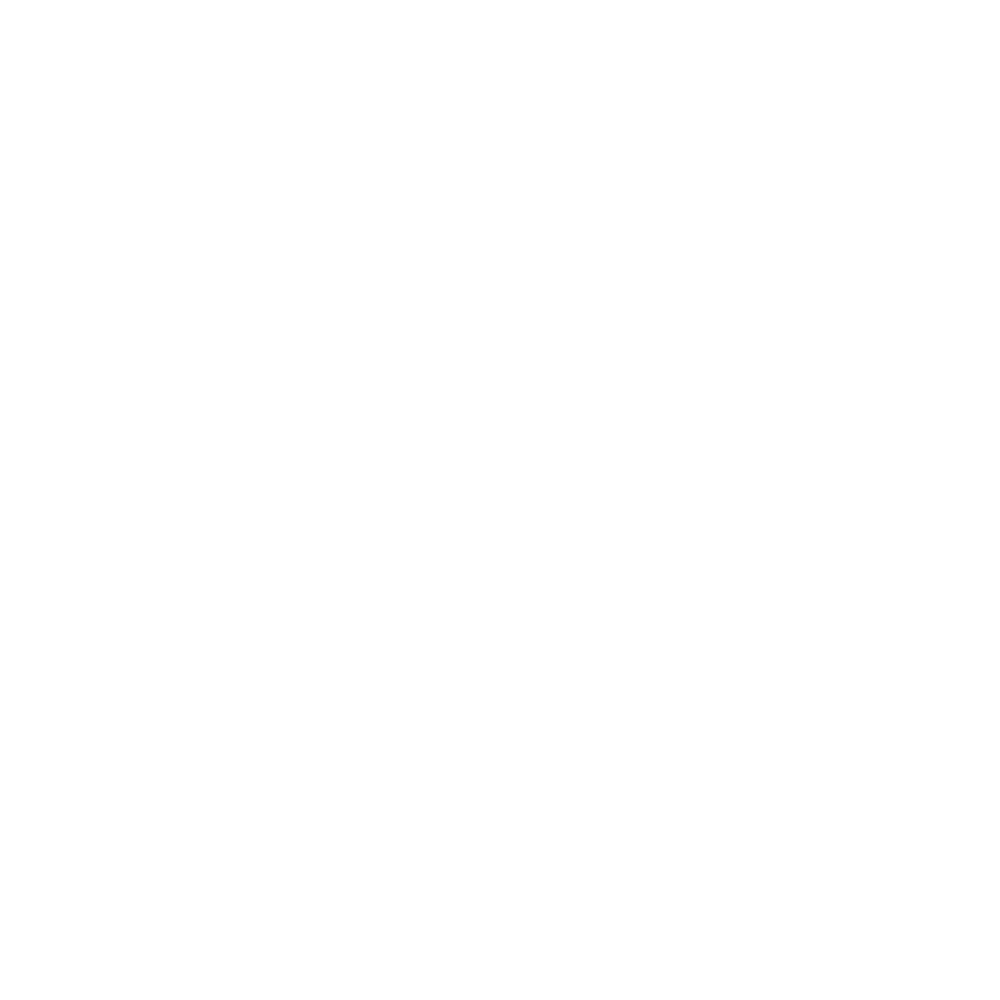

i, sweeptime =  2017-09-10 14:12:24


<IPython.core.display.Javascript object>


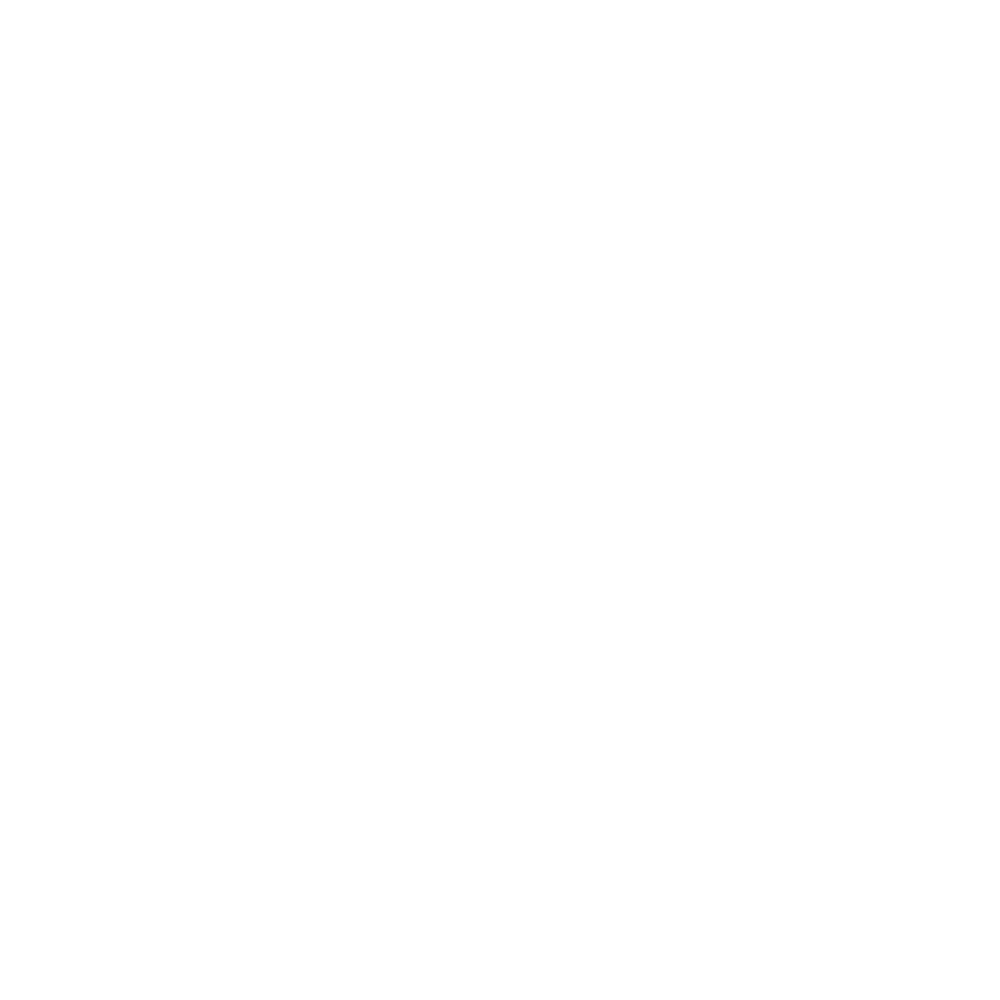

i, sweeptime =  2017-09-10 14:18:54


<IPython.core.display.Javascript object>


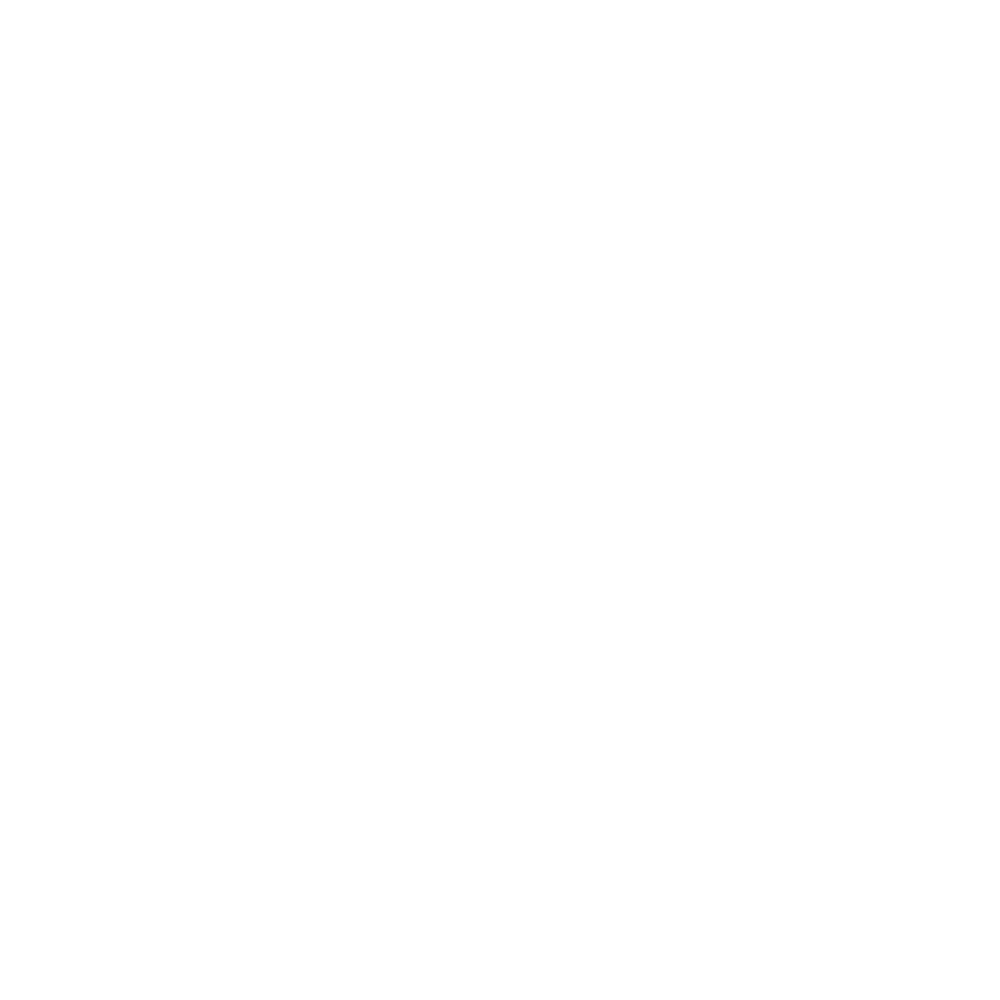

i, sweeptime =  2017-09-10 14:25:25


<IPython.core.display.Javascript object>


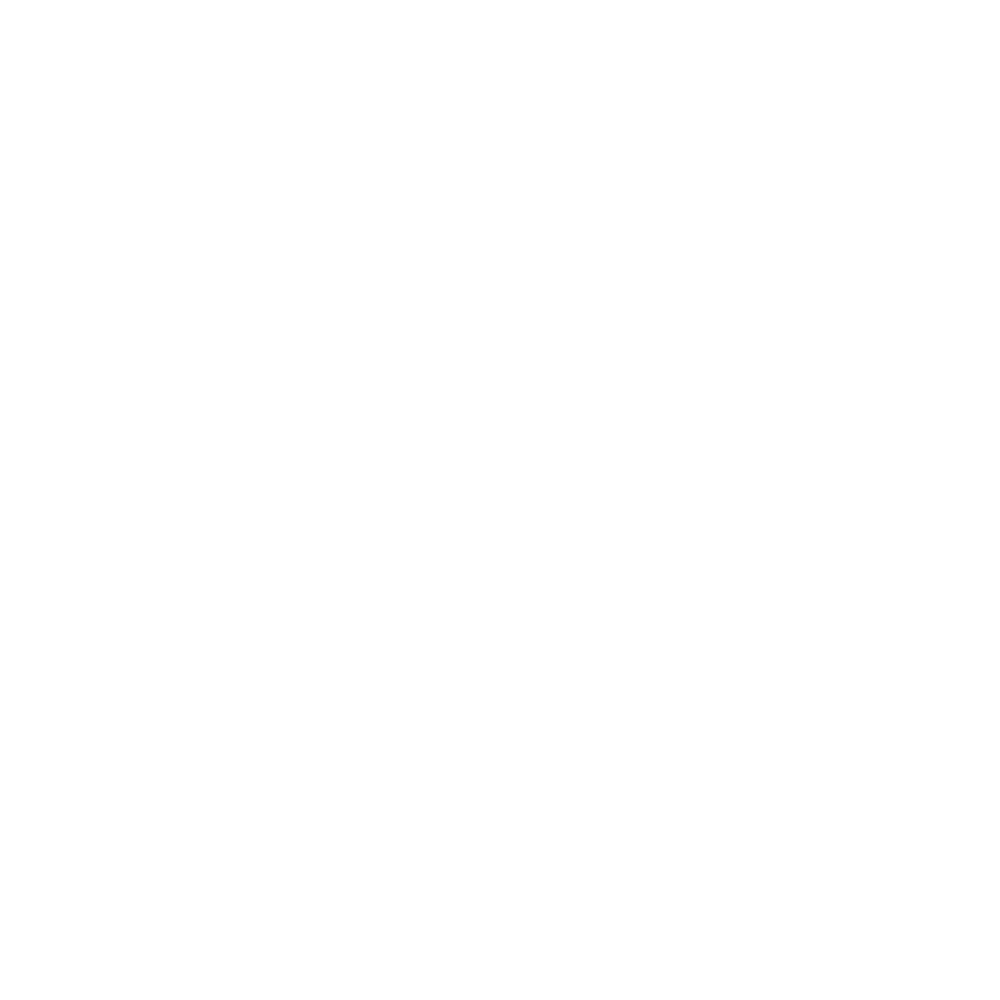

i, sweeptime =  2017-09-10 14:29:28


<IPython.core.display.Javascript object>


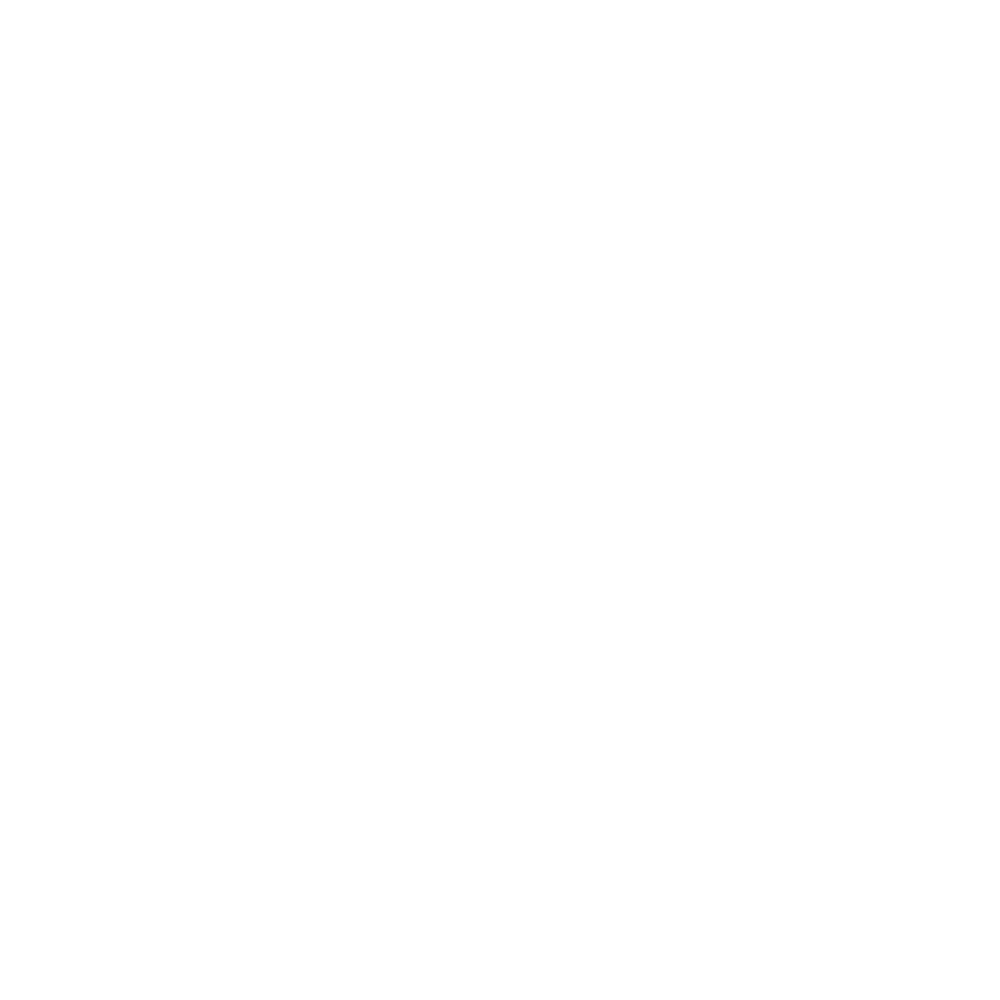

i, sweeptime =  2017-09-10 14:35:55


<IPython.core.display.Javascript object>


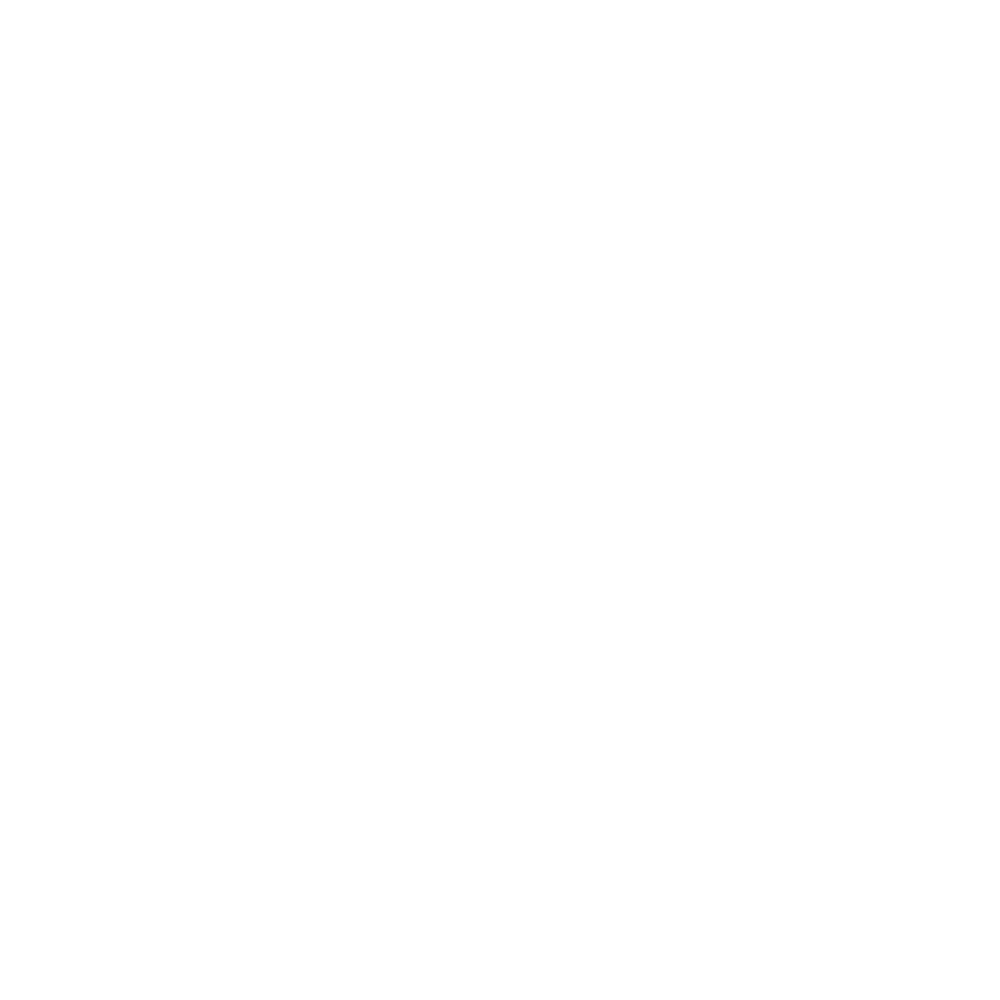

i, sweeptime =  2017-09-10 14:42:25


<IPython.core.display.Javascript object>


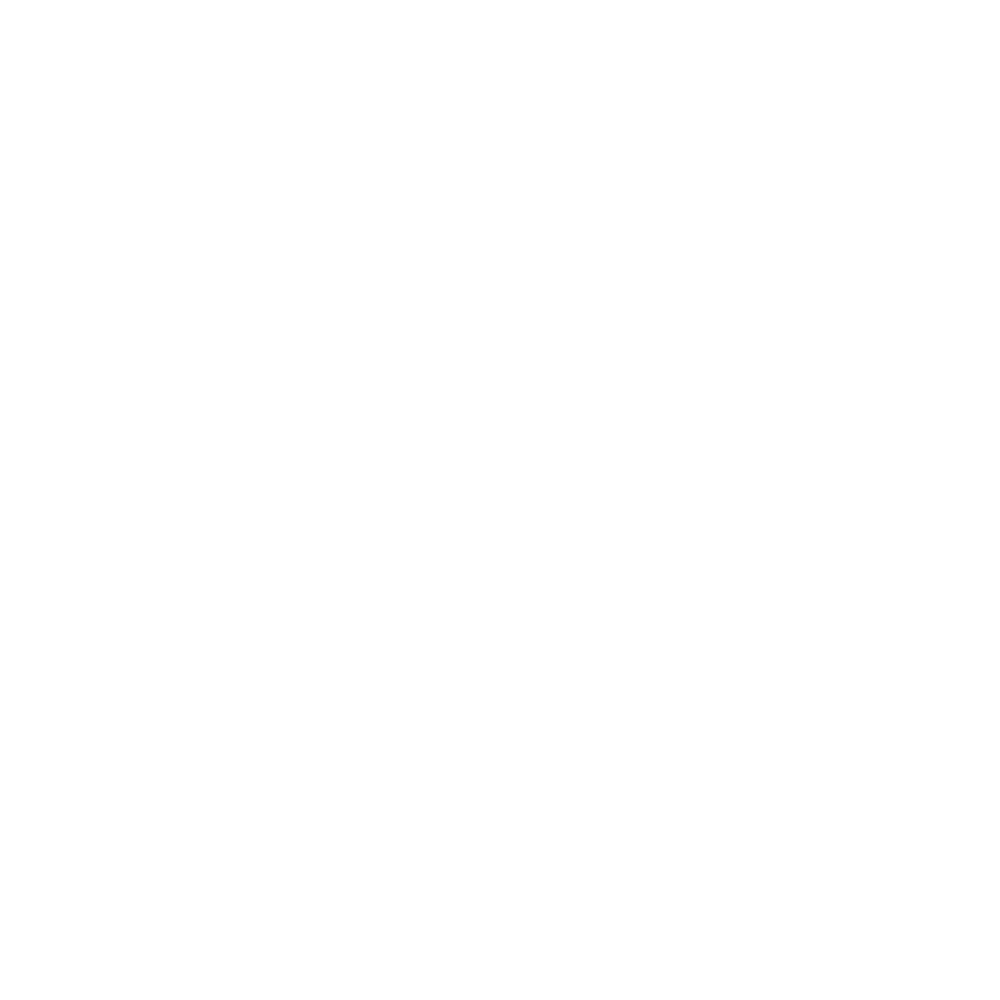

i, sweeptime =  2017-09-10 14:49:21


<IPython.core.display.Javascript object>


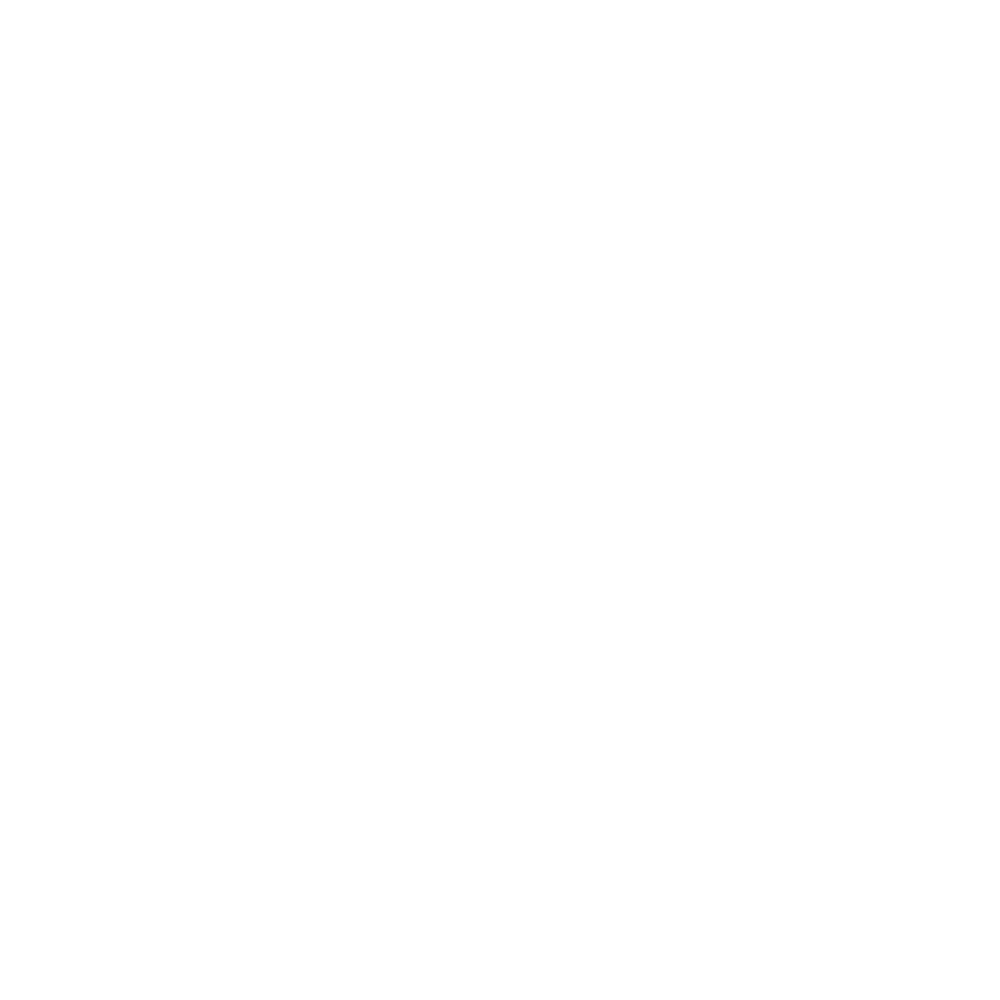

i, sweeptime =  2017-09-10 14:51:35


<IPython.core.display.Javascript object>


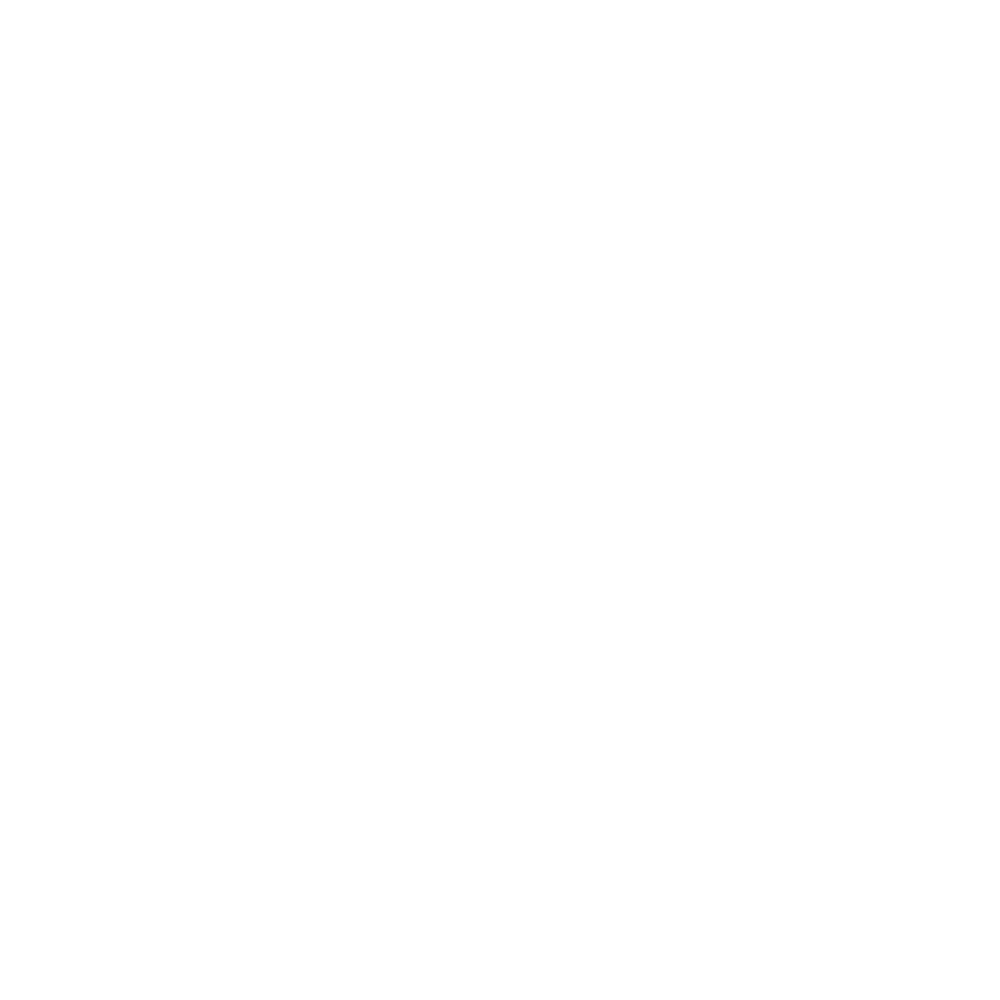

i, sweeptime =  2017-09-10 14:58:54


<IPython.core.display.Javascript object>


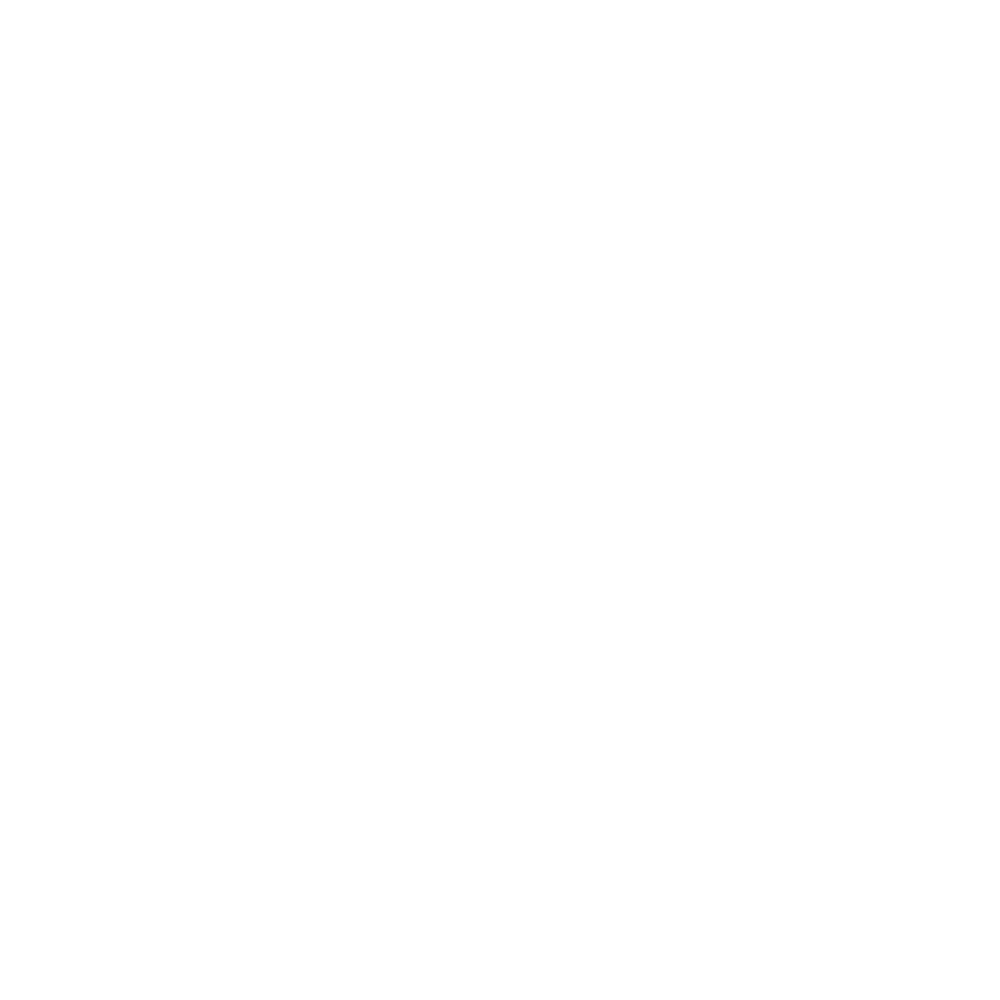

i, sweeptime =  2017-09-10 15:05:25


<IPython.core.display.Javascript object>


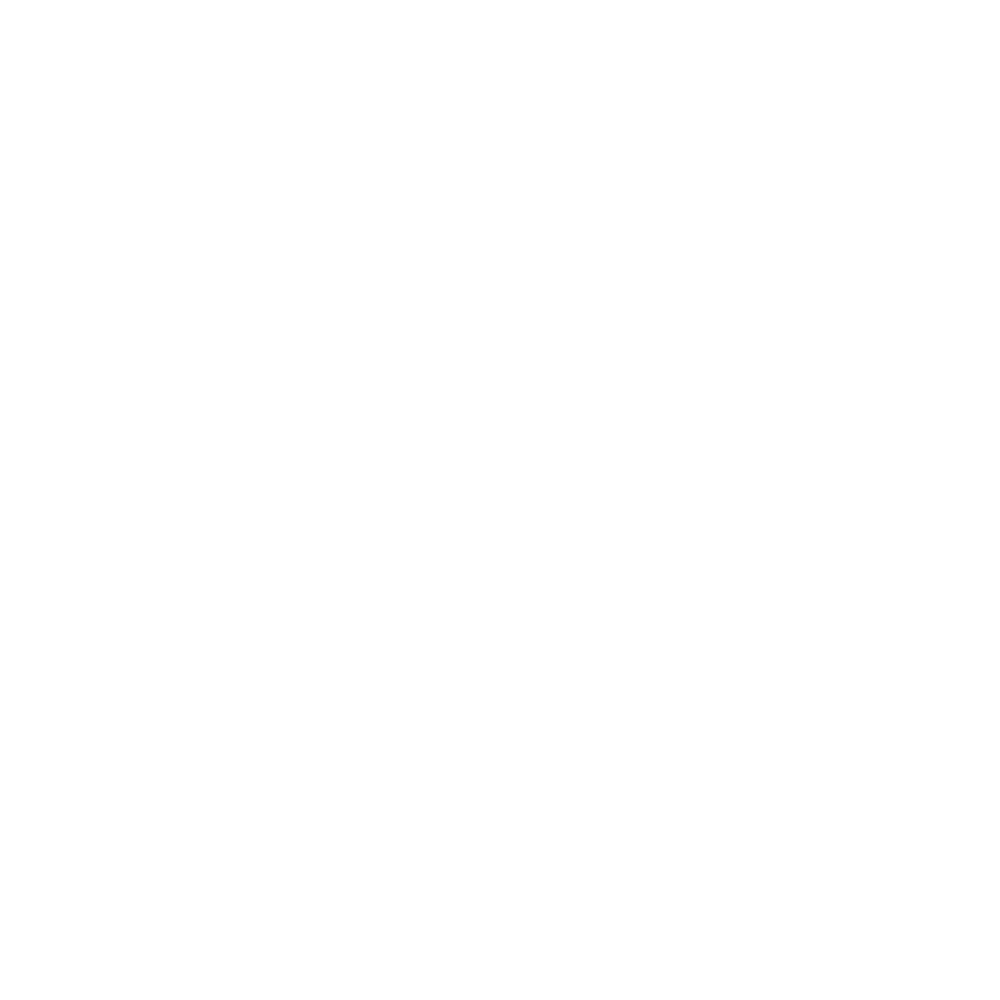

i, sweeptime =  2017-09-10 15:11:55


<IPython.core.display.Javascript object>


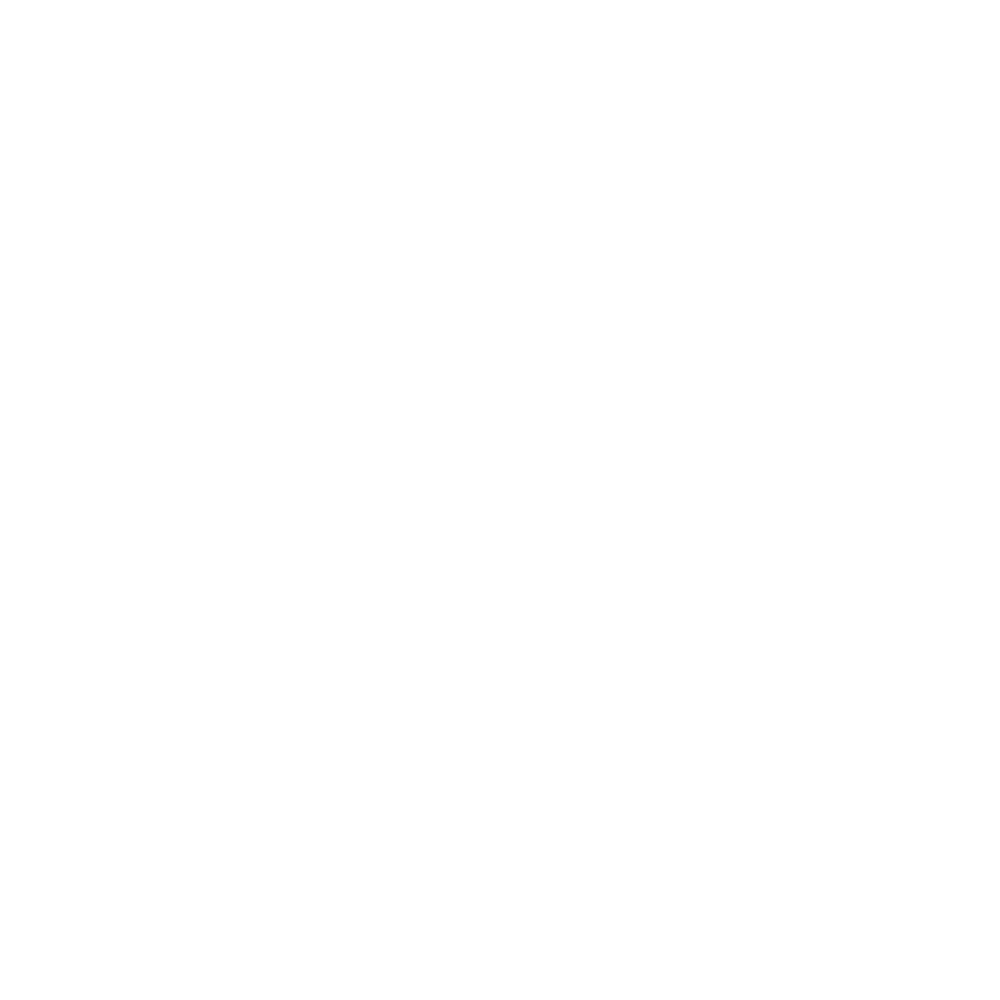

i, sweeptime =  2017-09-10 15:18:27


<IPython.core.display.Javascript object>


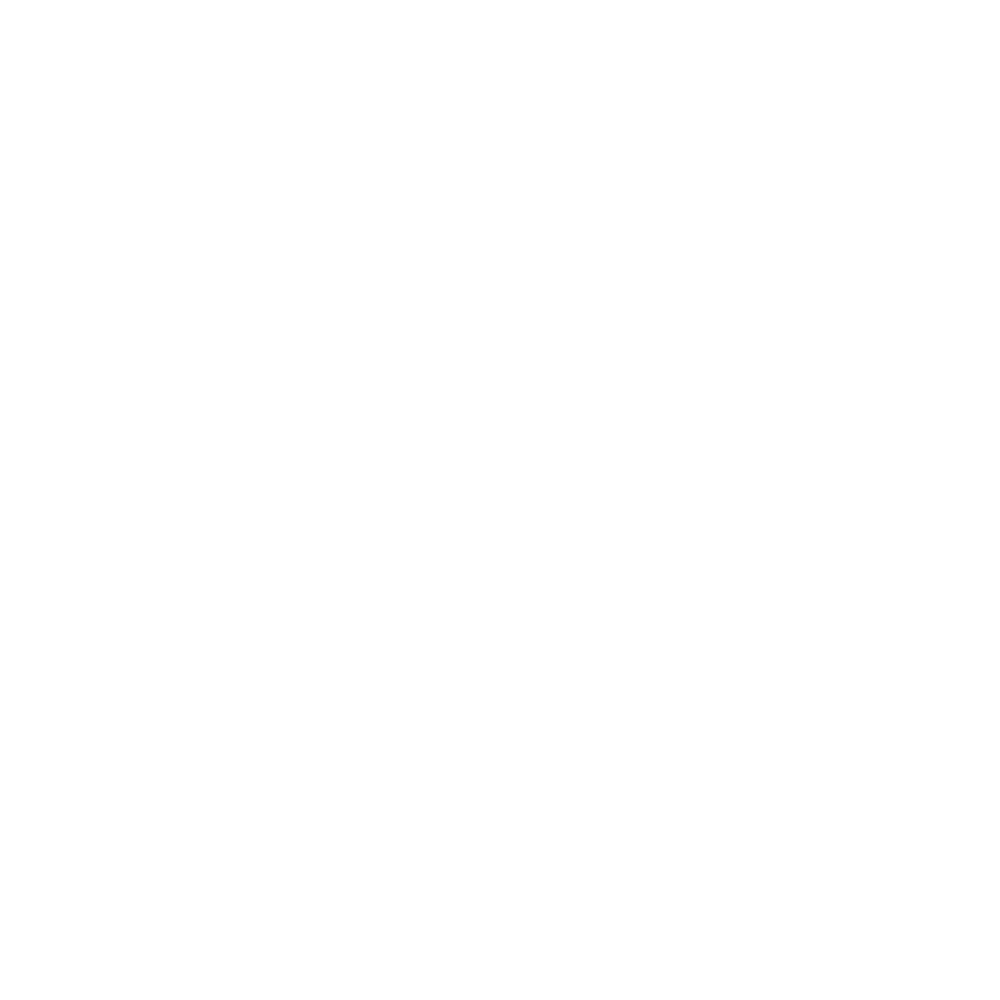

i, sweeptime =  2017-09-10 15:24:56


<IPython.core.display.Javascript object>


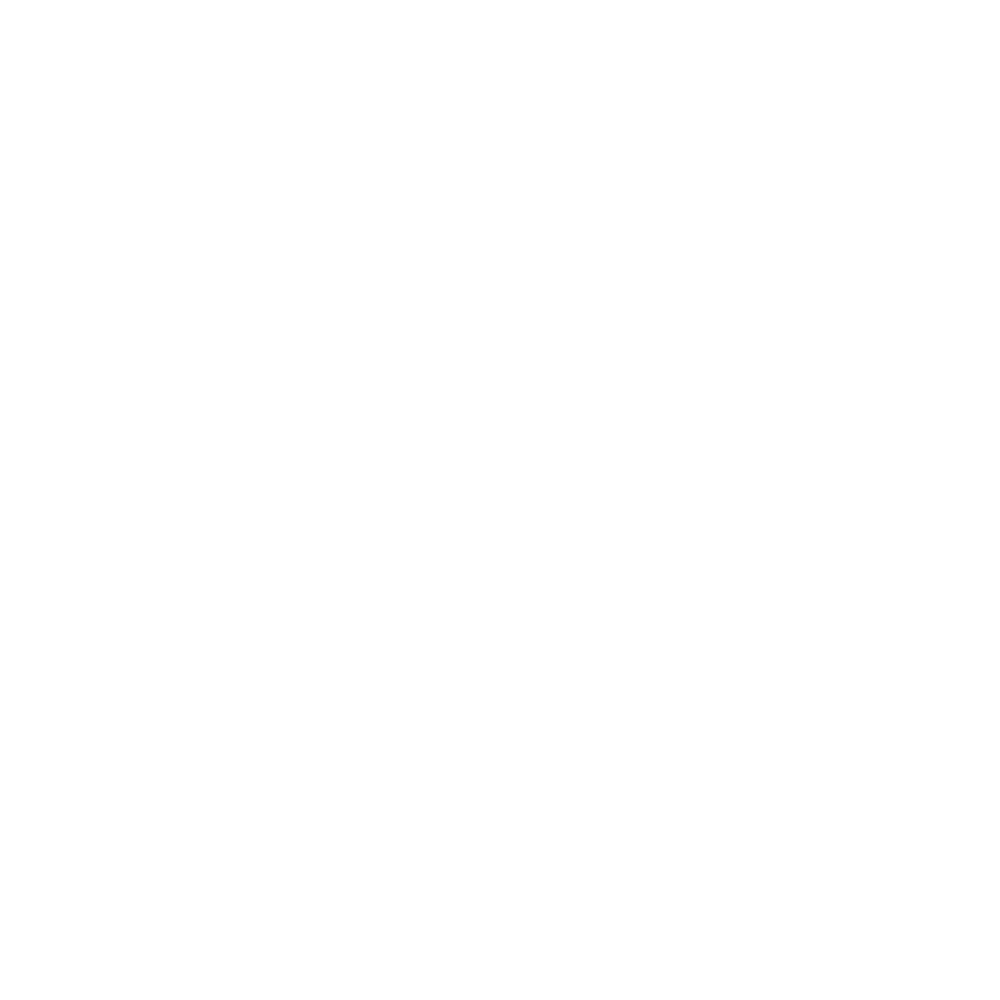

i, sweeptime =  2017-09-10 15:30:50


<IPython.core.display.Javascript object>


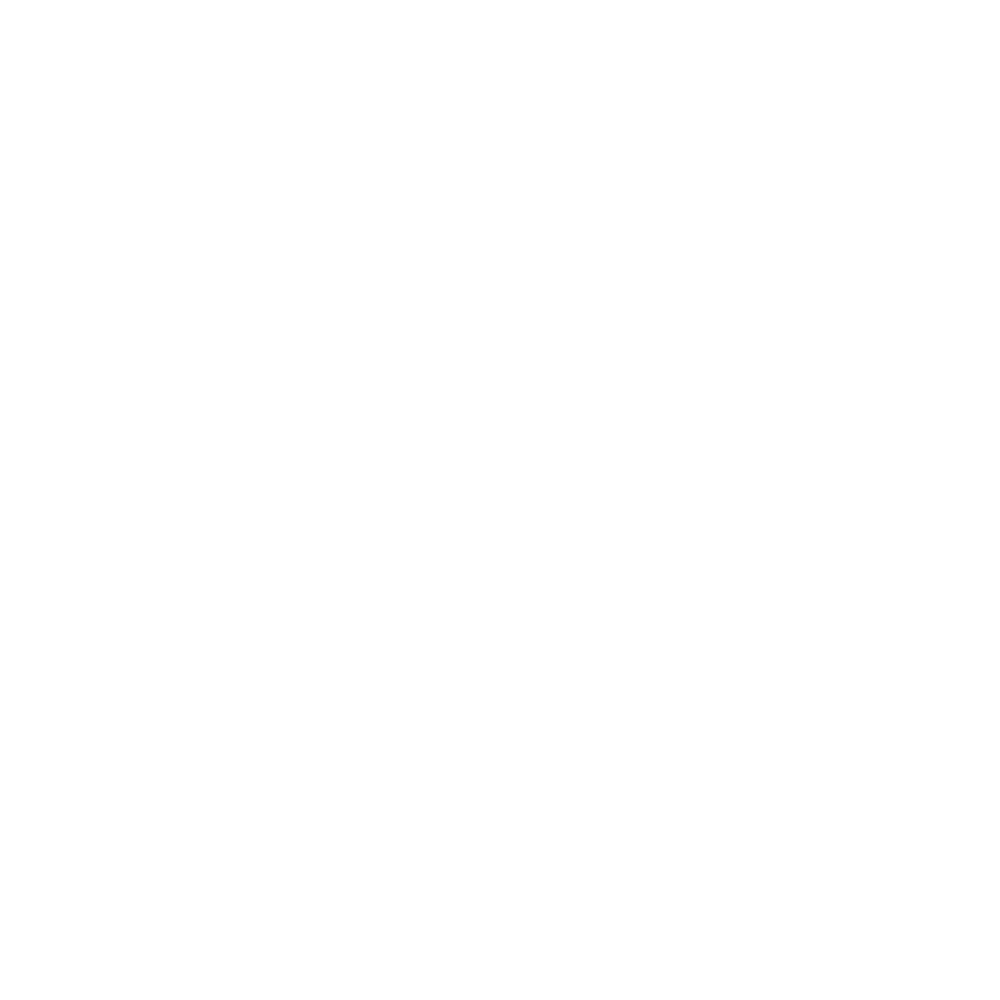

i, sweeptime =  2017-09-10 15:33:22


<IPython.core.display.Javascript object>


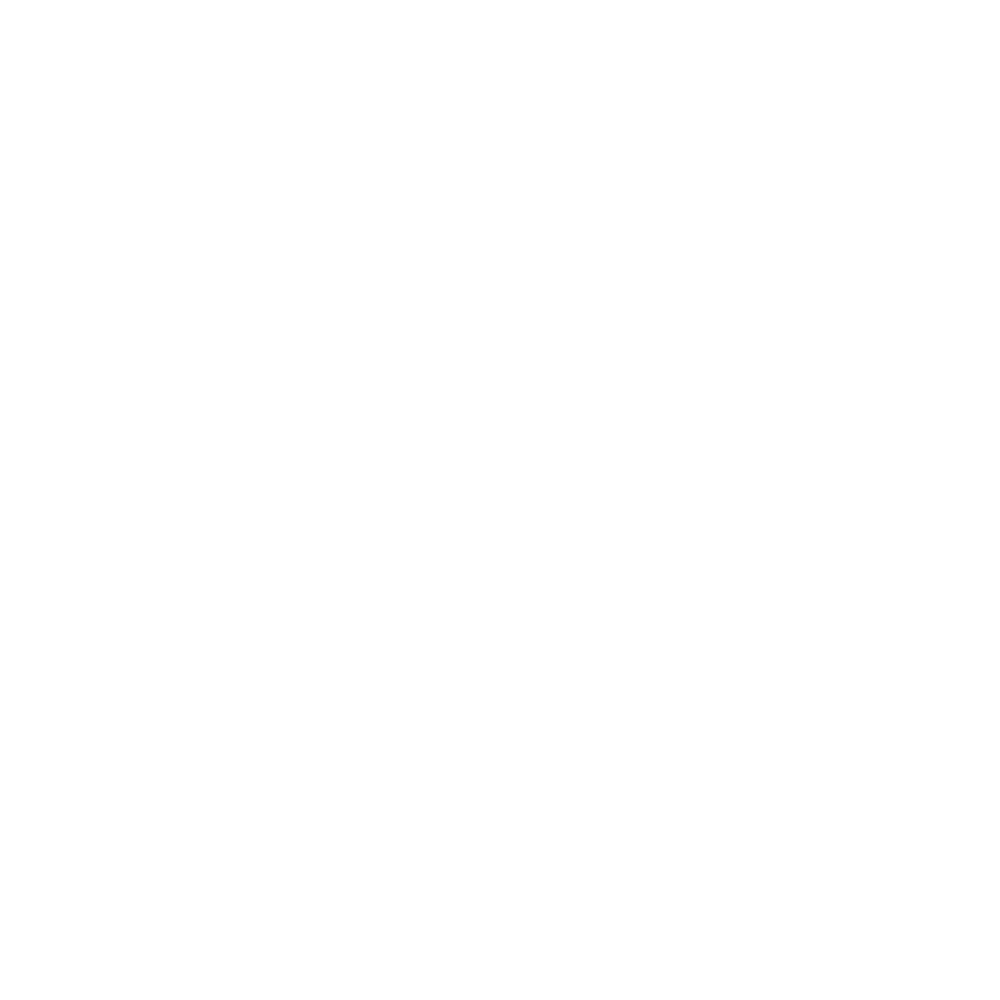

i, sweeptime =  2017-09-10 15:39:46


<IPython.core.display.Javascript object>


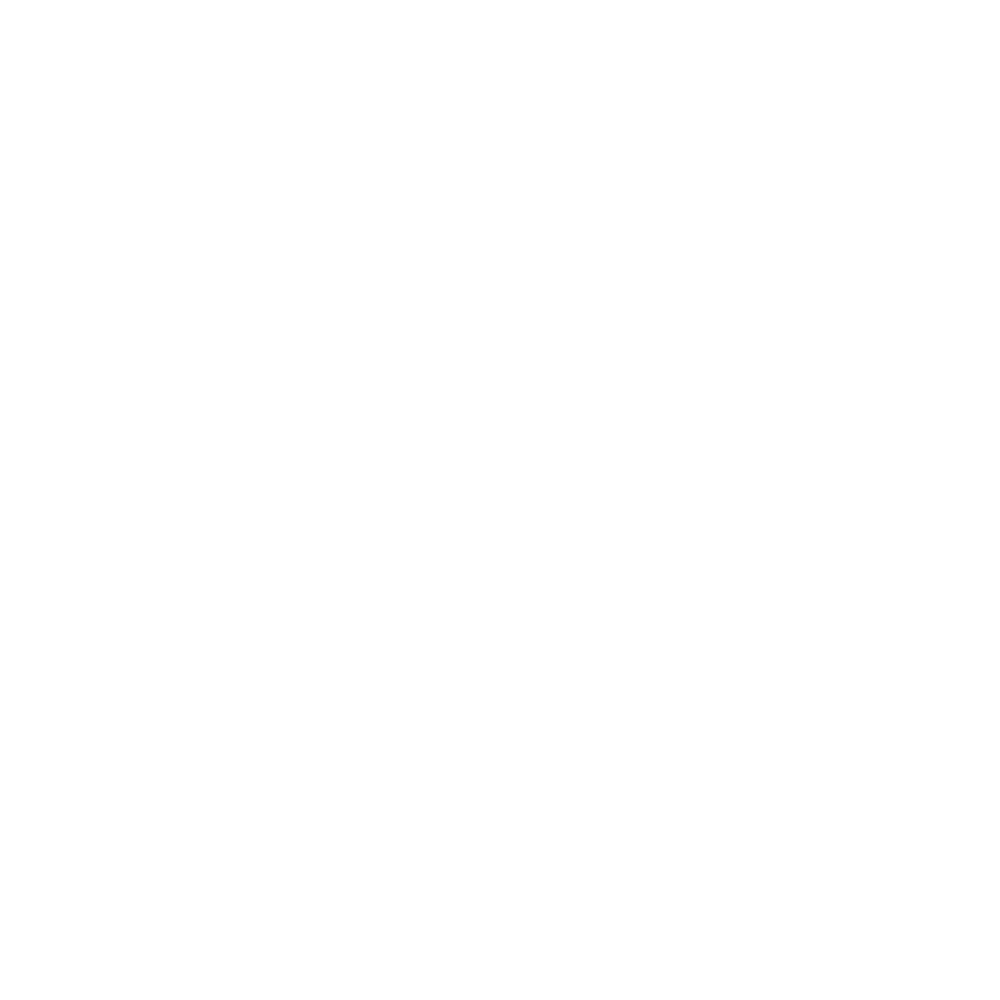

i, sweeptime =  2017-09-10 15:46:17


<IPython.core.display.Javascript object>


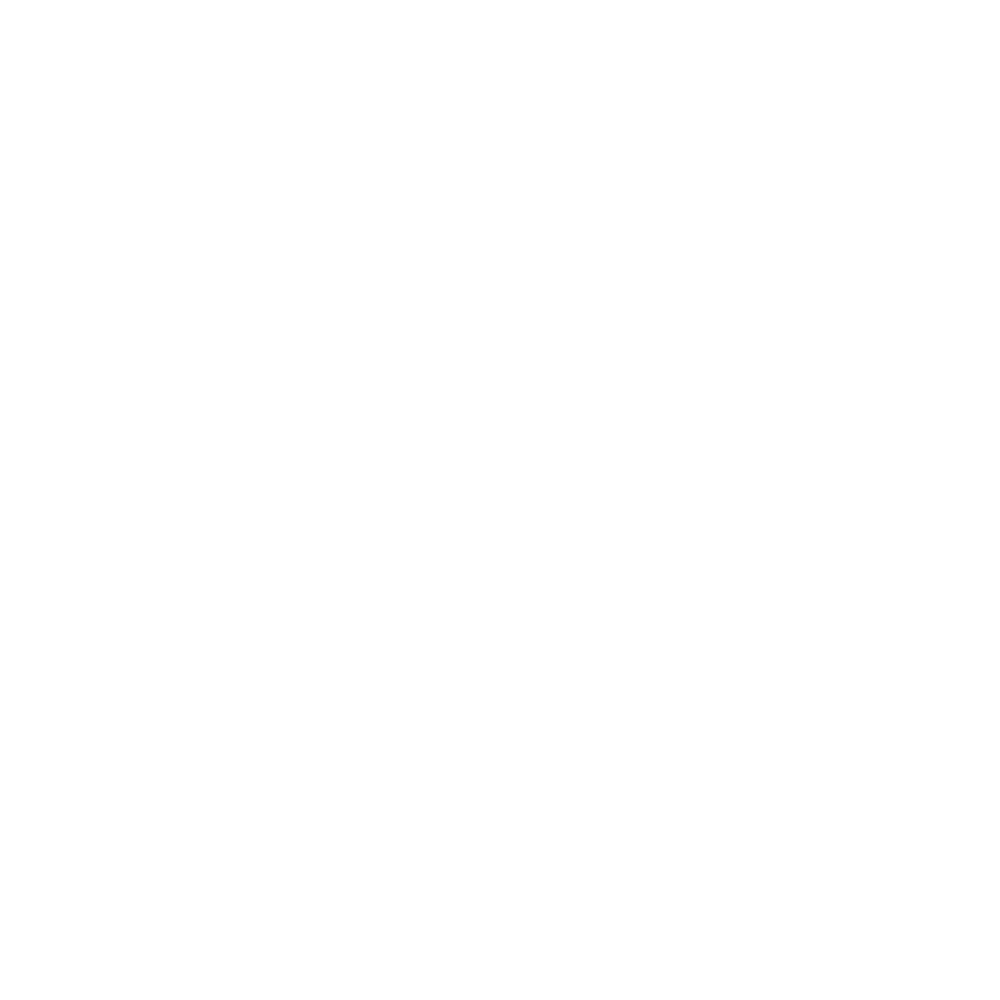

i, sweeptime =  2017-09-10 15:52:47


<IPython.core.display.Javascript object>


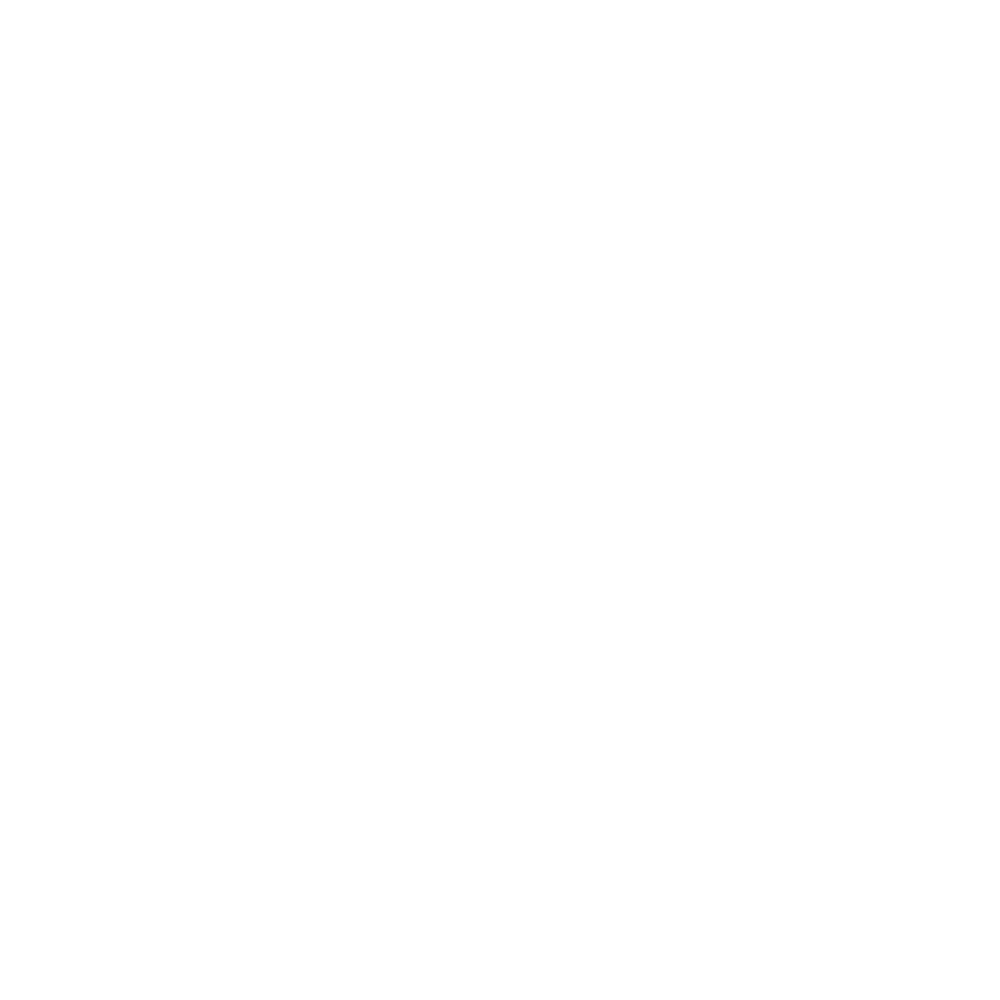

i, sweeptime =  2017-09-10 15:57:27


<IPython.core.display.Javascript object>


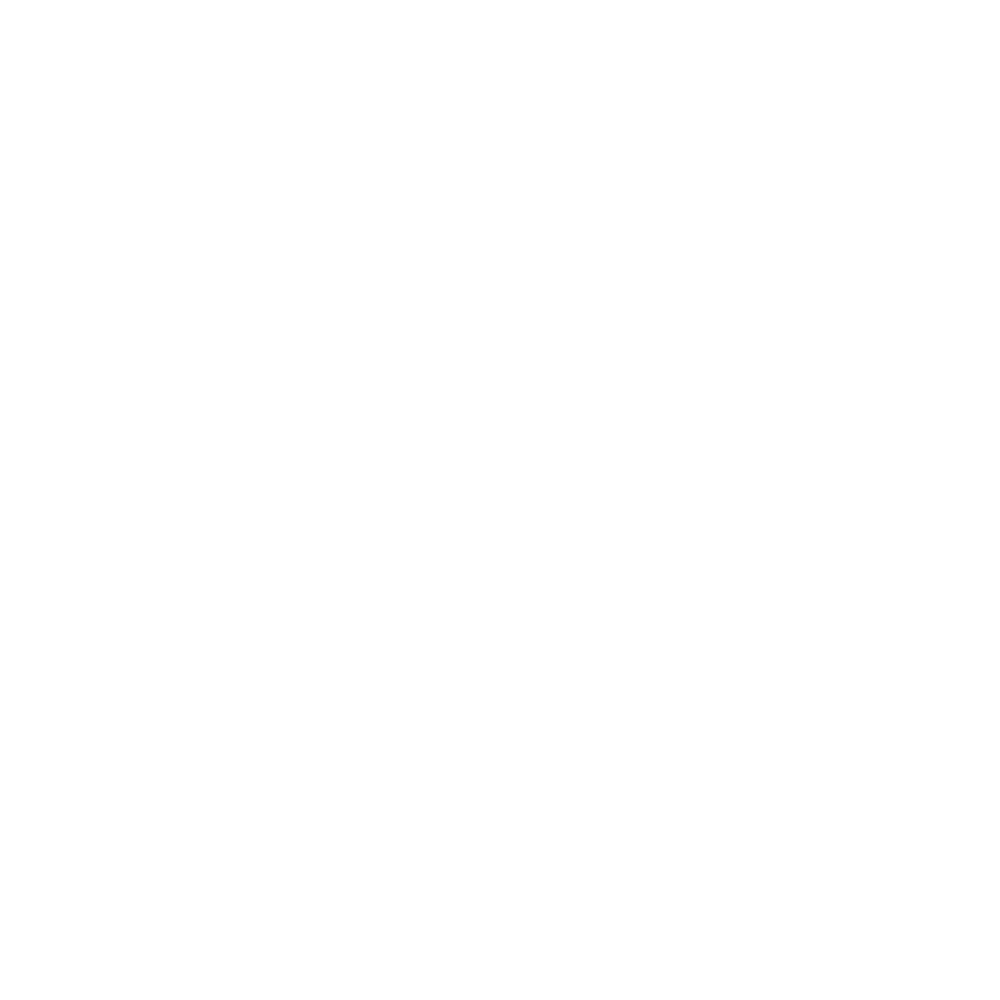

i, sweeptime =  2017-09-10 16:03:53


<IPython.core.display.Javascript object>


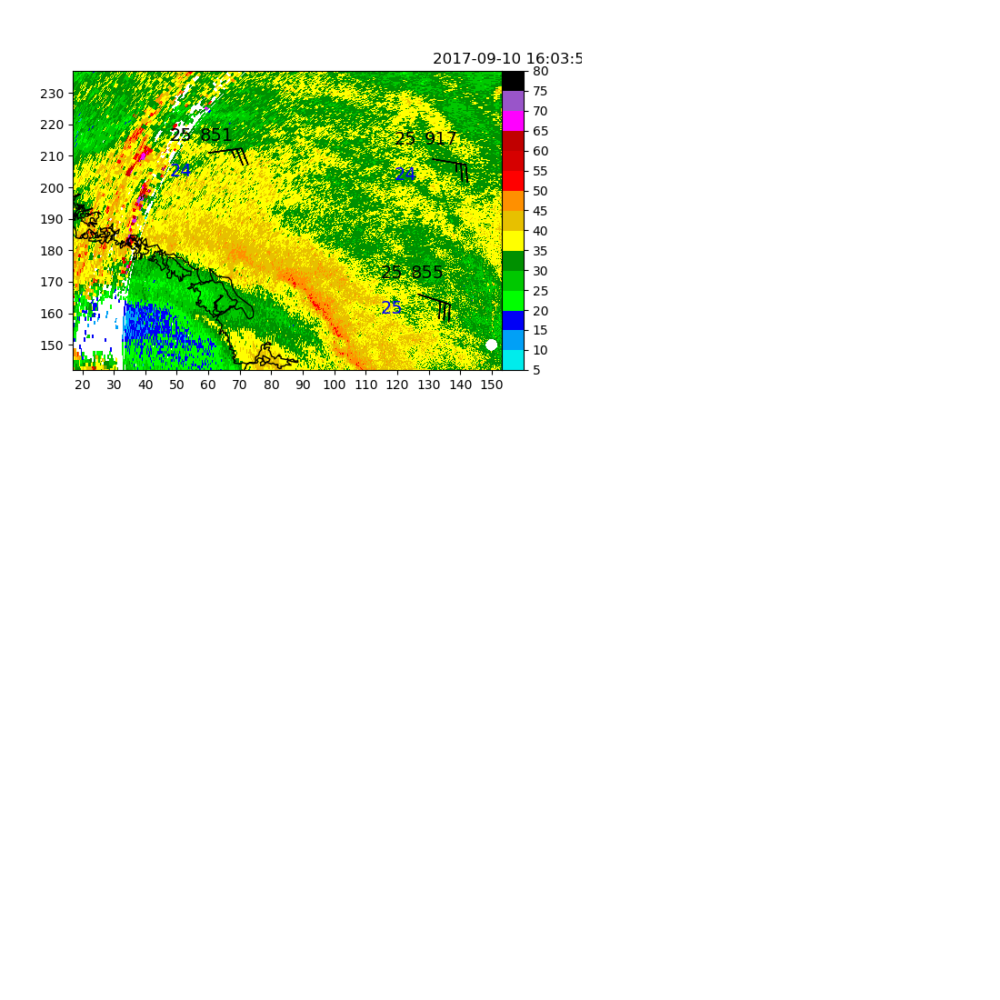

i, sweeptime =  2017-09-10 16:10:19


<IPython.core.display.Javascript object>


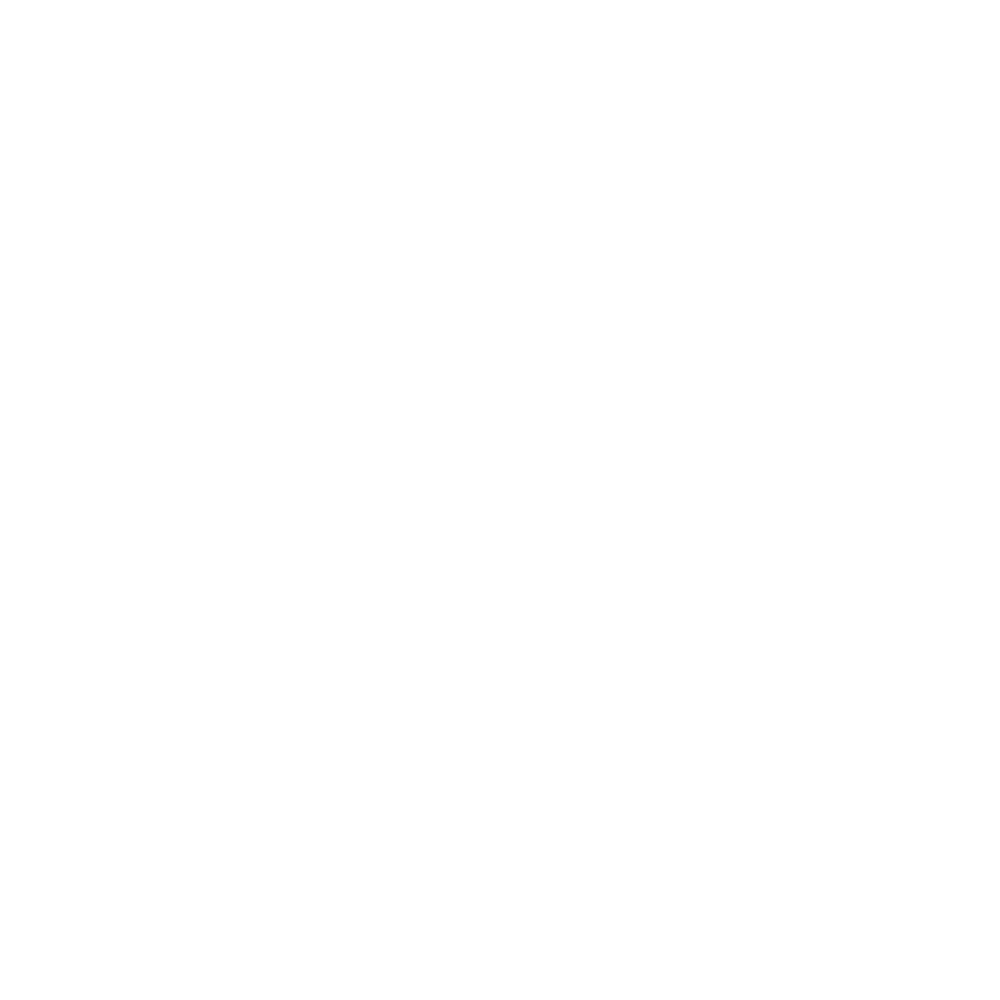

i, sweeptime =  2017-09-10 16:16:50


<IPython.core.display.Javascript object>


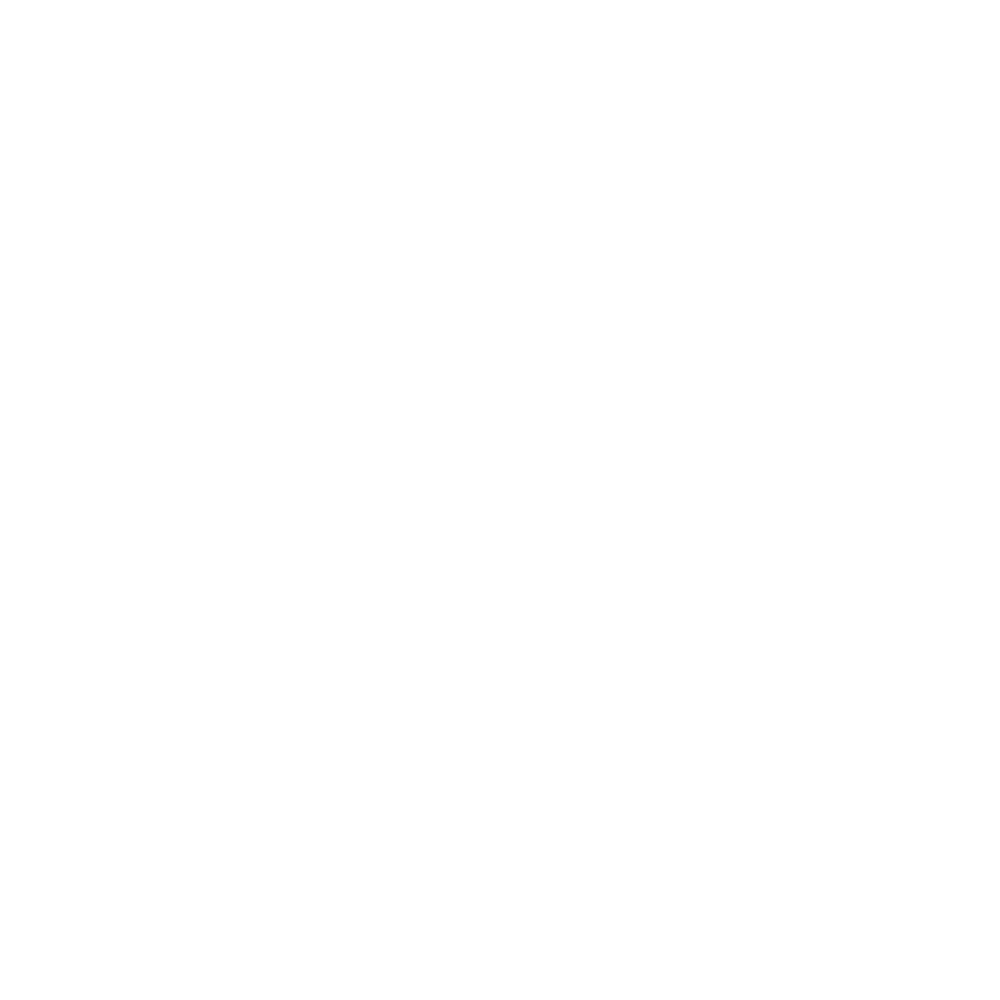

i, sweeptime =  2017-09-10 16:23:22


<IPython.core.display.Javascript object>


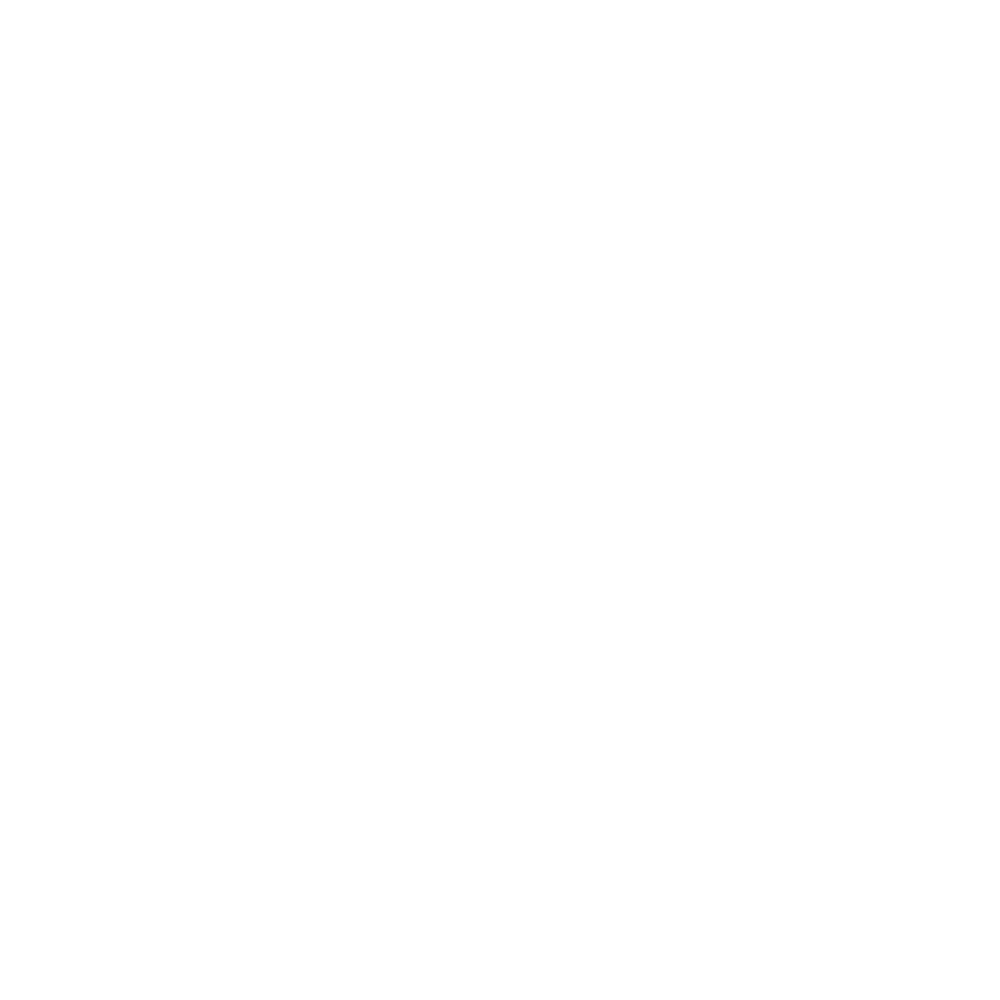

i, sweeptime =  2017-09-10 16:32:44


<IPython.core.display.Javascript object>


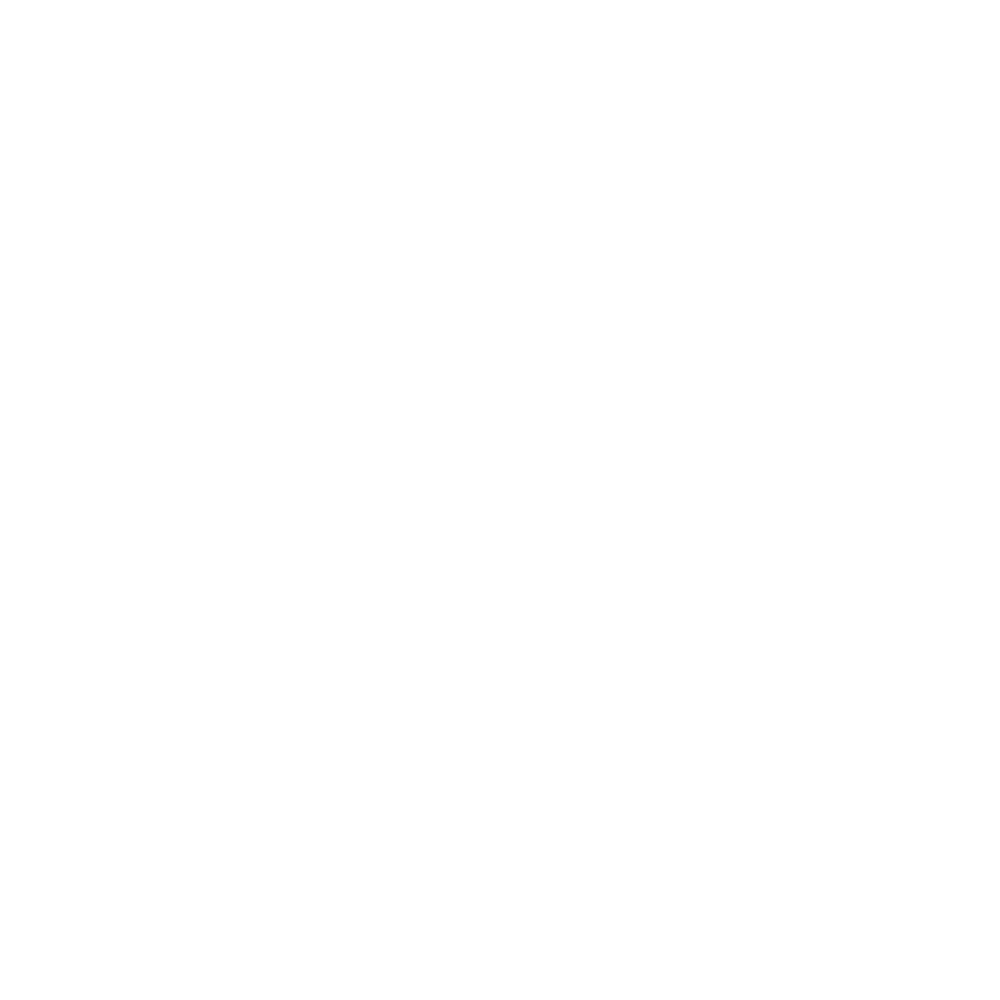

i, sweeptime =  2017-09-10 16:35:15


<IPython.core.display.Javascript object>


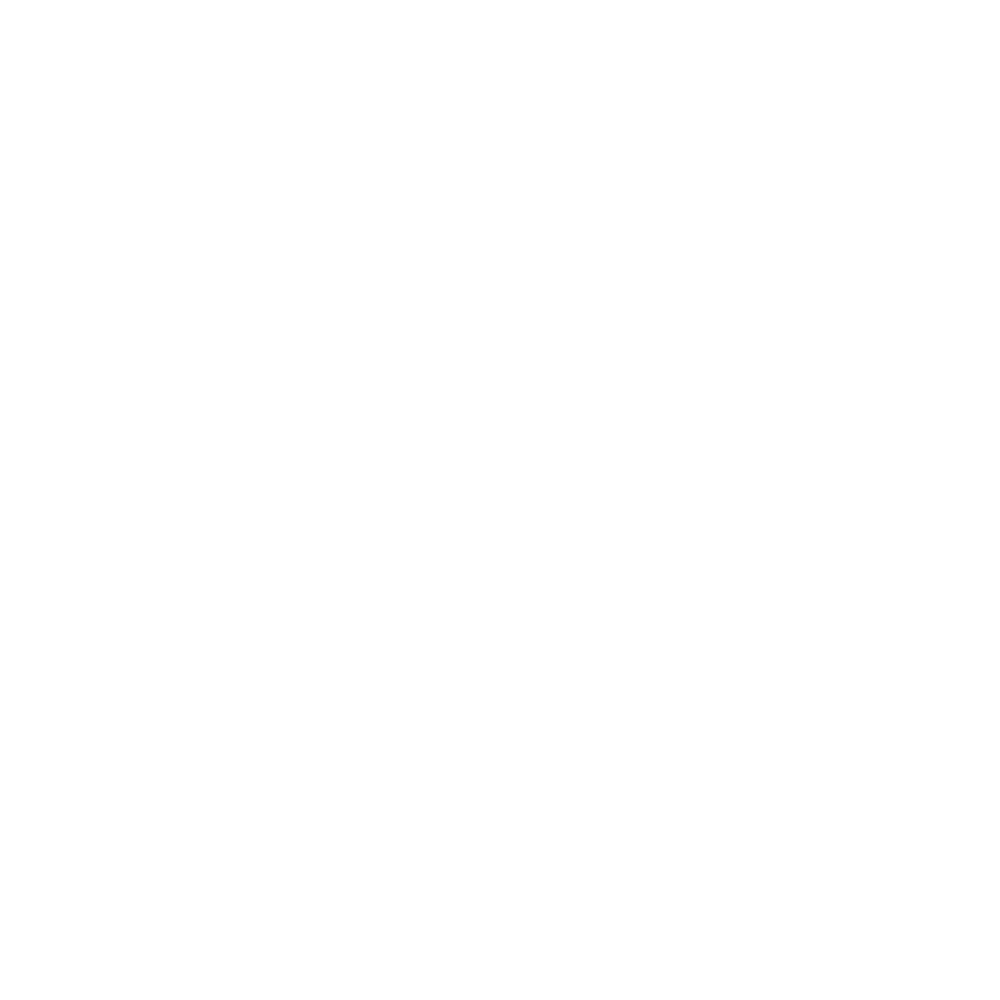

i, sweeptime =  2017-09-10 16:50:06


<IPython.core.display.Javascript object>


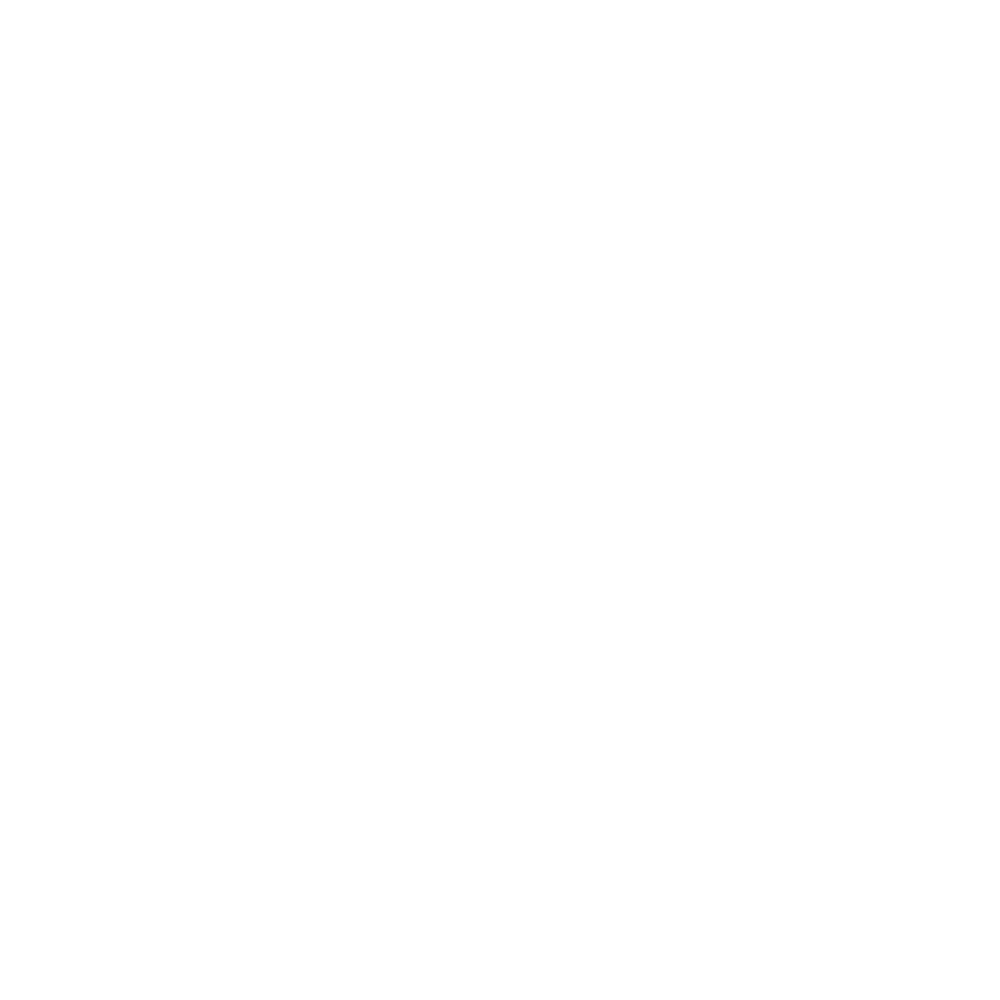

i, sweeptime =  2017-09-10 16:56:48


<IPython.core.display.Javascript object>


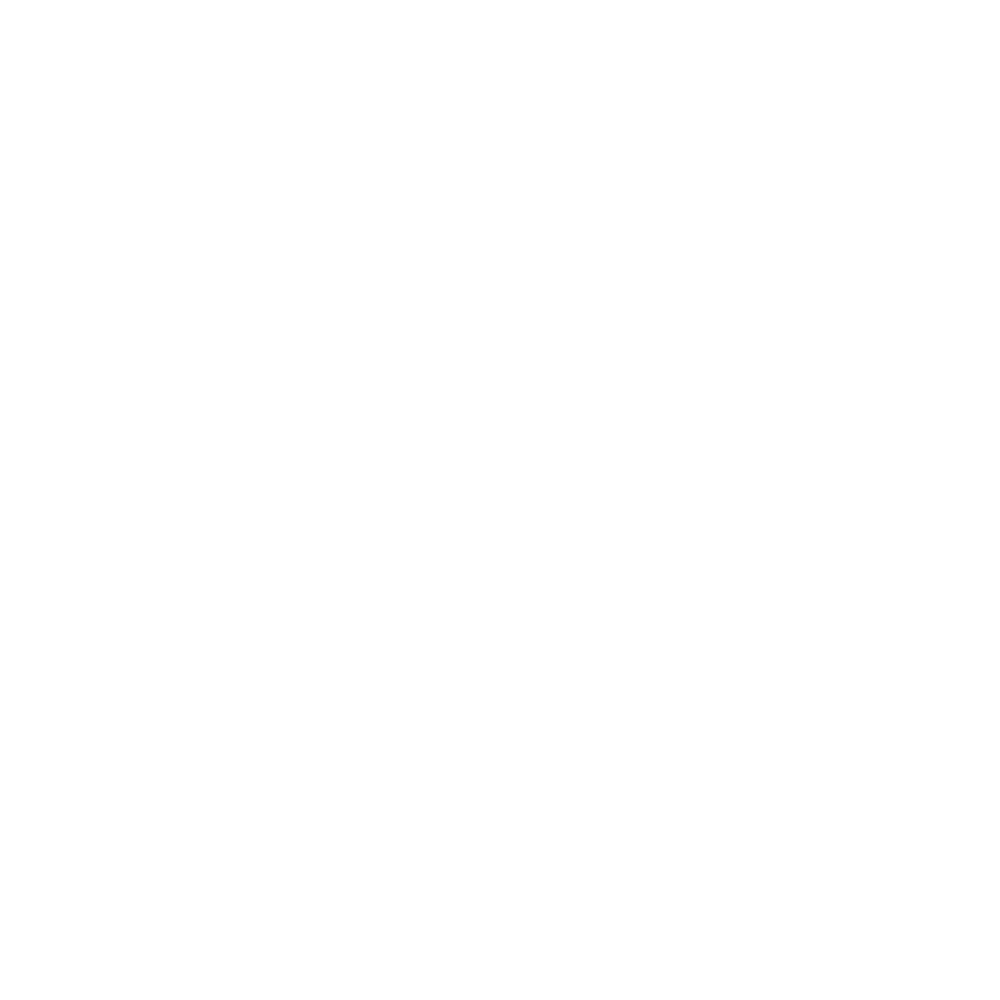

i, sweeptime =  2017-09-10 17:03:45


<IPython.core.display.Javascript object>


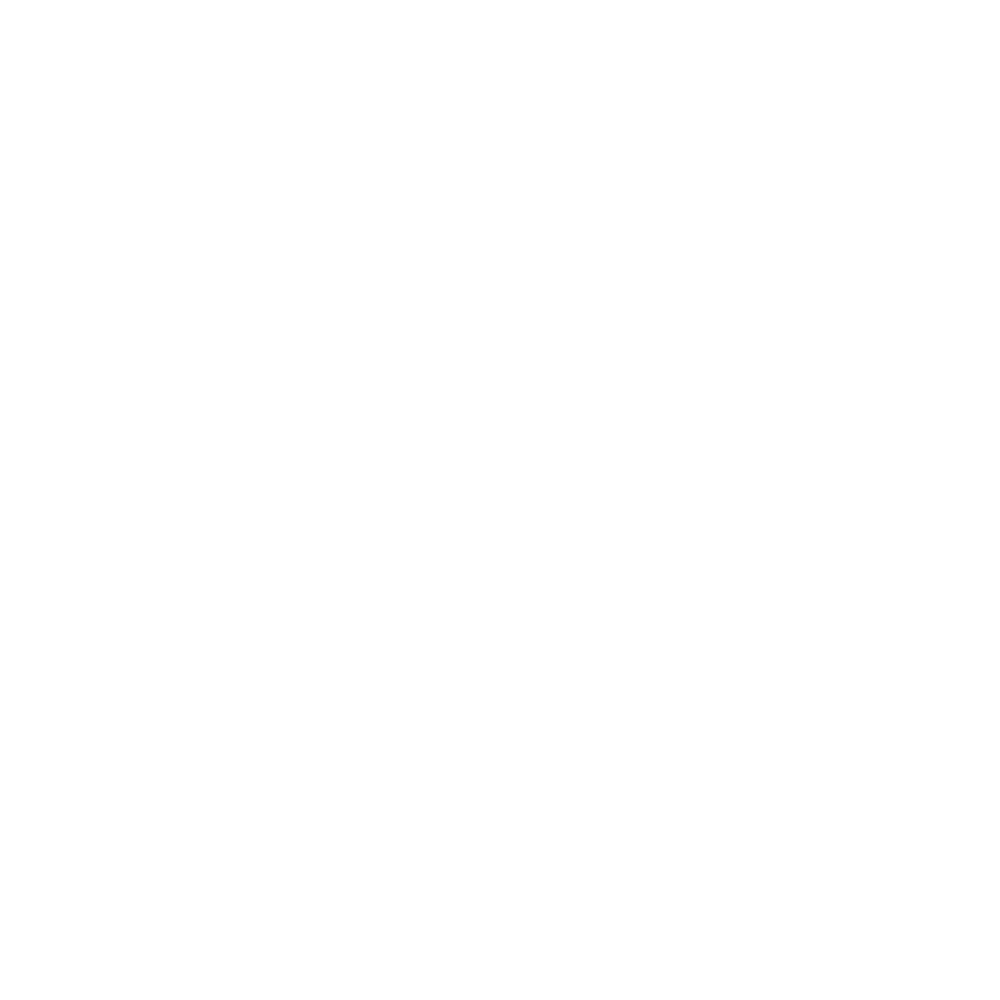

i, sweeptime =  2017-09-10 17:10:25


<IPython.core.display.Javascript object>


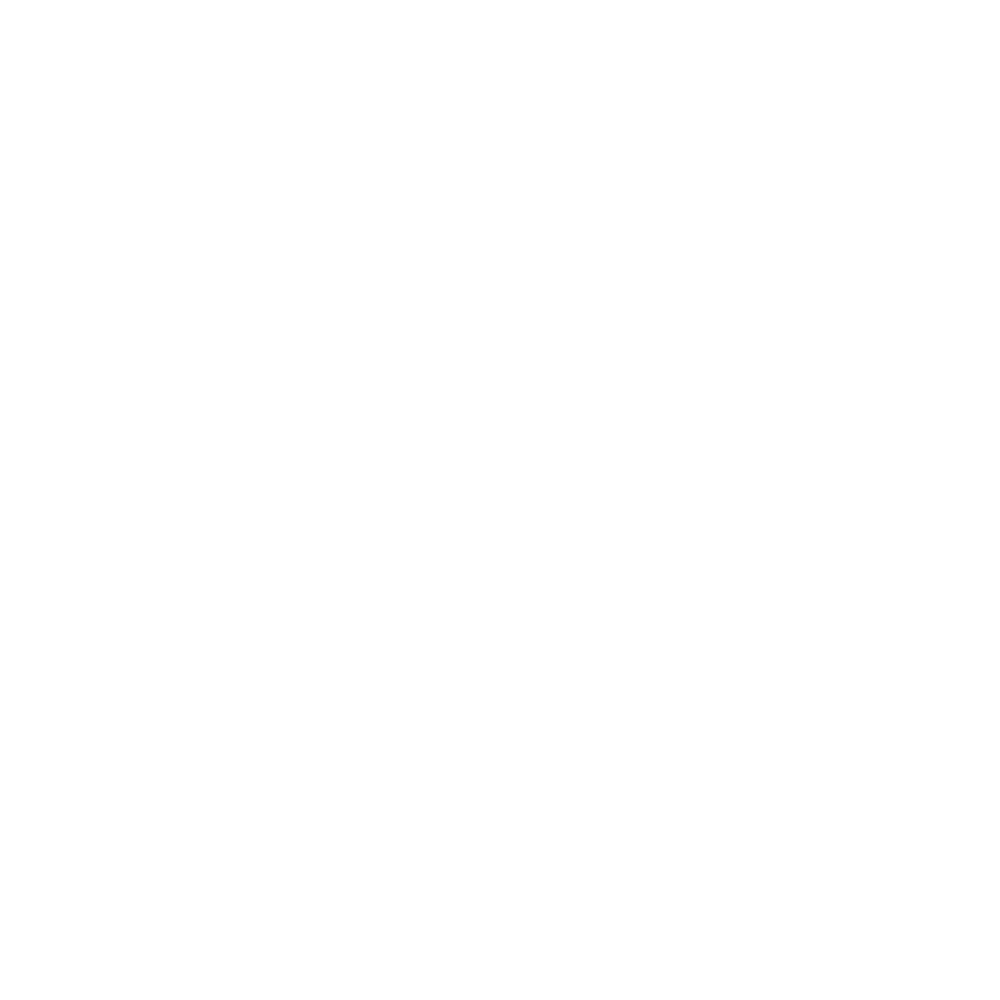

i, sweeptime =  2017-09-10 17:17:14


<IPython.core.display.Javascript object>


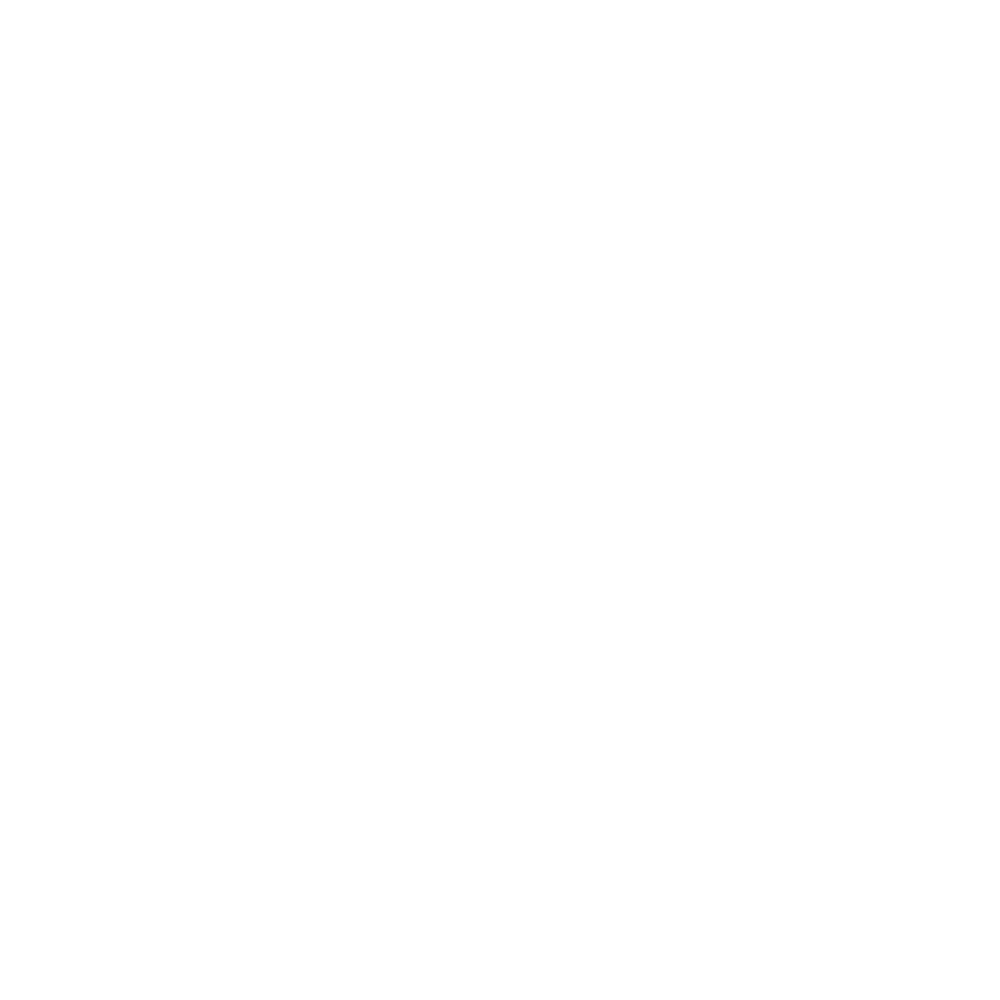

i, sweeptime =  2017-09-10 17:24:03


<IPython.core.display.Javascript object>


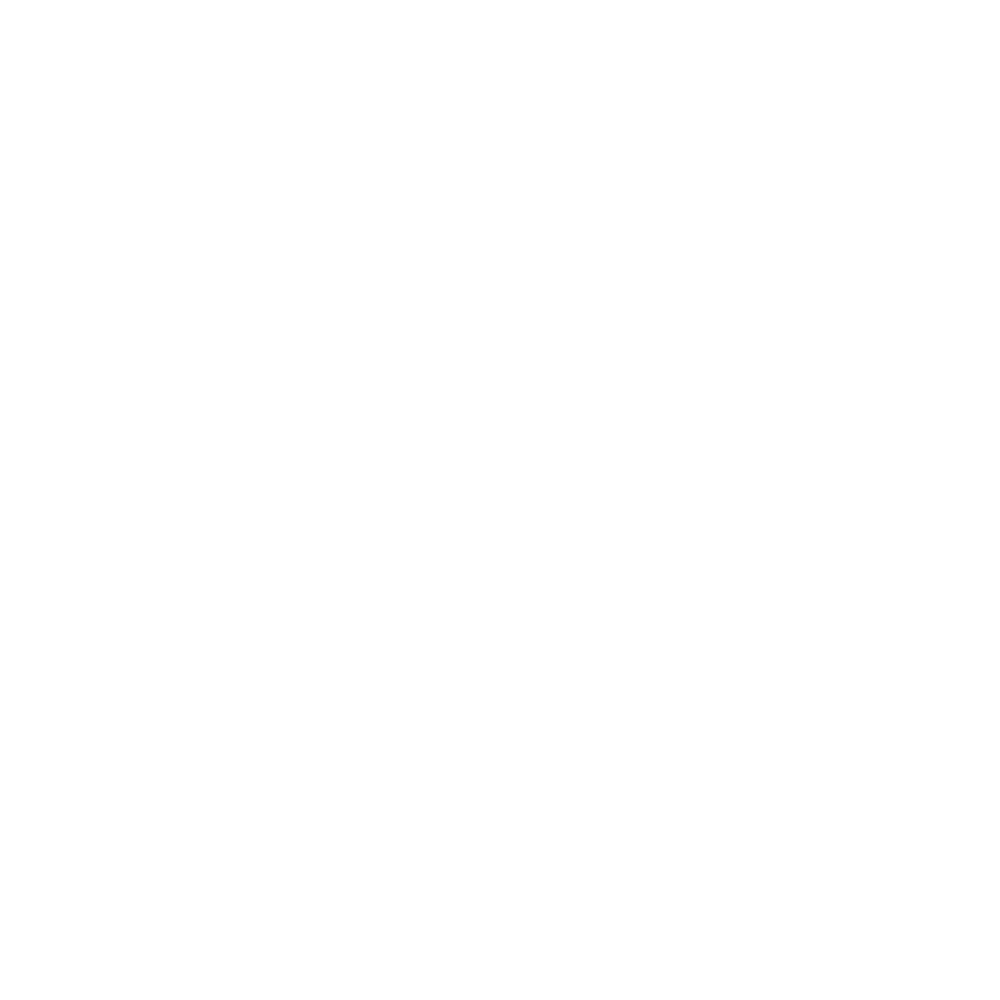

i, sweeptime =  2017-09-10 17:30:50


<IPython.core.display.Javascript object>


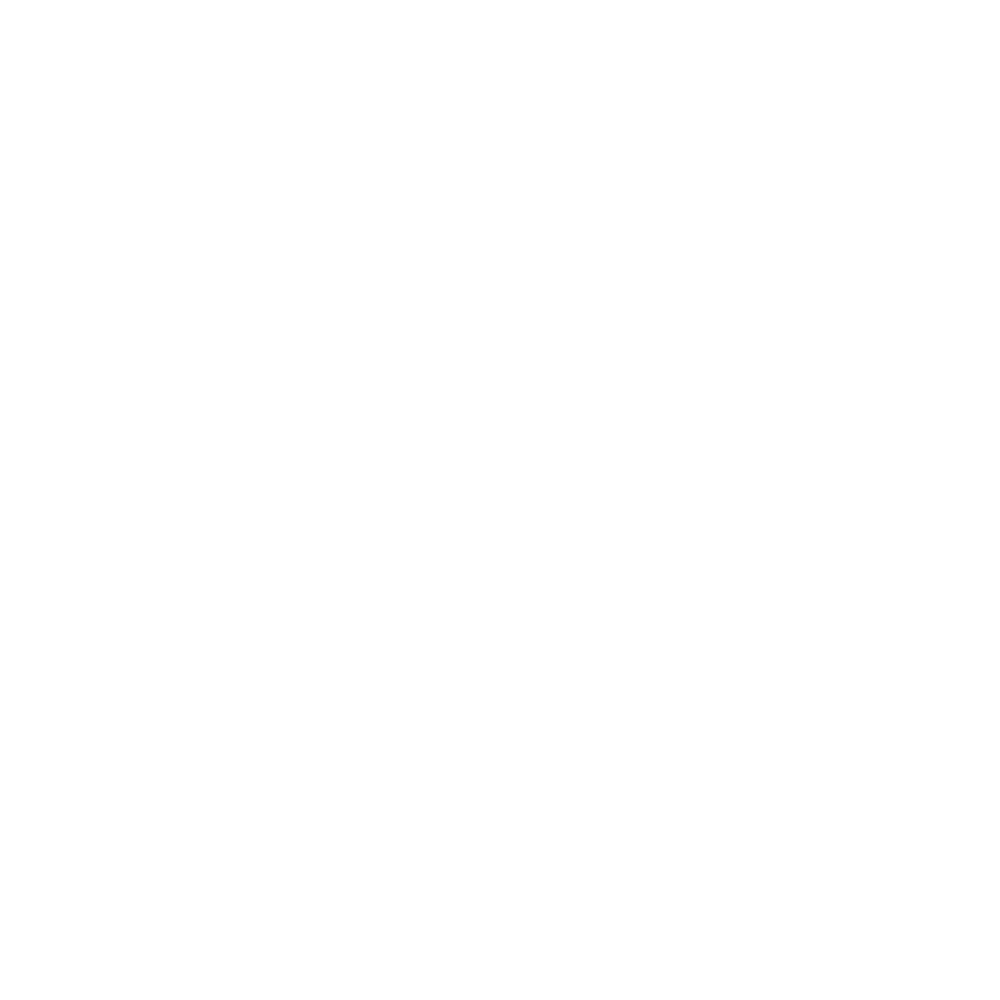

i, sweeptime =  2017-09-10 17:37:34


<IPython.core.display.Javascript object>


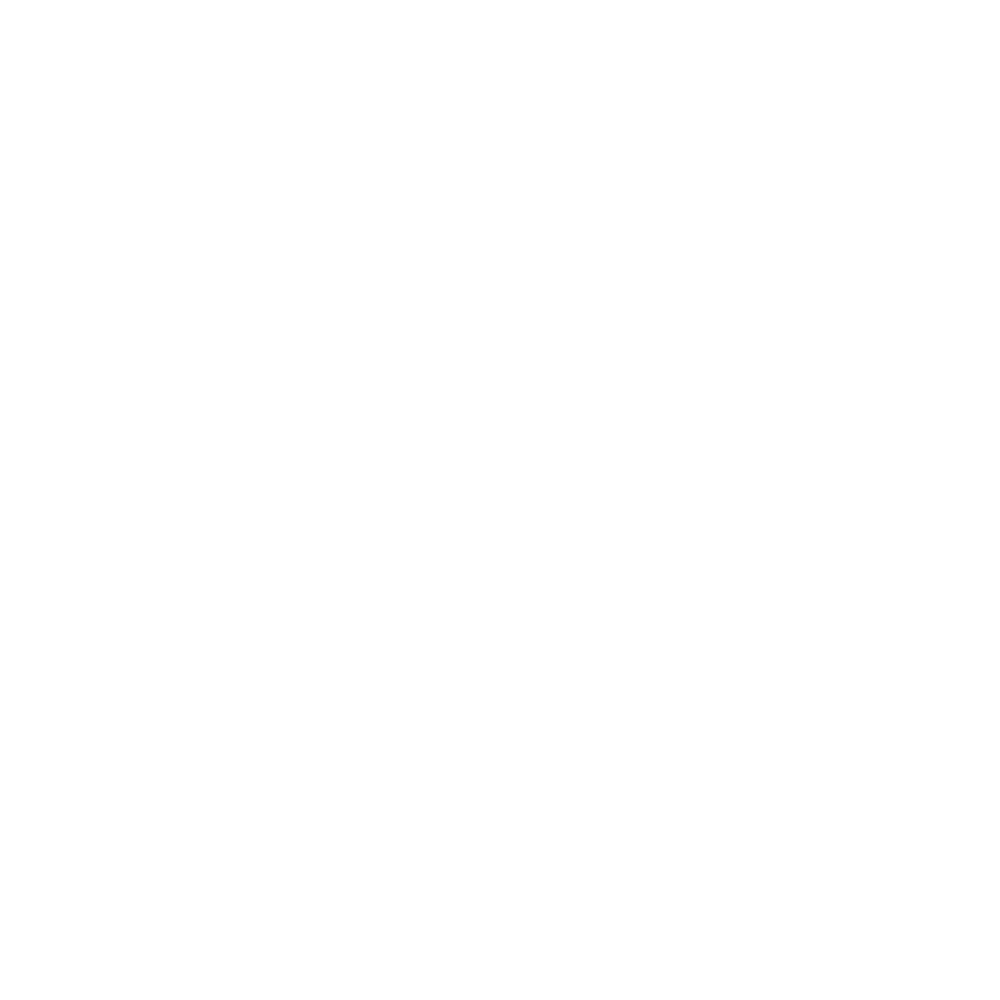

i, sweeptime =  2017-09-10 17:44:32


<IPython.core.display.Javascript object>


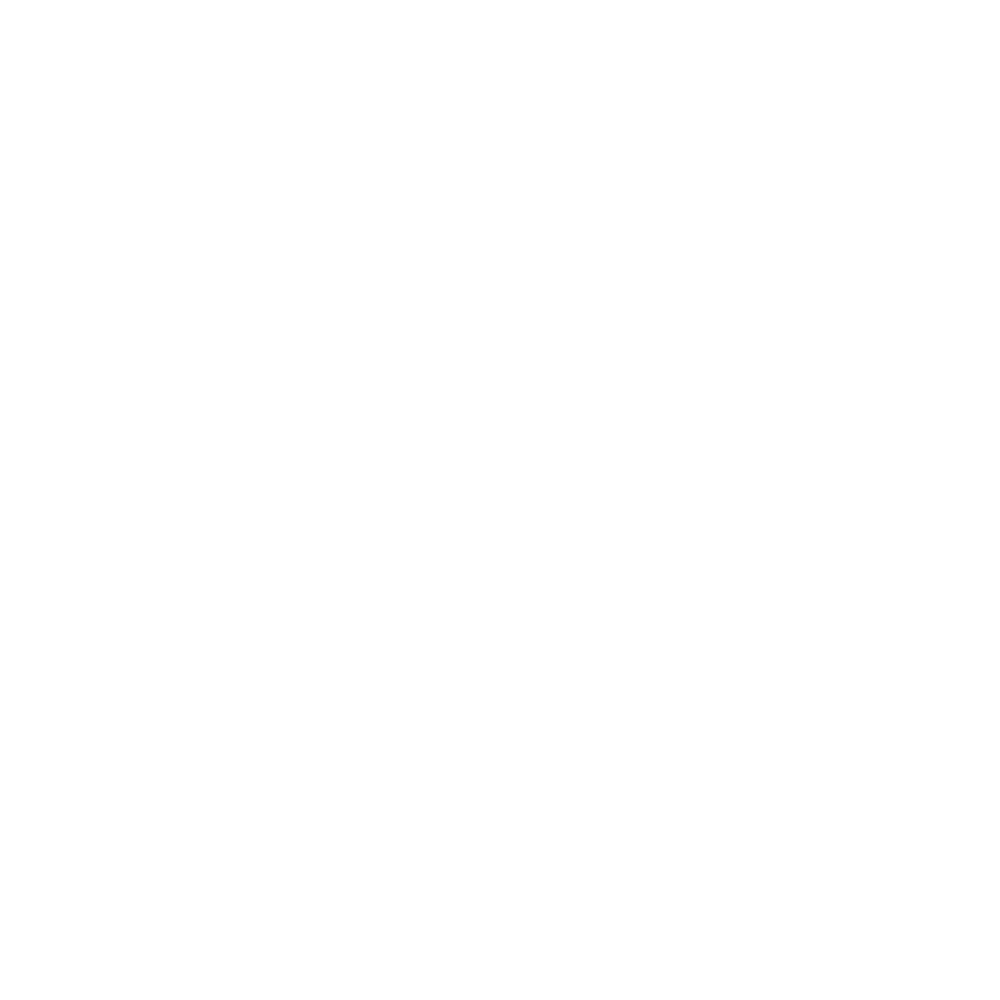

i, sweeptime =  2017-09-10 17:51:20


<IPython.core.display.Javascript object>


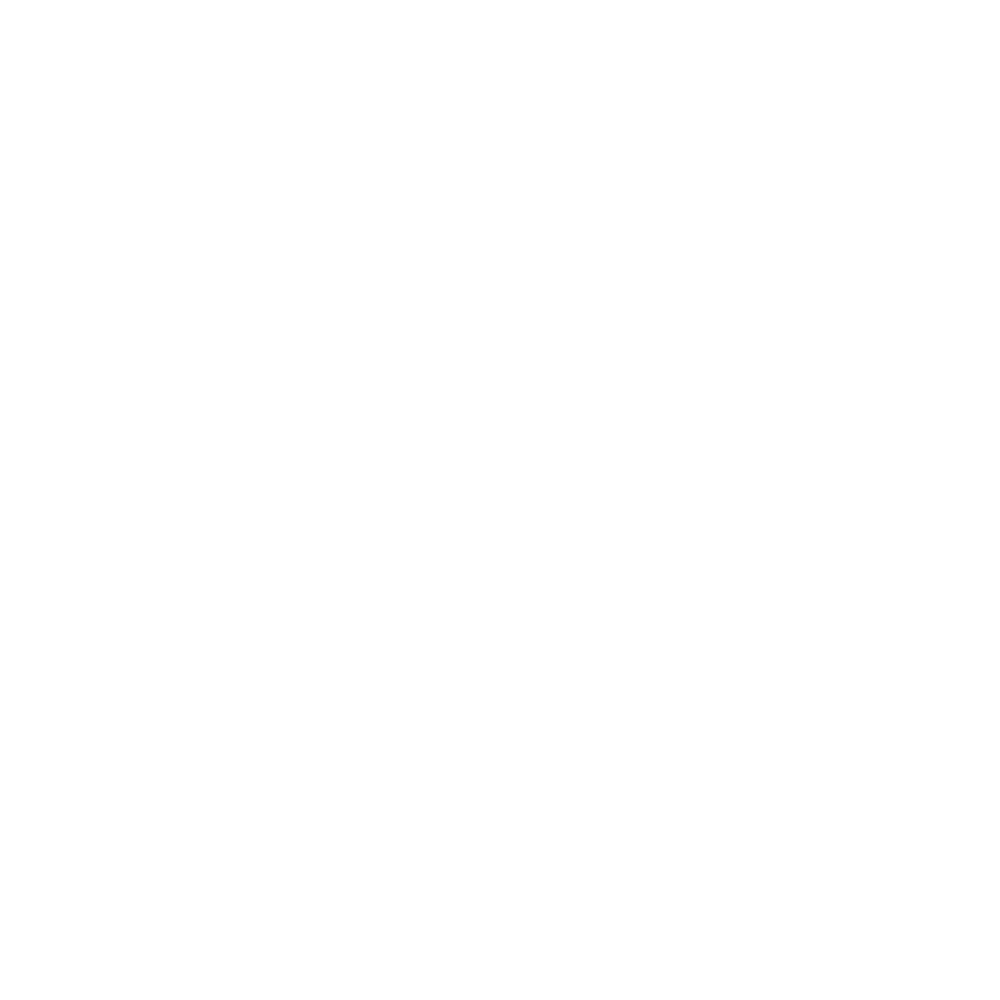

i, sweeptime =  2017-09-10 17:58:10


<IPython.core.display.Javascript object>


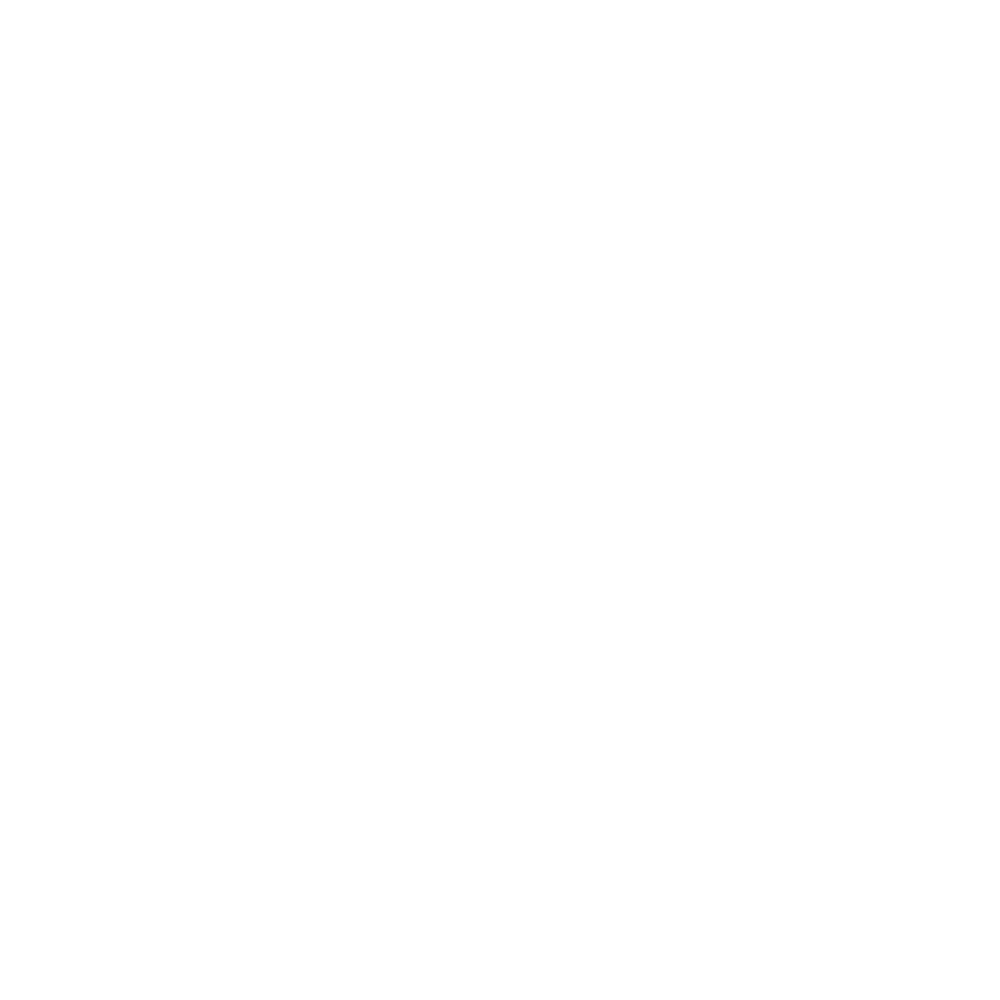

i, sweeptime =  2017-09-10 18:04:59


<IPython.core.display.Javascript object>


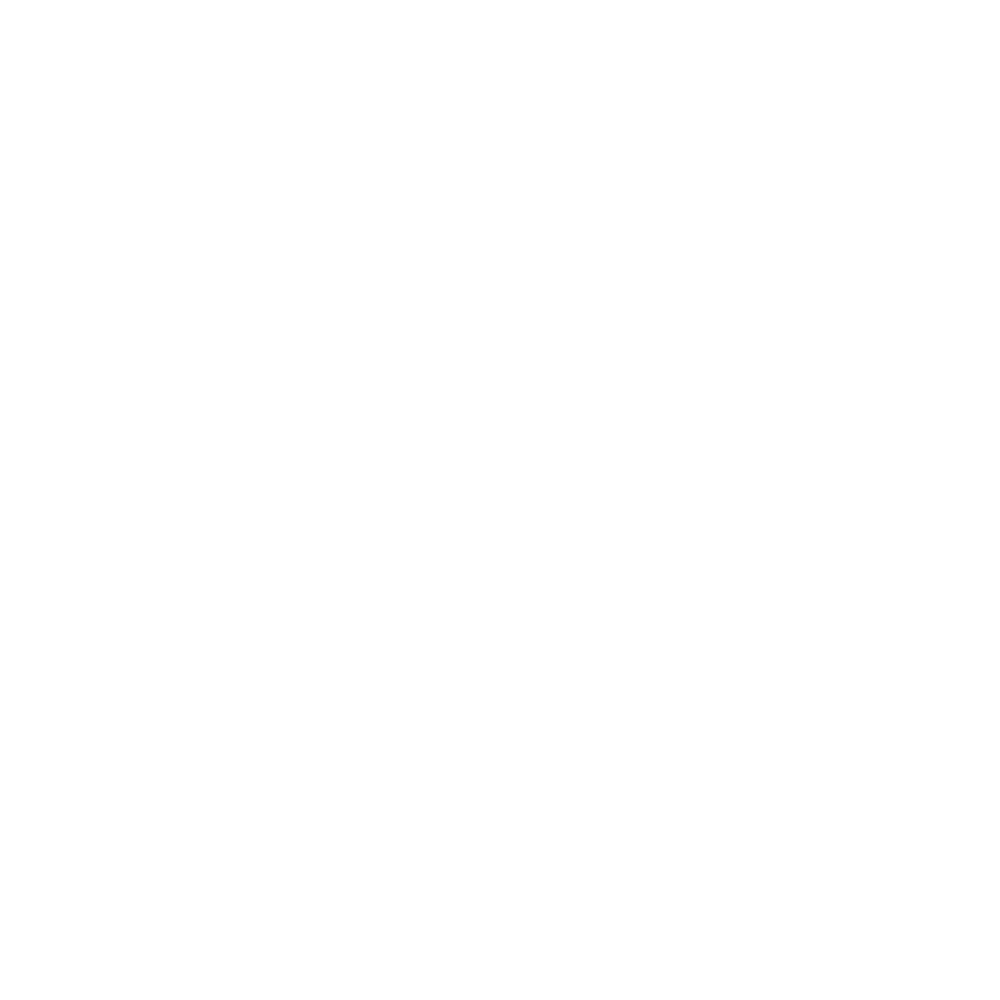

i, sweeptime =  2017-09-10 18:11:49


<IPython.core.display.Javascript object>


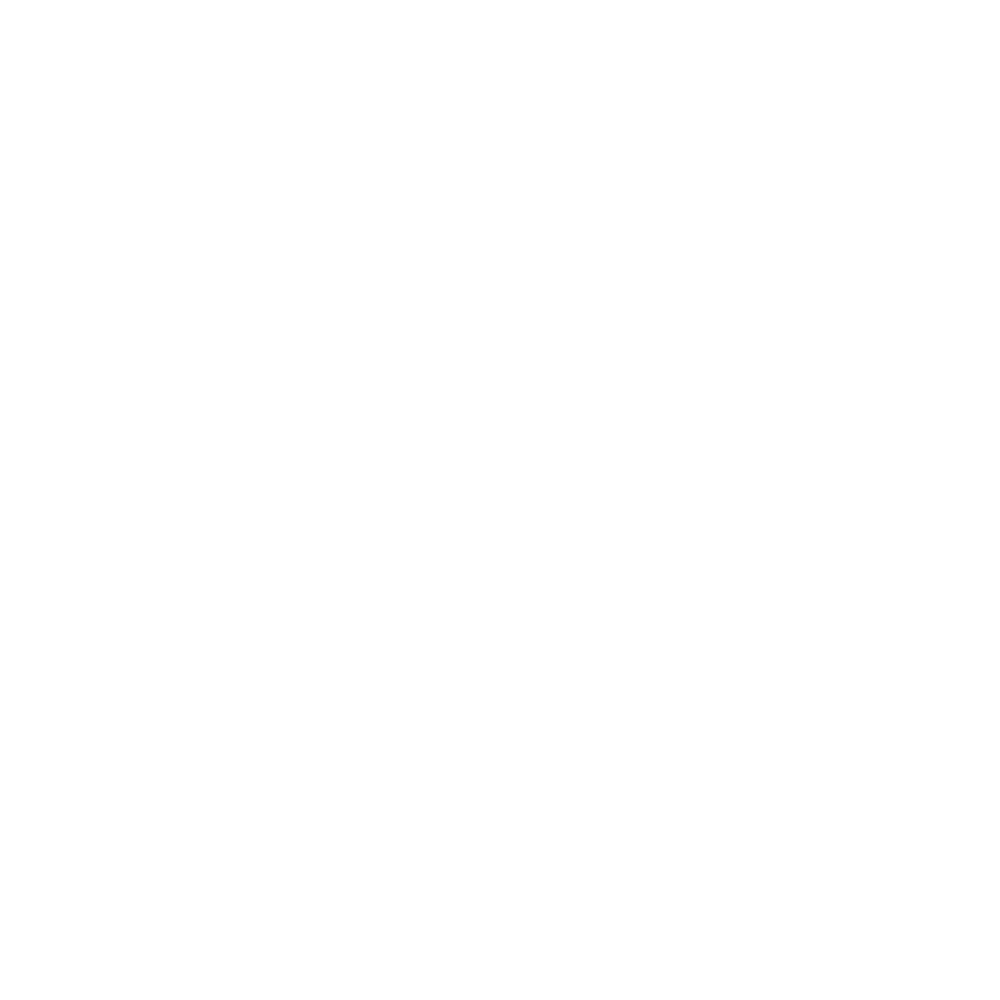

i, sweeptime =  2017-09-10 18:18:40


<IPython.core.display.Javascript object>


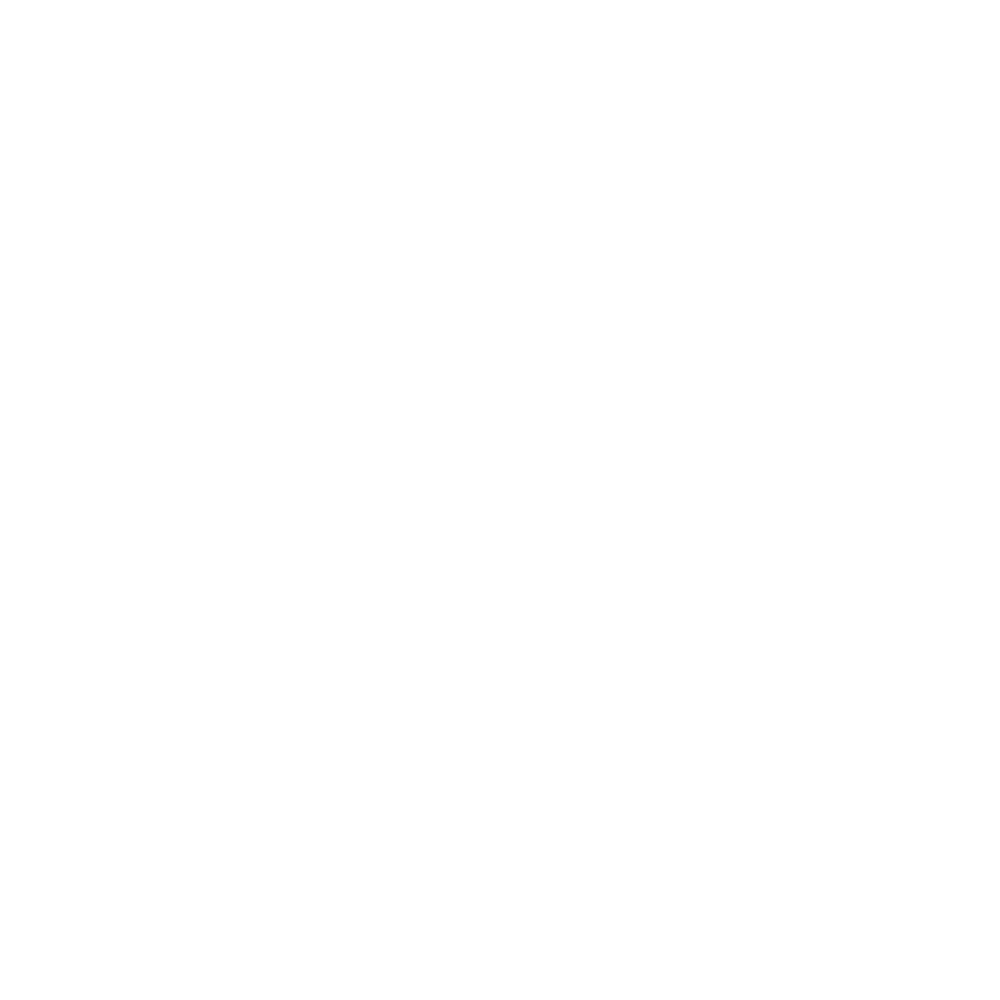

i, sweeptime =  2017-09-10 18:25:39


<IPython.core.display.Javascript object>


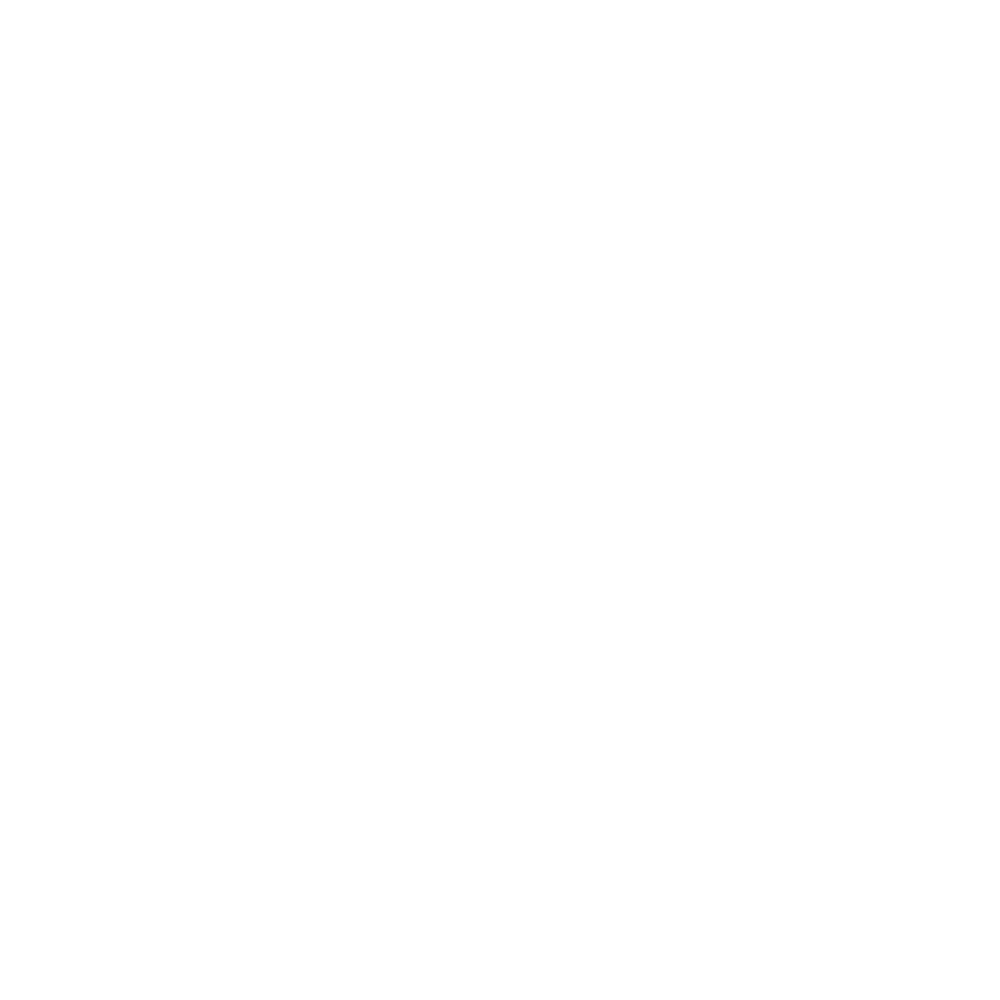

i, sweeptime =  2017-09-10 18:32:28


<IPython.core.display.Javascript object>


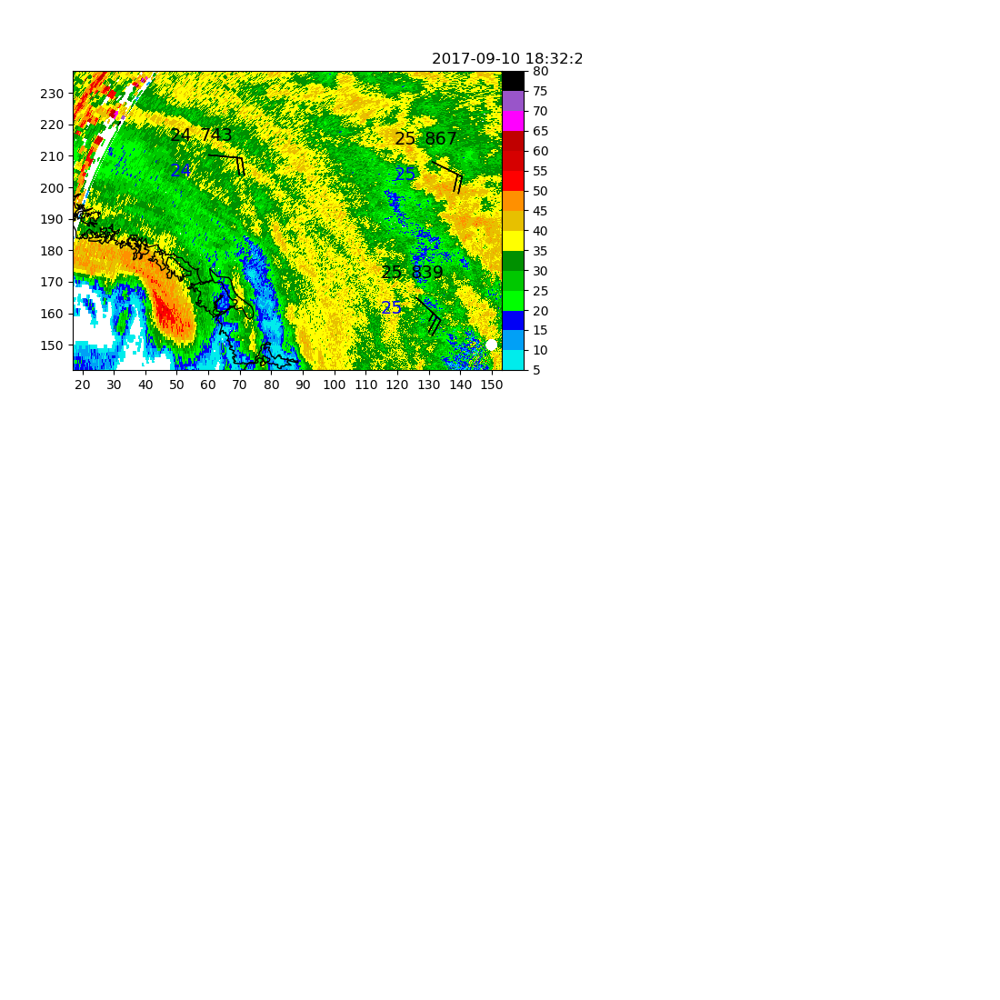

i, sweeptime =  2017-09-10 18:39:15


<IPython.core.display.Javascript object>


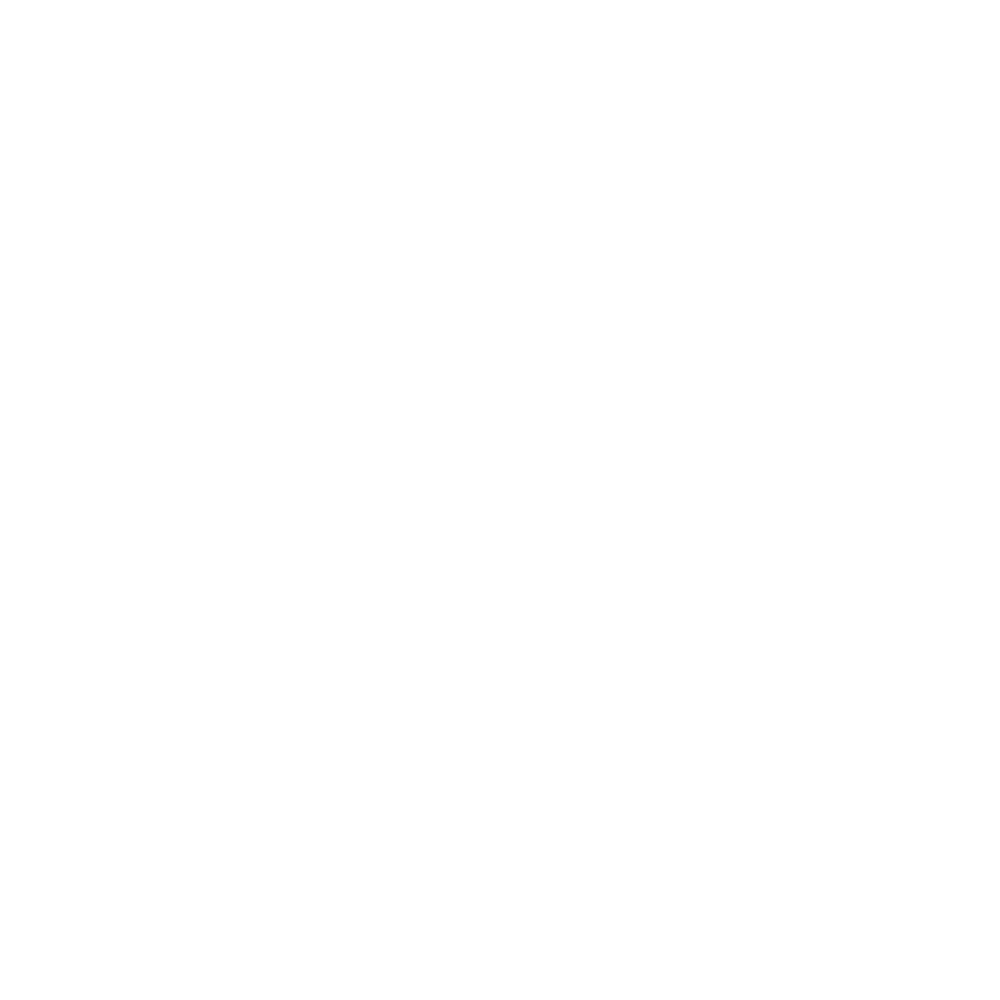

i, sweeptime =  2017-09-10 18:45:56


<IPython.core.display.Javascript object>


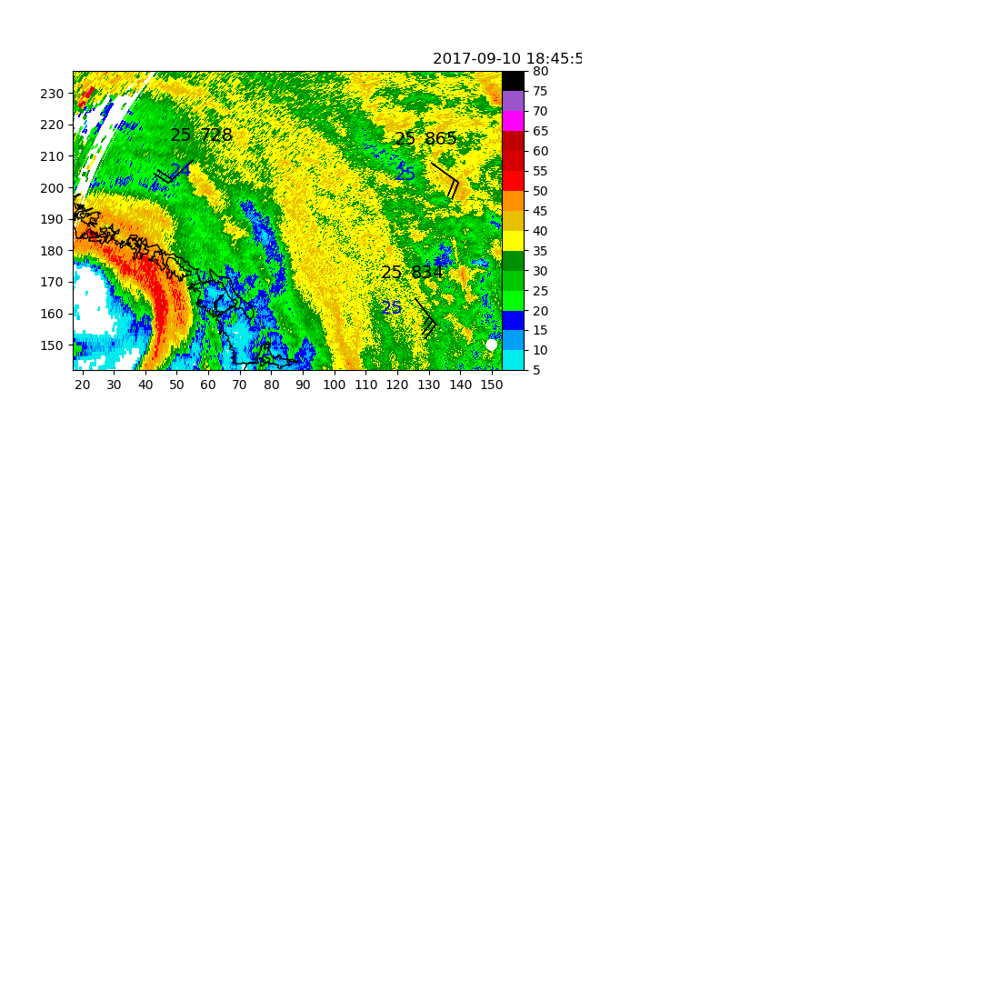

i, sweeptime =  2017-09-10 18:52:42


<IPython.core.display.Javascript object>


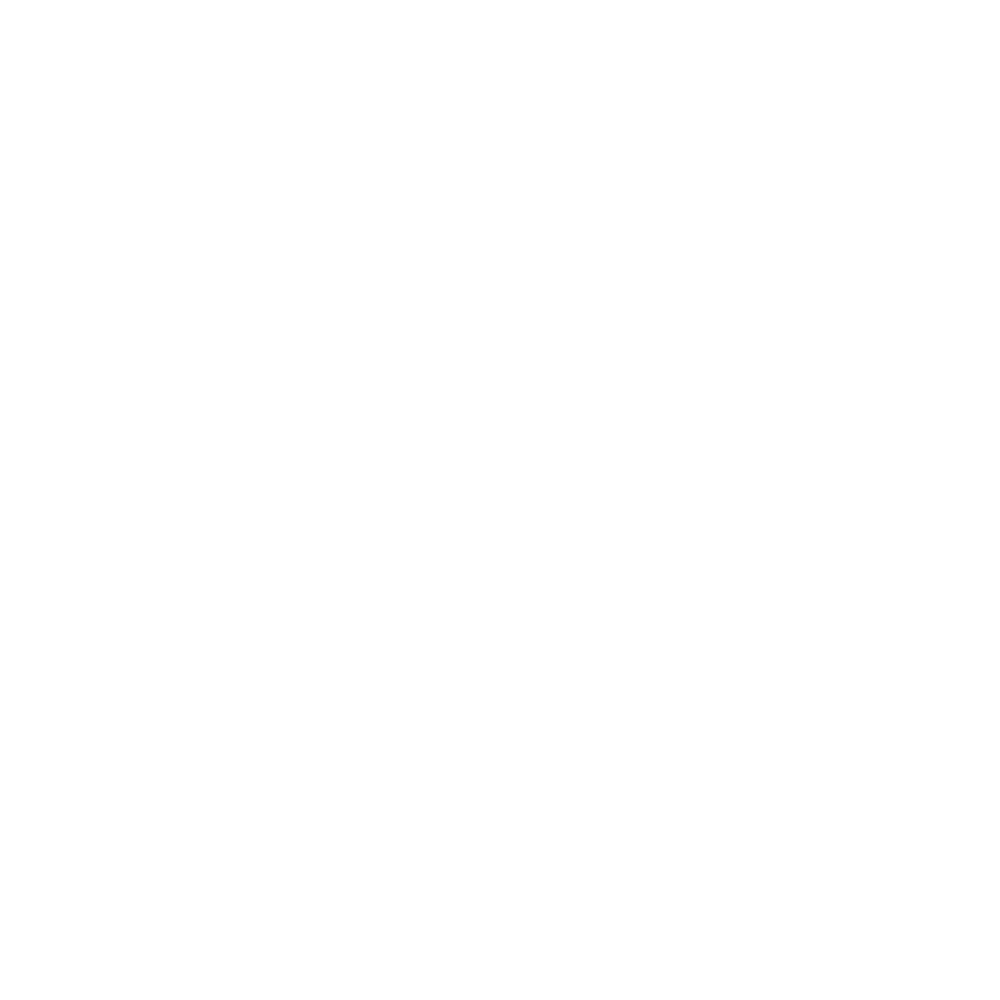

i, sweeptime =  2017-09-10 18:59:13


<IPython.core.display.Javascript object>


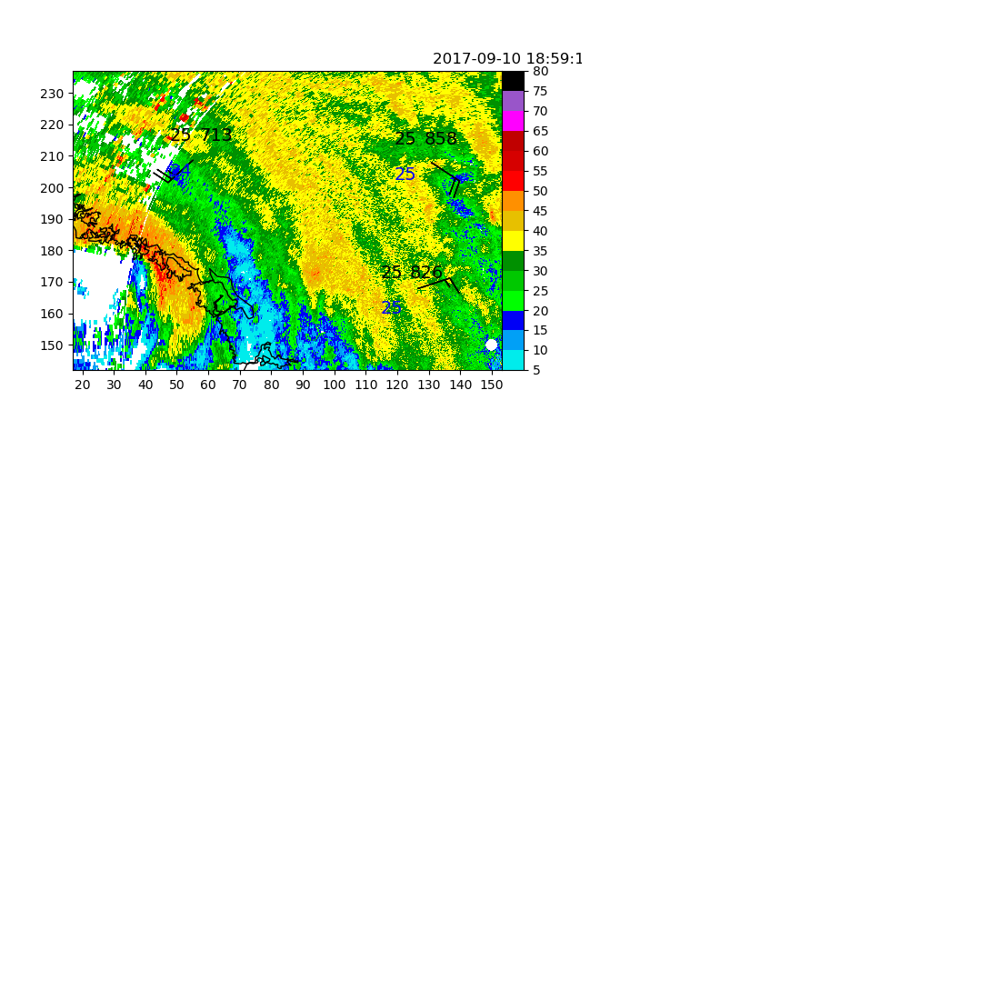

i, sweeptime =  2017-09-10 19:05:47


<IPython.core.display.Javascript object>


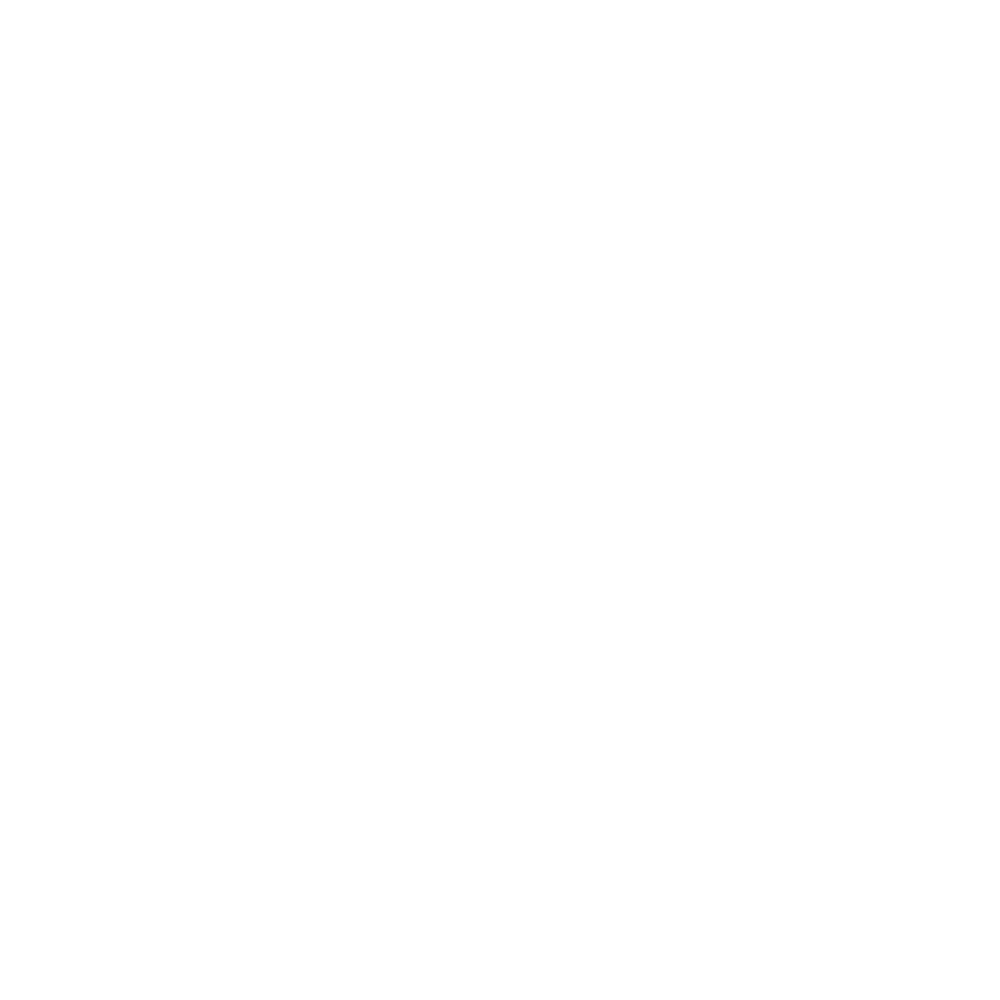

i, sweeptime =  2017-09-10 19:12:37


<IPython.core.display.Javascript object>


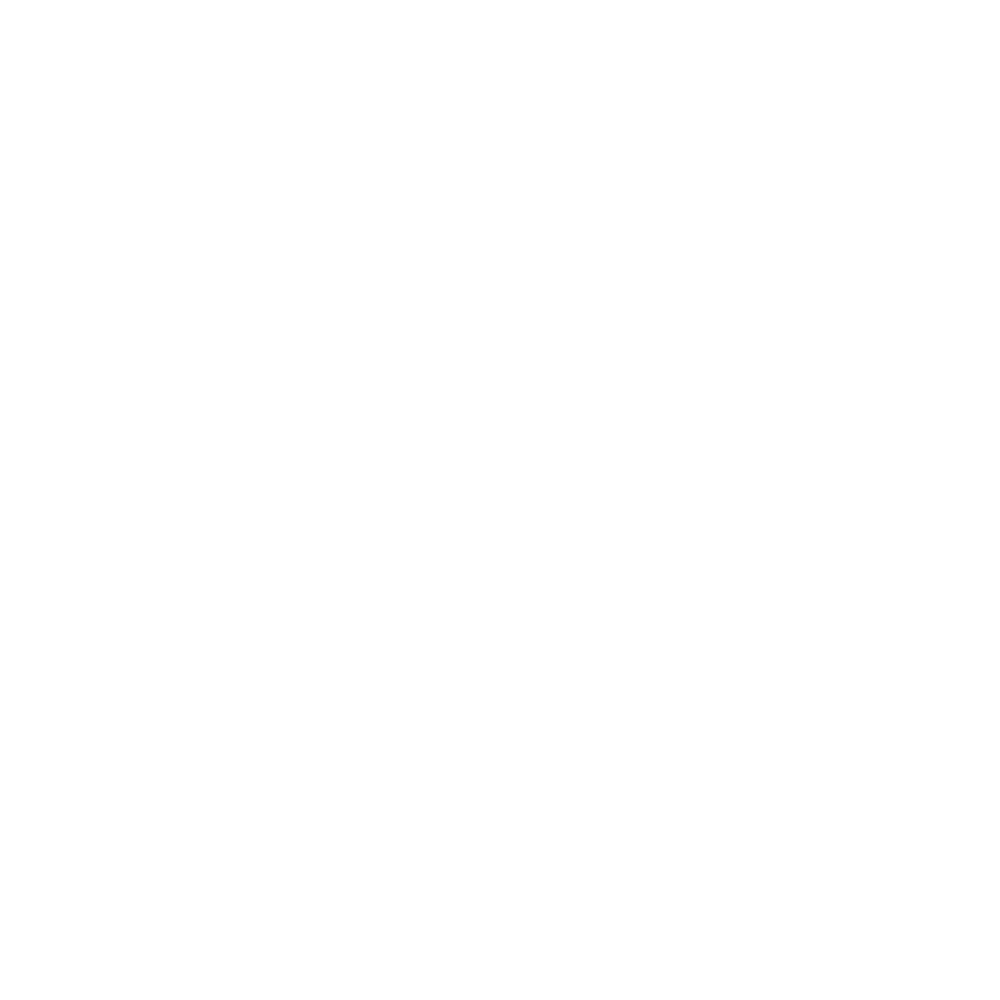

i, sweeptime =  2017-09-10 19:19:37


<IPython.core.display.Javascript object>


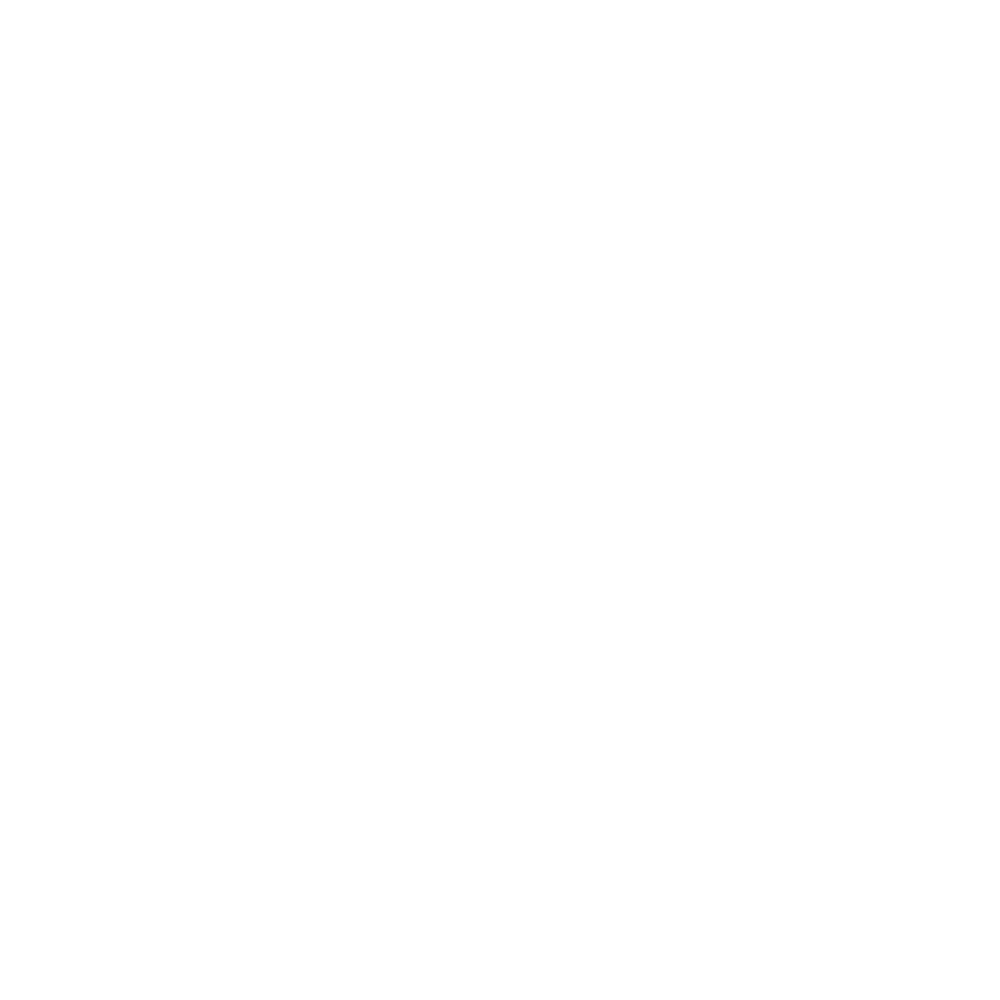

i, sweeptime =  2017-09-10 19:26:36


<IPython.core.display.Javascript object>


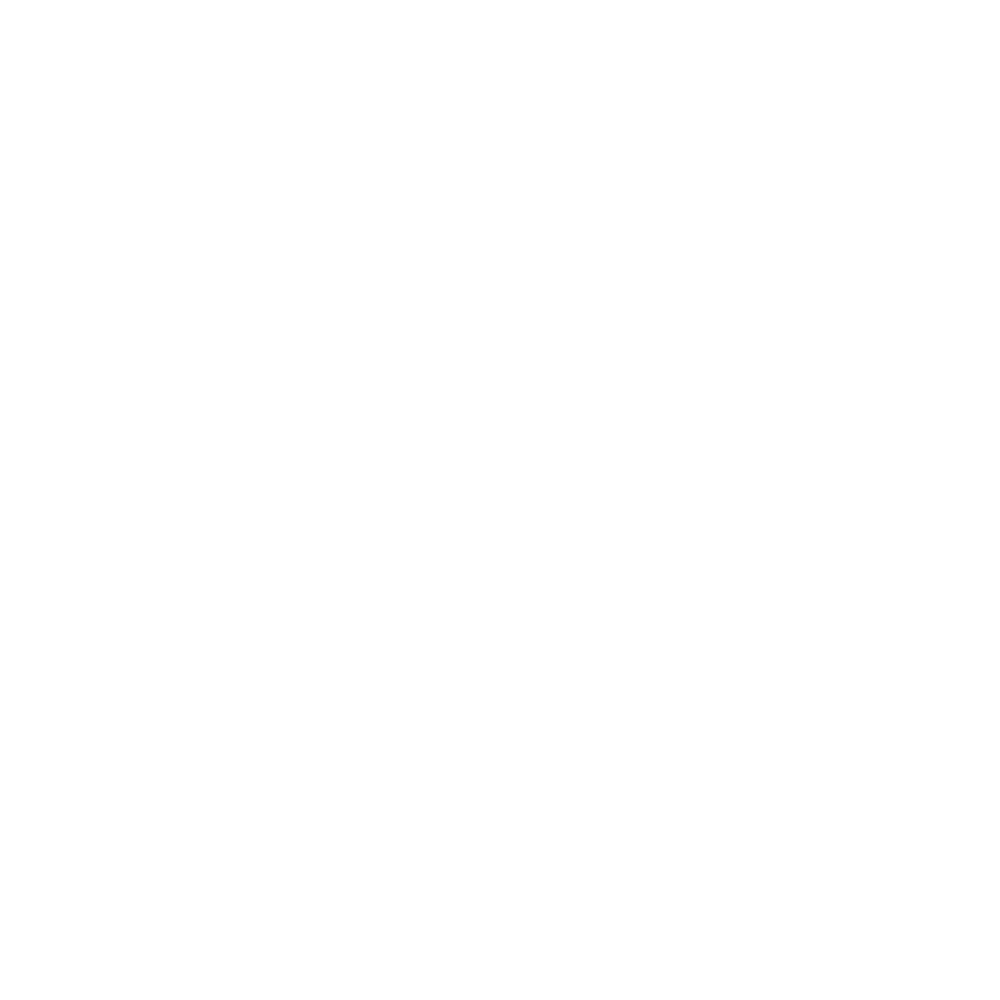

i, sweeptime =  2017-09-10 19:33:38


<IPython.core.display.Javascript object>


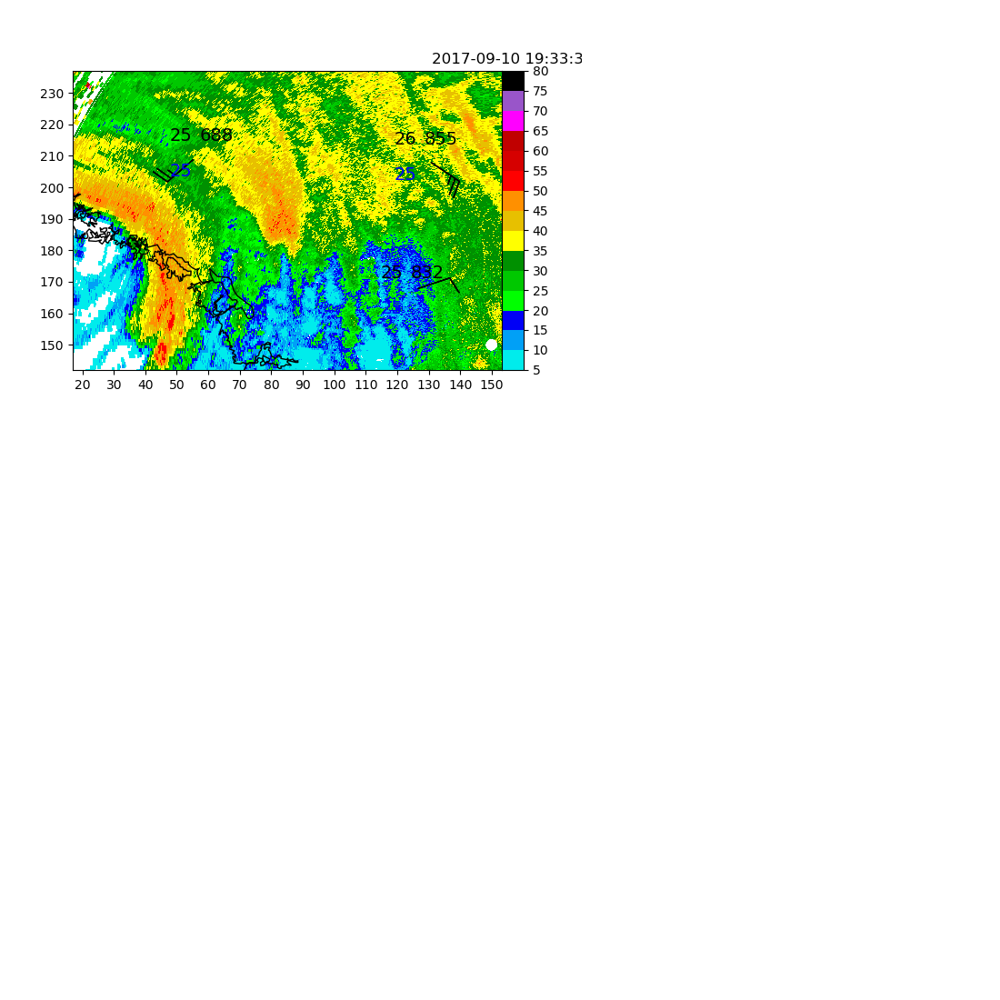

i, sweeptime =  2017-09-10 19:40:37


<IPython.core.display.Javascript object>


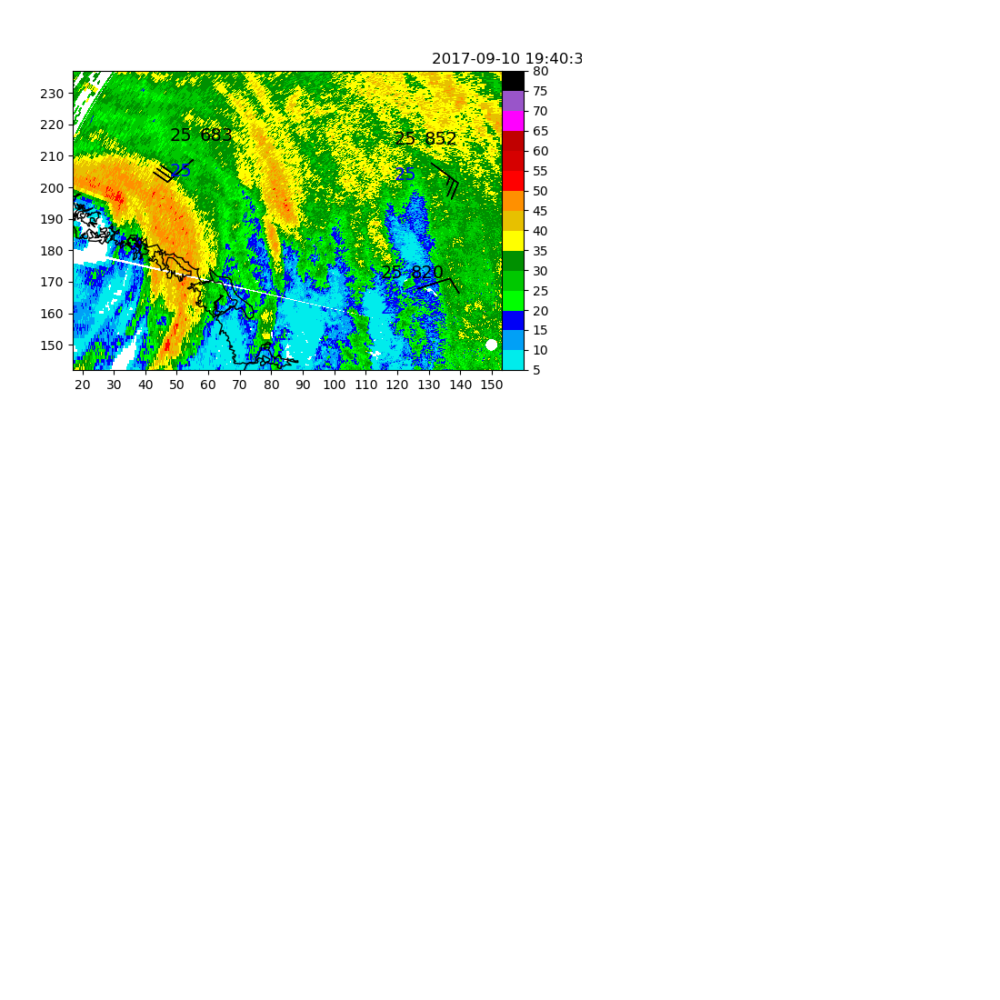

i, sweeptime =  2017-09-10 19:47:38


<IPython.core.display.Javascript object>


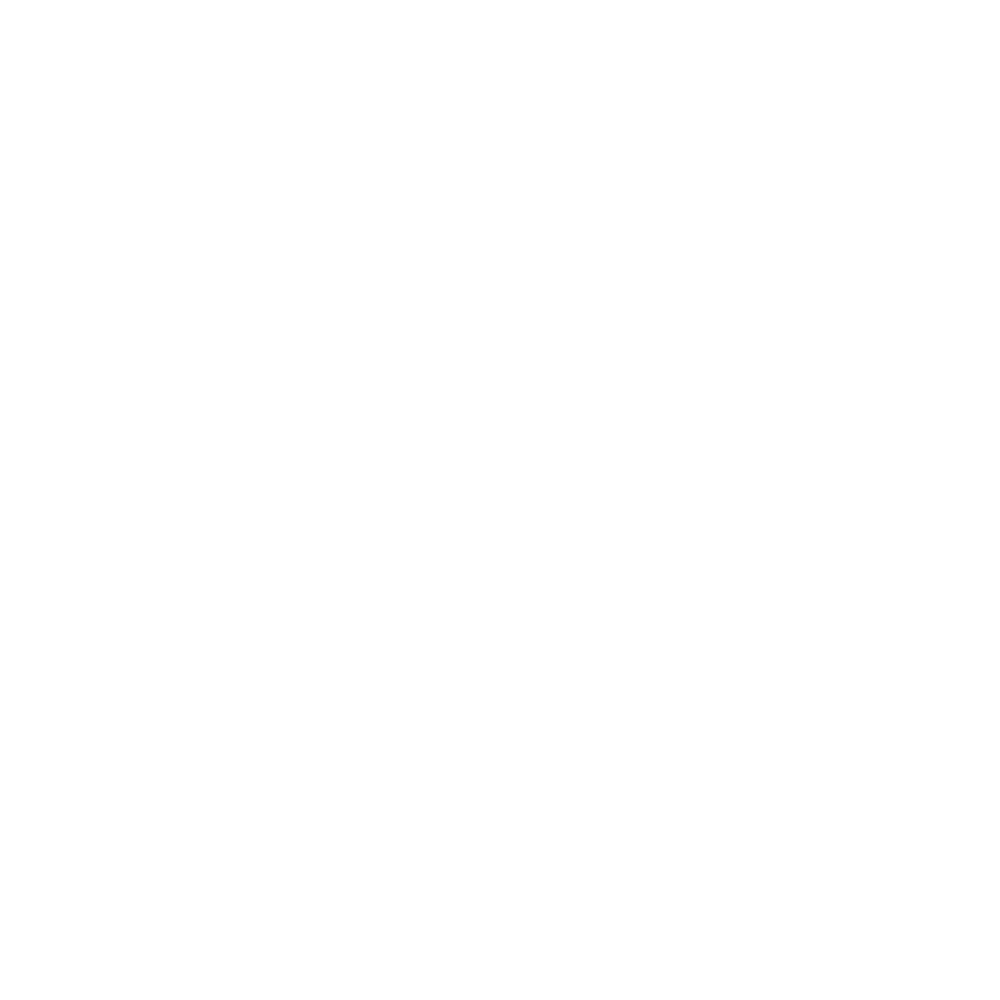

i, sweeptime =  2017-09-10 19:54:39


<IPython.core.display.Javascript object>


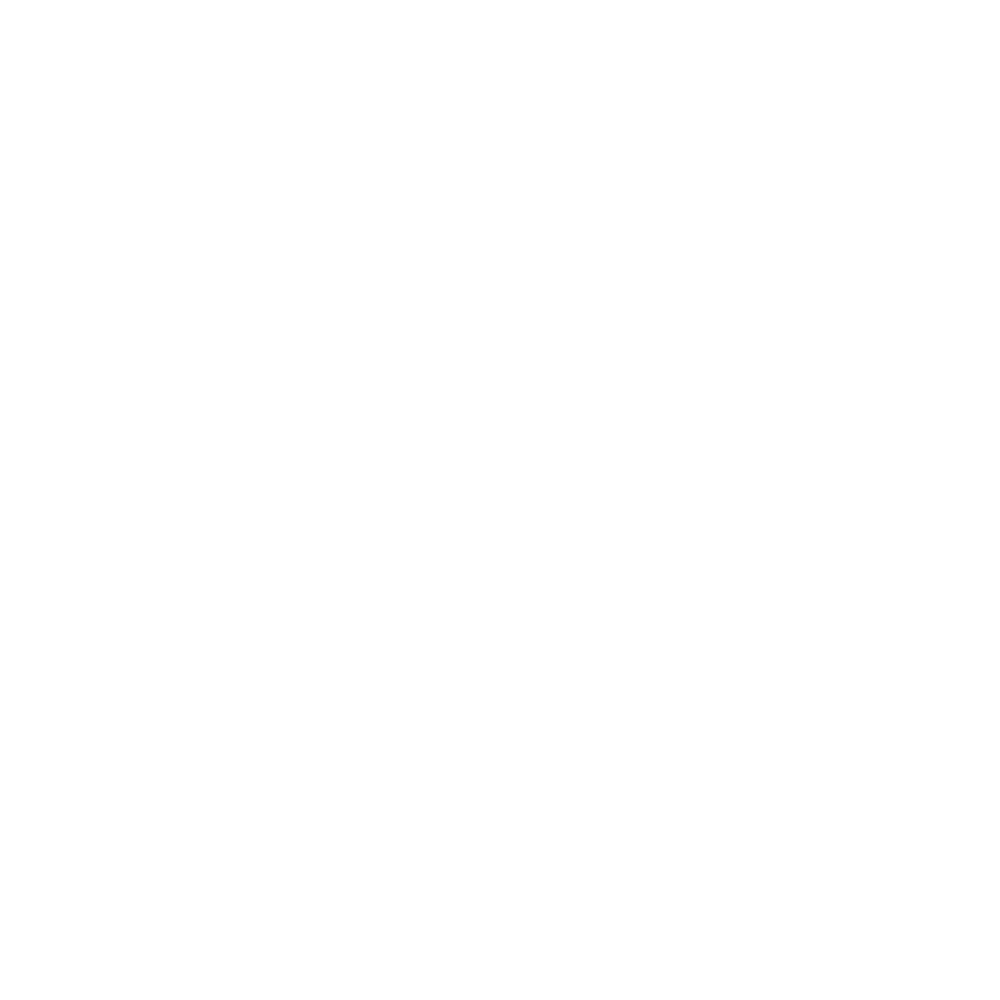

i, sweeptime =  2017-09-10 20:01:40


<IPython.core.display.Javascript object>


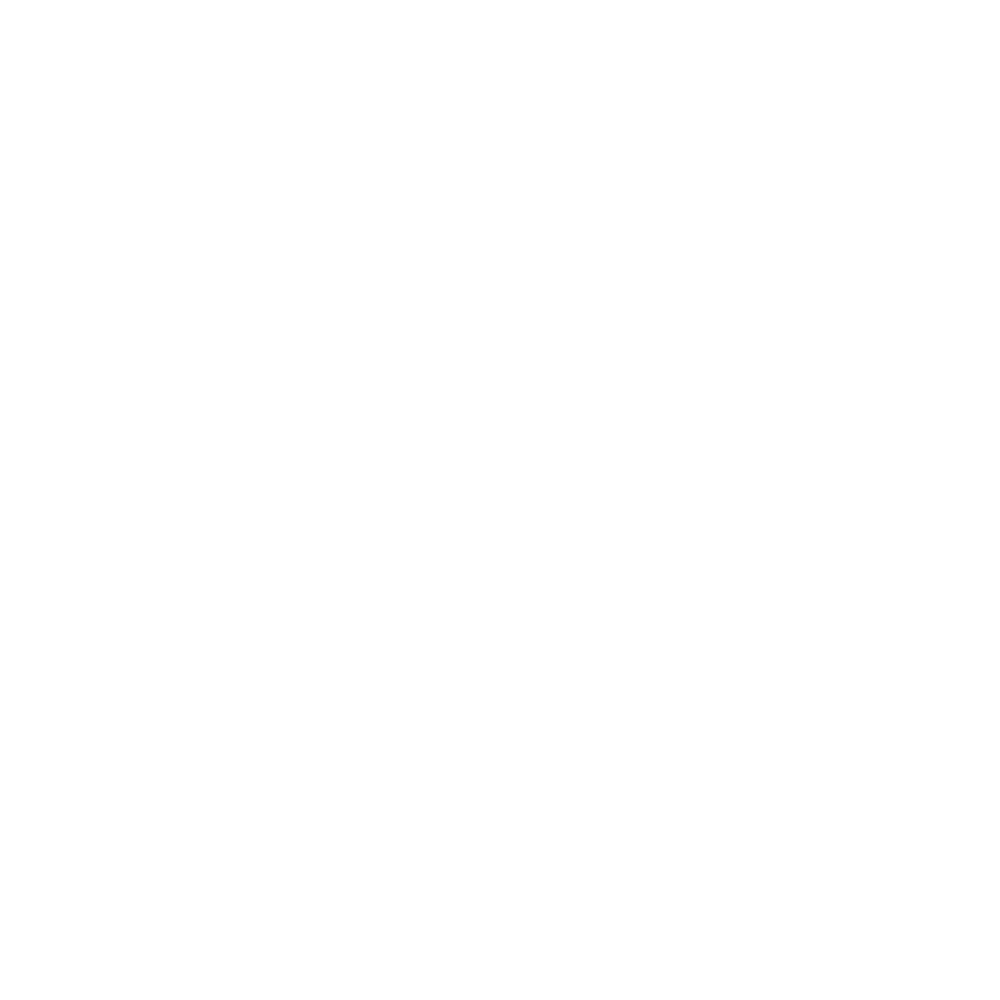

i, sweeptime =  2017-09-10 20:08:35


<IPython.core.display.Javascript object>


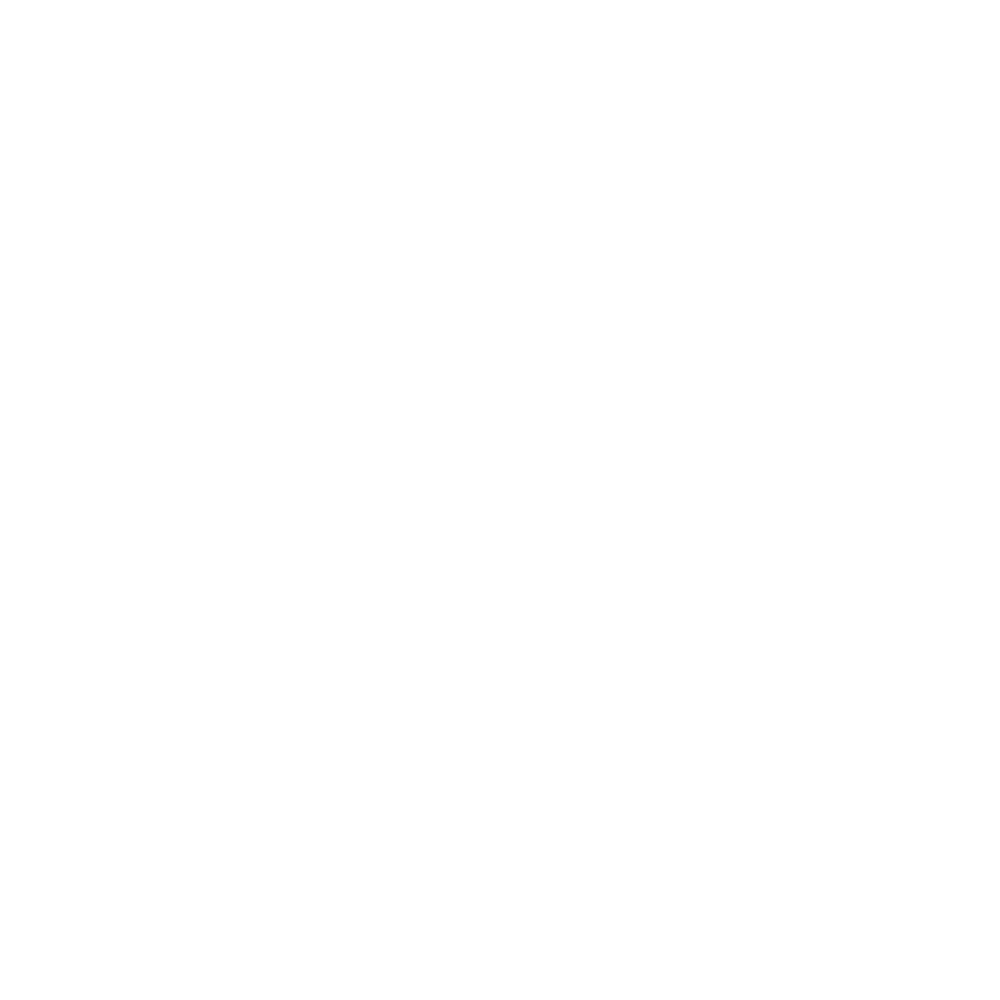

i, sweeptime =  2017-09-10 20:15:05


<IPython.core.display.Javascript object>


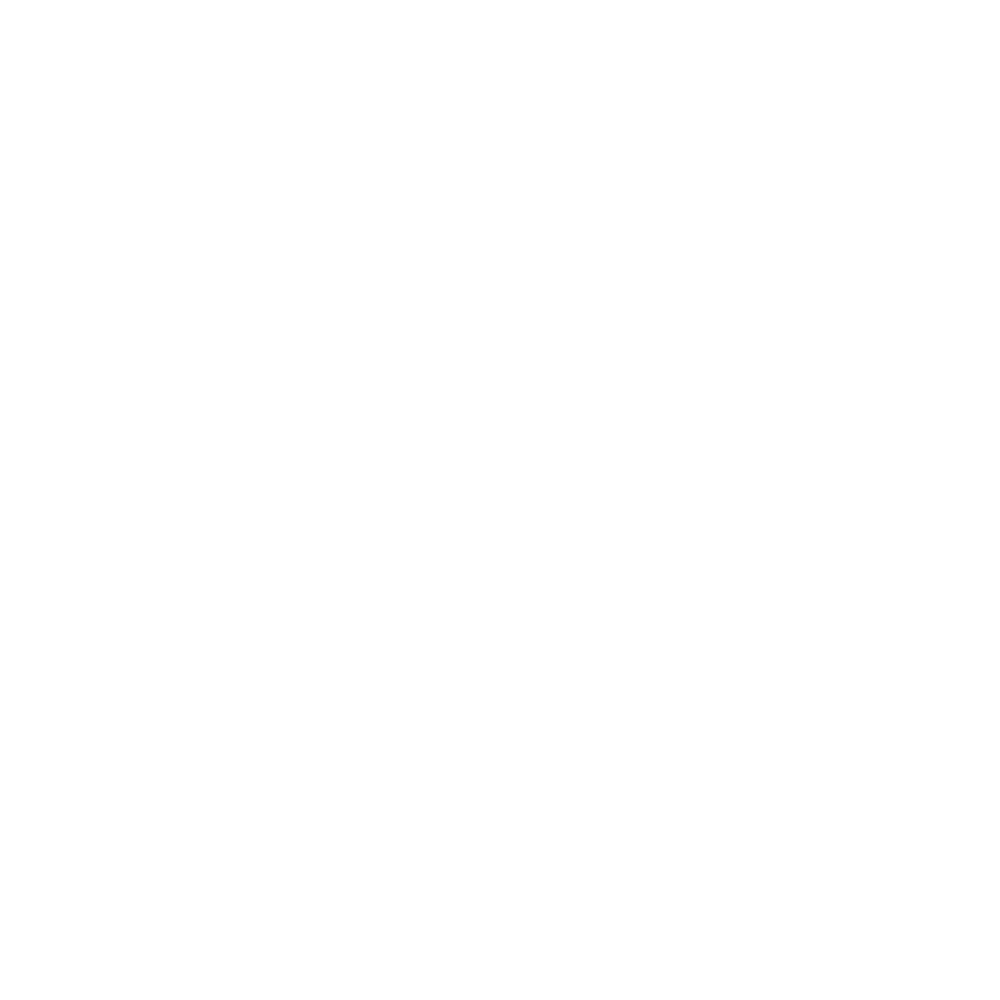

i, sweeptime =  2017-09-10 20:23:36


<IPython.core.display.Javascript object>


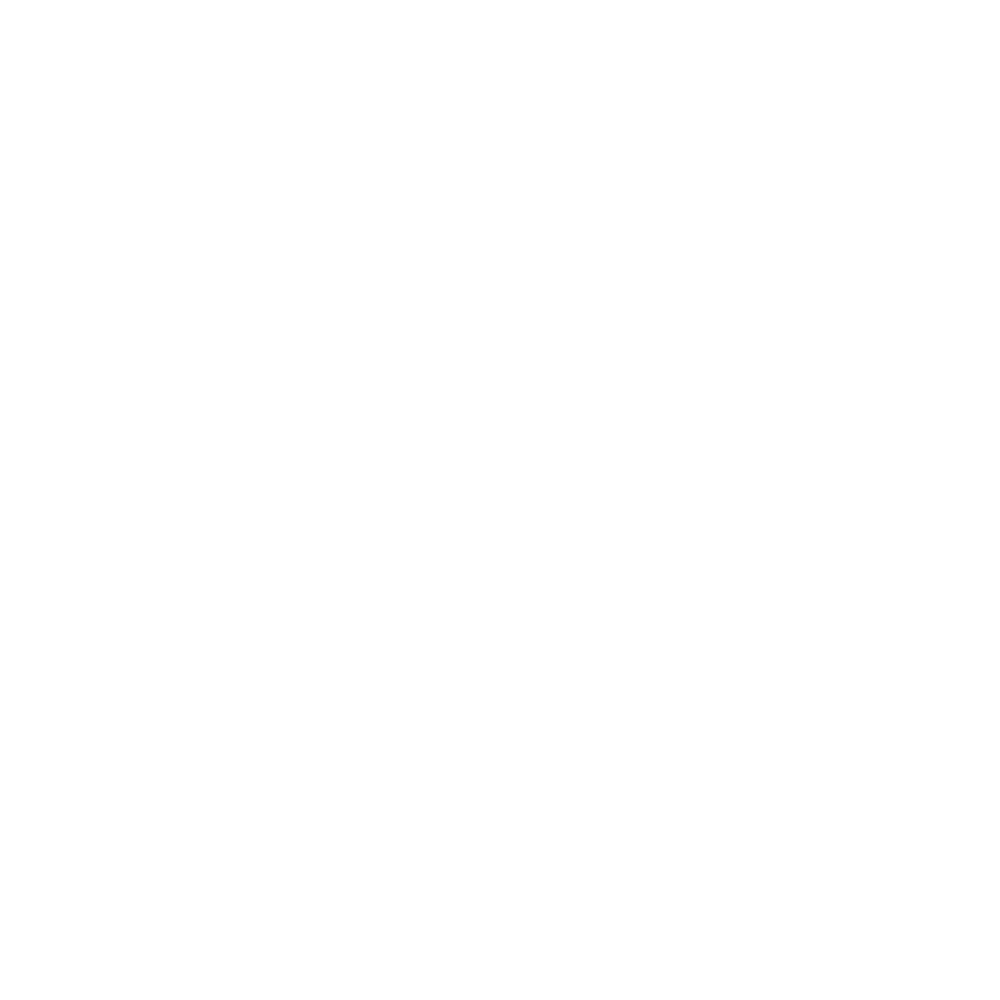

i, sweeptime =  2017-09-10 20:30:36


<IPython.core.display.Javascript object>


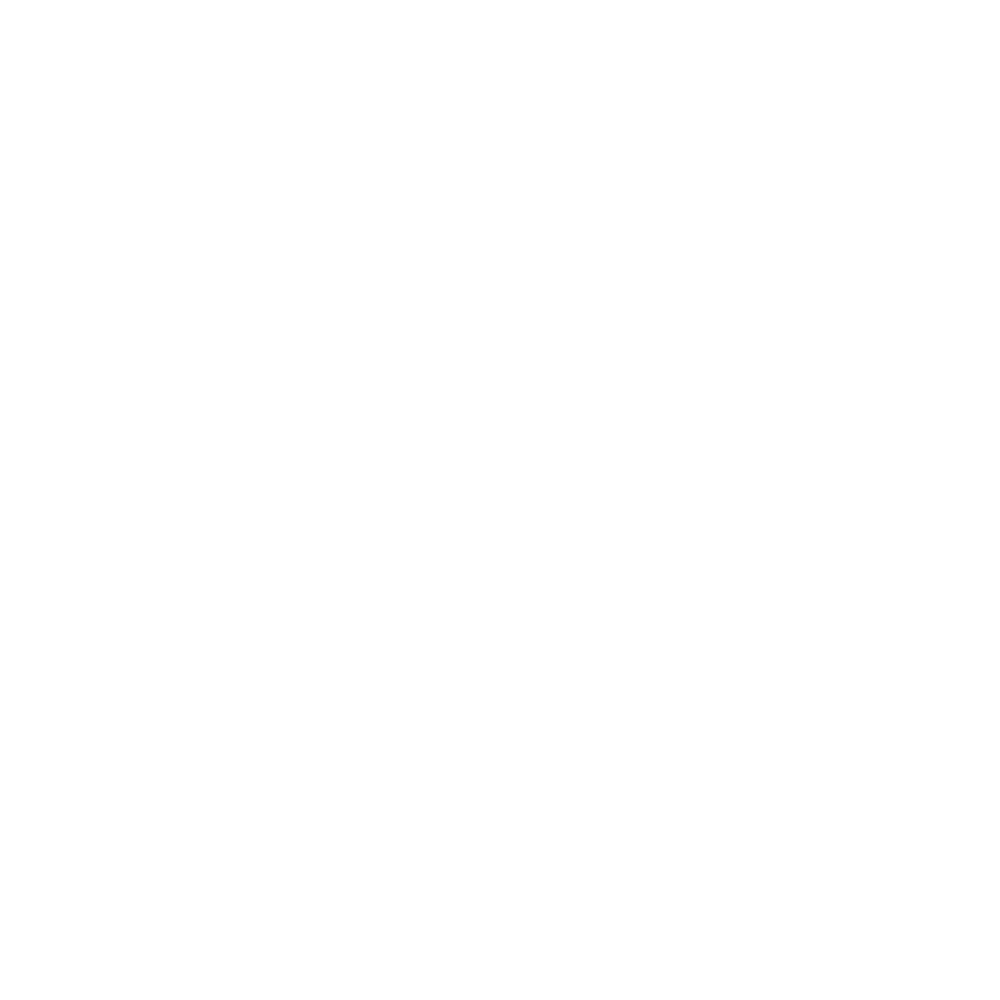

i, sweeptime =  2017-09-10 20:37:36


<IPython.core.display.Javascript object>


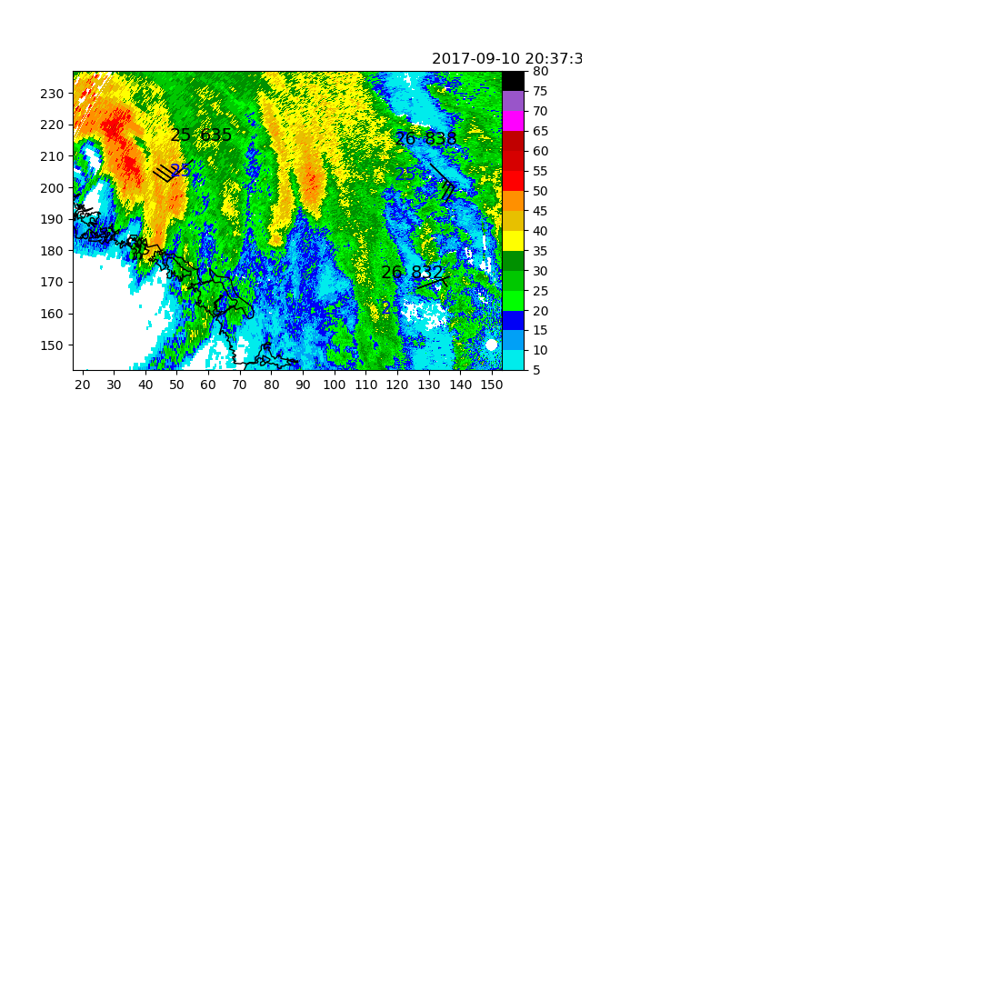

i, sweeptime =  2017-09-10 20:44:36


<IPython.core.display.Javascript object>


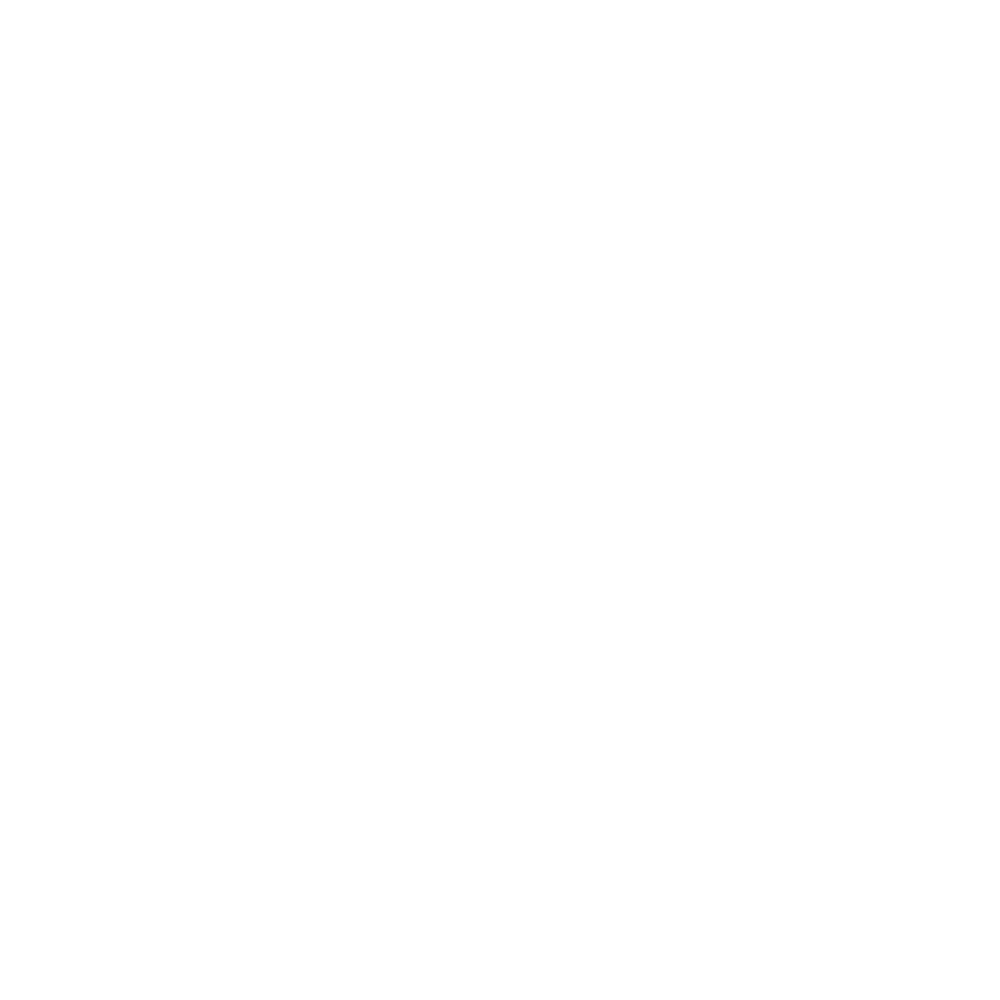

i, sweeptime =  2017-09-10 20:51:37


<IPython.core.display.Javascript object>


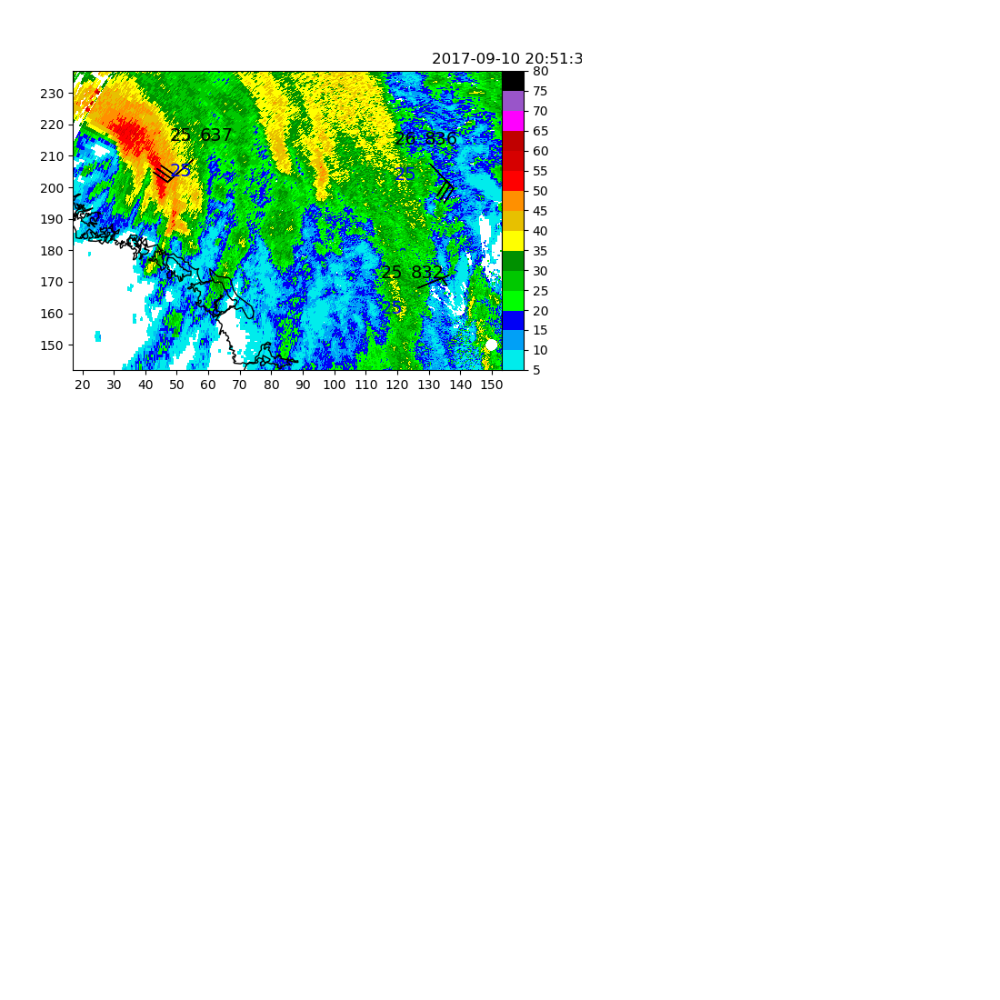

i, sweeptime =  2017-09-10 20:58:37


<IPython.core.display.Javascript object>


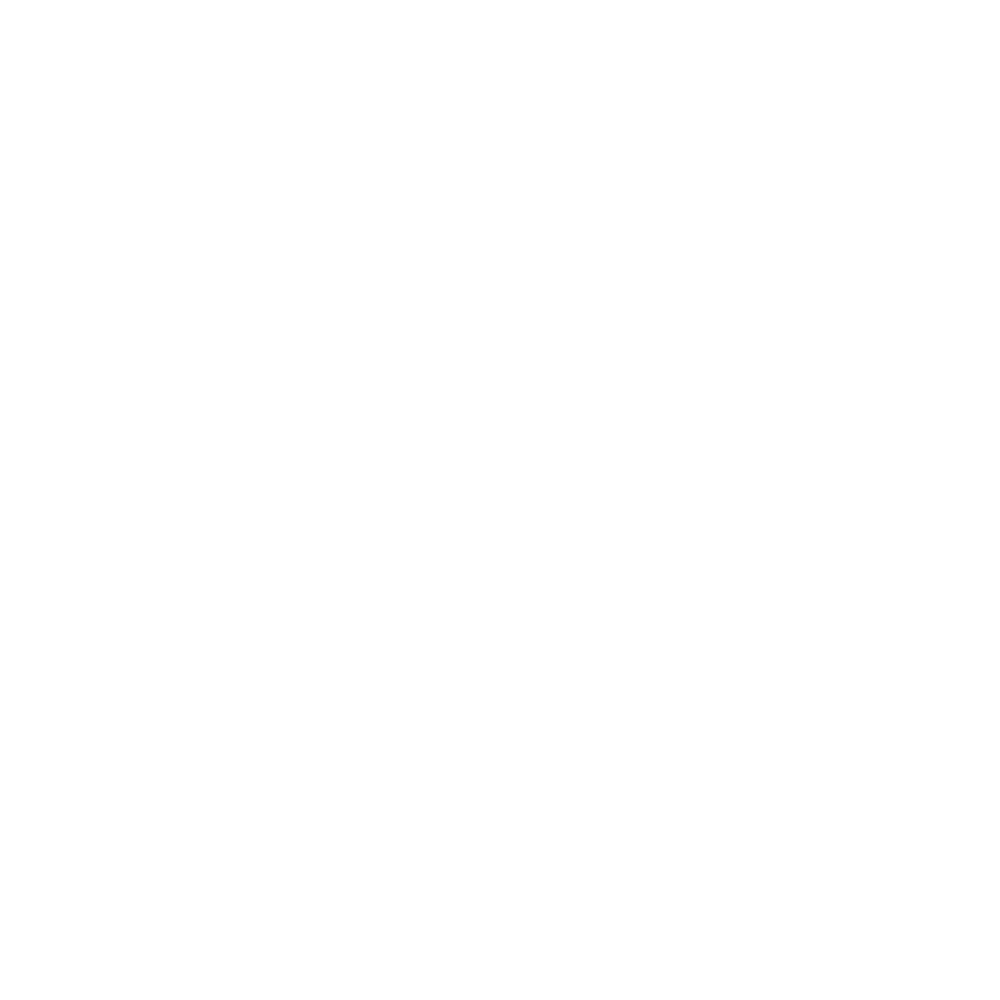

i, sweeptime =  2017-09-10 21:05:37


<IPython.core.display.Javascript object>


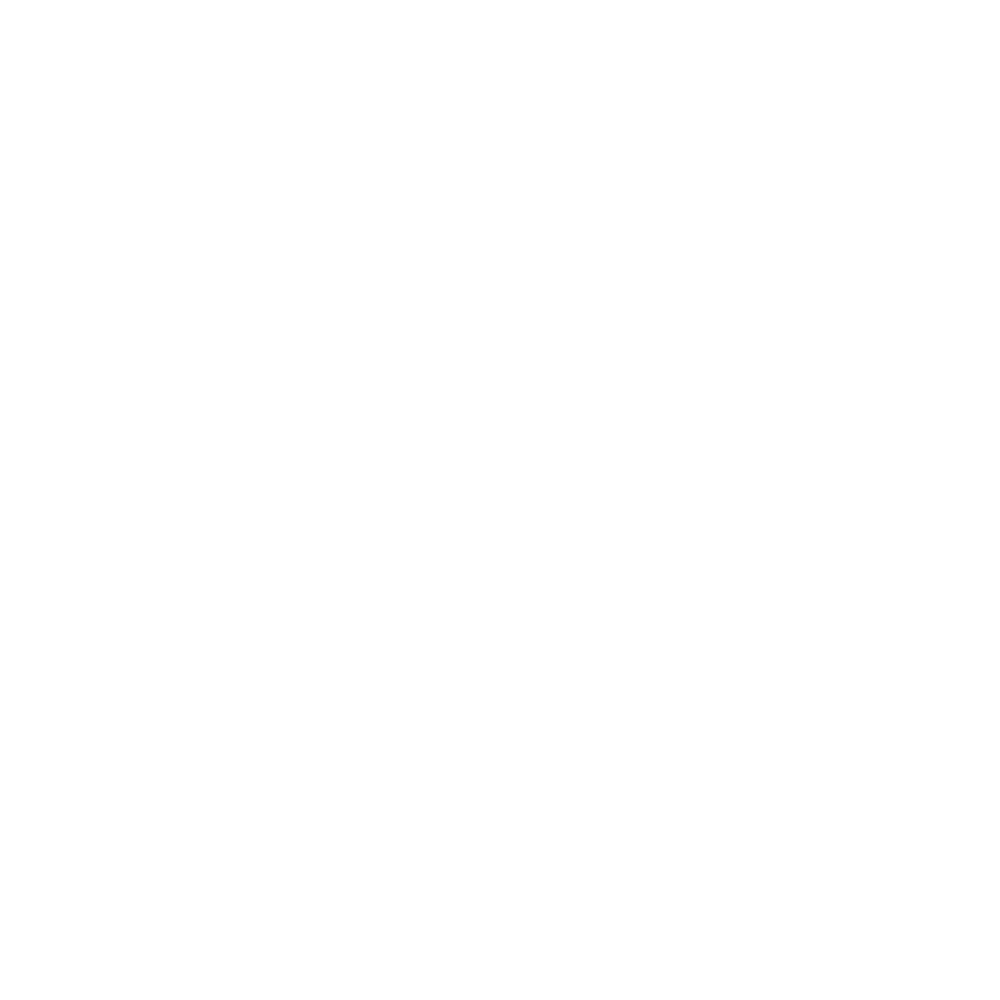

i, sweeptime =  2017-09-10 21:12:38


<IPython.core.display.Javascript object>


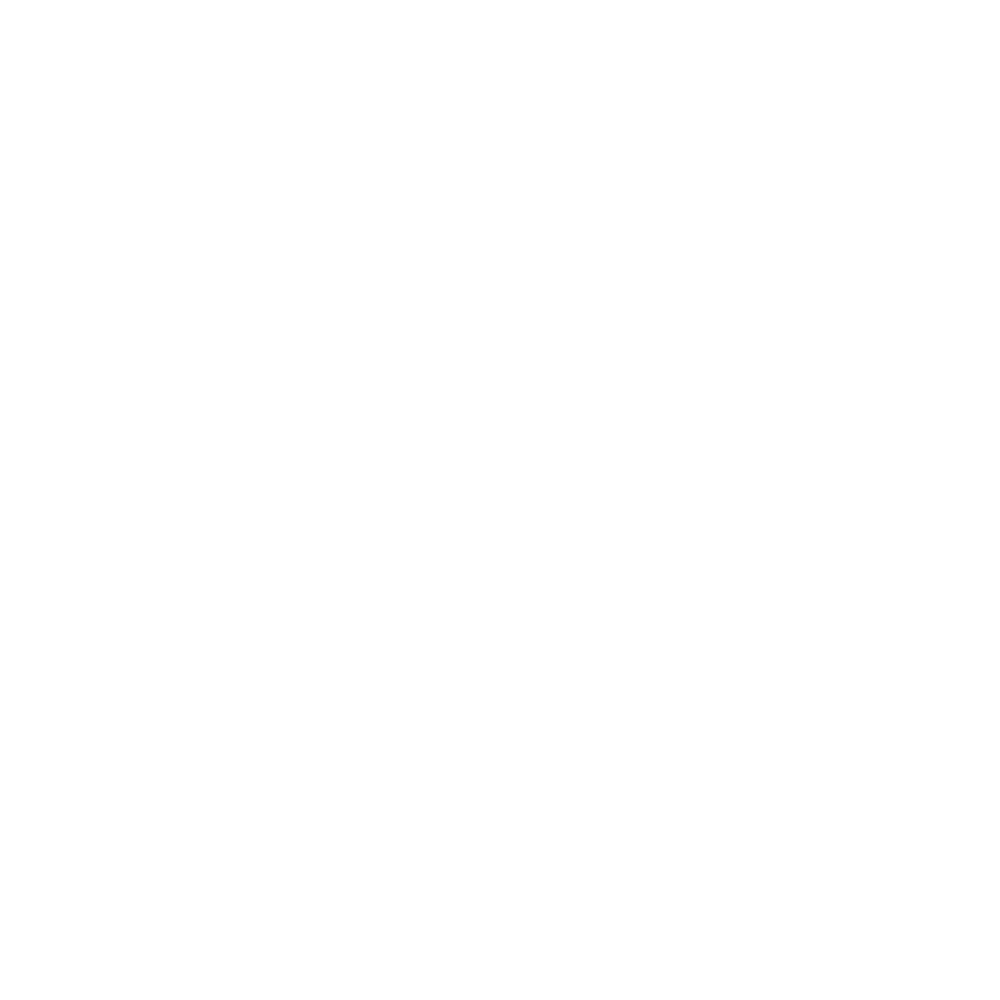

i, sweeptime =  2017-09-10 21:19:37


<IPython.core.display.Javascript object>


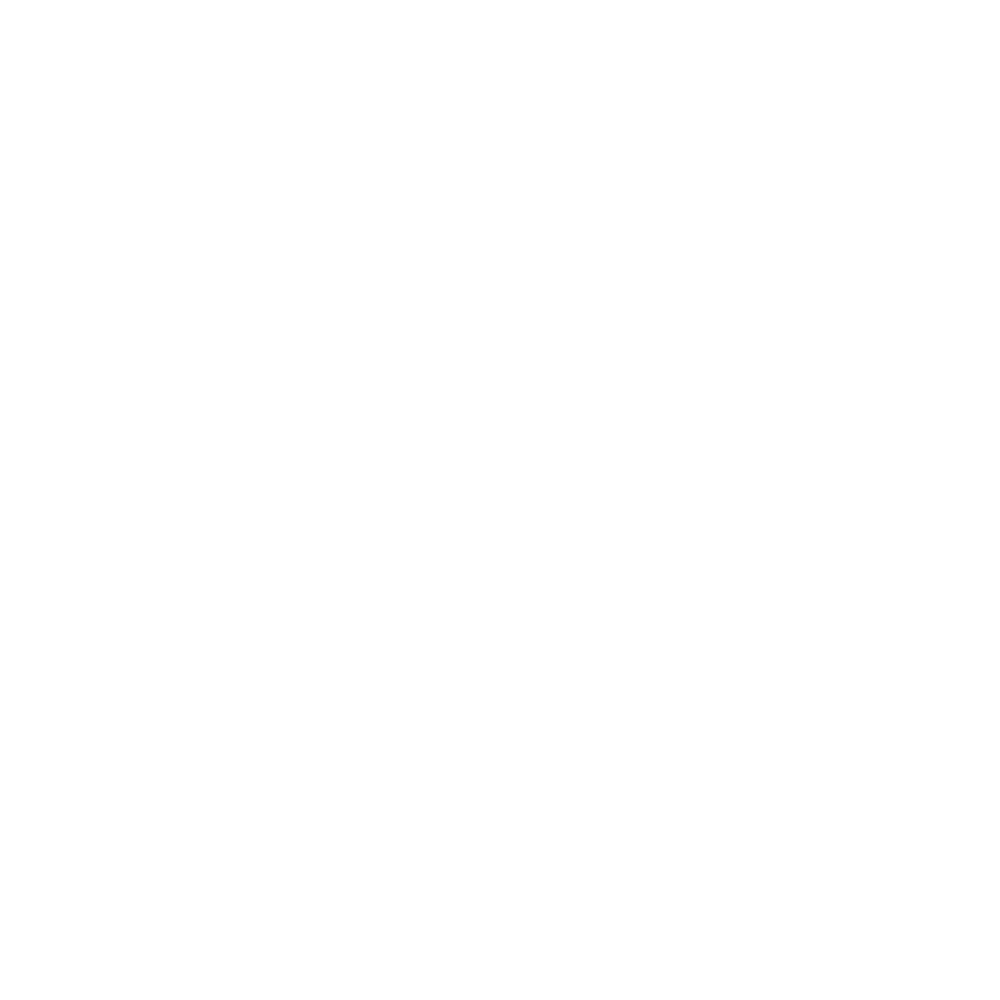

i, sweeptime =  2017-09-10 21:26:39


<IPython.core.display.Javascript object>


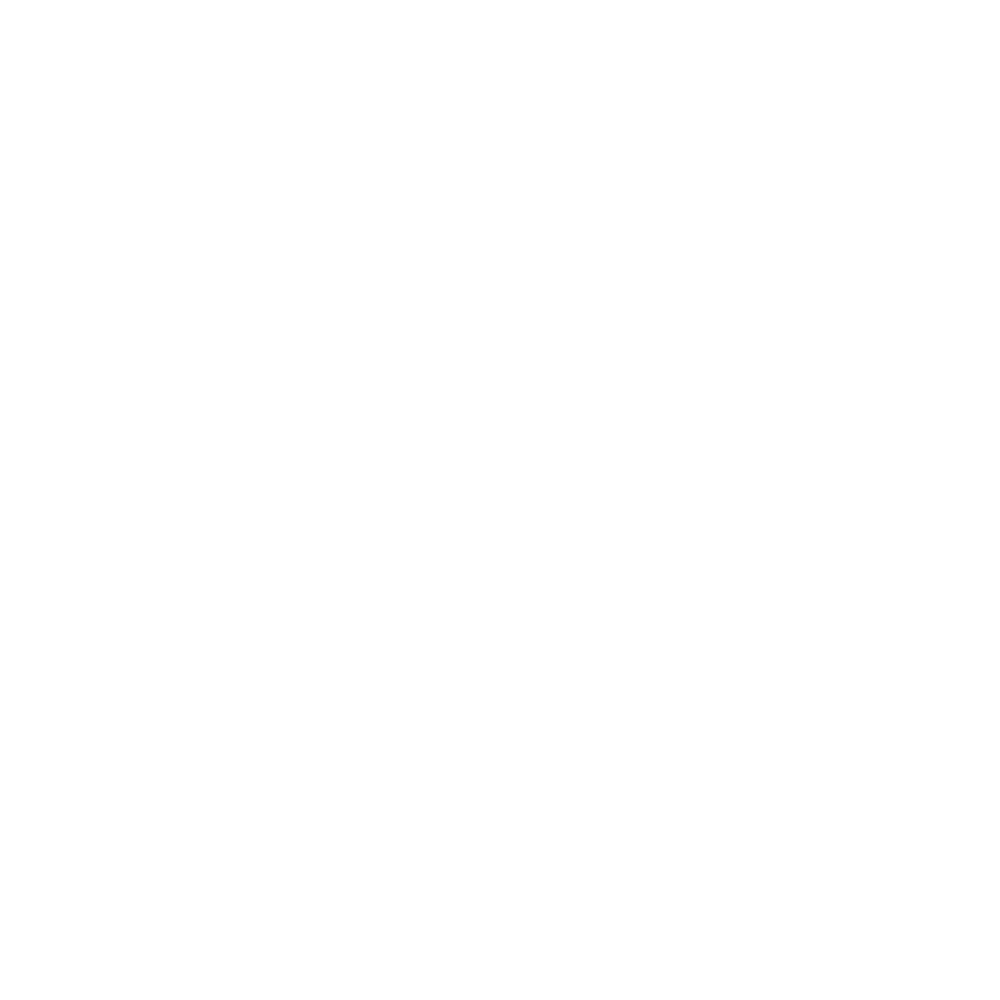

i, sweeptime =  2017-09-10 21:33:40


<IPython.core.display.Javascript object>


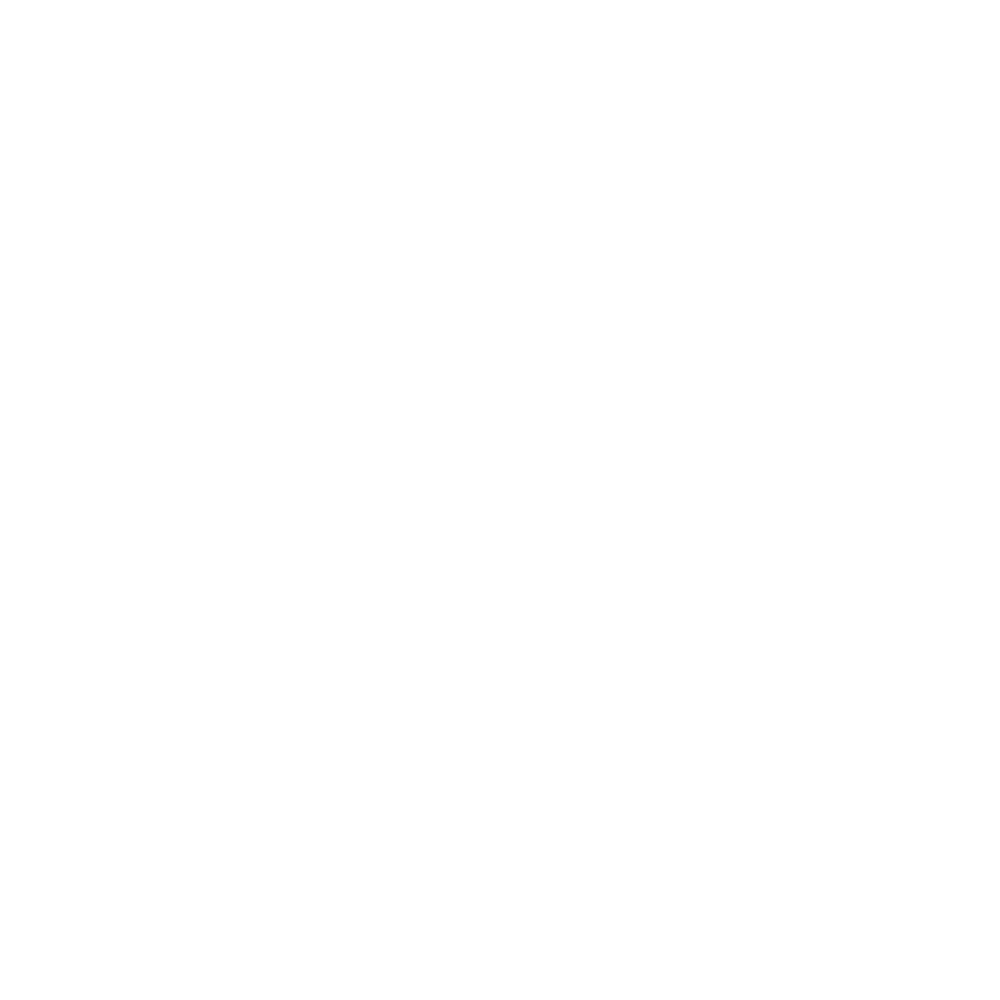

i, sweeptime =  2017-09-10 21:40:38


<IPython.core.display.Javascript object>


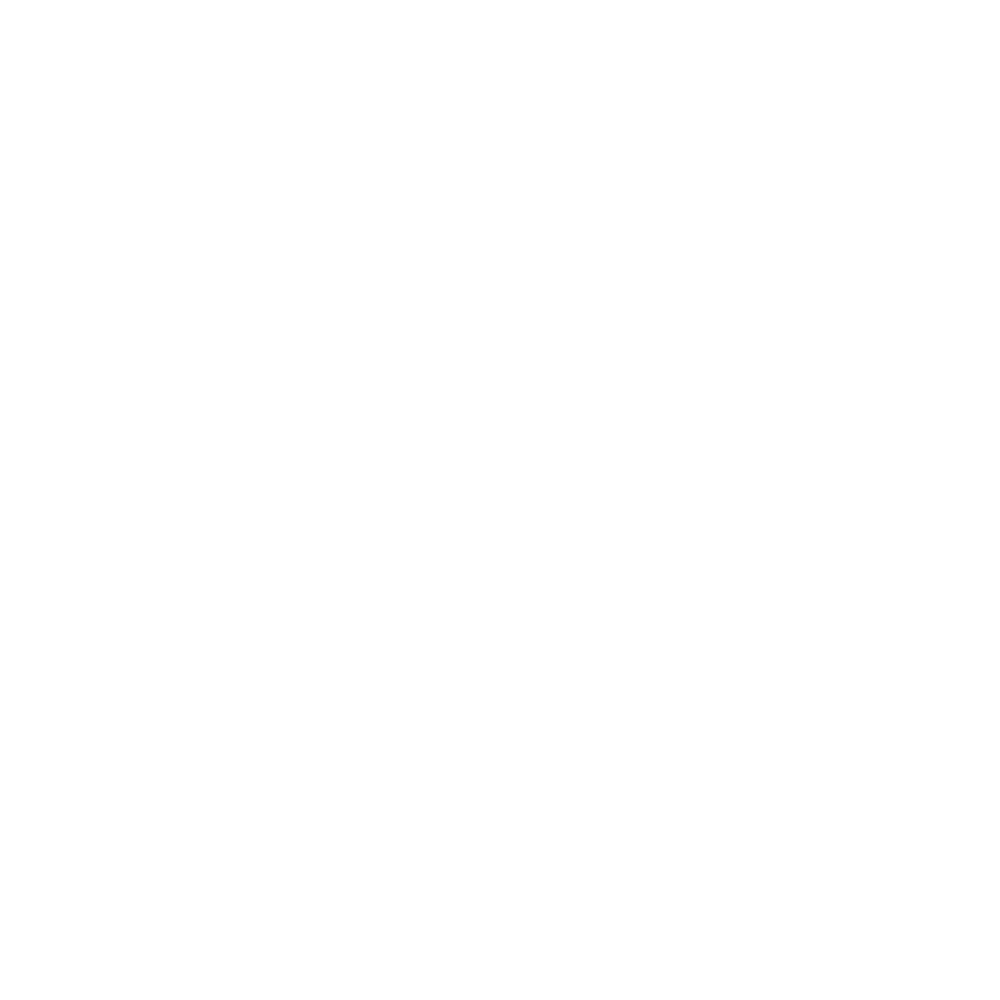

i, sweeptime =  2017-09-10 21:47:29


<IPython.core.display.Javascript object>


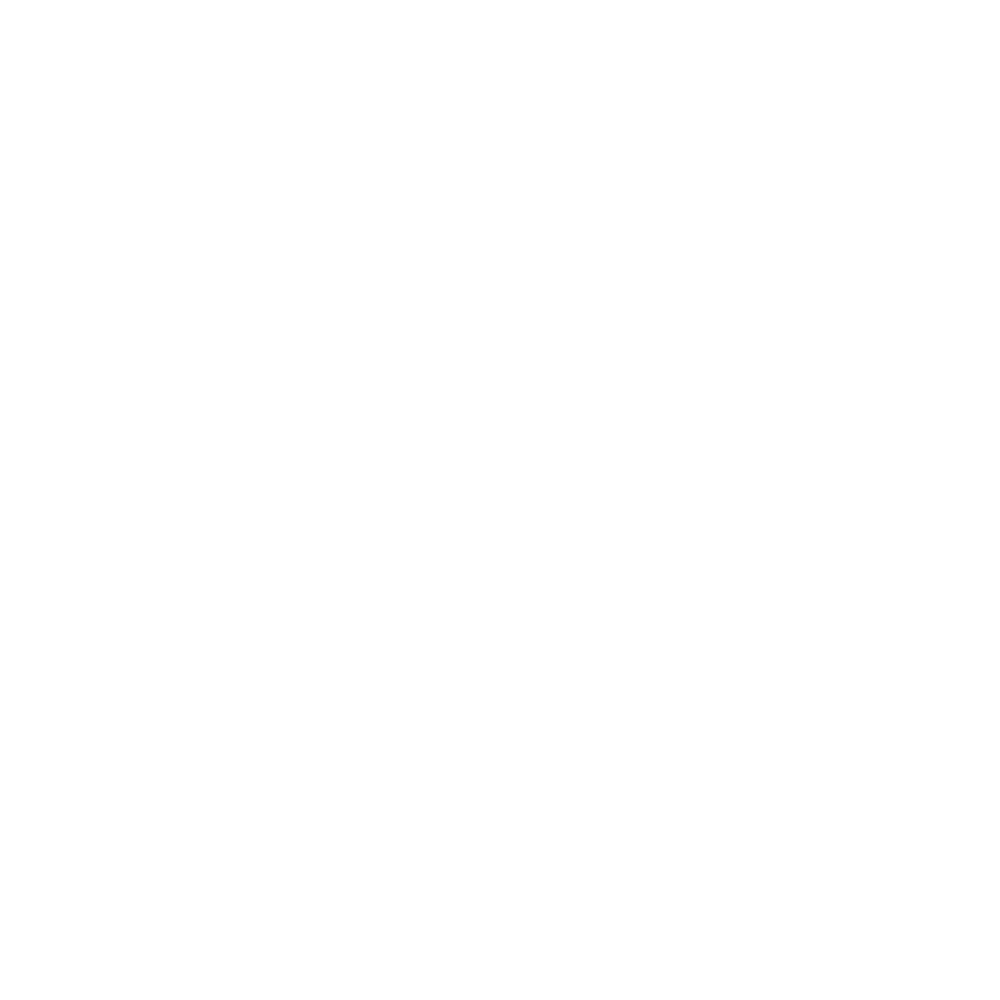

i, sweeptime =  2017-09-10 21:54:29


<IPython.core.display.Javascript object>


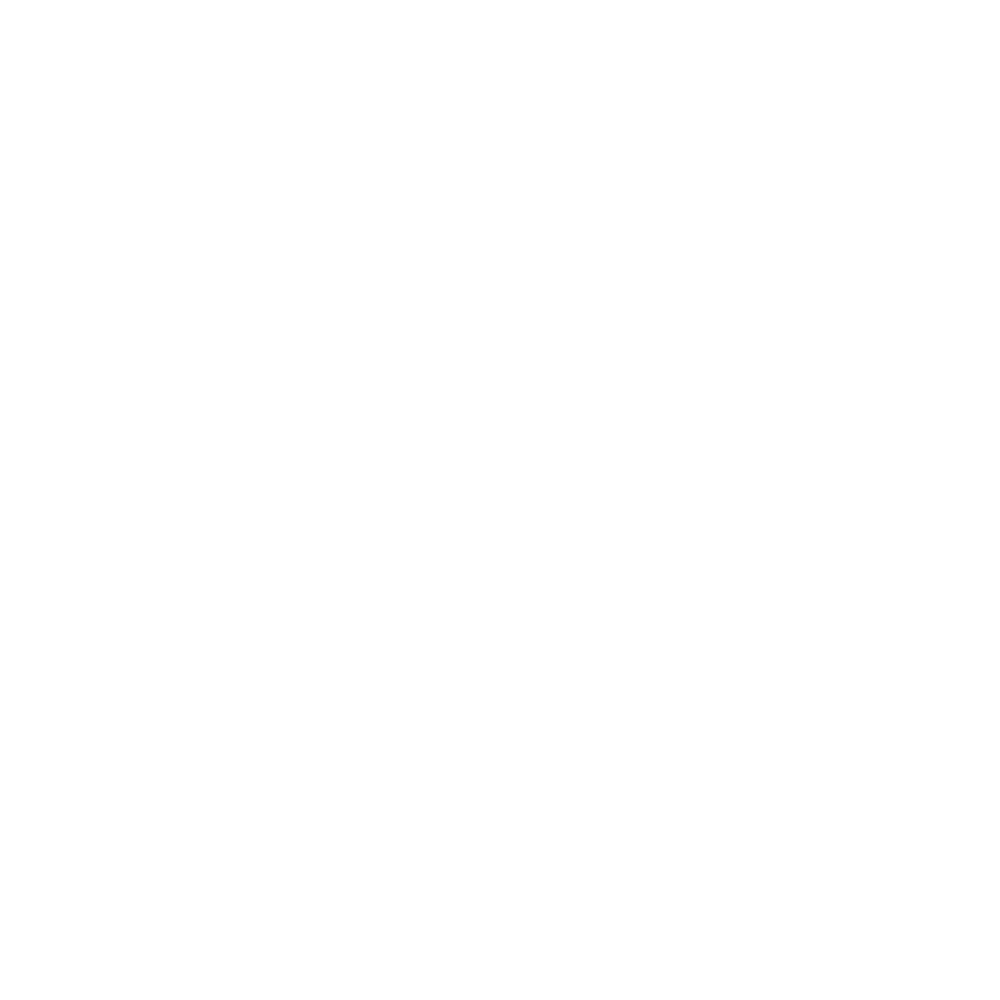

i, sweeptime =  2017-09-10 22:01:23


<IPython.core.display.Javascript object>


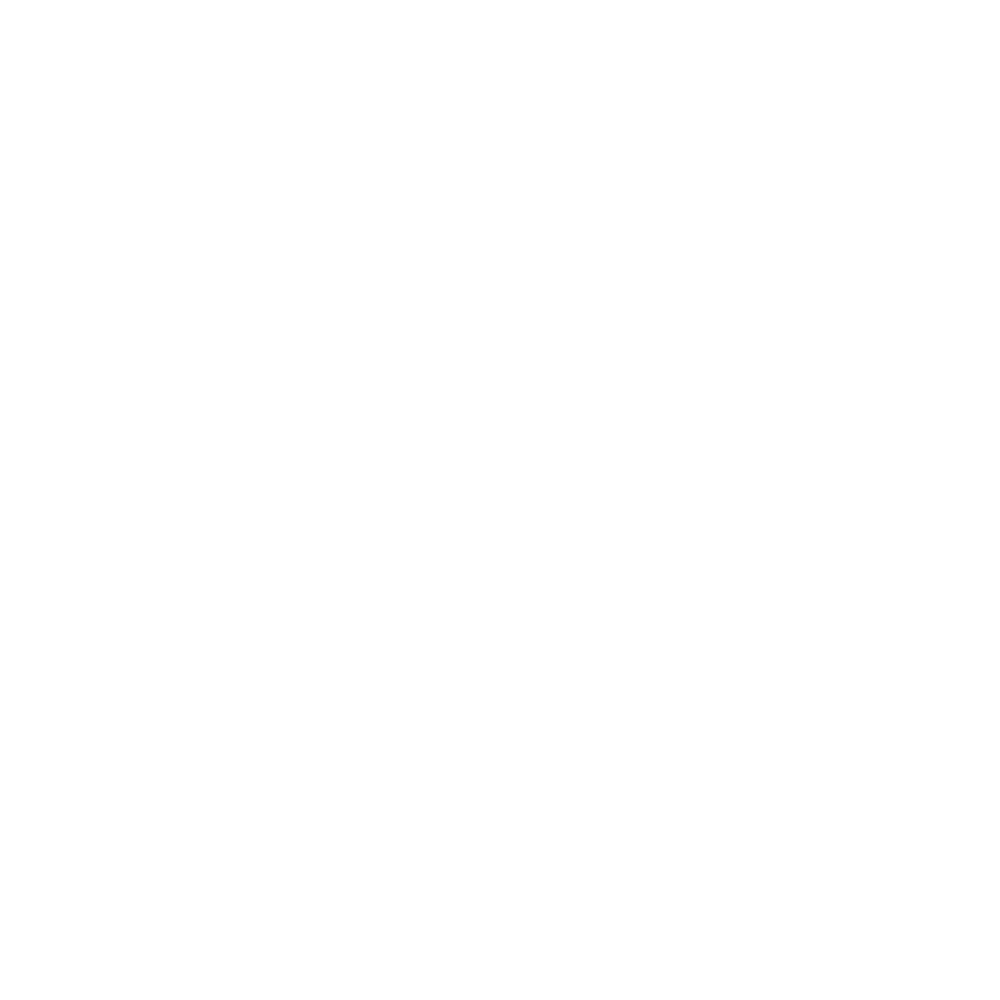

i, sweeptime =  2017-09-10 22:07:55


<IPython.core.display.Javascript object>


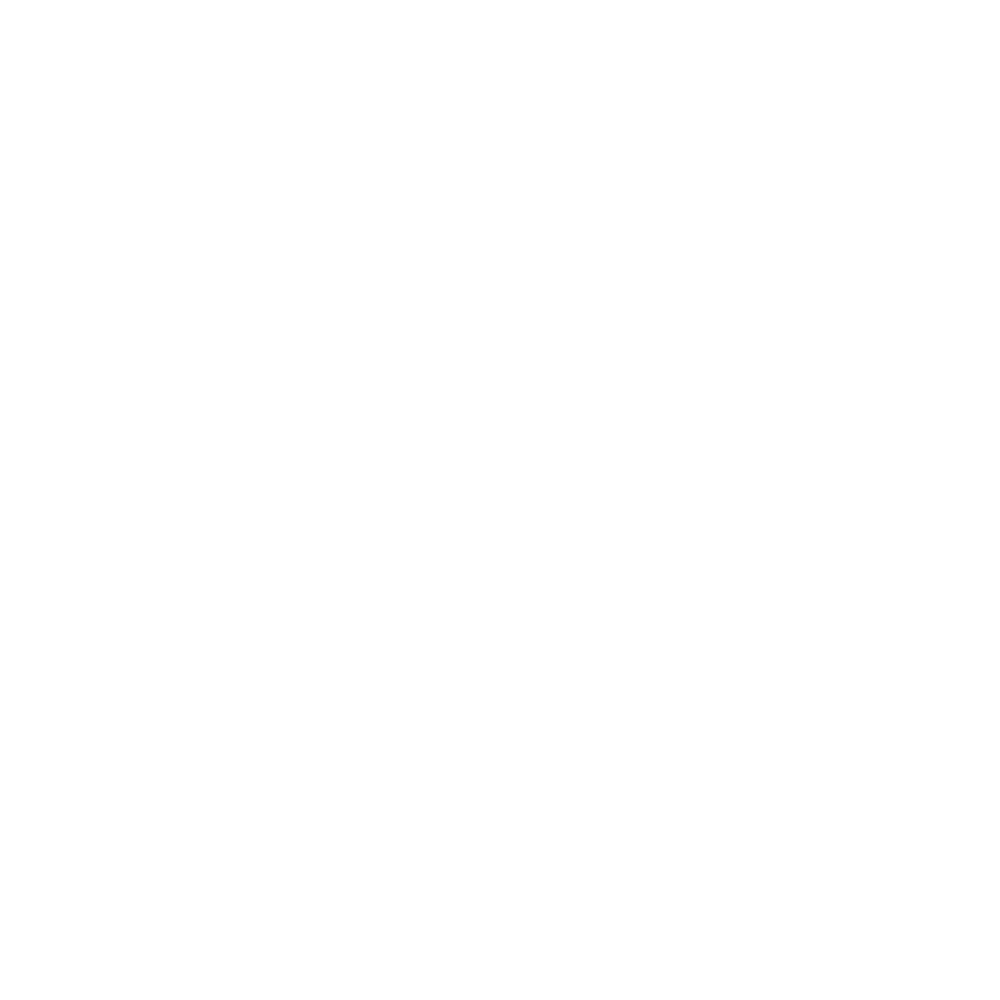

i, sweeptime =  2017-09-10 22:14:32


<IPython.core.display.Javascript object>


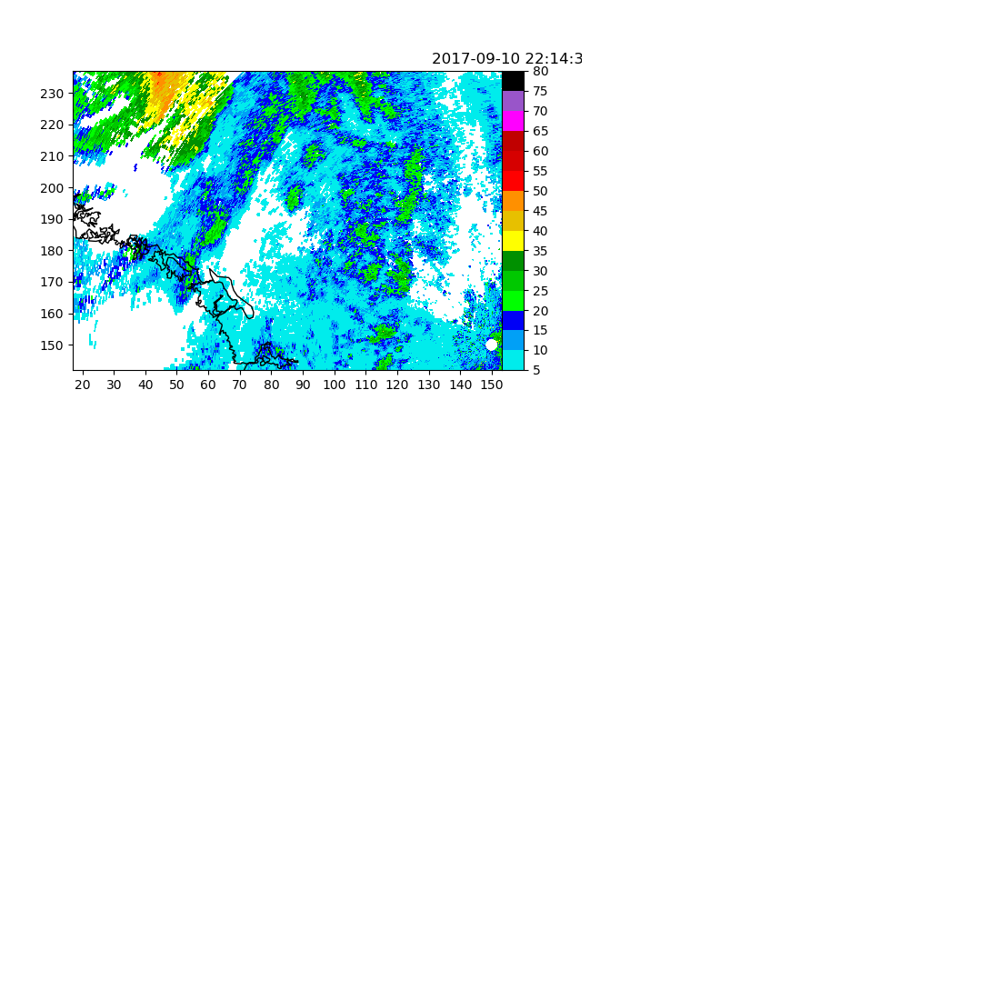

i, sweeptime =  2017-09-10 22:21:02


<IPython.core.display.Javascript object>


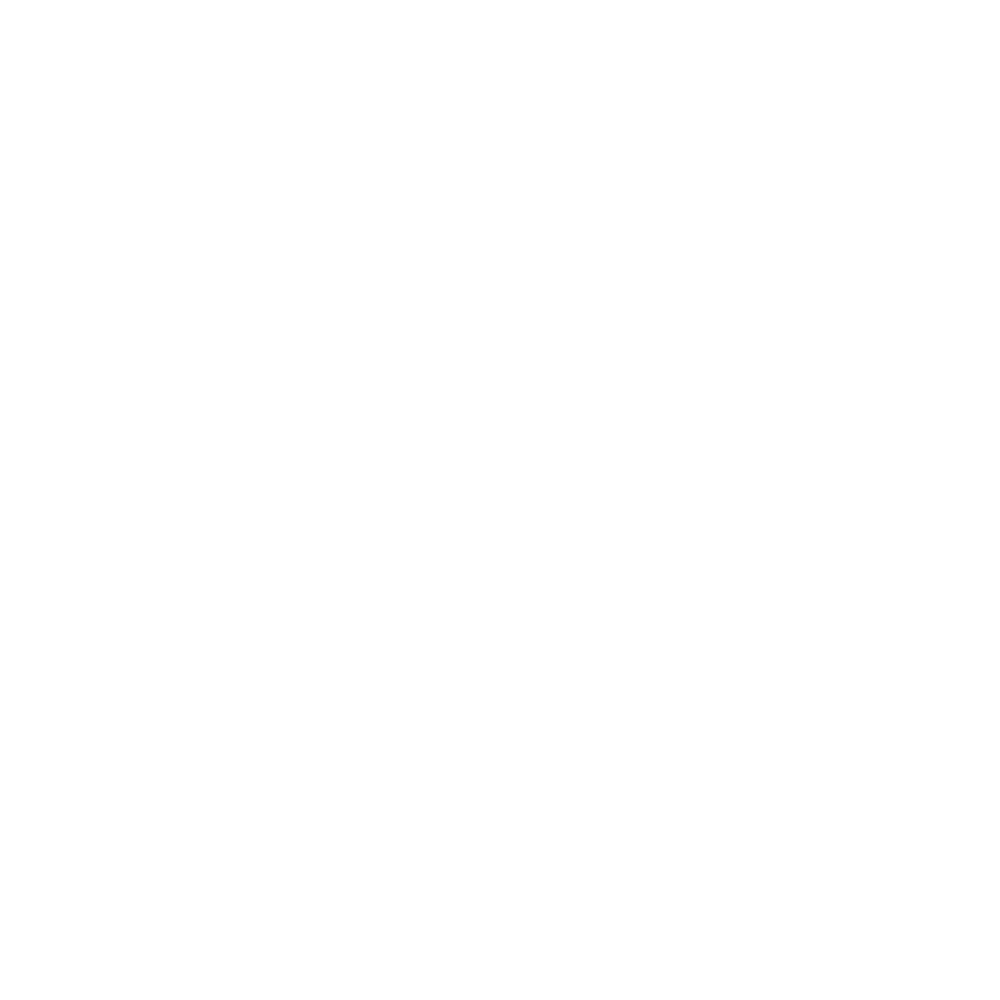

i, sweeptime =  2017-09-10 22:27:36


<IPython.core.display.Javascript object>


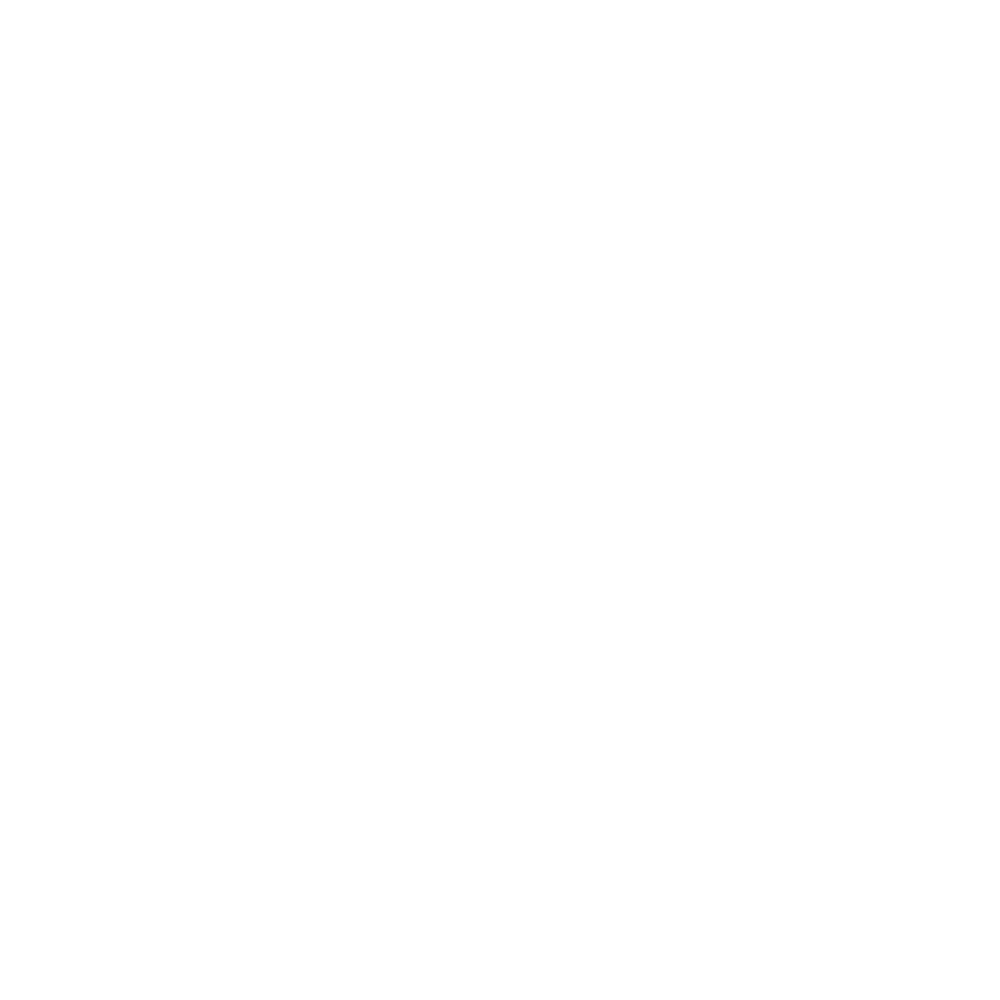

i, sweeptime =  2017-09-10 22:34:28


<IPython.core.display.Javascript object>


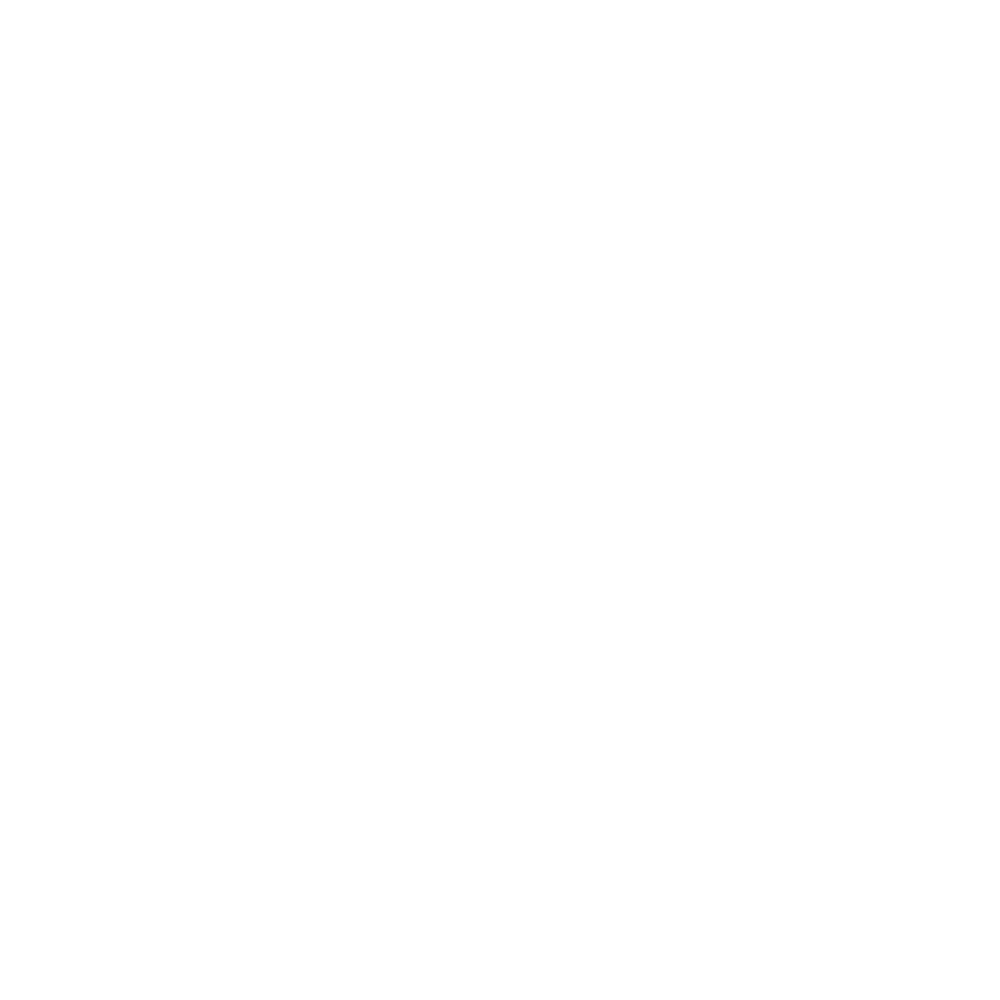

i, sweeptime =  2017-09-10 22:41:27


<IPython.core.display.Javascript object>


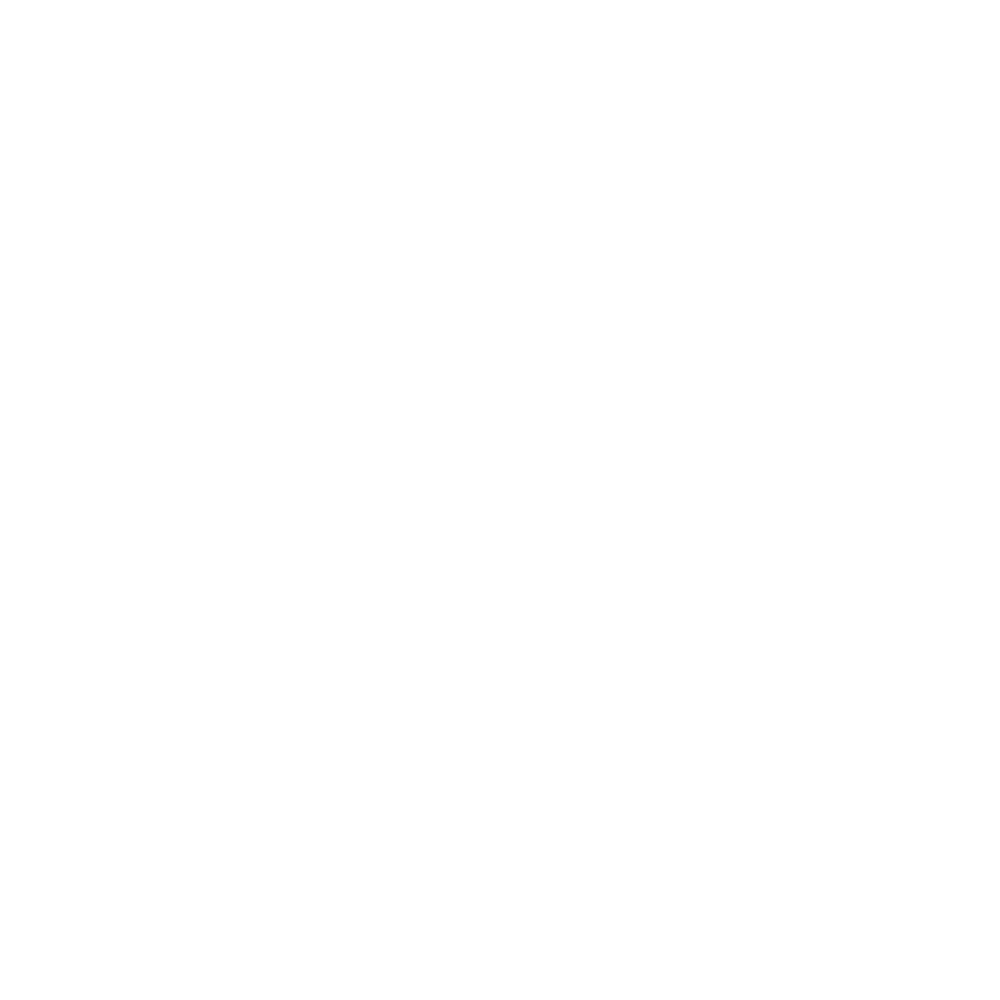

i, sweeptime =  2017-09-10 22:48:28


<IPython.core.display.Javascript object>


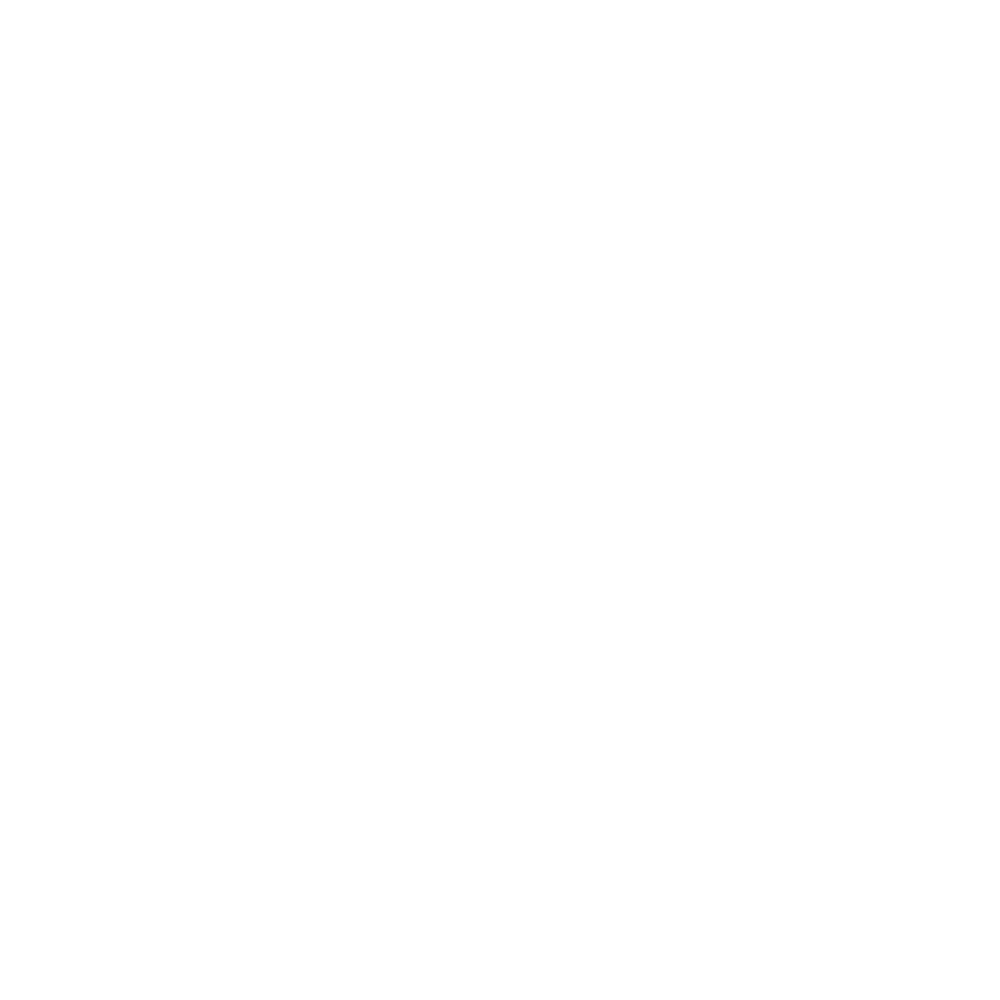

i, sweeptime =  2017-09-10 22:55:25


<IPython.core.display.Javascript object>


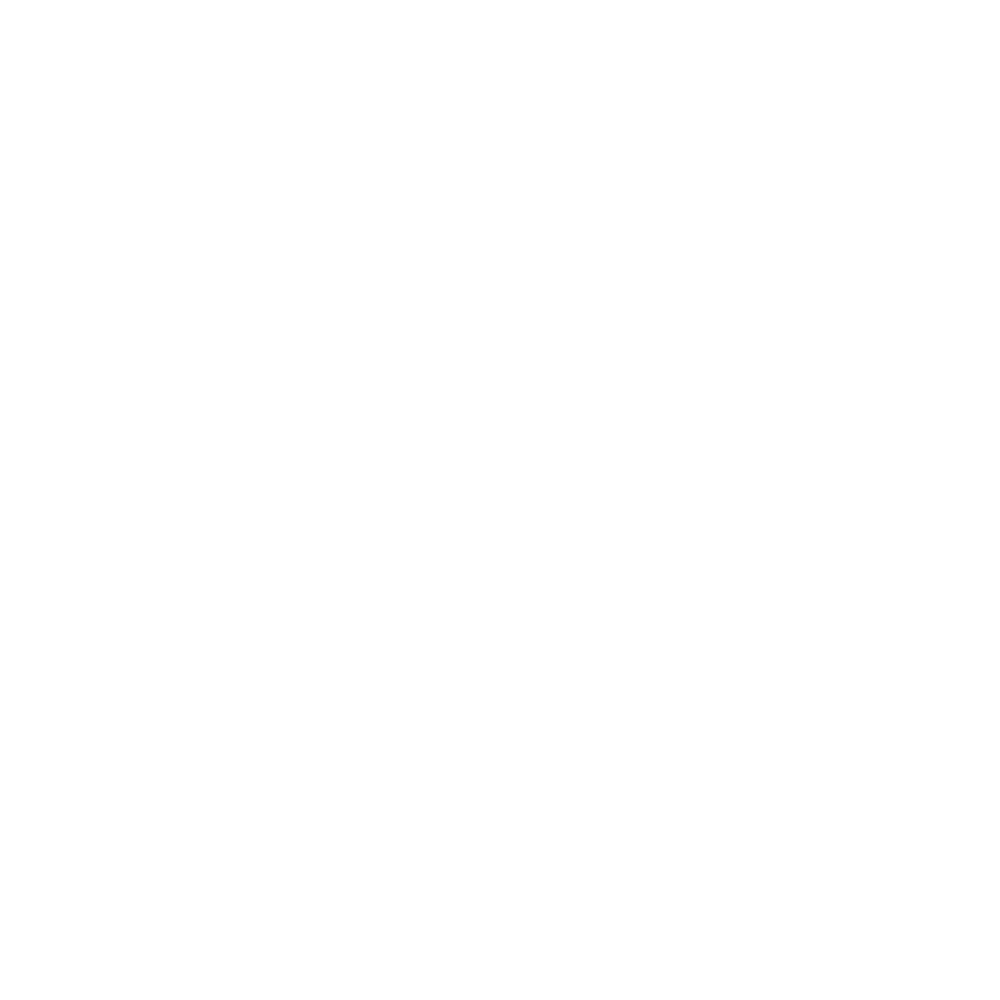

In [8]:
import pickle
%matplotlib notebook
radlims = [0.0, 250000., 0., 360.]
plotlims = [-1, -1, -1, -1]
ovrmap = True
ovrdis = False
dis_name_list = None
dxy_list = None
fields_D_list = None
deg2rad = np.pi / 180.

# Set plotting limits to center on the disdrometer locations 
if plotlims[0] == -1:
    Dxmin = min(dxlist)
    Dxmax = max(dxlist)
    Dymin = min(dylist)
    Dymax = max(dylist)
    plotlims = [Dxmin - 40000., Dxmax + 25000., Dymin - 25000., Dymax + 25000.]

# Extract stuff from radar dictionary
sweeptimelist = radar_dict[casedate]['sweeptimelist']
radarsweeplist = radar_dict[casedate]['radarsweeplist']
outfieldnames = radar_dict[casedate]['outfieldnameslist'][0] # Just need first entry

# Grab radar location information from the first sweep in radar_dict
radarsweep = radar_dict[casedate]['radarsweeplist'][0]
rlat = radarsweep.latitude['data'][0]
rlon = radarsweep.longitude['data'][0]

# Extract stuff from disdrometer dictionary
templist = dis_dict_at_radar[casedate]['convdata_at_sweeptimes']['temp']
dewpointlist = dis_dict_at_radar[casedate]['convdata_at_sweeptimes']['dewpoint']
pressurelist = dis_dict_at_radar[casedate]['convdata_at_sweeptimes']['pressure']
windspdavgveclist = dis_dict_at_radar[casedate]['convdata_at_sweeptimes']['windspdavgvec']
winddiravgveclist = dis_dict_at_radar[casedate]['convdata_at_sweeptimes']['winddiravgvec']

# Create basemap instance
bgmap = Basemap(projection='aeqd', width=300000., height=300000., lat_0=rlat, lon_0=rlon, 
                resolution='h', area_thresh=10., suppress_ticks=False)    
county_shapefile_location = '/Users/ddawson/python_scripts/from_Nate/public_python/shapefiles/county/countyp020'

xoffset, yoffset = bgmap(rlon, rlat) # Gets the proper offset for the map coordinates.
bgmap.drawcoastlines()  #Draws coastlines... of course.
bgmap.drawcountries()   #Draws political boundaries of countries.
bgmap.drawrivers(color='blue')  #Draws major rivers
bgmap.drawstates(linewidth=1.5)  #Draws political boundaries of states and provinces.
print 'reading counties from shapefile'
dummy,dummy,dummy,dummy,countylc = bgmap.readshapefile(county_shapefile_location,'counties',drawbounds=True, linewidth=0.5, color='gray')  #Draws US county boundaries.
bgmap_pkl = pickle.dumps(bgmap)

for i, sweeptime in enumerate(sweeptimelist):
    print "i, sweeptime = ", sweeptime
    figlist, gridlist = radar.plotsweep_pyART(radlims, plotlims, outfieldnames, radarsweeplist[i], ovrmap, 
                                              ovrdis, dis_name_list, dxy_list, fields_D_list, xoffset=xoffset,
                                              yoffset=yoffset)
    ax = gridlist[0][0]
    plt.title(sweeptime)
    
    for j, Dx, Dy in zip(xrange(len(dxlist)), dxlist, dylist):
        Dx = Dx + xoffset
        Dy = Dy + yoffset
        stationplot = StationPlot(ax, [Dx], [Dy], fontsize=14)
        stationplot.plot_parameter('NW', [templist[j][i]], color='black')
        stationplot.plot_parameter('SW', [dewpointlist[j][i]], color='blue')
        stationplot.plot_parameter('NE', [pressurelist[j][i]], formatter=lambda v: format(10 * v, '.0f')[-3:])
        u, v = get_wind_components([windspdavgveclist[j][i]] * units('m/s'), [winddiravgveclist[j][i]] * units.degree)
        stationplot.plot_barb(u, v, barb_increments=dict(half=2.5, full=5.0, flag=25.0))

    bgmap = pickle.loads(bgmap_pkl)
    bgmap.ax = ax # Set axes for basemap to current plotting axes.
    bgmap.drawcoastlines() 
#     if i == 0:
#         print 'reading counties from shapefile'
#         dummy,dummy,dummy,dummy,countylc = bgmap.readshapefile(county_shapefile_location,'counties',drawbounds=True, linewidth=0.5, color='gray')  #Draws US county boundaries.
#     for shape in bgmap.counties:
#         tempx, tempy = zip(*shape)
#         countyplot = ax.plot(tempx,tempy,color='gray',linewidth=0.5)

    if False:
        print 'reading urban boundaries from shapefile'
        bgmap.readshapefile(urban_shapefile_location, 'urban areas', drawbounds=True, linewidth=0.5, color='purple')  #Draws urban areas in purple.

    ax.set_xlim(plotlims[0] + xoffset, plotlims[1] + xoffset)
    ax.set_ylim(plotlims[2] + yoffset, plotlims[3] + yoffset)
    figlist[0].canvas.draw()
    figlist[0].set_size_inches(10., 10., forward = True)
    # if(field_D != None):
    #     ax.annotate(disfmtstr.format(field_D),(Dx+250.,Dy-250.),clip_on=True)
    plt.savefig('/Users/dawson29/Dropbox/Projects/Irma2017/plots/stationplots/{}_{:04d}.png'.format(casedate, i),dpi=200)
    plt.close(figlist[0])